This script checks if regulons have consistent expression.

The steps are the following:
* iterate over regulons.
* plot row expression.
* plot the log2 expression.
* scale the data. Consider z-scores and real scaling within a defined range.
* run PCA. Check how much variance is explained by PC1. This is the key to accept regulon tightness.
* use scores as values for heatmap.
* optionally, check the correlation of TF and PC1 to reveal if the TF is transcriptionally or posttranscriptionally regulated, e.g., phosphorylation.

In [1]:
import pandas, numpy, seaborn

In [2]:
import scipy, scipy.stats
import sklearn, sklearn.decomposition

In [3]:
import matplotlib, matplotlib.pyplot
matplotlib.rcParams.update({'font.size':20, 'font.family':'FreeSans', 'xtick.labelsize':20, 'ytick.labelsize':20, 'figure.figsize':(8, 4)})

In [4]:
import pyensembl
annotation = pyensembl.EnsemblRelease(86) # better matching than version 100
annotation

EnsemblRelease(release=86, species='homo_sapiens')

# 0. user-defined variables

In [5]:
regulon_input_file = '/home/adrian/projects/osteo/results/grn/regulons.txt'
expression_data_input_file = '/home/adrian/projects/osteo/results/tpm/DESeq2_TPM_values.tsv'
metadata_file = '/home/adrian/gd15/hi/research/osteo/metadata/MSC_Sample list.csv'
DETs_input_file = '/home/adrian/projects/osteo/results/DETs_filtered/entire_DEG_set.txt'
sub_regulon_file = '/home/adrian/projects/osteo/results/grn/subregulons.txt'

In [6]:
donors = ['6', '16', '17']
days = ['Day_3', 'Day_6', 'Day_9', 'Day_16', 'Day_28']

# 1. read data

## 1.1. read regulon memberships

In [7]:
df = pandas.read_csv(regulon_input_file, sep='\t', index_col=0)
df.head()

,TF targets DEGs / all TF targets,background DEG rank / background TF targets rank,Targets fold-enrichment,Uncorrected hypergeometric P value,Adjusted P value (BH; alpha=0.1),Observed TF target DEGs
TF,,,,,,
KLF16,59/799,1089/20300,1.376491,8.068623e-03,7.106365e-02,"NECTIN1, DDIT4, PAFAH1B3, NOP2, PRKAR1B, CILP2..."
E2F8,186/740,1089/20300,4.685429,2.279433e-75,2.710246e-72,"NECTIN1, PDE1A, UHRF1, EXO1, SPC25, RRM2, BLM,..."
ZNF750,47/495,1089/20300,1.769949,1.095739e-04,1.714255e-03,"NECTIN1, DOCK10, ST3GAL5, MCC, NRCAM, MYO1B, M..."
HIVEP3,25/192,1089/20300,2.427208,3.699457e-05,6.283792e-04,"NECTIN1, UHRF1, NOP2, PPRC1, CILP2, QSOX2, IL1..."
GATA5,44/516,1089/20300,1.589539,1.676692e-03,1.812352e-02,"C1QTNF6, NCAPG, TNFRSF19, GNB3, EFEMP1, CFD, C..."


## 1.2. read expression data

In [8]:
def metadata_reader():

    metadata = {}
    donors = []
    days = []

    with open(metadata_file, 'r') as f:
        next(f)
        for line in f:
            v = line.split(',')
            sample = v[0]
            day = v[-2]
            donor = v[-3]
            metadata[sample] = (donor, day)

            if donor not in donors:
                donors.append(donor)
            if day not in days:
                days.append(day)

    return metadata, donors, days

In [9]:
metadata, donors, days = metadata_reader()
print(days)

['Day_3', 'Day_6', 'Day_9', 'Day_16', 'Day_28']


In [10]:
expression = {}
ensembl_IDs = []

for sample in metadata:
    expression[sample] = {}

with open(expression_data_input_file, 'r') as f:

    header = f.readline()
    v = header.split('\t')
    sample_IDs = v[1:]
    sample_IDs[-1] = sample_IDs[-1].replace('\n', '')

    for line in f:
        v = line.split('\t')

        gene_name = v[0]
        ensembl_IDs.append(gene_name)
        v = [float(element) for element in v[1:]]

        for i in range(len(v)):
            value = v[i]
            sampleID = sample_IDs[i]
            expression[sampleID][gene_name] = value

In [11]:
###
### Let's work with expression trajectories for only the genes we care: DETs and TFs
###

# retrieve DETs for expression
DETs = []
with open(DETs_input_file, 'r') as f:
    for line in f:
        element = line.replace('\n', '')
        DETs.append(element)
print('DETs found: {}'.format(len(DETs)))
print(len(list(set(DETs))))

# add TFs, in case we work with their expression later
TFs = df.index.to_list()
print(len(TFs), TFs[:10])
TF_ensembl_ids = [annotation.gene_ids_of_gene_name(TF)[0] for TF in TFs]
print(len(TF_ensembl_ids), TF_ensembl_ids)

working_genes = list(set(DETs + TF_ensembl_ids))

print(len(working_genes))

DETs found: 1106
1106
139 ['KLF16', 'E2F8', 'ZNF750', 'HIVEP3', 'GATA5', 'FOXS1', 'IRF5', 'TBX2', 'TRERF1', 'PKNOX2']
139 ['ENSG00000129911', 'ENSG00000129173', 'ENSG00000141579', 'ENSG00000127124', 'ENSG00000130700', 'ENSG00000179772', 'ENSG00000128604', 'ENSG00000121068', 'ENSG00000124496', 'ENSG00000165495', 'ENSG00000182463', 'ENSG00000169946', 'ENSG00000106511', 'ENSG00000185591', 'ENSG00000121297', 'ENSG00000177606', 'ENSG00000176692', 'ENSG00000118526', 'ENSG00000152784', 'ENSG00000151322', 'ENSG00000163132', 'ENSG00000167157', 'ENSG00000152284', 'ENSG00000174332', 'ENSG00000124813', 'ENSG00000126603', 'ENSG00000107249', 'ENSG00000120738', 'ENSG00000109320', 'ENSG00000171056', 'ENSG00000116132', 'ENSG00000149054', 'ENSG00000150347', 'ENSG00000140044', 'ENSG00000198795', 'ENSG00000147862', 'ENSG00000177426', 'ENSG00000120693', 'ENSG00000105967', 'ENSG00000115112', 'ENSG00000091831', 'ENSG00000112837', 'ENSG00000163884', 'ENSG00000061455', 'ENSG00000053254', 'ENSG00000108001', 'EN

In [12]:
# we will work from this point with gene symbols only, converting ENSEMBL to gene symbols
manual_annotation = {
    'ENSG00000274619':'CFD',
    'ENSG00000278843':'MMP28',
    'ENSG00000227746':'C4A',
    'ENSG00000282854':'ASAP3',
    'ENSG00000283009':'ZNF436',
    'ENSG00000283106':'ZNF436-AS1',
    'ENSG00000263238':'CTSO',
    'ENSG00000275482':'EPHB6',
    'ENSG00000262862':'KRTAP2-3',
    'ENSG00000277909':'SPC25',
    'ENSG00000281166':'NLRP10',
    'ENSG00000280610':'KIF15',
    'ENSG00000280682':'HYOU1',
    'ENSG00000280641':'CDH4',
    'ENSG00000273707':'CDKN1C',
    'ENSG00000233450':'KIFC1',
    'ENSG00000262634':'SKA1',
    'ENSG00000275125':'PRXL2B',
    'ENSG00000281165':'SLC2A6',
    'ENSG00000276657':'PYCR3',
    'ENSG00000282147':'FAM20C'
}

In [13]:
# convert ensembl to gene symbol
for working_gene in working_genes:
    
    # convert ensembl to gene symbol
    try:
        name = annotation.gene_name_of_gene_id(working_gene)
    except:
        print('Ensembl ID {} not found in annotation.'.format(working_gene))
        if working_gene in manual_annotation:
            name = manual_annotation[working_gene]
            print('\t present in manual annotation, all OK.')
        else:
            print('WE HAVE A PROBLEM')
        print()

Ensembl ID ENSG00000281166 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000277909 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000280610 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000233450 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000263238 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000275125 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000283106 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000280682 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000282147 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000282854 not found in annotation.
	 present in manual annotation, all OK.

Ensembl ID ENSG00000276657 not found in annotation.
	 present in manua

In [14]:
# obtain a TPM trajectory (discrete for very low) across time over replicates and patients
expression_trajectories = {}

for working_gene in working_genes:
    
    # convert ensembl to gene symbol
    try:
        name = annotation.gene_name_of_gene_id(working_gene)
    except:
        print('Ensembl ID {} not found in annotation.'.format(working_gene))
        if working_gene in manual_annotation:
            name = manual_annotation[working_gene]
            print('\t present in manual annotation, all OK.')
        else:
            print('WE HAVE A PROBLEM')
    ############################
    
    ensembl_trajectory = []
    for day in days:
        expression_across_donors = []
        for donor in donors:
            
            # retrieve sample labels
            sample_labels = []
            for sample in sample_IDs:
                if metadata[sample] == (donor, day):
                    sample_labels.append(sample)
            
            # retrieve expression
            try:
                exp = [expression[label][working_gene] for label in sample_labels]
            except:
                exp = [0 for label in sample_labels]
                print('ENSEMBL ID {} not found in expression data set. Setting expression to zero.'.format(working_gene))
                    
            average_expression = numpy.mean(exp)
            if numpy.isnan(average_expression) == False:
                expression_across_donors.append(average_expression)
                
        # compute median across patients
        median_expression = numpy.median(expression_across_donors)
        
        # round values, useful for very low values
        round_value = numpy.around(median_expression) + 1
        
        # add round value to trajectory
        ensembl_trajectory.append(round_value)
    
    # add trajectory to dictionary
    expression_trajectories[name] = ensembl_trajectory

Ensembl ID ENSG00000281166 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000277909 not found in annotation.
	 present in manual annotation, all OK.


/home/adrian/anaconda3/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3420: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/adrian/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Ensembl ID ENSG00000280610 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000233450 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000263238 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000275125 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000283106 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000280682 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000282147 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000282854 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000276657 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000283009 not found in annotation.
	 present in manual annotation, all OK.
Ensembl ID ENSG00000275482 not found in annotation.
	 present in manual annotati

## plotting expression

In [15]:
plotting_df = pandas.DataFrame(expression_trajectories).transpose()
plotting_df_log2 = numpy.log2(plotting_df)
plotting_df_log2.columns = days
plotting_df_log2.head()
plotting_df_log2.loc['RUNX2', ]

Day_3     3.906891
Day_6     5.285402
Day_9     4.954196
Day_16    4.807355
Day_28    4.906891
Name: RUNX2, dtype: float64

In [16]:
plotting_df_log2.loc['RUNX2']

Day_3     3.906891
Day_6     5.285402
Day_9     4.954196
Day_16    4.807355
Day_28    4.906891
Name: RUNX2, dtype: float64

INFO:numexpr.utils:Note: NumExpr detected 20 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
INFO:numexpr.utils:NumExpr defaulting to 8 threads.


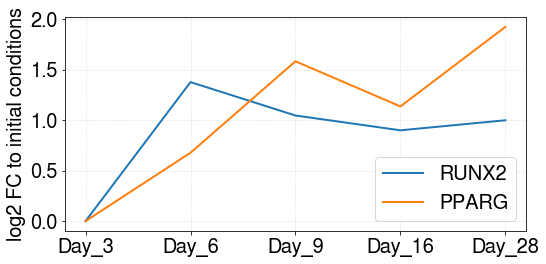

In [17]:
matplotlib.pyplot.plot(plotting_df_log2.loc['RUNX2']-plotting_df_log2.loc['RUNX2'][0], label='RUNX2', lw=2)
matplotlib.pyplot.plot(plotting_df_log2.loc['PPARG']-plotting_df_log2.loc['PPARG'][0], label='PPARG', lw=2)
matplotlib.pyplot.legend()
matplotlib.pyplot.grid(alpha=0.5, ls=':')
matplotlib.pyplot.ylabel('log2 FC to initial conditions')
matplotlib.pyplot.tight_layout()
matplotlib.pyplot.savefig('toggle_switch.svg')

0    15.0
1    39.0
2    31.0
3    28.0
4    30.0
Name: RUNX2, dtype: float64
0     5.0
1     8.0
2    15.0
3    11.0
4    19.0
Name: PPARG, dtype: float64
0    3.000000
1    4.875000
2    2.066667
3    2.545455
4    1.578947
dtype: float64


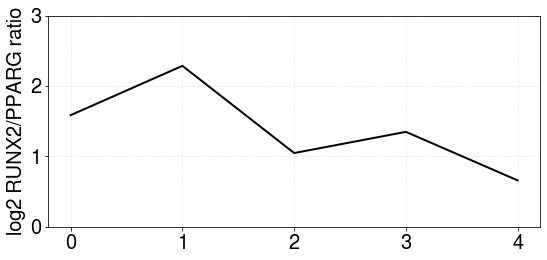

In [18]:
print(plotting_df.loc['RUNX2'])
print(plotting_df.loc['PPARG'])
ratios = plotting_df.loc['RUNX2'] / plotting_df.loc['PPARG']
print(ratios)
matplotlib.pyplot.plot(numpy.log2(ratios), lw=2, color='black')
matplotlib.pyplot.ylim([0, 3])
matplotlib.pyplot.grid(alpha=0.5, ls=':')
matplotlib.pyplot.ylabel('log2 RUNX2/PPARG ratio')
matplotlib.pyplot.tight_layout()

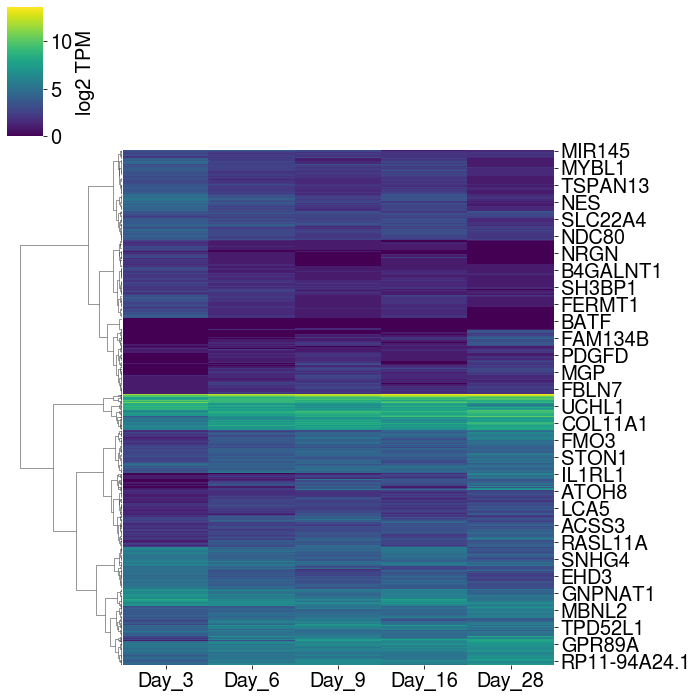

In [19]:
# for theMethod in ['single', 'complete', 'average', 'weighted', 'centroid', 'median', 'ward']:
#     print(theMethod)
#     g = seaborn.clustermap(plotting_df_log2, cmap='viridis', col_cluster=False, method=theMethod, metric='euclidean', yticklabels = 50)
#     g.savefig('{}.png'.format(theMethod))
g = seaborn.clustermap(plotting_df_log2, cmap='viridis', col_cluster=False, method='ward', metric='euclidean', yticklabels = 40, cbar_kws={'label':'log2 TPM'})
matplotlib.pyplot.savefig('heatmap.svg')

# 2. analysis

In [20]:
time_trajectory = [int(day.split('_')[-1]) for day in days]
print(time_trajectory)
theColors = ['blue', 'green', 'gold', 'orange', 'red']
print(theColors)

[3, 6, 9, 16, 28]
['blue', 'green', 'gold', 'orange', 'red']


In [21]:
from sklearn.cluster import OPTICS, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler

In [22]:
numpy.arange(20)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19])

----------------------------------------------------------
regulon KLF16 59
['NECTIN1', 'DDIT4', 'PAFAH1B3', 'NOP2', 'PRKAR1B', 'CILP2', 'PPRC1', 'C21orf58', 'FOXC2', 'CD3EAP', 'RANGAP1', 'UBE2S', 'FAM167A', 'RASSF7', 'SHB', 'ADAMTS10', 'CDKN1A', 'TUBB2B', 'SH3BP1', 'LMNB1', 'PNP', 'FOSL1', 'FJX1', 'C11orf91', 'DEPTOR', 'PIK3R1', 'SESN1', 'PRXL2B', 'GCH1', 'TNFRSF10D', 'NOP56', 'KIF15', 'SDF2L1', 'ANTXR2', 'LMCD1', 'TUBB3', 'PNRC1', 'WASL', 'S100A16', 'CTXN1', 'CRISPLD2', 'CDCA3', 'EEPD1', 'LRRC32', 'TUBB4B', 'CCDC86', 'VGLL4', 'DCBLD2', 'ABHD4', 'FBXO32', 'NCLN', 'SLC25A10', 'FAM89A', 'RHBDF2', 'ASAP3', 'HMGA1', 'LIFR', 'SEMA7A', 'PSD4']


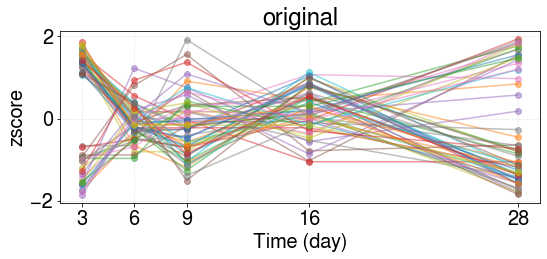

original data shape: (5, 59)
found subregulon: ['NECTIN1', 'PAFAH1B3', 'NOP2', 'PRKAR1B', 'PPRC1', 'C21orf58', 'FOXC2', 'CD3EAP', 'RANGAP1', 'UBE2S', 'RASSF7', 'SHB', 'SH3BP1', 'LMNB1', 'PNP', 'FOSL1', 'FJX1', 'C11orf91', 'PRXL2B', 'TNFRSF10D', 'NOP56', 'KIF15', 'SDF2L1', 'TUBB3', 'S100A16', 'CTXN1', 'CDCA3', 'TUBB4B', 'CCDC86', 'DCBLD2', 'NCLN', 'SLC25A10', 'RHBDF2', 'HMGA1', 'SEMA7A', 'PSD4'] 36 0.8361688445801976
found subregulon: ['ABHD4', 'FBXO32', 'LIFR', 'PNRC1', 'LMCD1', 'GCH1', 'CRISPLD2', 'FAM89A', 'CILP2', 'SESN1', 'VGLL4', 'DDIT4', 'EEPD1', 'WASL', 'PIK3R1', 'CDKN1A', 'FAM167A', 'ANTXR2'] 18 0.8376463581559724
################################## FINAL
original size: 59; new size 54; lost: 5
NECTIN1
PAFAH1B3
NOP2
PRKAR1B
PPRC1
C21orf58
FOXC2
CD3EAP
RANGAP1
UBE2S
RASSF7
SHB
SH3BP1
LMNB1
PNP
FOSL1
FJX1
C11orf91
PRXL2B
TNFRSF10D
NOP56
KIF15
SDF2L1
TUBB3
S100A16
CTXN1
CDCA3
TUBB4B
CCDC86
DCBLD2
NCLN
SLC25A10
RHBDF2
HMGA1
SEMA7A
PSD4
sub ['NECTIN1', 'PAFAH1B3', 'NOP2', 'PRKAR1B', 

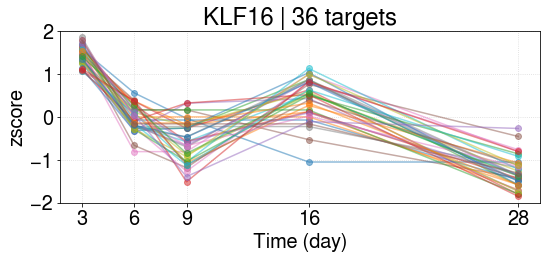

KLF16 | 1 [ 1.4594654  -0.03655097 -0.54965295  0.41581508 -1.28907656]
ABHD4
FBXO32
LIFR
PNRC1
LMCD1
GCH1
CRISPLD2
FAM89A
CILP2
SESN1
VGLL4
DDIT4
EEPD1
WASL
PIK3R1
CDKN1A
FAM167A
ANTXR2
sub ['ABHD4', 'FBXO32', 'LIFR', 'PNRC1', 'LMCD1', 'GCH1', 'CRISPLD2', 'FAM89A', 'CILP2', 'SESN1', 'VGLL4', 'DDIT4', 'EEPD1', 'WASL', 'PIK3R1', 'CDKN1A', 'FAM167A', 'ANTXR2'] 18


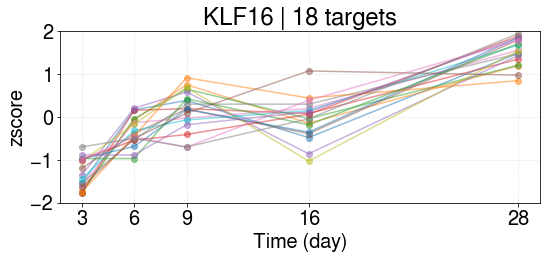

KLF16 | 2 [-1.32565892 -0.34051797  0.17868476 -0.04053981  1.52803194]
----------------------------------------------------------
regulon E2F8 186
['NECTIN1', 'PDE1A', 'UHRF1', 'EXO1', 'SPC25', 'RRM2', 'BLM', 'PASK', 'WDR62', 'CDKN1A', 'CDC20', 'CCNB2', 'SHCBP1', 'BUB1B', 'ABCA13', 'IQGAP3', 'TRIP13', 'RACGAP1', 'KIF2C', 'ARHGAP11B', 'VRK1', 'KIF15', 'ORC6', 'TTK', 'DBF4', 'CHAF1A', 'AURKB', 'SKA3', 'SAPCD2', 'DTL', 'PBK', 'FAM83D', 'KNL1', 'CCNB1', 'CDKN3', 'MFGE8', 'TCF19', 'KIF20A', 'KIF18B', 'TROAP', 'GINS1', 'KIFC1', 'AURKA', 'MCM2', 'BUB1', 'NOG', 'CCNF', 'CHAF1B', 'E2F1', 'MCM10', 'ARHGAP11A', 'LMNB1', 'FERMT1', 'ESPL1', 'HMMR', 'CSTA', 'RRM1', 'PLAC8', 'PLK4', 'GALNT6', 'MAD2L1', 'RAD51AP1', 'GINS4', 'PRIM1', 'PIF1', 'DEPDC1B', 'STIL', 'SMC2', 'CDC6', 'SPAG5', 'NCAPG2', 'CDCP1', 'GTSE1', 'CDK1', 'DEPDC1', 'INCENP', 'RAB27B', 'DLGAP5', 'CENPK', 'CEP55', 'MLPH', 'RAD54L', 'TPM3', 'SGO1', 'CDC45', 'MTFR2', 'PDGFRA', 'HMGA1', 'BIRC5', 'ORC1', 'CENPM', 'FIGNL1', 'MELK', 'ESCO2', 'C

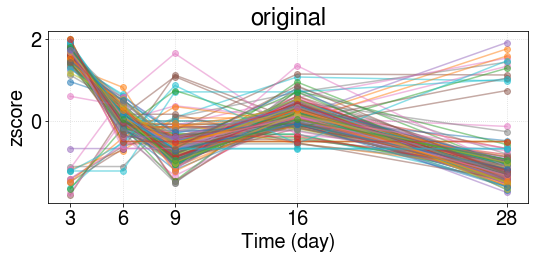

original data shape: (5, 186)
found subregulon: ['NECTIN1', 'PDE1A', 'UHRF1', 'EXO1', 'SPC25', 'RRM2', 'BLM', 'PASK', 'WDR62', 'CDKN1A', 'CDC20', 'CCNB2', 'SHCBP1', 'BUB1B', 'ABCA13', 'IQGAP3', 'TRIP13', 'RACGAP1', 'KIF2C', 'ARHGAP11B', 'VRK1', 'KIF15', 'ORC6', 'TTK', 'DBF4', 'CHAF1A', 'AURKB', 'SKA3', 'SAPCD2', 'DTL', 'PBK', 'FAM83D', 'KNL1', 'CCNB1', 'CDKN3', 'MFGE8', 'TCF19', 'KIF20A', 'KIF18B', 'TROAP', 'GINS1', 'KIFC1', 'AURKA', 'MCM2', 'BUB1', 'NOG', 'CCNF', 'CHAF1B', 'E2F1', 'MCM10', 'ARHGAP11A', 'LMNB1', 'FERMT1', 'ESPL1', 'HMMR', 'CSTA', 'RRM1', 'PLAC8', 'PLK4', 'GALNT6', 'MAD2L1', 'RAD51AP1', 'GINS4', 'PRIM1', 'PIF1', 'DEPDC1B', 'STIL', 'SMC2', 'CDC6', 'SPAG5', 'NCAPG2', 'CDCP1', 'GTSE1', 'CDK1', 'DEPDC1', 'INCENP', 'RAB27B', 'DLGAP5', 'CENPK', 'CEP55', 'MLPH', 'RAD54L', 'TPM3', 'SGO1', 'CDC45', 'MTFR2', 'PDGFRA', 'HMGA1', 'BIRC5', 'ORC1', 'CENPM', 'FIGNL1', 'MELK', 'ESCO2', 'CIT', 'KIF23', 'GINS2', 'TK1', 'FANCA', 'SGO2', 'MCM5', 'PLXDC2', 'ZNF367', 'ZWINT', 'POLQ', 'CKS2', 

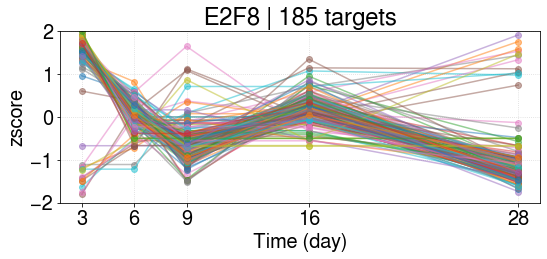

E2F8 | 1 [ 1.430044    0.06128648 -0.63816145  0.16655604 -1.01972507]
----------------------------------------------------------
regulon ZNF750 47
['NECTIN1', 'DOCK10', 'ST3GAL5', 'MCC', 'NRCAM', 'MYO1B', 'MME', 'UBASH3B', 'SYNJ2', 'LINC00598', 'ABCA13', 'KCNMA1', 'MYO1D', 'SLC8A1', 'ST6GAL1', 'DAPK2', 'EPAS1', 'FBLN1', 'NFATC2', 'NEDD9', 'PFKP', 'LINC00578', 'TNC', 'PAPPA', 'CRISPLD2', 'TENM2', 'KLF9', 'SLIT3', 'PTK2B', 'HTRA1', 'NTM', 'ZBTB16', 'TIAM1', 'MTSS1', 'LSAMP', 'TGFBR3', 'CD82', 'SLC44A1', 'PTPRF', 'MYLK', 'KIAA1217', 'NABP1', 'MAOA', 'COL21A1', 'CSMD2', 'TPD52L1', 'STIM1']


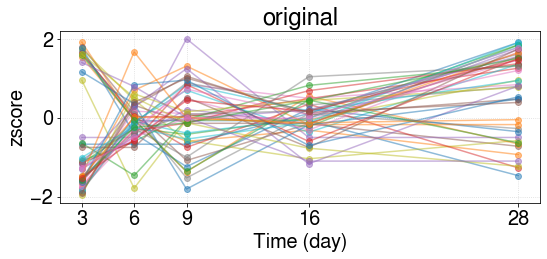

original data shape: (5, 47)
found subregulon: ['NECTIN1', 'DOCK10', 'MYO1B', 'UBASH3B', 'SYNJ2', 'KCNMA1', 'SLC8A1', 'PFKP', 'TIAM1', 'PTPRF'] 10 0.8325032950325639
found subregulon: ['MME', 'LINC00598', 'COL21A1', 'HTRA1', 'CRISPLD2', 'MCC', 'ZBTB16', 'FBLN1', 'SLIT3', 'EPAS1', 'TENM2', 'KLF9', 'MAOA', 'DAPK2', 'NRCAM', 'TPD52L1', 'PTK2B', 'MTSS1', 'STIM1', 'KIAA1217', 'PAPPA', 'LSAMP', 'NEDD9', 'LINC00578'] 24 0.8311286973000052
################################## FINAL
original size: 47; new size 34; lost: 13
NECTIN1
DOCK10
MYO1B
UBASH3B
SYNJ2
KCNMA1
SLC8A1
PFKP
TIAM1
PTPRF
sub ['NECTIN1', 'DOCK10', 'MYO1B', 'UBASH3B', 'SYNJ2', 'KCNMA1', 'SLC8A1', 'PFKP', 'TIAM1', 'PTPRF'] 10


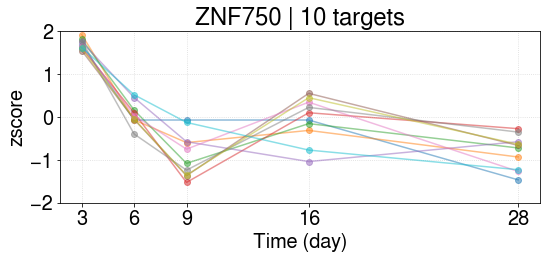

ZNF750 | 1 [ 1.69248939  0.06041434 -0.86998886 -0.06989769 -0.81301718]
MME
LINC00598
COL21A1
HTRA1
CRISPLD2
MCC
ZBTB16
FBLN1
SLIT3
EPAS1
TENM2
KLF9
MAOA
DAPK2
NRCAM
TPD52L1
PTK2B
MTSS1
STIM1
KIAA1217
PAPPA
LSAMP
NEDD9
LINC00578
sub ['MME', 'LINC00598', 'COL21A1', 'HTRA1', 'CRISPLD2', 'MCC', 'ZBTB16', 'FBLN1', 'SLIT3', 'EPAS1', 'TENM2', 'KLF9', 'MAOA', 'DAPK2', 'NRCAM', 'TPD52L1', 'PTK2B', 'MTSS1', 'STIM1', 'KIAA1217', 'PAPPA', 'LSAMP', 'NEDD9', 'LINC00578'] 24


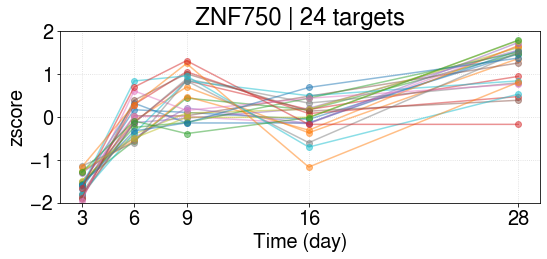

ZNF750 | 2 [-1.57667957 -0.042443    0.43089225 -0.00348598  1.19171629]
----------------------------------------------------------
regulon HIVEP3 25
['NECTIN1', 'UHRF1', 'NOP2', 'PPRC1', 'CILP2', 'QSOX2', 'IL1R1', 'CD3EAP', 'SHB', 'LMNB1', 'FJX1', 'CDC7', 'FAM83G', 'EPHB2', 'TEAD4', 'SLC2A6', 'APOL1', 'PTPRF', 'RHBDF2', 'PFAS', 'CSF1', 'WDR4', 'MYBBP1A', 'SEMA7A', 'LDLRAD3']


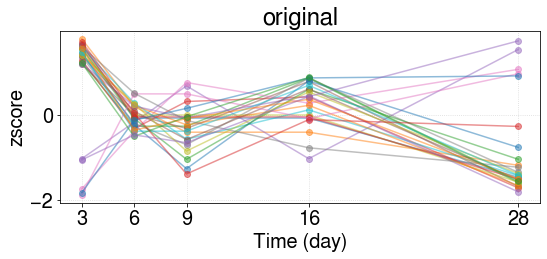

original data shape: (5, 25)
found subregulon: ['NECTIN1', 'UHRF1', 'NOP2', 'PPRC1', 'CILP2', 'QSOX2', 'IL1R1', 'CD3EAP', 'SHB', 'LMNB1', 'FJX1', 'CDC7', 'FAM83G', 'EPHB2', 'TEAD4', 'SLC2A6', 'PTPRF', 'RHBDF2', 'PFAS', 'CSF1', 'WDR4', 'MYBBP1A', 'SEMA7A', 'LDLRAD3'] 24 0.8553798347251492
################################## FINAL
original size: 25; new size 24; lost: 1
NECTIN1
UHRF1
NOP2
PPRC1
CILP2
QSOX2
IL1R1
CD3EAP
SHB
LMNB1
FJX1
CDC7
FAM83G
EPHB2
TEAD4
SLC2A6
PTPRF
RHBDF2
PFAS
CSF1
WDR4
MYBBP1A
SEMA7A
LDLRAD3
sub ['NECTIN1', 'UHRF1', 'NOP2', 'PPRC1', 'CILP2', 'QSOX2', 'IL1R1', 'CD3EAP', 'SHB', 'LMNB1', 'FJX1', 'CDC7', 'FAM83G', 'EPHB2', 'TEAD4', 'SLC2A6', 'PTPRF', 'RHBDF2', 'PFAS', 'CSF1', 'WDR4', 'MYBBP1A', 'SEMA7A', 'LDLRAD3'] 24


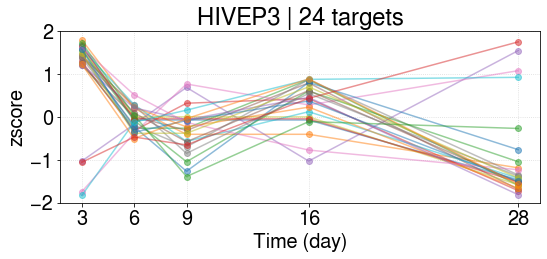

HIVEP3 | 1 [ 0.99478675 -0.07258399 -0.29811668  0.30944894 -0.93353502]
----------------------------------------------------------
regulon GATA5 44
['C1QTNF6', 'NCAPG', 'TNFRSF19', 'GNB3', 'EFEMP1', 'CFD', 'CHRDL1', 'PPARG', 'CLDN11', 'SAMD11', 'RASSF7', 'CYBRD1', 'FRMD5', 'RARRES2', 'LOXL2', 'TRIM46', 'SAA1', 'FBLN1', 'SERPING1', 'PODN', 'PPARGC1A', 'KCNT2', 'C3', 'HP', 'C7', 'SLIT3', 'PTK2B', 'VGLL4', 'PRR15', 'TIAM1', 'PCDH10', 'PKIG', 'RSPO1', 'SRPX', 'PLAT', 'PTPRF', 'MFAP4', 'MYLK', 'HMGA1', 'SAA2', 'CSF1', 'LUM', 'MYL3', 'CYP27A1']


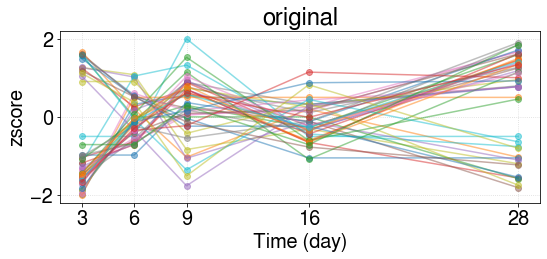

original data shape: (5, 44)
found subregulon: ['NCAPG', 'GNB3', 'CLDN11', 'RASSF7', 'FRMD5', 'LOXL2', 'TRIM46', 'PRR15', 'PCDH10', 'PTPRF'] 10 0.8305796624355964
found subregulon: ['CFD', 'SAA2', 'PKIG', 'MFAP4', 'EFEMP1', 'PPARG', 'LUM', 'SERPING1', 'CYBRD1', 'TNFRSF19', 'C7', 'FBLN1', 'HP', 'C1QTNF6', 'SLIT3', 'RARRES2', 'C3', 'SAA1', 'RSPO1', 'KCNT2', 'CHRDL1', 'PTK2B', 'PPARGC1A', 'PODN', 'CSF1'] 25 0.8393976279572016
################################## FINAL
original size: 44; new size 35; lost: 9
NCAPG
GNB3
CLDN11
RASSF7
FRMD5
LOXL2
TRIM46
PRR15
PCDH10
PTPRF
sub ['NCAPG', 'GNB3', 'CLDN11', 'RASSF7', 'FRMD5', 'LOXL2', 'TRIM46', 'PRR15', 'PCDH10', 'PTPRF'] 10


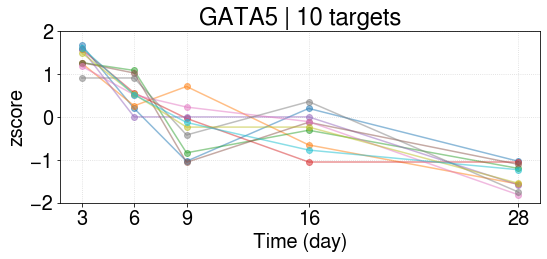

GATA5 | 1 [ 1.37973509  0.55813284 -0.28096168 -0.27055621 -1.38635003]
CFD
SAA2
PKIG
MFAP4
EFEMP1
PPARG
LUM
SERPING1
CYBRD1
TNFRSF19
C7
FBLN1
HP
C1QTNF6
SLIT3
RARRES2
C3
SAA1
RSPO1
KCNT2
CHRDL1
PTK2B
PPARGC1A
PODN
CSF1
sub ['CFD', 'SAA2', 'PKIG', 'MFAP4', 'EFEMP1', 'PPARG', 'LUM', 'SERPING1', 'CYBRD1', 'TNFRSF19', 'C7', 'FBLN1', 'HP', 'C1QTNF6', 'SLIT3', 'RARRES2', 'C3', 'SAA1', 'RSPO1', 'KCNT2', 'CHRDL1', 'PTK2B', 'PPARGC1A', 'PODN', 'CSF1'] 25


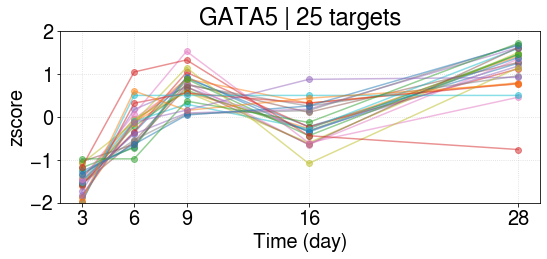

GATA5 | 2 [-1.51182203 -0.16689854  0.65394724 -0.1284105   1.15318383]
----------------------------------------------------------
regulon FOXS1 51
['PODNL1', 'PDE1A', 'C1QTNF6', 'PTN', 'GLI2', 'SUSD2', 'KLF15', 'B4GALNT1', 'EFEMP1', 'ANTXR1', 'FOXC2', 'SERPINA3', 'RTN4RL2', 'OLFML2B', 'ADAMTS10', 'FZD1', 'SNCG', 'PAMR1', 'PRRX2', 'LRRC17', 'ELN', 'OLFML2A', 'FBLN7', 'SLC29A1', 'KIAA1755', 'AK5', 'ASPN', 'CEBPB', 'HCFC1R1', 'BCL6', 'CLEC3B', 'GLUL', 'DPT', 'IL1RL1', 'SLIT3', 'MT1X', 'NRGN', 'CXCL12', 'FMOD', 'ZBTB16', 'LSP1', 'FRZB', 'NREP', 'DBP', 'ALOX15B', 'ECM2', 'LIMS2', 'TCF19', 'GPER1', 'LUM', 'SSPN']


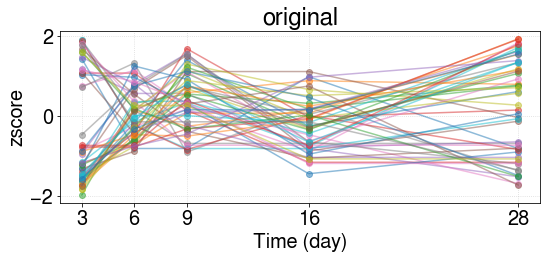

original data shape: (5, 51)
found subregulon: ['PTN', 'GLI2', 'B4GALNT1', 'SNCG', 'ELN', 'SLC29A1', 'KIAA1755', 'AK5', 'NRGN', 'NREP', 'LIMS2', 'TCF19', 'GPER1'] 13 0.8203370708666747
found subregulon: ['RTN4RL2', 'ECM2', 'FRZB', 'EFEMP1', 'LUM', 'SSPN', 'BCL6', 'FBLN7', 'DPT', 'FMOD', 'ASPN', 'SLIT3', 'HCFC1R1', 'ZBTB16', 'PODNL1', 'PDE1A', 'C1QTNF6', 'ANTXR1', 'SERPINA3', 'OLFML2B', 'KLF15', 'PRRX2', 'OLFML2A', 'GLUL', 'DBP'] 25 0.8229887936573169
################################## FINAL
original size: 51; new size 38; lost: 13
PTN
GLI2
B4GALNT1
SNCG
ELN
SLC29A1
KIAA1755
AK5
NRGN
NREP
LIMS2
TCF19
GPER1
sub ['PTN', 'GLI2', 'B4GALNT1', 'SNCG', 'ELN', 'SLC29A1', 'KIAA1755', 'AK5', 'NRGN', 'NREP', 'LIMS2', 'TCF19', 'GPER1'] 13


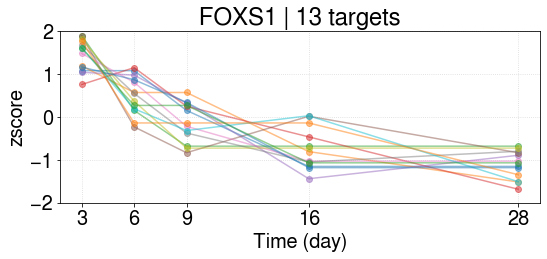

FOXS1 | 1 [ 1.45710305  0.50646273 -0.10762936 -0.74644037 -1.10949605]
RTN4RL2
ECM2
FRZB
EFEMP1
LUM
SSPN
BCL6
FBLN7
DPT
FMOD
ASPN
SLIT3
HCFC1R1
ZBTB16
PODNL1
PDE1A
C1QTNF6
ANTXR1
SERPINA3
OLFML2B
KLF15
PRRX2
OLFML2A
GLUL
DBP
sub ['RTN4RL2', 'ECM2', 'FRZB', 'EFEMP1', 'LUM', 'SSPN', 'BCL6', 'FBLN7', 'DPT', 'FMOD', 'ASPN', 'SLIT3', 'HCFC1R1', 'ZBTB16', 'PODNL1', 'PDE1A', 'C1QTNF6', 'ANTXR1', 'SERPINA3', 'OLFML2B', 'KLF15', 'PRRX2', 'OLFML2A', 'GLUL', 'DBP'] 25


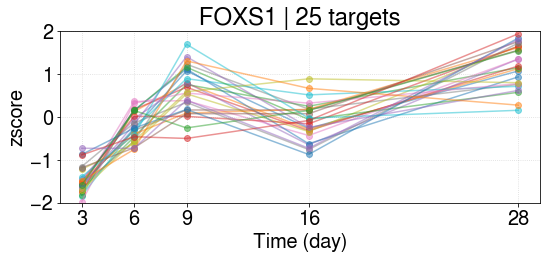

FOXS1 | 2 [-1.48186214 -0.22937179  0.6166652  -0.09934821  1.19391694]
----------------------------------------------------------
regulon IRF5 89
['UHRF1', 'C1QTNF6', 'BLM', 'CDC20', 'ATP10A', 'IQGAP3', 'ARHGAP11B', 'APOE', 'TTK', 'SAPCD2', 'SIAE', 'ACSS1', 'CCDC69', 'PSRC1', 'ALOX15B', 'IFITM3', 'TROAP', 'KIF18B', 'BUB1', 'ARHGAP11A', 'SYNJ2', 'CSTA', 'PLAC8', 'TSC22D1', 'GALNT6', 'TRIM46', 'OTOGL', 'FBLN7', 'LPXN', 'TMEM86A', 'TGFBI', 'GTSE1', 'RAB27B', 'CEP55', 'CD14', 'SLC25A19', 'MLPH', 'MTFR2', 'RHBDF2', 'CENPM', 'MELK', 'CFD', 'FANCA', 'MCM5', 'E2F8', 'EZR', 'ZWINT', 'RAC2', 'POLQ', 'PAQR4', 'NUSAP1', 'CDT1', 'APOC1', 'FNDC10', 'FOXM1', 'BST2', 'EVI2A', 'RAD51', 'CDCA8', 'ASF1B', 'PRR11', 'RGS18', 'PSD4', 'APBB1IP', 'ASPM', 'PLCB3', 'RASSF7', 'FAM167A', 'TACC3', 'SH3BP1', 'IFI30', 'ADORA1', 'KCNN4', 'EVI2B', 'PLK1', 'TENM2', 'NCAPH', 'PTK2B', 'DDIAS', 'CLSPN', 'RAP1B', 'CENPF', 'LSP1', 'SELPLG', 'PKMYT1', 'CENPA', 'CFI', 'MAFB', 'MKI67']


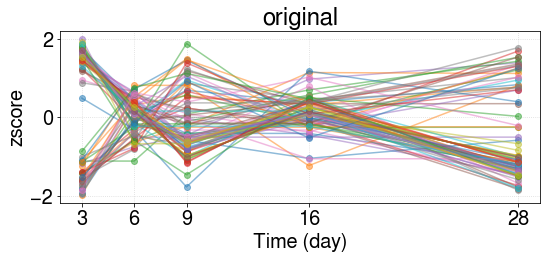

original data shape: (5, 89)
found subregulon: ['UHRF1', 'C1QTNF6', 'BLM', 'CDC20', 'ATP10A', 'IQGAP3', 'ARHGAP11B', 'APOE', 'TTK', 'SAPCD2', 'SIAE', 'ACSS1', 'PSRC1', 'ALOX15B', 'IFITM3', 'TROAP', 'KIF18B', 'BUB1', 'ARHGAP11A', 'SYNJ2', 'CSTA', 'PLAC8', 'TSC22D1', 'GALNT6', 'TRIM46', 'OTOGL', 'FBLN7', 'LPXN', 'TMEM86A', 'TGFBI', 'GTSE1', 'RAB27B', 'CEP55', 'CD14', 'SLC25A19', 'MLPH', 'MTFR2', 'RHBDF2', 'CENPM', 'MELK', 'CFD', 'FANCA', 'MCM5', 'E2F8', 'EZR', 'ZWINT', 'RAC2', 'POLQ', 'PAQR4', 'NUSAP1', 'CDT1', 'APOC1', 'FNDC10', 'FOXM1', 'BST2', 'EVI2A', 'RAD51', 'CDCA8', 'ASF1B', 'PRR11', 'RGS18', 'PSD4', 'APBB1IP', 'ASPM', 'PLCB3', 'RASSF7', 'FAM167A', 'TACC3', 'SH3BP1', 'IFI30', 'ADORA1', 'KCNN4', 'EVI2B', 'PLK1', 'TENM2', 'NCAPH', 'PTK2B', 'DDIAS', 'CLSPN', 'RAP1B', 'CENPF', 'LSP1', 'SELPLG', 'PKMYT1', 'CENPA', 'CFI', 'MAFB', 'MKI67'] 88 0.8200637222452133
################################## FINAL
original size: 89; new size 88; lost: 1
UHRF1
C1QTNF6
BLM
CDC20
ATP10A
IQGAP3
ARHGAP11B

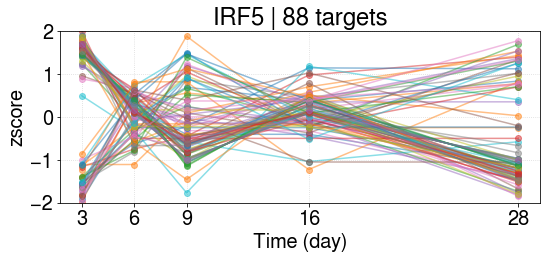

IRF5 | 1 [ 0.5320472   0.06624014 -0.1924586   0.13650744 -0.54233619]
----------------------------------------------------------
regulon TBX2 74
['PODNL1', 'TMEM100', 'CIT', 'C1QTNF6', 'GRASP', 'HHIP', 'TNFRSF19', 'CARD10', 'SUSD2', 'B4GALNT1', 'MMP28', 'TLE2', 'FOXC2', 'ANKRD28', 'FAM160A1', 'LAMA4', 'MYO1B', 'ADAMTS10', 'CLMN', 'WDR86', 'CDKN1A', 'PALM', 'GEM', 'RARRES2', 'PTH1R', 'ATP10A', 'SNCG', 'C1QTNF1', 'GGT5', 'FBLN2', 'CRLF1', 'TRIM46', 'NES', 'APOE', 'ELN', 'MAP3K12', 'OLFML2A', 'FBLN7', 'SAA1', 'MYO15B', 'KIAA1755', 'HLA-F', 'GPR17', 'PLSCR2', 'EPAS1', 'ACSL1', 'HSBP1L1', 'CORO6', 'CLEC3B', 'EBF1', 'CYGB', 'EEPD1', 'ADAMTS6', 'LRRC32', 'APOL3', 'NRGN', 'SLIT2', 'ABCA9', 'NBL1', 'FRZB', 'CSPG4', 'ADAMTS5', 'MGLL', 'PEAR1', 'MFAP4', 'FST', 'ECM2', 'LIMS2', 'SLC19A1', 'ITPRIPL1', 'BTBD3', 'SMAD6', 'ARHGAP6', 'GPER1']


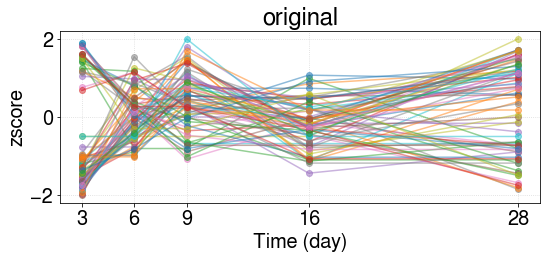

original data shape: (5, 74)
found subregulon: ['CIT', 'HHIP', 'CARD10', 'B4GALNT1', 'MYO1B', 'ATP10A', 'SNCG', 'TRIM46', 'NES', 'KIAA1755', 'GPR17', 'ADAMTS6', 'NRGN', 'SLIT2', 'CSPG4', 'MGLL', 'LIMS2', 'GPER1'] 18 0.825118350363398
found subregulon: ['FST', 'ECM2', 'MFAP4', 'FRZB', 'EBF1', 'NBL1', 'MYO15B', 'TLE2', 'ARHGAP6', 'CYGB', 'ACSL1', 'TNFRSF19', 'HSBP1L1', 'EPAS1', 'C1QTNF6', 'FBLN7', 'FAM160A1', 'CORO6', 'GGT5', 'PODNL1', 'FBLN2', 'APOE', 'ADAMTS5', 'GEM', 'SAA1', 'MMP28', 'WDR86', 'LAMA4', 'RARRES2', 'OLFML2A', 'MAP3K12', 'HLA-F', 'C1QTNF1', 'PALM', 'ANKRD28'] 35 0.8414695871946032
################################## FINAL
original size: 74; new size 53; lost: 21
CIT
HHIP
CARD10
B4GALNT1
MYO1B
ATP10A
SNCG
TRIM46
NES
KIAA1755
GPR17
ADAMTS6
NRGN
SLIT2
CSPG4
MGLL
LIMS2
GPER1
sub ['CIT', 'HHIP', 'CARD10', 'B4GALNT1', 'MYO1B', 'ATP10A', 'SNCG', 'TRIM46', 'NES', 'KIAA1755', 'GPR17', 'ADAMTS6', 'NRGN', 'SLIT2', 'CSPG4', 'MGLL', 'LIMS2', 'GPER1'] 18


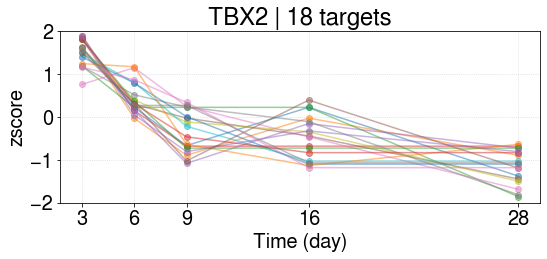

TBX2 | 1 [ 1.52049974  0.44481613 -0.33565185 -0.48835677 -1.14130725]
FST
ECM2
MFAP4
FRZB
EBF1
NBL1
MYO15B
TLE2
ARHGAP6
CYGB
ACSL1
TNFRSF19
HSBP1L1
EPAS1
C1QTNF6
FBLN7
FAM160A1
CORO6
GGT5
PODNL1
FBLN2
APOE
ADAMTS5
GEM
SAA1
MMP28
WDR86
LAMA4
RARRES2
OLFML2A
MAP3K12
HLA-F
C1QTNF1
PALM
ANKRD28
sub ['FST', 'ECM2', 'MFAP4', 'FRZB', 'EBF1', 'NBL1', 'MYO15B', 'TLE2', 'ARHGAP6', 'CYGB', 'ACSL1', 'TNFRSF19', 'HSBP1L1', 'EPAS1', 'C1QTNF6', 'FBLN7', 'FAM160A1', 'CORO6', 'GGT5', 'PODNL1', 'FBLN2', 'APOE', 'ADAMTS5', 'GEM', 'SAA1', 'MMP28', 'WDR86', 'LAMA4', 'RARRES2', 'OLFML2A', 'MAP3K12', 'HLA-F', 'C1QTNF1', 'PALM', 'ANKRD28'] 35


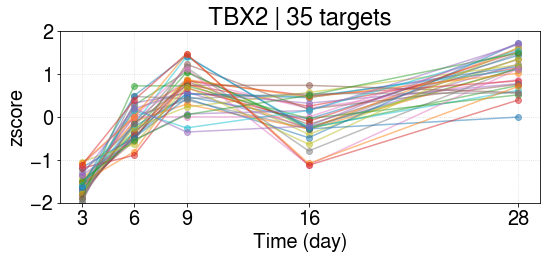

TBX2 | 2 [-1.56216209 -0.14855283  0.68496211 -0.08223777  1.10799059]
----------------------------------------------------------
regulon TRERF1 61
['RNF207', 'LPCAT4', 'INSR', 'CPT1C', 'PTN', 'CIT', 'DOCK10', 'EPHX1', 'RBL1', 'MCC', 'CARD10', 'TRAIP', 'TNFRSF19', 'GLI2', 'C21orf58', 'ST3GAL5', 'CDCA7', 'OLFML2B', 'EPHB6', 'TACC3', 'SH3BP1', 'FERMT1', 'FZD1', 'PRXL2B', 'NCEH1', 'FBLN2', 'GPX3', 'PLEKHG5', 'TONSL', 'LRRC17', 'MAP3K12', 'RFTN2', 'CCR7', 'PIF1', 'KIF15', 'CEBPB', 'MMP16', 'CNTNAP1', 'LCNL1', 'IL1RL1', 'FDXR', 'SLC9A9', 'DTL', 'NDC80', 'TIAM1', 'LSP1', 'EME1', 'AHNAK2', 'NREP', 'CENPI', 'TLR3', 'PSRC1', 'DBP', 'OLFML3', 'PRR11', 'TCF19', 'MAP4K2', 'LUM', 'FIGNL1', 'GINS1', 'PSD4']


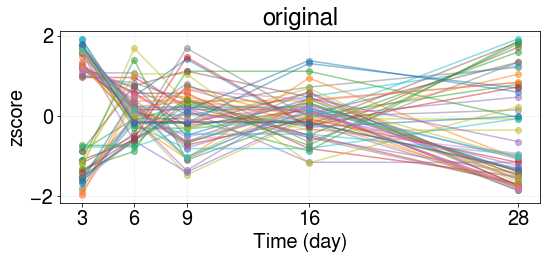

original data shape: (5, 61)
found subregulon: ['RNF207', 'LPCAT4', 'CPT1C', 'PTN', 'CIT', 'DOCK10', 'RBL1', 'CARD10', 'TRAIP', 'GLI2', 'C21orf58', 'CDCA7', 'TACC3', 'SH3BP1', 'FERMT1', 'PRXL2B', 'PLEKHG5', 'TONSL', 'LRRC17', 'PIF1', 'KIF15', 'MMP16', 'CNTNAP1', 'DTL', 'NDC80', 'TIAM1', 'EME1', 'AHNAK2', 'NREP', 'CENPI', 'PSRC1', 'PRR11', 'TCF19', 'MAP4K2', 'FIGNL1', 'GINS1', 'PSD4'] 37 0.8202560121318742
found subregulon: ['CEBPB', 'TNFRSF19', 'RFTN2', 'LUM', 'SLC9A9', 'OLFML3', 'MCC', 'FBLN2', 'EPHX1', 'OLFML2B', 'MAP3K12'] 11 0.8247050973472222
################################## FINAL
original size: 61; new size 48; lost: 13
RNF207
LPCAT4
CPT1C
PTN
CIT
DOCK10
RBL1
CARD10
TRAIP
GLI2
C21orf58
CDCA7
TACC3
SH3BP1
FERMT1
PRXL2B
PLEKHG5
TONSL
LRRC17
PIF1
KIF15
MMP16
CNTNAP1
DTL
NDC80
TIAM1
EME1
AHNAK2
NREP
CENPI
PSRC1
PRR11
TCF19
MAP4K2
FIGNL1
GINS1
PSD4
sub ['RNF207', 'LPCAT4', 'CPT1C', 'PTN', 'CIT', 'DOCK10', 'RBL1', 'CARD10', 'TRAIP', 'GLI2', 'C21orf58', 'CDCA7', 'TACC3', 'SH3BP1', 'FE

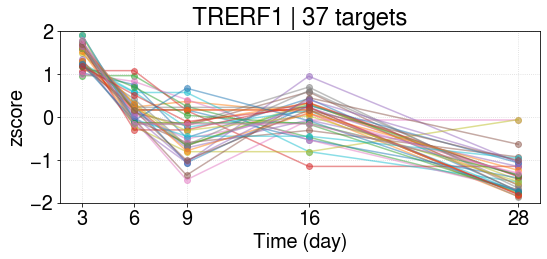

TRERF1 | 1 [ 1.45952343  0.20728104 -0.34279509  0.03915377 -1.36316315]
CEBPB
TNFRSF19
RFTN2
LUM
SLC9A9
OLFML3
MCC
FBLN2
EPHX1
OLFML2B
MAP3K12
sub ['CEBPB', 'TNFRSF19', 'RFTN2', 'LUM', 'SLC9A9', 'OLFML3', 'MCC', 'FBLN2', 'EPHX1', 'OLFML2B', 'MAP3K12'] 11


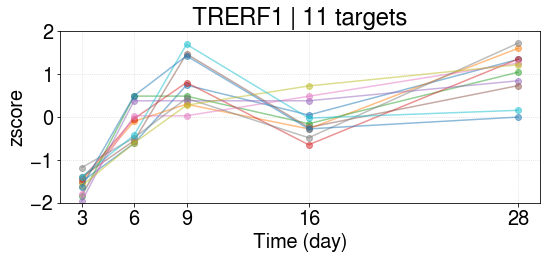

TRERF1 | 2 [-1.57082299 -0.13205743  0.72781149 -0.04580974  1.02087866]
----------------------------------------------------------
regulon PKNOX2 55
['ATP8B4', 'PTN', 'GLI2', 'CCDC68', 'MCC', 'CARD10', 'B4GALNT1', 'ANTXR1', 'QSOX2', 'PASK', 'PDGFRL', 'THOP1', 'RARRES2', 'COQ8A', 'CCND2', 'ANGPTL2', 'IL3RA', 'PAMR1', 'LRRC17', 'NETO2', 'CAP2', 'SAA1', 'PTCHD4', 'MMP16', 'CNTNAP1', 'ADAMTS12', 'DPT', 'MAN1C1', 'CXCL12', 'ATP6V0E2', 'NTM', 'LRRK2', 'ABHD4', 'PCDH10', 'MLPH', 'PKIG', 'C11orf95', 'IGFBP5', 'NREP', 'GPR89A', 'PTPRF', 'ALOX15B', 'MFAP4', 'MYLK', 'INSC', 'HMGA1', 'SLC19A1', 'BTBD3', 'MAOA', 'MAP3K5', 'PRR11', 'LUM', 'CDCA2', 'PLPP1', 'SSPN']


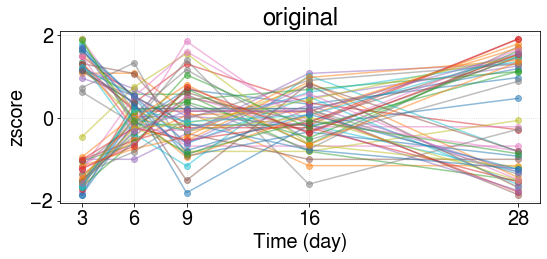

original data shape: (5, 55)
found subregulon: ['GLI2', 'CARD10', 'B4GALNT1', 'QSOX2', 'PASK', 'THOP1', 'PAMR1', 'CAP2', 'MMP16', 'CNTNAP1', 'ADAMTS12', 'ATP6V0E2', 'PCDH10', 'MLPH', 'NREP', 'PTPRF', 'INSC', 'SLC19A1', 'PRR11', 'CDCA2'] 20 0.8290759211271734
found subregulon: ['CCDC68', 'MYLK', 'ALOX15B', 'CCND2'] 4 0.8477761169626988
found subregulon: ['PKIG', 'MFAP4', 'SSPN', 'ATP8B4', 'PLPP1', 'PDGFRL', 'DPT', 'PTCHD4', 'LUM', 'ABHD4', 'MCC', 'MAN1C1', 'SAA1', 'MAOA', 'RARRES2', 'COQ8A', 'BTBD3', 'IL3RA'] 18 0.8324889149138042
################################## FINAL
original size: 55; new size 42; lost: 13
GLI2
CARD10
B4GALNT1
QSOX2
PASK
THOP1
PAMR1
CAP2
MMP16
CNTNAP1
ADAMTS12
ATP6V0E2
PCDH10
MLPH
NREP
PTPRF
INSC
SLC19A1
PRR11
CDCA2
sub ['GLI2', 'CARD10', 'B4GALNT1', 'QSOX2', 'PASK', 'THOP1', 'PAMR1', 'CAP2', 'MMP16', 'CNTNAP1', 'ADAMTS12', 'ATP6V0E2', 'PCDH10', 'MLPH', 'NREP', 'PTPRF', 'INSC', 'SLC19A1', 'PRR11', 'CDCA2'] 20


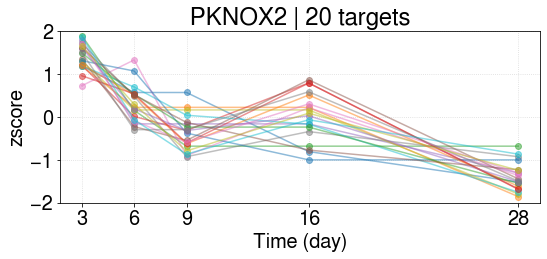

PKNOX2 | 1 [ 1.42259513  0.32113045 -0.36928974  0.01550956 -1.3899454 ]
CCDC68
MYLK
ALOX15B
CCND2
sub ['CCDC68', 'MYLK', 'ALOX15B', 'CCND2'] 4


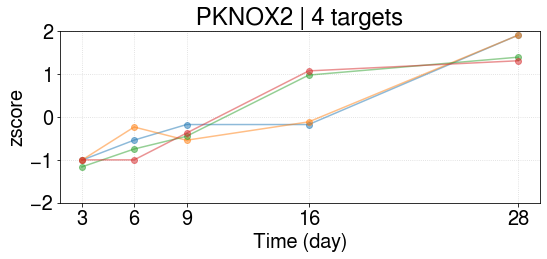

PKNOX2 | 2 [-1.04533484 -0.63119488 -0.38739941  0.4377278   1.62620134]
PKIG
MFAP4
SSPN
ATP8B4
PLPP1
PDGFRL
DPT
PTCHD4
LUM
ABHD4
MCC
MAN1C1
SAA1
MAOA
RARRES2
COQ8A
BTBD3
IL3RA
sub ['PKIG', 'MFAP4', 'SSPN', 'ATP8B4', 'PLPP1', 'PDGFRL', 'DPT', 'PTCHD4', 'LUM', 'ABHD4', 'MCC', 'MAN1C1', 'SAA1', 'MAOA', 'RARRES2', 'COQ8A', 'BTBD3', 'IL3RA'] 18


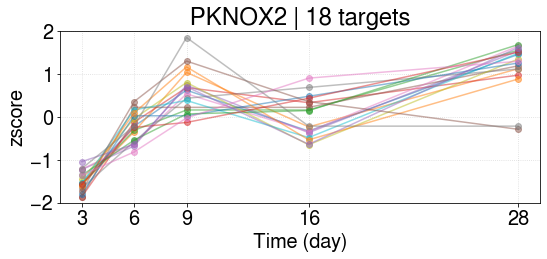

PKNOX2 | 3 [-1.50827982 -0.25044436  0.5873652  -0.00370878  1.17506776]
----------------------------------------------------------
regulon TSHZ2 105
['PDE1A', 'CPT1C', 'PTN', 'C1S', 'NT5E', 'MCC', 'RNF144A', 'RARRES2', 'STOM', 'GYPC', 'FBLN1', 'THBS2', 'MAN1C1', 'STON1', 'GBP2', 'APOL6', 'LSAMP', 'PEAR1', 'GFRA1', 'ACKR1', 'SECTM1', 'ATP8B4', 'NDRG1', 'EFEMP1', 'PNMA2', 'CLDN11', 'ADAM19', 'SHANK1', 'CYBRD1', 'PALM', 'IGF2', 'IL3RA', 'TRIM46', 'PRRX2', 'PAMR1', 'RUNX2', 'FAM20A', 'KIAA1755', 'PTGES', 'ARSJ', 'PODN', 'ABI3BP', 'MMP16', 'SLC9A9', 'NBL1', 'APOL1', 'FST', 'MFAP4', 'PDGFRA', 'ECM2', 'SPRY1', 'CAMK2N1', 'BOC', 'PLEKHH2', 'SSBP2', 'ZCCHC24', 'DOCK10', 'LEPR', 'PLXDC2', 'PDGFRL', 'VCAM1', 'CCND2', 'MGP', 'GPNMB', 'KCNT2', 'SNED1', 'EBF1', 'BST2', 'VWA5A', 'NTM', 'LUM', 'TMEM100', 'FGF7', 'C1R', 'ANTXR1', 'MYO1B', 'DCN', 'RTN4RL2', 'LCA5', 'OSR2', 'ADAMTS10', 'CADM3', 'CFH', 'PAK3', 'BTG1', 'DDR2', 'ABCC9', 'ACSS3', 'SERPINE2', 'HMCN1', 'C3', 'C7', 'CYGB', 'TNNT3', 'HTRA1', 'S

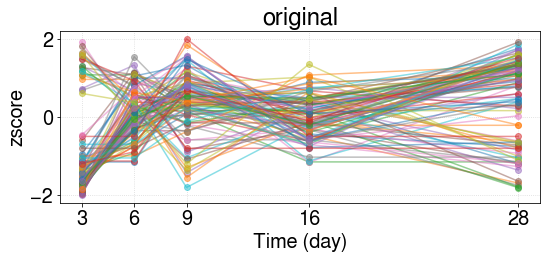

original data shape: (5, 105)
found subregulon: ['CPT1C', 'NT5E', 'CLDN11', 'ADAM19', 'SHANK1', 'TRIM46', 'PAMR1', 'KIAA1755', 'ARSJ', 'ABI3BP', 'MMP16', 'DOCK10', 'MYO1B', 'PAK3'] 14 0.8267989251702335
found subregulon: ['ACSS3', 'OSR2', 'APOL6', 'PID1', 'SFRP1'] 5 0.8386878401082027
found subregulon: ['HTRA1', 'C1S', 'DCN', 'PCDH18', 'ECM2', 'ATP8B4', 'BTG1', 'RNF144A', 'FST', 'PDGFRA', 'EFEMP1', 'EBF1', 'MFAP4', 'IGF2', 'CFH', 'THBS2', 'FBLN1', 'RTN4RL2', 'FGF7', 'NBL1', 'CYGB', 'ZCCHC24', 'GYPC', 'LAYN', 'DDR2', 'PDGFRL', 'C1R', 'PLXDC2', 'APOL1', 'LUM', 'MAN1C1', 'STOM', 'CYBRD1', 'SLC9A9', 'CADM3', 'C7', 'BST2', 'NDRG1', 'ACKR1', 'SULF2', 'HMCN1', 'MCC', 'GFRA1', 'SSBP2', 'KCNT2', 'GEM', 'C3', 'GBP2', 'BOC', 'MGP', 'GPNMB', 'LCA5', 'PRRX2', 'ABCC9', 'STON1', 'RARRES2', 'PNMA2', 'LSAMP', 'SPRY1', 'IL3RA', 'VCAM1', 'RUNX2', 'ANTXR1', 'PALM', 'TMEM100', 'FAM20A', 'PDE1A', 'PODN', 'PLEKHH2'] 69 0.8230303954885423
################################## FINAL
original size: 105; new size 8

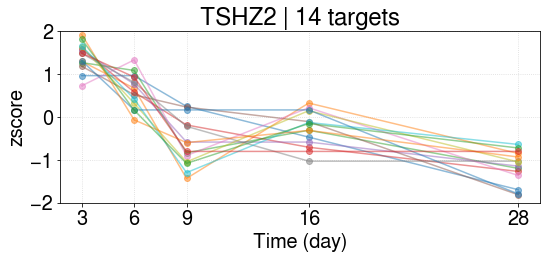

TSHZ2 | 1 [ 1.41668074  0.61501296 -0.59688664 -0.26980578 -1.16500128]
ACSS3
OSR2
APOL6
PID1
SFRP1
sub ['ACSS3', 'OSR2', 'APOL6', 'PID1', 'SFRP1'] 5


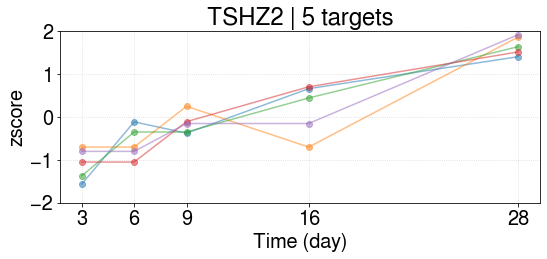

TSHZ2 | 2 [-1.09869903 -0.60470172 -0.1496958   0.18852474  1.66457182]
HTRA1
C1S
DCN
PCDH18
ECM2
ATP8B4
BTG1
RNF144A
FST
PDGFRA
EFEMP1
EBF1
MFAP4
IGF2
CFH
THBS2
FBLN1
RTN4RL2
FGF7
NBL1
CYGB
ZCCHC24
GYPC
LAYN
DDR2
PDGFRL
C1R
PLXDC2
APOL1
LUM
MAN1C1
STOM
CYBRD1
SLC9A9
CADM3
C7
BST2
NDRG1
ACKR1
SULF2
HMCN1
MCC
GFRA1
SSBP2
KCNT2
GEM
C3
GBP2
BOC
MGP
GPNMB
LCA5
PRRX2
ABCC9
STON1
RARRES2
PNMA2
LSAMP
SPRY1
IL3RA
VCAM1
RUNX2
ANTXR1
PALM
TMEM100
FAM20A
PDE1A
PODN
PLEKHH2
sub ['HTRA1', 'C1S', 'DCN', 'PCDH18', 'ECM2', 'ATP8B4', 'BTG1', 'RNF144A', 'FST', 'PDGFRA', 'EFEMP1', 'EBF1', 'MFAP4', 'IGF2', 'CFH', 'THBS2', 'FBLN1', 'RTN4RL2', 'FGF7', 'NBL1', 'CYGB', 'ZCCHC24', 'GYPC', 'LAYN', 'DDR2', 'PDGFRL', 'C1R', 'PLXDC2', 'APOL1', 'LUM', 'MAN1C1', 'STOM', 'CYBRD1', 'SLC9A9', 'CADM3', 'C7', 'BST2', 'NDRG1', 'ACKR1', 'SULF2', 'HMCN1', 'MCC', 'GFRA1', 'SSBP2', 'KCNT2', 'GEM', 'C3', 'GBP2', 'BOC', 'MGP', 'GPNMB', 'LCA5', 'PRRX2', 'ABCC9', 'STON1', 'RARRES2', 'PNMA2', 'LSAMP', 'SPRY1', 'IL3RA', 'VCAM1', 'R

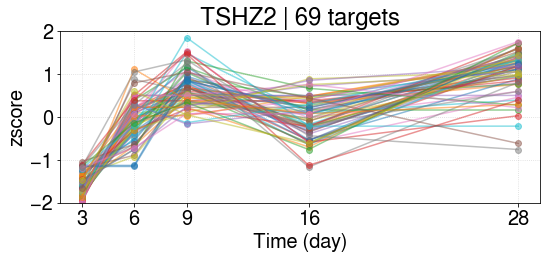

TSHZ2 | 3 [-1.60171517 -0.06832801  0.66404998 -0.0139349   1.0199281 ]
----------------------------------------------------------
regulon ZFPM2 97
['ANGPTL1', 'PDE1A', 'C1S', 'PTN', 'NT5E', 'ABCA6', 'FIBIN', 'ANGPTL2', 'SPON1', 'PTGIS', 'FBLN1', 'ANTXR2', 'CTSO', 'DPT', 'SLIT3', 'STON1', 'SRPX', 'PLD5', 'CNN1', 'ADAMTS5', 'GFRA1', 'PLPP1', 'EPS8', 'ARHGAP6', 'EFEMP1', 'CHRDL1', 'FOXC2', 'PNMA2', 'CLDN11', 'CYBRD1', 'IGF2', 'FAM110B', 'CPED1', 'PIK3R1', 'NR1D2', 'PAMR1', 'CAP2', 'KIAA1755', 'PODN', 'SERPING1', 'ABI3BP', 'SGCD', 'ADAMTS12', 'FAM180A', 'AXL', 'SLIT2', 'LRRK2', 'TGFBR3', 'MFAP4', 'ECM2', 'SPRY1', 'GAS1', 'BOC', 'SSBP2', 'PLXDC2', 'PDGFRL', 'A2M', 'MGP', 'KCNT2', 'EBF1', 'COL4A4', 'DCBLD2', 'PDGFD', 'FBLN5', 'COL21A1', 'LUM', 'LATS2', 'PMP22', 'SYT1', 'FGF7', 'SVEP1', 'ANTXR1', 'DCN', 'LCA5', 'LAMA4', 'ANGPT1', 'DAPK1', 'CADM3', 'FMO2', 'DDR2', 'OSR1', 'ABCC9', 'ACSS3', 'SLC8A1', 'ASPN', 'GPC6', 'C7', 'HTRA1', 'SFRP1', 'ABCA9', 'FMOD', 'C11orf95', 'PLAT', 'MYLK', 'OLFML3',

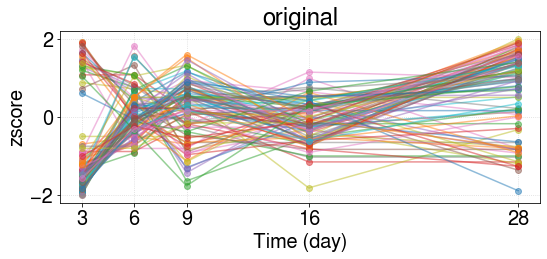

original data shape: (5, 97)
found subregulon: ['NT5E', 'PLD5', 'CLDN11', 'PAMR1', 'CAP2', 'KIAA1755', 'ABI3BP', 'SGCD', 'ADAMTS12', 'FAM180A', 'AXL', 'SLIT2', 'DCBLD2', 'FBLN5', 'SYT1', 'SLC8A1'] 16 0.8335980610224945
found subregulon: ['PIK3R1', 'SFRP1', 'ANTXR2', 'LRRK2', 'SPON1'] 5 0.9126829537623339
found subregulon: ['PDE1A', 'LATS2', 'MYLK', 'TGFBR3'] 4 0.8448093577981125
found subregulon: ['C1S', 'DCN', 'EBF1', 'FGF7', 'GPC6', 'ECM2', 'EFEMP1', 'SERPING1', 'HTRA1', 'PDGFRL', 'IGF2', 'ANGPTL2', 'GAS1', 'ANGPTL1', 'DDR2', 'MFAP4', 'ANGPT1', 'FBLN1', 'SVEP1', 'PLXDC2', 'FMO2', 'PMP22', 'SSPN', 'LUM', 'COL21A1', 'COL4A4', 'CTSO', 'ARHGAP6', 'CYBRD1', 'FMOD', 'MGP', 'ASPN', 'STON1', 'CADM3', 'NR1D2', 'ADAMTS5', 'LAMA4', 'SLIT3', 'KCNT2', 'SSBP2', 'C7', 'GFRA1', 'LCA5', 'PLPP1', 'PTGIS', 'SPRY1', 'OLFML3', 'PNMA2', 'DPT', 'FIBIN', 'ANTXR1', 'ACSS3', 'PDGFD', 'EPS8', 'ABCC9', 'CHRDL1', 'ABCA6', 'PTN', 'PODN'] 59 0.8254115643120293
################################## FINAL
original size

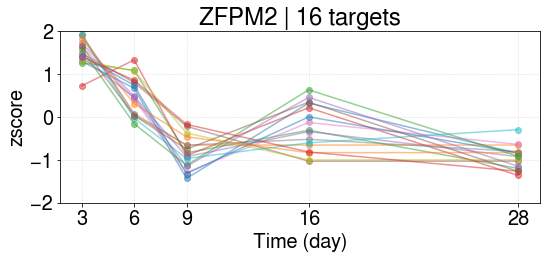

ZFPM2 | 1 [ 1.52576953  0.51047266 -0.82851209 -0.26751342 -0.94021669]
PIK3R1
SFRP1
ANTXR2
LRRK2
SPON1
sub ['PIK3R1', 'SFRP1', 'ANTXR2', 'LRRK2', 'SPON1'] 5


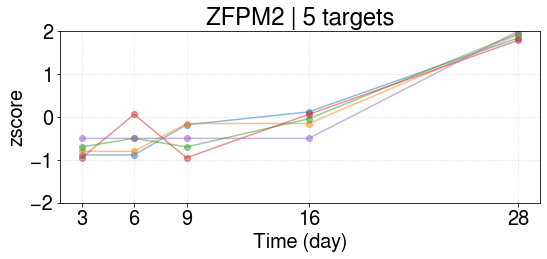

ZFPM2 | 2 [-0.76797931 -0.52587643 -0.49753561 -0.10442895  1.8958203 ]
PDE1A
LATS2
MYLK
TGFBR3
sub ['PDE1A', 'LATS2', 'MYLK', 'TGFBR3'] 4


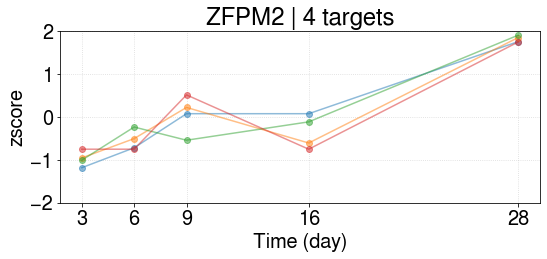

ZFPM2 | 3 [-0.97456573 -0.55306271  0.06611191 -0.35025394  1.81177046]
C1S
DCN
EBF1
FGF7
GPC6
ECM2
EFEMP1
SERPING1
HTRA1
PDGFRL
IGF2
ANGPTL2
GAS1
ANGPTL1
DDR2
MFAP4
ANGPT1
FBLN1
SVEP1
PLXDC2
FMO2
PMP22
SSPN
LUM
COL21A1
COL4A4
CTSO
ARHGAP6
CYBRD1
FMOD
MGP
ASPN
STON1
CADM3
NR1D2
ADAMTS5
LAMA4
SLIT3
KCNT2
SSBP2
C7
GFRA1
LCA5
PLPP1
PTGIS
SPRY1
OLFML3
PNMA2
DPT
FIBIN
ANTXR1
ACSS3
PDGFD
EPS8
ABCC9
CHRDL1
ABCA6
PTN
PODN
sub ['C1S', 'DCN', 'EBF1', 'FGF7', 'GPC6', 'ECM2', 'EFEMP1', 'SERPING1', 'HTRA1', 'PDGFRL', 'IGF2', 'ANGPTL2', 'GAS1', 'ANGPTL1', 'DDR2', 'MFAP4', 'ANGPT1', 'FBLN1', 'SVEP1', 'PLXDC2', 'FMO2', 'PMP22', 'SSPN', 'LUM', 'COL21A1', 'COL4A4', 'CTSO', 'ARHGAP6', 'CYBRD1', 'FMOD', 'MGP', 'ASPN', 'STON1', 'CADM3', 'NR1D2', 'ADAMTS5', 'LAMA4', 'SLIT3', 'KCNT2', 'SSBP2', 'C7', 'GFRA1', 'LCA5', 'PLPP1', 'PTGIS', 'SPRY1', 'OLFML3', 'PNMA2', 'DPT', 'FIBIN', 'ANTXR1', 'ACSS3', 'PDGFD', 'EPS8', 'ABCC9', 'CHRDL1', 'ABCA6', 'PTN', 'PODN'] 59


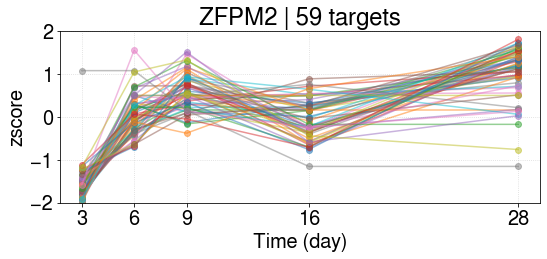

ZFPM2 | 4 [-1.58327986  0.04211514  0.55326985 -0.03815131  1.02604619]
----------------------------------------------------------
regulon MEOX2 104
['PDE1A', 'PTN', 'GLI2', 'MCC', 'MMP28', 'CDKN1A', 'FIBIN', 'RARRES2', 'ANGPTL2', 'MBNL2', 'ELN', 'PTGIS', 'CTSO', 'PFKP', 'DPT', 'SLIT3', 'MT1X', 'PLD5', 'CNN1', 'PEAR1', 'MEST', 'VIT', 'BTBD3', 'GPER1', 'SLC7A2', 'SUSD2', 'EFEMP1', 'CHRDL1', 'FOXC2', 'PALM', 'IGF2', 'NPR3', 'CPED1', 'NMNAT2', 'SNCG', 'FBLN2', 'PAMR1', 'PRRX2', 'RFTN2', 'CAP2', 'KIAA1755', 'PODN', 'AK5', 'ABI3BP', 'MMP16', 'SGCD', 'ADAMTS12', 'PCDH19', 'FAM180A', 'DEPDC1', 'RAB27B', 'TNFSF10', 'SLIT2', 'IGFBP5', 'FRZB', 'AHNAK2', 'MFAP4', 'ECM2', 'COL11A1', 'GAS1', 'BOC', 'DOCK10', 'B4GALNT1', 'CFD', 'NDNF', 'PDGFRL', 'A2M', 'OLFML2A', 'MGP', 'HNMT', 'KCNT2', 'LYPD6', 'EBF1', 'BST2', 'NTM', 'FANCI', 'COL21A1', 'DKK2', 'SVEP1', 'ASPM', 'SERPINA3', 'DCN', 'OLFML2B', 'LAMA4', 'ADAMTS10', 'ANGPT1', 'CADM3', 'FMO2', 'FZD1', 'OSR1', 'LRRC17', 'SLC8A1', 'SLC29A1', 'ASPN', 'KCNJ8

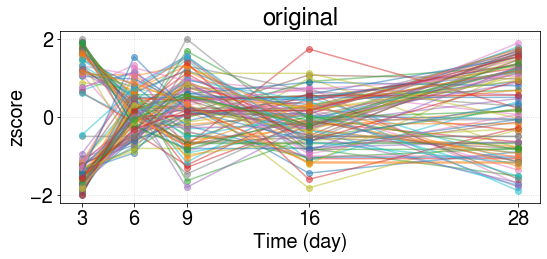

original data shape: (5, 104)
found subregulon: ['PFKP', 'PLD5', 'GPER1', 'CAP2', 'KIAA1755', 'AK5', 'ABI3BP', 'MMP16', 'SGCD', 'ADAMTS12', 'PCDH19', 'FAM180A', 'DEPDC1', 'SLIT2', 'AHNAK2', 'DOCK10', 'B4GALNT1', 'LYPD6', 'FANCI', 'DKK2', 'ASPM', 'LRRC17', 'SLC8A1', 'SLC29A1', 'LIMS2'] 25 0.8239252689866312
found subregulon: ['MEST', 'PODN', 'ADAMTS10', 'CXCL12'] 4 0.8615612268079298
found subregulon: ['PCDH18', 'HNMT', 'GAS1', 'FRZB', 'SSPN', 'ANGPTL2', 'COL21A1', 'PDGFRL', 'HTRA1', 'BST2', 'EBF1', 'IGF2', 'CFD', 'SLIT3', 'MCC', 'ECM2', 'EFEMP1', 'CADM3', 'ANGPT1', 'NDNF', 'SLC7A2', 'MFAP4', 'MGP', 'BOC', 'RFTN2', 'CHRDL1', 'FMO2', 'SVEP1', 'SERPINA3', 'VIT', 'DPT', 'RAB27B', 'CTSO', 'NPR3', 'MMP28', 'HMCN1', 'OLFML2A', 'FBLN2', 'LAMA4', 'PDE1A', 'ASPN', 'CDKN1A', 'KCNT2', 'RARRES2', 'BTBD3', 'KCNJ8', 'PRRX2', 'FIBIN', 'MBNL2', 'OLFML2B', 'A2M', 'PTGIS', 'NMNAT2', 'FZD1'] 54 0.8280621932917612
################################## FINAL
original size: 104; new size 83; lost: 21
PFKP
PLD5


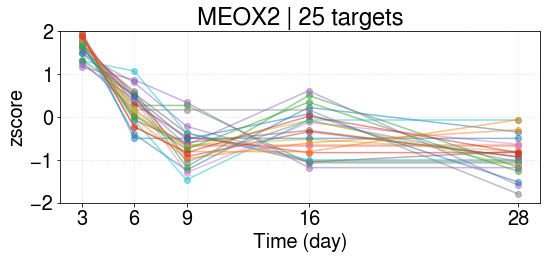

MEOX2 | 1 [ 1.66042566  0.23584524 -0.64680364 -0.36137263 -0.88809462]
MEST
PODN
ADAMTS10
CXCL12
sub ['MEST', 'PODN', 'ADAMTS10', 'CXCL12'] 4


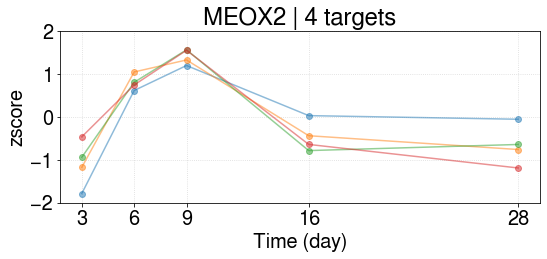

MEOX2 | 2 [-1.09122507  0.80197068  1.40898012 -0.45840834 -0.66131738]
PCDH18
HNMT
GAS1
FRZB
SSPN
ANGPTL2
COL21A1
PDGFRL
HTRA1
BST2
EBF1
IGF2
CFD
SLIT3
MCC
ECM2
EFEMP1
CADM3
ANGPT1
NDNF
SLC7A2
MFAP4
MGP
BOC
RFTN2
CHRDL1
FMO2
SVEP1
SERPINA3
VIT
DPT
RAB27B
CTSO
NPR3
MMP28
HMCN1
OLFML2A
FBLN2
LAMA4
PDE1A
ASPN
CDKN1A
KCNT2
RARRES2
BTBD3
KCNJ8
PRRX2
FIBIN
MBNL2
OLFML2B
A2M
PTGIS
NMNAT2
FZD1
sub ['PCDH18', 'HNMT', 'GAS1', 'FRZB', 'SSPN', 'ANGPTL2', 'COL21A1', 'PDGFRL', 'HTRA1', 'BST2', 'EBF1', 'IGF2', 'CFD', 'SLIT3', 'MCC', 'ECM2', 'EFEMP1', 'CADM3', 'ANGPT1', 'NDNF', 'SLC7A2', 'MFAP4', 'MGP', 'BOC', 'RFTN2', 'CHRDL1', 'FMO2', 'SVEP1', 'SERPINA3', 'VIT', 'DPT', 'RAB27B', 'CTSO', 'NPR3', 'MMP28', 'HMCN1', 'OLFML2A', 'FBLN2', 'LAMA4', 'PDE1A', 'ASPN', 'CDKN1A', 'KCNT2', 'RARRES2', 'BTBD3', 'KCNJ8', 'PRRX2', 'FIBIN', 'MBNL2', 'OLFML2B', 'A2M', 'PTGIS', 'NMNAT2', 'FZD1'] 54


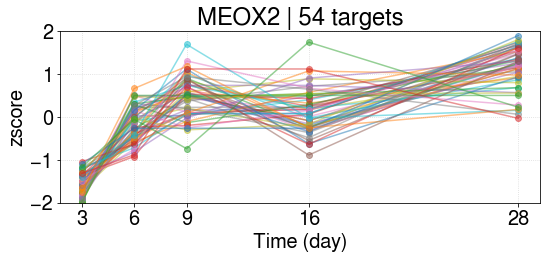

MEOX2 | 3 [-1.58661574 -0.16312846  0.45375701  0.15301645  1.14297074]
----------------------------------------------------------
regulon SP1 42
['BRCA1', 'CDC25C', 'INSR', 'FOS', 'PTN', 'ADA', 'TFPI2', 'MMP28', 'LEP', 'E2F1', 'CDKN1A', 'IGF2', 'EZR', 'MME', 'FOSL1', 'CCND2', 'IFNGR1', 'PTTG1', 'KIF2C', 'CYP19A1', 'GJA1', 'APOE', 'MYBL2', 'MYBL1', 'CYP1B1', 'CDK1', 'TNFSF10', 'TMPO', 'CD14', 'HMGA2', 'PLAU', 'CENPW', 'PLAT', 'PIM1', 'OXTR', 'PPL', 'TYMS', 'ALOX15B', 'SLC19A1', 'BIRC5', 'SOD2', 'CYP27A1']


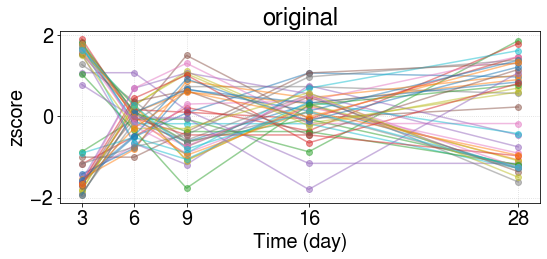

original data shape: (5, 42)
found subregulon: ['BRCA1', 'CDC25C', 'PTN', 'TFPI2', 'E2F1', 'EZR', 'FOSL1', 'PTTG1', 'KIF2C', 'MYBL2', 'MYBL1', 'CDK1', 'TMPO', 'HMGA2', 'CENPW', 'TYMS', 'SLC19A1', 'BIRC5'] 18 0.8545804398682642
found subregulon: ['FOS', 'ALOX15B', 'CCND2', 'CYP19A1'] 4 0.8223996240344998
found subregulon: ['IGF2', 'CD14', 'CYP27A1', 'LEP', 'SOD2', 'MMP28', 'PPL', 'APOE', 'ADA', 'MME', 'PIM1', 'GJA1', 'TNFSF10', 'CDKN1A', 'CYP1B1'] 15 0.830897514310986
################################## FINAL
original size: 42; new size 37; lost: 5
BRCA1
CDC25C
PTN
TFPI2
E2F1
EZR
FOSL1
PTTG1
KIF2C
MYBL2
MYBL1
CDK1
TMPO
HMGA2
CENPW
TYMS
SLC19A1
BIRC5
sub ['BRCA1', 'CDC25C', 'PTN', 'TFPI2', 'E2F1', 'EZR', 'FOSL1', 'PTTG1', 'KIF2C', 'MYBL2', 'MYBL1', 'CDK1', 'TMPO', 'HMGA2', 'CENPW', 'TYMS', 'SLC19A1', 'BIRC5'] 18


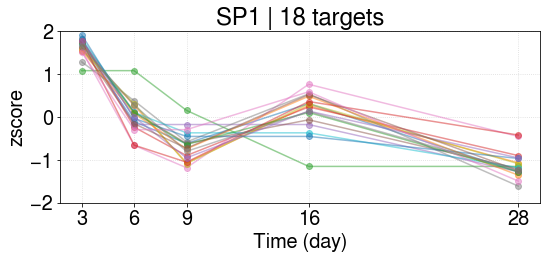

SP1 | 1 [ 1.63628763  0.02061209 -0.67458409  0.13873277 -1.12104841]
FOS
ALOX15B
CCND2
CYP19A1
sub ['FOS', 'ALOX15B', 'CCND2', 'CYP19A1'] 4


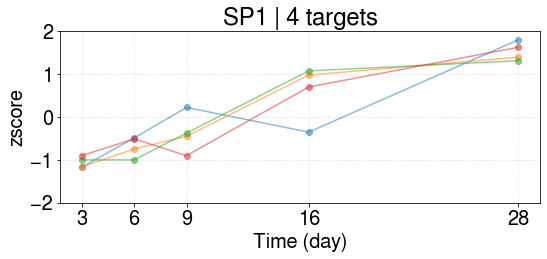

SP1 | 2 [-1.05929994 -0.6876206  -0.37753613  0.59653003  1.52792666]
IGF2
CD14
CYP27A1
LEP
SOD2
MMP28
PPL
APOE
ADA
MME
PIM1
GJA1
TNFSF10
CDKN1A
CYP1B1
sub ['IGF2', 'CD14', 'CYP27A1', 'LEP', 'SOD2', 'MMP28', 'PPL', 'APOE', 'ADA', 'MME', 'PIM1', 'GJA1', 'TNFSF10', 'CDKN1A', 'CYP1B1'] 15


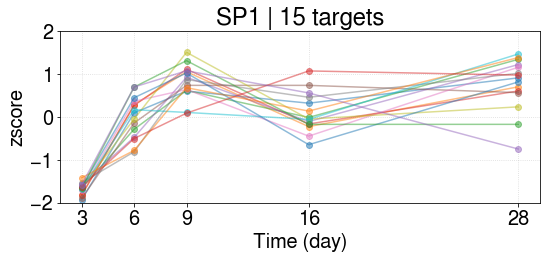

SP1 | 3 [-1.6751726  -0.00244776  0.82173761  0.09252698  0.76335576]
----------------------------------------------------------
regulon TSHZ3 126
['PDE1A', 'C1S', 'PTN', 'GLI2', 'NT5E', 'RAB31', 'ARMC9', 'RARRES2', 'ANGPTL2', 'PTGIS', 'GYPC', 'FNDC1', 'CTSO', 'CYP1B1', 'DPT', 'MAN1C1', 'SLIT3', 'IFITM1', 'GLIPR1', 'STON1', 'TOX', 'NCAM2', 'GBP2', 'PKIG', 'RGS4', 'CNN1', 'TPM1', 'PEAR1', 'GFRA1', 'ARHGAP6', 'DGKI', 'EFEMP1', 'CHRDL1', 'FOXC2', 'ZNF503', 'PNMA2', 'ADAM19', 'SHANK1', 'CYBRD1', 'PALM', 'FAM110B', 'CPED1', 'FAM20A', 'FBLN7', 'KIAA1755', 'ARSJ', 'SERPING1', 'PODN', 'ABI3BP', 'TGFBI', 'MMP16', 'CNTNAP1', 'SGCD', 'ADAMTS12', 'AXL', 'SLIT2', 'PXN', 'NBL1', 'FRZB', 'APOL1', 'MFAP4', 'PDGFRA', 'ASAP3', 'ECM2', 'SPRY1', 'CAMK2N1', 'BOC', 'PLEKHH2', 'SSBP2', 'ZCCHC24', 'PLXDC2', 'PDGFRL', 'SMTN', 'CCND2', 'RHOQ', 'LAYN', 'TUBA1A', 'MGP', 'INHBA', 'HNMT', 'SCD5', 'KCNT2', 'SNED1', 'CTXN1', 'DCBLD2', 'PROS1', 'FBLN5', 'LUM', 'PMP22', 'LATS2', 'FGF7', 'SVEP1', 'C1R', 'ANTXR1', 'TLE2'

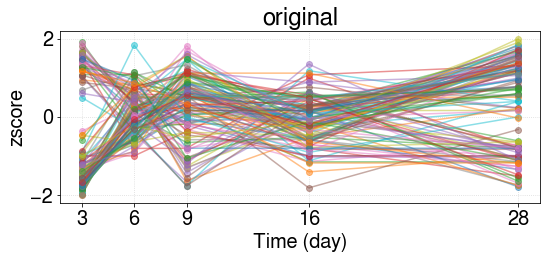

original data shape: (5, 126)
found subregulon: ['PTN', 'GLI2', 'NT5E', 'GLIPR1', 'TOX', 'TPM1', 'DGKI', 'ADAM19', 'SHANK1', 'KIAA1755', 'ARSJ', 'ABI3BP', 'MMP16', 'CNTNAP1', 'SGCD', 'ADAMTS12', 'AXL', 'SLIT2', 'PXN', 'TUBA1A', 'CTXN1', 'FBLN5', 'PAK3', 'LOXL2', 'CSPG4', 'LIMS2'] 26 0.8227200089954381
found subregulon: ['RHOQ', 'NCAM2', 'PLEKHH2', 'MYLK', 'INHBA'] 5 0.8593598696144334
found subregulon: ['C1S', 'HTRA1', 'ECM2', 'PCDH18', 'HNMT', 'SERPING1', 'DCN', 'EFEMP1', 'MFAP4', 'PROS1', 'FRZB', 'PDGFRA', 'PKIG', 'NBL1', 'PTGFR', 'FGF7', 'PMP22', 'LAYN', 'TLE2', 'CYGB', 'ARHGAP6', 'ZCCHC24', 'GYPC', 'ANGPTL2', 'C1R', 'MAN1C1', 'ASAP3', 'LUM', 'APOL1', 'RAB31', 'FMOD', 'PDGFRL', 'ASPN', 'DDR2', 'PLXDC2', 'IFITM1', 'CYBRD1', 'FBLN7', 'SSPN', 'C7', 'CTSO', 'SVEP1', 'OLFML3', 'HMCN1', 'SULF2', 'KCNT2', 'KCNJ8', 'SLIT3', 'LAMA4', 'GFRA1', 'SSBP2', 'GBP2', 'DPT', 'PTGIS', 'GEM', 'BOC', 'OLFML2B', 'MGP', 'PNMA2', 'FAM110B', 'PALM', 'STON1', 'FAM20A', 'SCD5', 'PLAT', 'CHRDL1', 'C11orf95', '

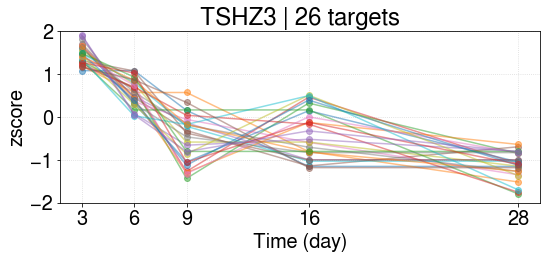

TSHZ3 | 1 [ 1.46629406  0.56200791 -0.50481462 -0.4016471  -1.12184025]
RHOQ
NCAM2
PLEKHH2
MYLK
INHBA
sub ['RHOQ', 'NCAM2', 'PLEKHH2', 'MYLK', 'INHBA'] 5


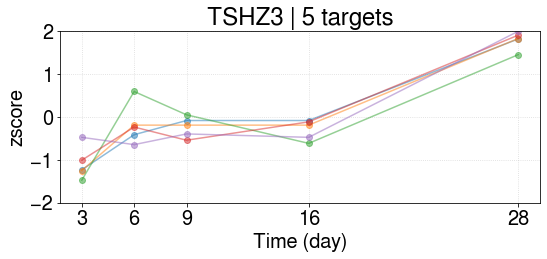

TSHZ3 | 2 [-1.08762734 -0.17919906 -0.2333766  -0.29670824  1.79691124]
C1S
HTRA1
ECM2
PCDH18
HNMT
SERPING1
DCN
EFEMP1
MFAP4
PROS1
FRZB
PDGFRA
PKIG
NBL1
PTGFR
FGF7
PMP22
LAYN
TLE2
CYGB
ARHGAP6
ZCCHC24
GYPC
ANGPTL2
C1R
MAN1C1
ASAP3
LUM
APOL1
RAB31
FMOD
PDGFRL
ASPN
DDR2
PLXDC2
IFITM1
CYBRD1
FBLN7
SSPN
C7
CTSO
SVEP1
OLFML3
HMCN1
SULF2
KCNT2
KCNJ8
SLIT3
LAMA4
GFRA1
SSBP2
GBP2
DPT
PTGIS
GEM
BOC
OLFML2B
MGP
PNMA2
FAM110B
PALM
STON1
FAM20A
SCD5
PLAT
CHRDL1
C11orf95
RARRES2
ANTXR1
SPRY1
sub ['C1S', 'HTRA1', 'ECM2', 'PCDH18', 'HNMT', 'SERPING1', 'DCN', 'EFEMP1', 'MFAP4', 'PROS1', 'FRZB', 'PDGFRA', 'PKIG', 'NBL1', 'PTGFR', 'FGF7', 'PMP22', 'LAYN', 'TLE2', 'CYGB', 'ARHGAP6', 'ZCCHC24', 'GYPC', 'ANGPTL2', 'C1R', 'MAN1C1', 'ASAP3', 'LUM', 'APOL1', 'RAB31', 'FMOD', 'PDGFRL', 'ASPN', 'DDR2', 'PLXDC2', 'IFITM1', 'CYBRD1', 'FBLN7', 'SSPN', 'C7', 'CTSO', 'SVEP1', 'OLFML3', 'HMCN1', 'SULF2', 'KCNT2', 'KCNJ8', 'SLIT3', 'LAMA4', 'GFRA1', 'SSBP2', 'GBP2', 'DPT', 'PTGIS', 'GEM', 'BOC', 'OLFML2B', 'MGP', 'PNM

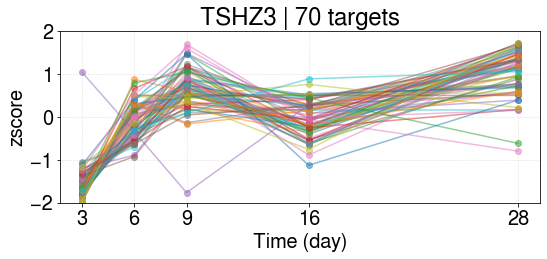

TSHZ3 | 3 [-1.56577759 -0.10403121  0.65348708 -0.04013312  1.05645484]
----------------------------------------------------------
regulon JUN 27
['BRCA1', 'FOS', 'PTN', 'TFPI2', 'DDIT3', 'IL6', 'MMP13', 'EZR', 'VCAM1', 'CDKN1A', 'FOSL1', 'CCND2', 'CSTA', 'MMP7', 'CYP19A1', 'RUNX2', 'ELN', 'MGP', 'GJA1', 'MMP1', 'CXCL8', 'TNC', 'LBP', 'STMN1', 'PLAT', 'OXTR', 'CD82']


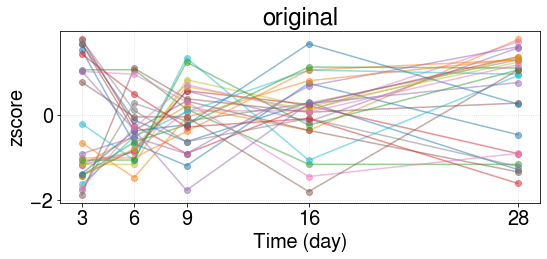

original data shape: (5, 27)
found subregulon: ['BRCA1', 'TFPI2', 'IL6', 'EZR', 'STMN1'] 5 0.8749764392790077
found subregulon: ['DDIT3', 'VCAM1', 'TNC', 'FOS', 'LBP'] 5 0.8486701826092116
found subregulon: ['CSTA', 'MMP7', 'MGP', 'GJA1', 'CCND2', 'CD82', 'CYP19A1', 'CXCL8'] 8 0.8267537463508152
################################## FINAL
original size: 27; new size 18; lost: 9
BRCA1
TFPI2
IL6
EZR
STMN1
sub ['BRCA1', 'TFPI2', 'IL6', 'EZR', 'STMN1'] 5


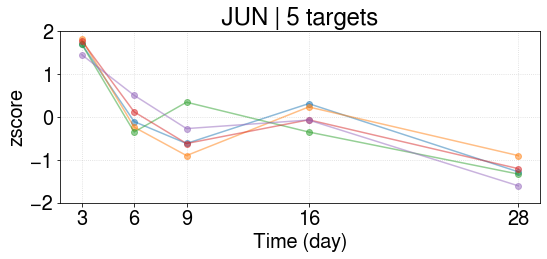

JUN | 1 [ 1.68362774 -0.01585753 -0.41396753  0.00955449 -1.26335717]
DDIT3
VCAM1
TNC
FOS
LBP
sub ['DDIT3', 'VCAM1', 'TNC', 'FOS', 'LBP'] 5


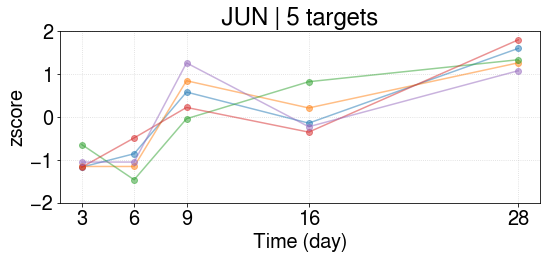

JUN | 2 [-1.03774763 -1.00331221  0.57091462  0.05974397  1.41040126]
CSTA
MMP7
MGP
GJA1
CCND2
CD82
CYP19A1
CXCL8
sub ['CSTA', 'MMP7', 'MGP', 'GJA1', 'CCND2', 'CD82', 'CYP19A1', 'CXCL8'] 8


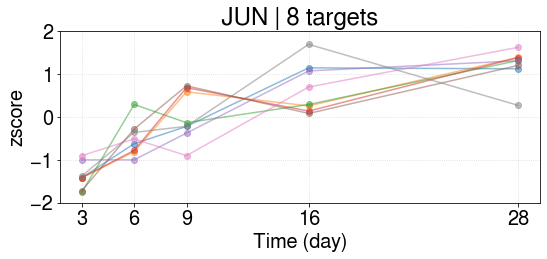

JUN | 3 [-1.37544858 -0.51066977  0.01655743  0.66998121  1.1995797 ]
----------------------------------------------------------
regulon FOXC2 72
['PDE1A', 'ENPP5', 'PTN', 'CPT1C', 'SLC7A2', 'ATP8B4', 'SUSD2', 'CFAP69', 'EFEMP1', 'ANTXR1', 'S1PR3', 'MCM5', 'CFD', 'LAMA4', 'CLDN11', 'SAMD11', 'CREG1', 'ADAM19', 'TFPI', 'IGF2', 'ATP10A', 'SNCG', 'C1QTNF1', 'OSR1', 'FBLN2', 'PRRX2', 'ELN', 'MGP', 'PTGIS', 'GYPC', 'INHBA', 'FBLN1', 'AK5', 'ANTXR2', 'ARSJ', 'LMCD1', 'SERPING1', 'BCL6', 'PGP', 'BRINP1', 'EBF1', 'CACNB2', 'DPT', 'CYP1B1', 'AXL', 'LRRC32', 'SLIT3', 'NRGN', 'SLC25A19', 'NTM', 'DPF3', 'GBP2', 'PCDH10', 'FRZB', 'MEDAG', 'CENPI', 'CSPG4', 'CNN1', 'TPM1', 'MGLL', 'PEAR1', 'MFAP4', 'MYLK', 'ECM2', 'FOXO1', 'GFRA1', 'AUNIP', 'LIMS2', 'LUM', 'MARC1', 'AMIGO2', 'B3GALT2']


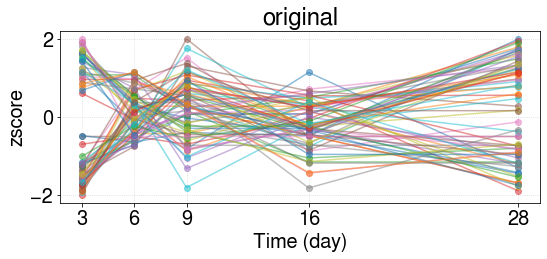

original data shape: (5, 72)
found subregulon: ['PTN', 'CPT1C', 'MCM5', 'CLDN11', 'ADAM19', 'ATP10A', 'SNCG', 'AK5', 'ARSJ', 'PGP', 'AXL', 'NRGN', 'SLC25A19', 'DPF3', 'PCDH10', 'CENPI', 'CSPG4', 'TPM1', 'MGLL', 'AUNIP', 'LIMS2'] 21 0.8251638431969748
found subregulon: ['FRZB', 'EBF1', 'SLC7A2', 'CFD', 'EFEMP1', 'ATP8B4', 'SERPING1', 'C1QTNF1', 'ECM2', 'FOXO1', 'DPT', 'BCL6', 'CACNB2', 'FBLN2', 'CREG1', 'MFAP4', 'PDE1A', 'MGP', 'IGF2', 'MEDAG', 'LUM', 'CFAP69', 'FBLN1', 'ENPP5', 'GYPC', 'ANTXR1', 'TFPI', 'MARC1', 'MYLK', 'LAMA4', 'PEAR1', 'LMCD1', 'PRRX2', 'ELN'] 34 0.8344592918678223
################################## FINAL
original size: 72; new size 55; lost: 17
PTN
CPT1C
MCM5
CLDN11
ADAM19
ATP10A
SNCG
AK5
ARSJ
PGP
AXL
NRGN
SLC25A19
DPF3
PCDH10
CENPI
CSPG4
TPM1
MGLL
AUNIP
LIMS2
sub ['PTN', 'CPT1C', 'MCM5', 'CLDN11', 'ADAM19', 'ATP10A', 'SNCG', 'AK5', 'ARSJ', 'PGP', 'AXL', 'NRGN', 'SLC25A19', 'DPF3', 'PCDH10', 'CENPI', 'CSPG4', 'TPM1', 'MGLL', 'AUNIP', 'LIMS2'] 21


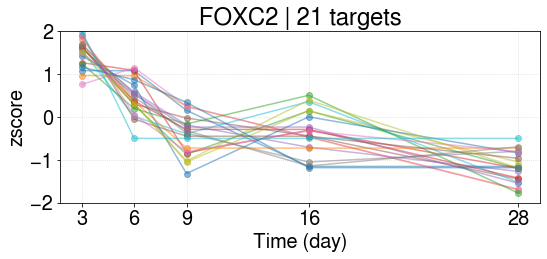

FOXC2 | 1 [ 1.5026423   0.457916   -0.40925625 -0.37708476 -1.1742173 ]
FRZB
EBF1
SLC7A2
CFD
EFEMP1
ATP8B4
SERPING1
C1QTNF1
ECM2
FOXO1
DPT
BCL6
CACNB2
FBLN2
CREG1
MFAP4
PDE1A
MGP
IGF2
MEDAG
LUM
CFAP69
FBLN1
ENPP5
GYPC
ANTXR1
TFPI
MARC1
MYLK
LAMA4
PEAR1
LMCD1
PRRX2
ELN
sub ['FRZB', 'EBF1', 'SLC7A2', 'CFD', 'EFEMP1', 'ATP8B4', 'SERPING1', 'C1QTNF1', 'ECM2', 'FOXO1', 'DPT', 'BCL6', 'CACNB2', 'FBLN2', 'CREG1', 'MFAP4', 'PDE1A', 'MGP', 'IGF2', 'MEDAG', 'LUM', 'CFAP69', 'FBLN1', 'ENPP5', 'GYPC', 'ANTXR1', 'TFPI', 'MARC1', 'MYLK', 'LAMA4', 'PEAR1', 'LMCD1', 'PRRX2', 'ELN'] 34


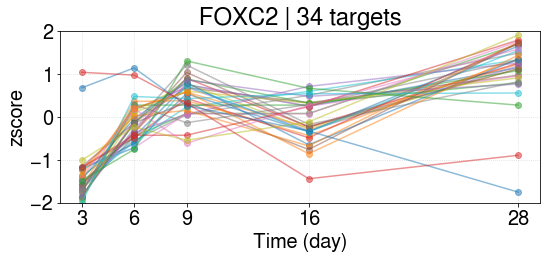

FOXC2 | 2 [-1.40766523 -0.10447977  0.44209594 -0.05111078  1.12115984]
----------------------------------------------------------
regulon TCF21 75
['TMEM100', 'PDE1A', 'PTN', 'GLI2', 'TK1', 'SLC2A5', 'EFEMP1', 'ANTXR1', 'XRCC2', 'NDNF', 'OSR2', 'LAMA4', 'SAMD11', 'ADAMTS10', 'DCN', 'MYO1B', 'CYBRD1', 'IGF2', 'RARRES2', 'A2M', 'CFH', 'SHCBP1', 'C1QTNF1', 'GGT5', 'FBLN2', 'PAMR1', 'LRRC17', 'ADH1B', 'ELN', 'MGP', 'FBLN1', 'SERPING1', 'ASPN', 'NCAPG2', 'GBE1', 'GPC6', 'FAM180A', 'DPT', 'PRCD', 'C7', 'CYGB', 'MAN1C1', 'SLIT3', 'SFRP1', 'SLIT2', 'CXCL12', 'ABCA9', 'FMOD', 'ARRB1', 'NCAM2', 'PCDH10', 'RSPO1', 'FRZB', 'PID1', 'PLD5', 'PLAT', 'CNN1', 'PEAR1', 'MFAP4', 'MYLK', 'PDGFRA', 'ECM2', 'SULF2', 'INSC', 'OLFML3', 'CAMK2N1', 'FBLN5', 'PCDH18', 'COL21A1', 'CSF1', 'LUM', 'SESN3', 'PMP22', 'ARHGAP6', 'SSPN']


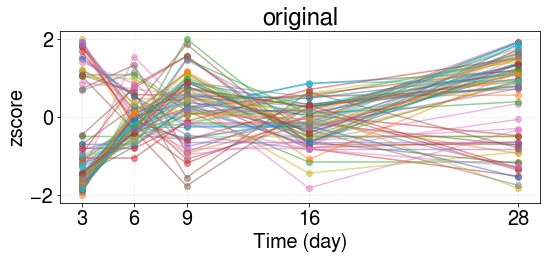

original data shape: (5, 75)
found subregulon: ['GLI2', 'TK1', 'XRCC2', 'MYO1B', 'SHCBP1', 'LRRC17', 'NCAPG2', 'FAM180A', 'SLIT2', 'ARRB1', 'PCDH10', 'PLD5', 'INSC', 'FBLN5'] 14 0.8218899710301927
found subregulon: ['COL21A1', 'DCN', 'FRZB', 'PDGFRA', 'SSPN', 'ARHGAP6', 'CYGB', 'MFAP4', 'ADH1B', 'SLIT3', 'GPC6', 'SERPING1', 'DPT', 'ECM2', 'SESN3', 'C7', 'GGT5', 'PMP22', 'EFEMP1', 'C1QTNF1', 'CFH', 'FBLN2', 'IGF2', 'PDE1A', 'NDNF', 'CYBRD1', 'FBLN1', 'TMEM100', 'LUM', 'PRCD', 'RARRES2', 'FMOD', 'NCAM2', 'CSF1', 'ANTXR1', 'OLFML3', 'PEAR1', 'MGP', 'MAN1C1', 'PTN', 'ASPN', 'ELN', 'CAMK2N1', 'CXCL12'] 44 0.8356230143044568
################################## FINAL
original size: 75; new size 58; lost: 17
GLI2
TK1
XRCC2
MYO1B
SHCBP1
LRRC17
NCAPG2
FAM180A
SLIT2
ARRB1
PCDH10
PLD5
INSC
FBLN5
sub ['GLI2', 'TK1', 'XRCC2', 'MYO1B', 'SHCBP1', 'LRRC17', 'NCAPG2', 'FAM180A', 'SLIT2', 'ARRB1', 'PCDH10', 'PLD5', 'INSC', 'FBLN5'] 14


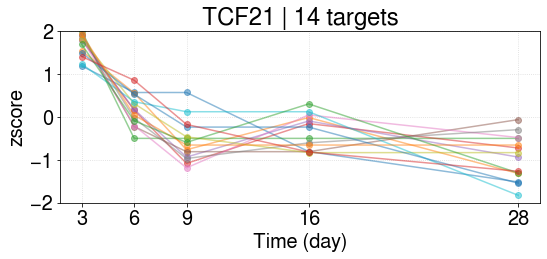

TCF21 | 1 [ 1.6788786   0.17864727 -0.54886468 -0.36151625 -0.94714494]
COL21A1
DCN
FRZB
PDGFRA
SSPN
ARHGAP6
CYGB
MFAP4
ADH1B
SLIT3
GPC6
SERPING1
DPT
ECM2
SESN3
C7
GGT5
PMP22
EFEMP1
C1QTNF1
CFH
FBLN2
IGF2
PDE1A
NDNF
CYBRD1
FBLN1
TMEM100
LUM
PRCD
RARRES2
FMOD
NCAM2
CSF1
ANTXR1
OLFML3
PEAR1
MGP
MAN1C1
PTN
ASPN
ELN
CAMK2N1
CXCL12
sub ['COL21A1', 'DCN', 'FRZB', 'PDGFRA', 'SSPN', 'ARHGAP6', 'CYGB', 'MFAP4', 'ADH1B', 'SLIT3', 'GPC6', 'SERPING1', 'DPT', 'ECM2', 'SESN3', 'C7', 'GGT5', 'PMP22', 'EFEMP1', 'C1QTNF1', 'CFH', 'FBLN2', 'IGF2', 'PDE1A', 'NDNF', 'CYBRD1', 'FBLN1', 'TMEM100', 'LUM', 'PRCD', 'RARRES2', 'FMOD', 'NCAM2', 'CSF1', 'ANTXR1', 'OLFML3', 'PEAR1', 'MGP', 'MAN1C1', 'PTN', 'ASPN', 'ELN', 'CAMK2N1', 'CXCL12'] 44


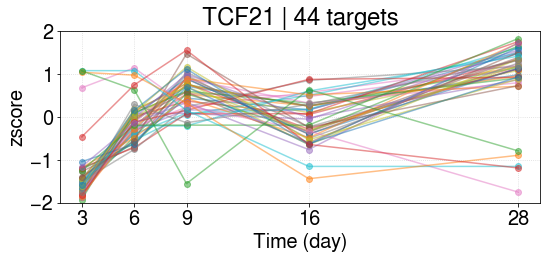

TCF21 | 2 [-1.32155728 -0.09458611  0.51473226 -0.0796267   0.98103782]
----------------------------------------------------------
regulon PRDM8 45
['C1S', 'PTN', 'GLI2', 'CFD', 'CHRDL1', 'DCN', 'ADAM19', 'ARMC9', 'PDGFRL', 'SMTN', 'TFPI', 'DAPK1', 'ABCA6', 'FIBIN', 'CCND2', 'CFH', 'PAK3', 'KCNMA1', 'RUNX2', 'ADAMTSL4', 'GYPC', 'PTGES', 'FBLN1', 'ANTXR2', 'ABI3BP', 'SERPING1', 'PODN', 'CNTNAP1', 'CACNB2', 'SLIT3', 'SLIT2', 'LRRK2', 'SLC2A6', 'CBX7', 'TPM1', 'PTGFR', 'PEAR1', 'PDGFRA', 'GFRA1', 'LIMS2', 'PCDH18', 'GAS1', 'ARHGAP6', 'SSBP2', 'SYT1']


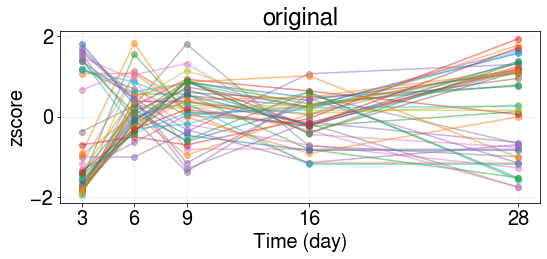

original data shape: (5, 45)
found subregulon: ['PTN', 'GLI2', 'ADAM19', 'PAK3', 'ABI3BP', 'CNTNAP1', 'SLIT2', 'TPM1', 'PEAR1', 'LIMS2'] 10 0.8229346682451152
found subregulon: ['DCN', 'C1S', 'CACNB2', 'PDGFRA', 'FBLN1', 'PDGFRL', 'CBX7', 'PTGFR', 'CFH', 'GYPC', 'PCDH18', 'GAS1', 'ADAMTSL4', 'CFD', 'GFRA1', 'SLIT3', 'RUNX2', 'FIBIN', 'SSBP2', 'ABCA6', 'ARMC9', 'CHRDL1'] 22 0.8297388535281632
################################## FINAL
original size: 45; new size 32; lost: 13
PTN
GLI2
ADAM19
PAK3
ABI3BP
CNTNAP1
SLIT2
TPM1
PEAR1
LIMS2
sub ['PTN', 'GLI2', 'ADAM19', 'PAK3', 'ABI3BP', 'CNTNAP1', 'SLIT2', 'TPM1', 'PEAR1', 'LIMS2'] 10


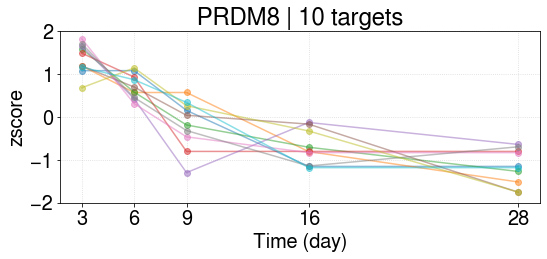

PRDM8 | 1 [ 1.35288963  0.70333142 -0.17145128 -0.72518378 -1.15958598]
DCN
C1S
CACNB2
PDGFRA
FBLN1
PDGFRL
CBX7
PTGFR
CFH
GYPC
PCDH18
GAS1
ADAMTSL4
CFD
GFRA1
SLIT3
RUNX2
FIBIN
SSBP2
ABCA6
ARMC9
CHRDL1
sub ['DCN', 'C1S', 'CACNB2', 'PDGFRA', 'FBLN1', 'PDGFRL', 'CBX7', 'PTGFR', 'CFH', 'GYPC', 'PCDH18', 'GAS1', 'ADAMTSL4', 'CFD', 'GFRA1', 'SLIT3', 'RUNX2', 'FIBIN', 'SSBP2', 'ABCA6', 'ARMC9', 'CHRDL1'] 22


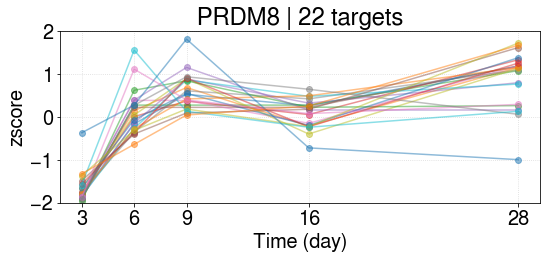

PRDM8 | 2 [-1.66990564  0.10513375  0.59775521  0.07639487  0.89062181]
----------------------------------------------------------
regulon NPAS3 31
['VEPH1', 'PDE1A', 'PTN', 'ANTXR1', 'LCA5', 'PLXDC2', 'LAMA4', 'CYBRD1', 'FAM110B', 'DAPK1', 'FIBIN', 'DDR2', 'NR1D2', 'SLC8A1', 'FBLN7', 'KIAA1755', 'AK5', 'MMP16', 'CTSO', 'MAN1C1', 'SLIT2', 'FRZB', 'TLR3', 'ECM2', 'OLFML3', 'GFRA1', 'CFI', 'COL21A1', 'BOC', 'SSPN', 'SSBP2']


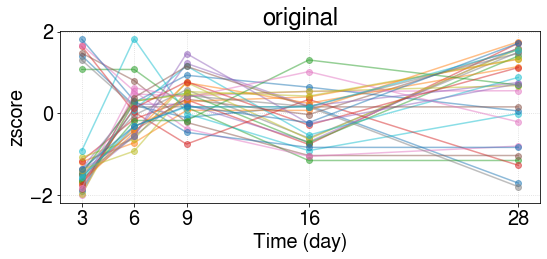

original data shape: (5, 31)
found subregulon: ['VEPH1', 'PTN', 'KIAA1755', 'AK5', 'MMP16', 'SLIT2'] 6 0.8411885522073965
found subregulon: ['ECM2', 'PLXDC2', 'DDR2', 'COL21A1', 'CYBRD1', 'SSPN', 'MAN1C1', 'CTSO', 'FBLN7', 'SSBP2', 'NR1D2', 'LAMA4', 'BOC', 'LCA5', 'GFRA1', 'OLFML3', 'PDE1A', 'FIBIN', 'ANTXR1', 'TLR3'] 20 0.824343159812475
################################## FINAL
original size: 31; new size 26; lost: 5
VEPH1
PTN
KIAA1755
AK5
MMP16
SLIT2
sub ['VEPH1', 'PTN', 'KIAA1755', 'AK5', 'MMP16', 'SLIT2'] 6


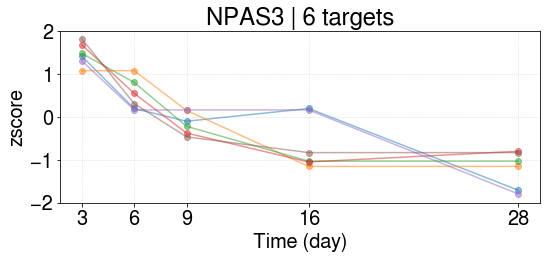

NPAS3 | 1 [ 1.46201556  0.51582965 -0.14099095 -0.61781923 -1.21903503]
ECM2
PLXDC2
DDR2
COL21A1
CYBRD1
SSPN
MAN1C1
CTSO
FBLN7
SSBP2
NR1D2
LAMA4
BOC
LCA5
GFRA1
OLFML3
PDE1A
FIBIN
ANTXR1
TLR3
sub ['ECM2', 'PLXDC2', 'DDR2', 'COL21A1', 'CYBRD1', 'SSPN', 'MAN1C1', 'CTSO', 'FBLN7', 'SSBP2', 'NR1D2', 'LAMA4', 'BOC', 'LCA5', 'GFRA1', 'OLFML3', 'PDE1A', 'FIBIN', 'ANTXR1', 'TLR3'] 20


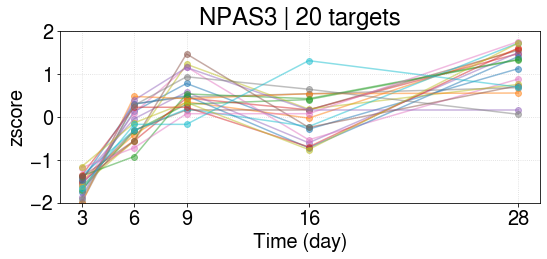

NPAS3 | 2 [-1.5680549  -0.14321645  0.55545453  0.02526363  1.13055319]
----------------------------------------------------------
regulon MSX1 59
['EBP', 'GRASP', 'MAP3K8', 'NRG1', 'ADA', 'ANKRD28', 'CFD', 'OSR2', 'OLFML2B', 'SAMHD1', 'SMAD6', 'PALM', 'FOSL1', 'G0S2', 'HMMR', 'SHCBP1', 'ANGPTL2', 'C1QTNF1', 'IL3RA', 'FBLN2', 'NES', 'PRRX2', 'ADH1B', 'JDP2', 'GYPC', 'INHBA', 'FBLN1', 'STIL', 'ACSL1', 'CNTNAP1', 'CREBRF', 'NCAPG2', 'PNRC1', 'CTXN1', 'CRISPLD2', 'DPT', 'CALM1', 'CYGB', 'TLR4', 'LRRC32', 'IFITM1', 'VGLL4', 'PRG4', 'SLC25A19', 'FMOD', 'NBL1', 'APOL6', 'MEDAG', 'INSC', 'HMGA1', 'IFITM3', 'ARHGAP18', 'CAMK2N1', 'CSF1', 'TOX2', 'GAS1', 'ACKR1', 'PMP22', 'DKK2']


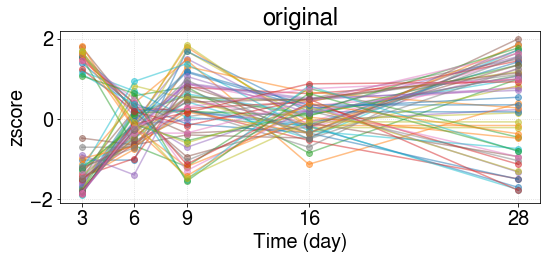

original data shape: (5, 59)
found subregulon: ['EBP', 'FOSL1', 'HMMR', 'SHCBP1', 'NES', 'STIL', 'CNTNAP1', 'NCAPG2', 'CTXN1', 'CALM1', 'SLC25A19', 'INSC', 'HMGA1', 'ARHGAP18', 'CAMK2N1', 'DKK2'] 16 0.8203781904567594
found subregulon: ['NBL1', 'CYGB', 'CFD', 'ANGPTL2', 'ADH1B', 'GAS1', 'SAMHD1', 'FBLN1', 'JDP2', 'PMP22', 'GYPC', 'PNRC1', 'FMOD', 'DPT', 'MEDAG', 'CREBRF', 'ACKR1', 'CRISPLD2', 'IFITM1', 'C1QTNF1', 'G0S2', 'FBLN2', 'IFITM3', 'VGLL4', 'ADA', 'CSF1', 'MAP3K8', 'TOX2', 'APOL6', 'OLFML2B', 'ANKRD28', 'PRRX2', 'TLR4', 'NRG1'] 34 0.8376057931688241
################################## FINAL
original size: 59; new size 50; lost: 9
EBP
FOSL1
HMMR
SHCBP1
NES
STIL
CNTNAP1
NCAPG2
CTXN1
CALM1
SLC25A19
INSC
HMGA1
ARHGAP18
CAMK2N1
DKK2
sub ['EBP', 'FOSL1', 'HMMR', 'SHCBP1', 'NES', 'STIL', 'CNTNAP1', 'NCAPG2', 'CTXN1', 'CALM1', 'SLC25A19', 'INSC', 'HMGA1', 'ARHGAP18', 'CAMK2N1', 'DKK2'] 16


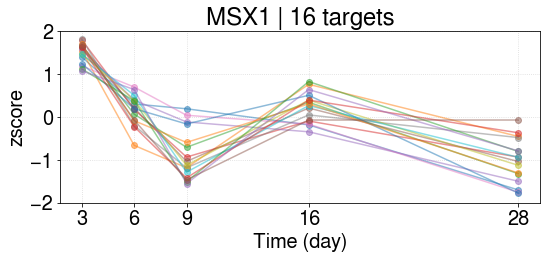

MSX1 | 1 [ 1.49690402  0.16775107 -0.87906443  0.23719157 -1.02278224]
NBL1
CYGB
CFD
ANGPTL2
ADH1B
GAS1
SAMHD1
FBLN1
JDP2
PMP22
GYPC
PNRC1
FMOD
DPT
MEDAG
CREBRF
ACKR1
CRISPLD2
IFITM1
C1QTNF1
G0S2
FBLN2
IFITM3
VGLL4
ADA
CSF1
MAP3K8
TOX2
APOL6
OLFML2B
ANKRD28
PRRX2
TLR4
NRG1
sub ['NBL1', 'CYGB', 'CFD', 'ANGPTL2', 'ADH1B', 'GAS1', 'SAMHD1', 'FBLN1', 'JDP2', 'PMP22', 'GYPC', 'PNRC1', 'FMOD', 'DPT', 'MEDAG', 'CREBRF', 'ACKR1', 'CRISPLD2', 'IFITM1', 'C1QTNF1', 'G0S2', 'FBLN2', 'IFITM3', 'VGLL4', 'ADA', 'CSF1', 'MAP3K8', 'TOX2', 'APOL6', 'OLFML2B', 'ANKRD28', 'PRRX2', 'TLR4', 'NRG1'] 34


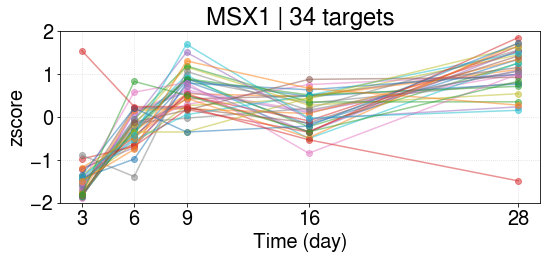

MSX1 | 2 [-1.47473645 -0.2572948   0.60406193  0.09319548  1.03477384]
----------------------------------------------------------
regulon PRRX2 151
['EBP', 'CPT1C', 'C1S', 'MAP3K8', 'NRG1', 'NT5E', 'RRM2', 'PTGER2', 'RARRES2', 'SHCBP1', 'ANGPTL2', 'STOM', 'PTGIS', 'FNDC1', 'FBLN1', 'THBS2', 'PGP', 'PFKP', 'CREBRF', 'PNRC1', 'CYP1B1', 'DPT', 'KCNK15', 'CALM1', 'IFITM1', 'NRGN', 'APOL6', 'BTBD3', 'IFITM3', 'ARHGAP18', 'NOG', 'SECTM1', 'PTPRM', 'CILP2', 'ANKRD28', 'EFEMP1', 'FOXC2', 'SAMHD1', 'ADAM19', 'CLDN11', 'PALM', 'IGF2', 'CH25H', 'G0S2', 'HMMR', 'RRM1', 'FBLN2', 'VLDLR', 'PAMR1', 'ADH1B', 'FAM20A', 'FBLN7', 'PTGES', 'STIL', 'ARSJ', 'ABI3BP', 'LMCD1', 'TGFBI', 'CNTNAP1', 'ACSL1', 'CXCL8', 'HSD11B1', 'TNC', 'PRG4', 'SLC25A19', 'PXN', 'LBP', 'TUBB6', 'NBL1', 'AHNAK2', 'APOL1', 'MFAP4', 'HMGA1', 'MAOA', 'CAMK2N1', 'SPRED3', 'CSF1', 'MARC1', 'SEMA7A', 'BOC', 'SERPINF1', 'CFD', 'DUSP4', 'PLXDC2', 'SAMD11', 'PDGFRL', 'COMP', 'CCND2', 'A2M', 'KIRREL3', 'CRLF1', 'MGP', 'INHBA', 'SNED1', 'CT

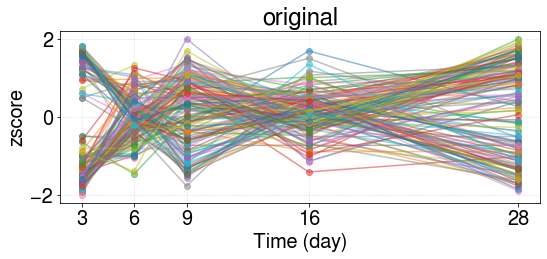

original data shape: (5, 151)
found subregulon: ['EBP', 'NRG1', 'NT5E', 'RRM2', 'SHCBP1', 'PGP', 'PFKP', 'CALM1', 'NRGN', 'ARHGAP18', 'FOXC2', 'ADAM19', 'CLDN11', 'HMMR', 'RRM1', 'PAMR1', 'STIL', 'ARSJ', 'ABI3BP', 'CNTNAP1', 'SLC25A19', 'PXN', 'TUBB6', 'AHNAK2', 'HMGA1', 'CAMK2N1', 'SPRED3', 'SEMA7A', 'KIRREL3', 'CTXN1', 'EPHB2', 'DNMT1', 'INSC', 'DKK2', 'SHB', 'KIF18A', 'TSPAN13', 'LOXL2', 'NOP56', 'TUBB3', 'S100A16', 'TIAM1', 'PKMYT1', 'NCAPG2'] 44 0.8257348623028833
found subregulon: ['ANKRD28', 'A2M', 'CHI3L2', 'PRG4', 'VLDLR', 'SFRP1', 'CCND2', 'INHBA', 'TNC'] 9 0.8219813351352347
found subregulon: ['IL1R1', 'ADH1B', 'SERPINF1', 'THBS2', 'SAMHD1', 'PTGFR', 'C1S', 'KCNK15', 'CFD', 'CYGB', 'FGF7', 'ACSL1', 'NBL1', 'MFAP4', 'IGF2', 'EFEMP1', 'ANGPTL2', 'FBLN1', 'RTN4RL2', 'PLAU', 'CFH', 'NEBL', 'PLXDC2', 'PNRC1', 'PDGFRL', 'MARC1', 'STOM', 'CREBRF', 'FMOD', 'TNFRSF19', 'NOG', 'CADM3', 'APOL1', 'LUM', 'FBLN7', 'IFITM1', 'DPT', 'C1R', 'C1QTNF1', 'BOC', 'MEDAG', 'MGP', 'PODNL1', 'MAOA',

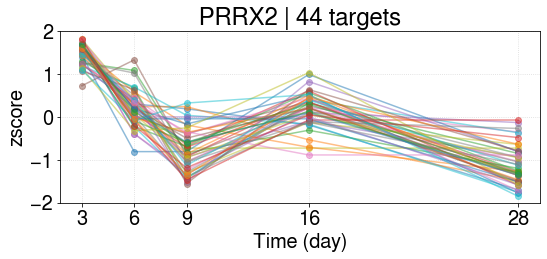

PRRX2 | 1 [ 1.50023975  0.20524328 -0.75892045  0.16772539 -1.11428797]
ANKRD28
A2M
CHI3L2
PRG4
VLDLR
SFRP1
CCND2
INHBA
TNC
sub ['ANKRD28', 'A2M', 'CHI3L2', 'PRG4', 'VLDLR', 'SFRP1', 'CCND2', 'INHBA', 'TNC'] 9


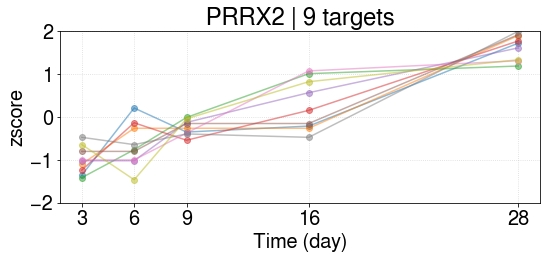

PRRX2 | 2 [-1.00603002 -0.65447254 -0.25255826  0.27821303  1.63484779]
IL1R1
ADH1B
SERPINF1
THBS2
SAMHD1
PTGFR
C1S
KCNK15
CFD
CYGB
FGF7
ACSL1
NBL1
MFAP4
IGF2
EFEMP1
ANGPTL2
FBLN1
RTN4RL2
PLAU
CFH
NEBL
PLXDC2
PNRC1
PDGFRL
MARC1
STOM
CREBRF
FMOD
TNFRSF19
NOG
CADM3
APOL1
LUM
FBLN7
IFITM1
DPT
C1R
C1QTNF1
BOC
MEDAG
MGP
PODNL1
MAOA
IFITM3
PTPRM
CSF1
LMCD1
LAMA4
FBLN2
SULF2
G0S2
TLR4
PAPPA
MAP3K8
RARRES2
ADA
HSD11B1
C3
GALNT15
LBP
PTGIS
APOL6
CHI3L1
CRLF1
CH25H
ANTXR1
KIAA1217
CPT1C
sub ['IL1R1', 'ADH1B', 'SERPINF1', 'THBS2', 'SAMHD1', 'PTGFR', 'C1S', 'KCNK15', 'CFD', 'CYGB', 'FGF7', 'ACSL1', 'NBL1', 'MFAP4', 'IGF2', 'EFEMP1', 'ANGPTL2', 'FBLN1', 'RTN4RL2', 'PLAU', 'CFH', 'NEBL', 'PLXDC2', 'PNRC1', 'PDGFRL', 'MARC1', 'STOM', 'CREBRF', 'FMOD', 'TNFRSF19', 'NOG', 'CADM3', 'APOL1', 'LUM', 'FBLN7', 'IFITM1', 'DPT', 'C1R', 'C1QTNF1', 'BOC', 'MEDAG', 'MGP', 'PODNL1', 'MAOA', 'IFITM3', 'PTPRM', 'CSF1', 'LMCD1', 'LAMA4', 'FBLN2', 'SULF2', 'G0S2', 'TLR4', 'PAPPA', 'MAP3K8', 'RARRES2', 'ADA', 'HSD11B1

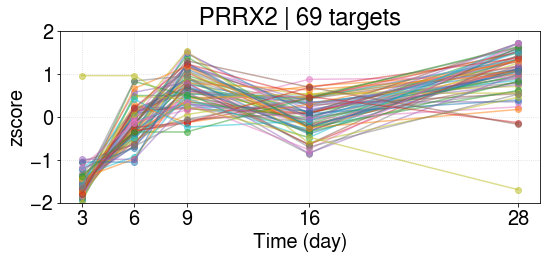

PRRX2 | 3 [-1.57206065 -0.15026017  0.64443861  0.03518402  1.04269819]
----------------------------------------------------------
regulon TCF7L1 106
['PDE1A', 'GLI2', 'NRG1', 'MCC', 'THOP1', 'RARRES2', 'ANGPTL2', 'ARHGAP11B', 'NUPR1', 'PTGIS', 'GYPC', 'ANTXR2', 'HCFC1R1', 'OVGP1', 'POP1', 'LOXL4', 'DPT', 'STON1', 'EIF4EBP3', 'PKIG', 'CCDC69', 'PEAR1', 'PLPP1', 'SFXN2', 'ARHGAP6', 'MCM2', 'ANKRD28', 'EFEMP1', 'CHAC2', 'PALM', 'CYBRD1', 'IGF2', 'FAM110B', 'POLE', 'SNCG', 'GALNT6', 'FBLN2', 'TIMP4', 'FBXO5', 'KIAA1755', 'PODN', 'ABI3BP', 'PPIL6', 'CXCL8', 'HSD11B1', 'RAB27B', 'AXL', 'SLIT2', 'MLPH', 'FRZB', 'TLR3', 'TGFBR3', 'MAOA', 'CAMK2N1', 'SNN', 'CSMD2', 'BOC', 'PLEKHH2', 'CYP27A1', 'SSBP2', 'ZCCHC24', 'B4GALNT1', 'MCM5', 'PDGFRL', 'SMTN', 'RHOQ', 'OLFML2A', 'MGP', 'LAYN', 'EBF1', 'DDIT4L', 'FBLN5', 'SMAD6', 'PMP22', 'USP53', 'C1R', 'PRKAR1B', 'EYA2', 'ANTXR1', 'TLE2', 'LAMA4', 'ADAMTS10', 'SH3BP1', 'PTH1R', 'TSPAN15', 'LOXL2', 'KCNMA1', 'MAP3K12', 'SLC29A1', 'KIF14', 'TUBB3', 'HMCN

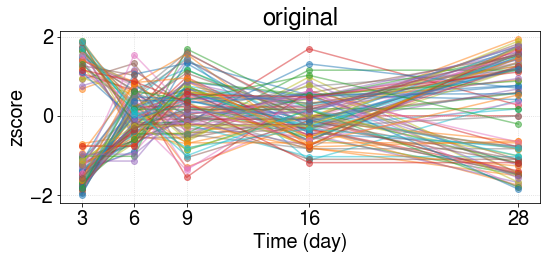

original data shape: (5, 106)
found subregulon: ['NRG1', 'THOP1', 'ARHGAP11B', 'POP1', 'SFXN2', 'MCM2', 'CHAC2', 'POLE', 'GALNT6', 'FBXO5', 'KIAA1755', 'ABI3BP', 'AXL', 'SLIT2', 'MLPH', 'B4GALNT1', 'MCM5', 'SMTN', 'FBLN5', 'PRKAR1B', 'SH3BP1', 'LOXL2', 'KCNMA1', 'SLC29A1', 'KIF14', 'TUBB3', 'CLSPN', 'CSPG4'] 28 0.825929774088721
found subregulon: ['ANGPTL2', 'SSPN', 'PKIG', 'TLE2', 'NUPR1', 'CCDC69', 'FRZB', 'SSBP2', 'EBF1', 'CYGB', 'EIF4EBP3', 'ARHGAP6', 'EFEMP1', 'DPT', 'PDGFRL', 'CYBRD1', 'MAOA', 'HTRA1', 'PLPP1', 'MCC', 'FBLN2', 'CBX7', 'PDE1A', 'IGF2', 'RHOQ', 'PMP22', 'BOC', 'OLFML2A', 'HMCN1', 'TIMP4', 'LAYN', 'HSD11B1', 'STON1', 'IL1R2', 'RAB27B', 'FAM110B', 'GYPC', 'MGP', 'ANTXR1', 'ZCCHC24', 'RARRES2', 'TSPAN15', 'NPY2R', 'C1R', 'ANKRD28', 'HCFC1R1', 'CNR1', 'SNN', 'PLEKHH2', 'LAMA4', 'TGFBR3', 'PPIL6', 'DDIT4L', 'EYA2', 'TLR3', 'PTH1R', 'OVGP1'] 57 0.8383992028789727
################################## FINAL
original size: 106; new size 85; lost: 21
NRG1
THOP1
ARHGAP11B
POP1


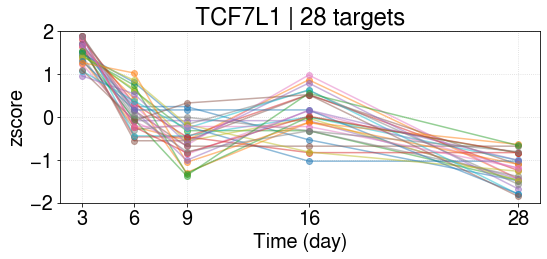

TCF7L1 | 1 [ 1.53763133  0.16299694 -0.5111925   0.03571078 -1.22514655]
ANGPTL2
SSPN
PKIG
TLE2
NUPR1
CCDC69
FRZB
SSBP2
EBF1
CYGB
EIF4EBP3
ARHGAP6
EFEMP1
DPT
PDGFRL
CYBRD1
MAOA
HTRA1
PLPP1
MCC
FBLN2
CBX7
PDE1A
IGF2
RHOQ
PMP22
BOC
OLFML2A
HMCN1
TIMP4
LAYN
HSD11B1
STON1
IL1R2
RAB27B
FAM110B
GYPC
MGP
ANTXR1
ZCCHC24
RARRES2
TSPAN15
NPY2R
C1R
ANKRD28
HCFC1R1
CNR1
SNN
PLEKHH2
LAMA4
TGFBR3
PPIL6
DDIT4L
EYA2
TLR3
PTH1R
OVGP1
sub ['ANGPTL2', 'SSPN', 'PKIG', 'TLE2', 'NUPR1', 'CCDC69', 'FRZB', 'SSBP2', 'EBF1', 'CYGB', 'EIF4EBP3', 'ARHGAP6', 'EFEMP1', 'DPT', 'PDGFRL', 'CYBRD1', 'MAOA', 'HTRA1', 'PLPP1', 'MCC', 'FBLN2', 'CBX7', 'PDE1A', 'IGF2', 'RHOQ', 'PMP22', 'BOC', 'OLFML2A', 'HMCN1', 'TIMP4', 'LAYN', 'HSD11B1', 'STON1', 'IL1R2', 'RAB27B', 'FAM110B', 'GYPC', 'MGP', 'ANTXR1', 'ZCCHC24', 'RARRES2', 'TSPAN15', 'NPY2R', 'C1R', 'ANKRD28', 'HCFC1R1', 'CNR1', 'SNN', 'PLEKHH2', 'LAMA4', 'TGFBR3', 'PPIL6', 'DDIT4L', 'EYA2', 'TLR3', 'PTH1R', 'OVGP1'] 57


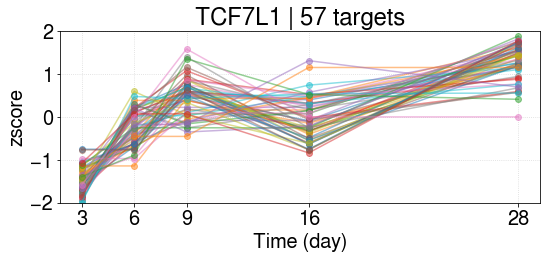

TCF7L1 | 2 [-1.49448611e+00 -2.42444672e-01  4.47675899e-01 -7.87560049e-04
  1.29004244e+00]
----------------------------------------------------------
regulon GLIS1 43
['PODNL1', 'GLI2', 'NRG1', 'CHAF1B', 'DHRS3', 'C21orf58', 'CHRDL1', 'CHRDL2', 'OSR2', 'CFD', 'PPARG', 'SMAD6', 'E2F8', 'PALM', 'WDR86', 'CDC25A', 'FSD1', 'MYO1D', 'PRRX2', 'FBLN7', 'PTGDS', 'FBLN1', 'PODN', 'ABI3BP', 'LYPD6', 'DPT', 'PRCD', 'PTK2B', 'SMOC1', 'NBL1', 'RSPO1', 'ZWILCH', 'CBX7', 'PSRC1', 'MGLL', 'FST', 'PTPRF', 'HMGA1', 'C6', 'ITPRIPL1', 'KLF11', 'BOC', 'SSPN']


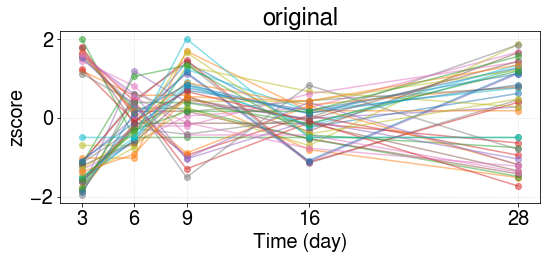

original data shape: (5, 43)
found subregulon: ['GLI2', 'NRG1', 'CHAF1B', 'C21orf58', 'E2F8', 'CDC25A', 'FSD1', 'ABI3BP', 'LYPD6', 'ZWILCH', 'MGLL', 'PTPRF'] 12 0.842855427055428
found subregulon: ['NBL1', 'PTGDS', 'PPARG', 'FST', 'KLF11', 'FBLN7', 'FBLN1', 'DPT', 'PODNL1', 'CBX7', 'SMOC1', 'RSPO1', 'WDR86', 'SSPN', 'C6', 'BOC', 'CHRDL2', 'CHRDL1'] 18 0.8600599418462938
################################## FINAL
original size: 43; new size 30; lost: 13
GLI2
NRG1
CHAF1B
C21orf58
E2F8
CDC25A
FSD1
ABI3BP
LYPD6
ZWILCH
MGLL
PTPRF
sub ['GLI2', 'NRG1', 'CHAF1B', 'C21orf58', 'E2F8', 'CDC25A', 'FSD1', 'ABI3BP', 'LYPD6', 'ZWILCH', 'MGLL', 'PTPRF'] 12


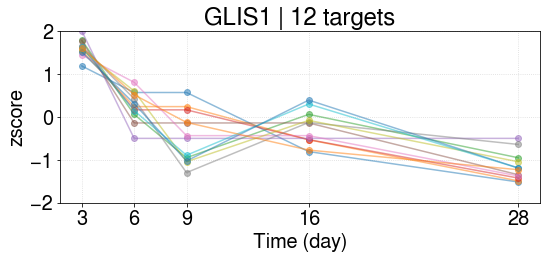

GLIS1 | 1 [ 1.61049419  0.26586408 -0.45363849 -0.26498733 -1.15773244]
NBL1
PTGDS
PPARG
FST
KLF11
FBLN7
FBLN1
DPT
PODNL1
CBX7
SMOC1
RSPO1
WDR86
SSPN
C6
BOC
CHRDL2
CHRDL1
sub ['NBL1', 'PTGDS', 'PPARG', 'FST', 'KLF11', 'FBLN7', 'FBLN1', 'DPT', 'PODNL1', 'CBX7', 'SMOC1', 'RSPO1', 'WDR86', 'SSPN', 'C6', 'BOC', 'CHRDL2', 'CHRDL1'] 18


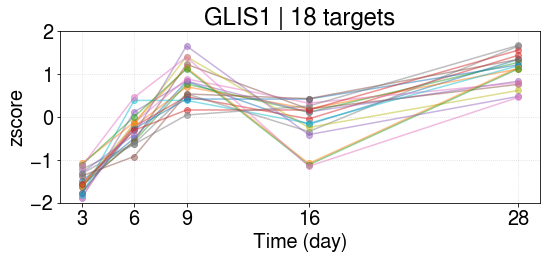

GLIS1 | 2 [-1.50855035 -0.26374004  0.80558245 -0.14220034  1.10890827]
----------------------------------------------------------
regulon RUNX2 13
['HMCN1', 'DOCK10', 'ATP8B4', 'PTPRM', 'NRG1', 'PAPPA', 'TENM2', 'KIAA1217', 'PPARG', 'NABP1', 'MMP13', 'IBSP', 'ALCAM']


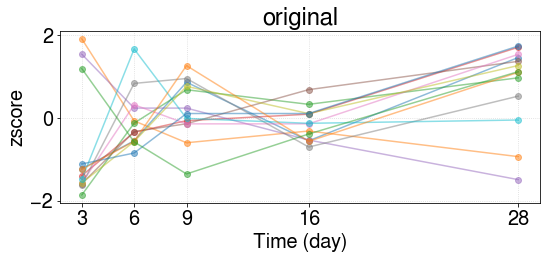

original data shape: (5, 13)
found subregulon: ['ATP8B4', 'PTPRM', 'TENM2', 'HMCN1', 'PAPPA', 'KIAA1217', 'MMP13', 'IBSP'] 8 0.830059528545524
################################## FINAL
original size: 13; new size 8; lost: 5
ATP8B4
PTPRM
TENM2
HMCN1
PAPPA
KIAA1217
MMP13
IBSP
sub ['ATP8B4', 'PTPRM', 'TENM2', 'HMCN1', 'PAPPA', 'KIAA1217', 'MMP13', 'IBSP'] 8


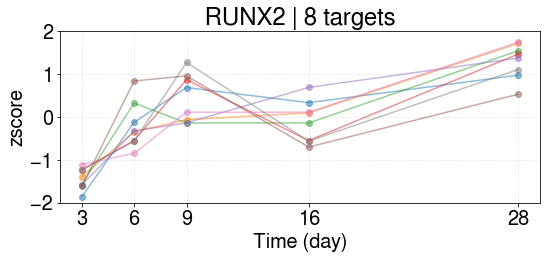

RUNX2 | 1 [-1.45247928 -0.20005327  0.44190561 -0.09242628  1.30305323]
----------------------------------------------------------
regulon GLIS2 92
['UHRF1', 'GLI2', 'NRG1', 'DHRS3', 'ARMC9', 'FSD1', 'RARRES2', 'ANGPTL2', 'JDP2', 'PTGIS', 'GYPC', 'FBLN1', 'HCFC1R1', 'THBS2', 'LOXL4', 'DPT', 'KCNK15', 'MAN1C1', 'NRGN', 'CALCOCO2', 'NCAM2', 'PKIG', 'FAM89A', 'IFITM3', 'KLF11', 'DUSP5', 'FOXC2', 'ZNF503', 'ADAM19', 'PALM', 'FAM110B', 'SYNJ2', 'PRRX2', 'GINS4', 'KIAA1755', 'ARSJ', 'CNTNAP1', 'ADAMTS12', 'NINJ1', 'TUBB6', 'NBL1', 'B4GALNT4', 'MFAP4', 'MAOA', 'BIRC5', 'CSF1', 'BOC', 'ZCCHC24', 'RBL1', 'GNB3', 'B4GALNT1', 'SAMD11', 'PDGFRL', 'WDR86', 'FOSL1', 'CCND2', 'KIRREL3', 'RHOQ', 'MGP', 'INHBA', 'CDT1', 'CTXN1', 'LRRC32', 'EPHB2', 'CDH2', 'PLAU', 'STX1A', 'FGF7', 'ANTXR1', 'TLE2', 'PLCB3', 'DCN', 'RTN4RL2', 'ITGA3', 'CADM3', 'TSPAN15', 'LOXL2', 'PRXL2B', 'SLC29A1', 'SERPINE2', 'ASPN', 'CYGB', 'HTRA1', 'PTK2B', 'FMOD', 'LSP1', 'C11orf95', 'PLAT', 'FAM20C', 'ROR2', 'SLC19A1', 'LAYN']


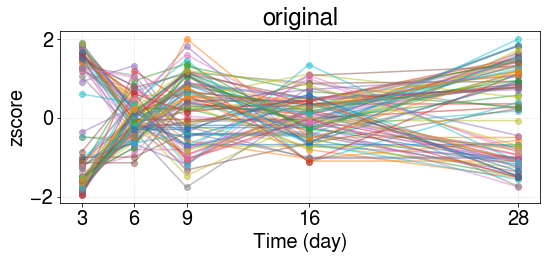

original data shape: (5, 92)
found subregulon: ['UHRF1', 'GLI2', 'NRG1', 'FSD1', 'LOXL4', 'NRGN', 'ADAM19', 'SYNJ2', 'GINS4', 'KIAA1755', 'ARSJ', 'CNTNAP1', 'ADAMTS12', 'TUBB6', 'BIRC5', 'RBL1', 'GNB3', 'B4GALNT1', 'KIRREL3', 'CDT1', 'CTXN1', 'EPHB2', 'CDH2', 'PLCB3', 'ITGA3', 'LOXL2', 'PRXL2B', 'SLC29A1', 'SLC19A1'] 29 0.8253219491163835
found subregulon: ['HTRA1', 'DCN', 'KCNK15', 'KLF11', 'FBLN1', 'THBS2', 'MFAP4', 'RTN4RL2', 'PLAU', 'FGF7', 'NBL1', 'CYGB', 'PKIG', 'ZCCHC24', 'GYPC', 'TLE2', 'ANGPTL2', 'FMOD', 'LAYN', 'PDGFRL', 'HCFC1R1', 'FAM89A', 'MAN1C1', 'CADM3', 'ASPN', 'JDP2', 'IFITM3', 'DPT', 'MGP', 'BOC', 'PTGIS', 'FAM110B', 'PTK2B', 'CSF1', 'WDR86', 'PRRX2', 'ANTXR1', 'NINJ1', 'PALM', 'RARRES2', 'DHRS3', 'ZNF503'] 42 0.8466384689220795
################################## FINAL
original size: 92; new size 71; lost: 21
UHRF1
GLI2
NRG1
FSD1
LOXL4
NRGN
ADAM19
SYNJ2
GINS4
KIAA1755
ARSJ
CNTNAP1
ADAMTS12
TUBB6
BIRC5
RBL1
GNB3
B4GALNT1
KIRREL3
CDT1
CTXN1
EPHB2
CDH2
PLCB3
ITGA3
LOXL2

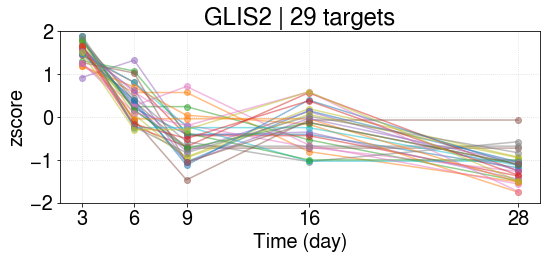

GLIS2 | 1 [ 1.55799859  0.31258557 -0.49972806 -0.21266228 -1.15819382]
HTRA1
DCN
KCNK15
KLF11
FBLN1
THBS2
MFAP4
RTN4RL2
PLAU
FGF7
NBL1
CYGB
PKIG
ZCCHC24
GYPC
TLE2
ANGPTL2
FMOD
LAYN
PDGFRL
HCFC1R1
FAM89A
MAN1C1
CADM3
ASPN
JDP2
IFITM3
DPT
MGP
BOC
PTGIS
FAM110B
PTK2B
CSF1
WDR86
PRRX2
ANTXR1
NINJ1
PALM
RARRES2
DHRS3
ZNF503
sub ['HTRA1', 'DCN', 'KCNK15', 'KLF11', 'FBLN1', 'THBS2', 'MFAP4', 'RTN4RL2', 'PLAU', 'FGF7', 'NBL1', 'CYGB', 'PKIG', 'ZCCHC24', 'GYPC', 'TLE2', 'ANGPTL2', 'FMOD', 'LAYN', 'PDGFRL', 'HCFC1R1', 'FAM89A', 'MAN1C1', 'CADM3', 'ASPN', 'JDP2', 'IFITM3', 'DPT', 'MGP', 'BOC', 'PTGIS', 'FAM110B', 'PTK2B', 'CSF1', 'WDR86', 'PRRX2', 'ANTXR1', 'NINJ1', 'PALM', 'RARRES2', 'DHRS3', 'ZNF503'] 42


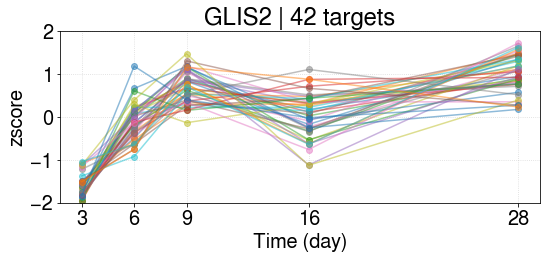

GLIS2 | 2 [-1.63055762 -0.12585311  0.70002463  0.04472197  1.01166412]
----------------------------------------------------------
regulon GLIS3 90
['C1S', 'PLEKHG5', 'GLI2', 'TFPI2', 'RAB31', 'DHRS3', 'ARMC9', 'STOM', 'CYP19A1', 'SPON1', 'THBS2', 'PNRC1', 'CYP1B1', 'CRISPLD2', 'KCNK15', 'GLIPR1', 'NCAM2', 'HMGA2', 'IFITM3', 'PLSCR1', 'ACKR1', 'EPS8', 'SLC7A2', 'EFEMP1', 'FAM110B', 'PRRX2', 'GINS4', 'KIAA1755', 'SERPING1', 'HSPA5', 'TEAD4', 'TGFBR3', 'PDGFRA', 'HMGA1', 'SPRY1', 'CAMK2N1', 'SPRED3', 'CSF1', 'FIGNL1', 'LDLRAD3', 'S1PR3', 'SMTN', 'A2M', 'RHOQ', 'PAQR4', 'INHBA', 'EPAS1', 'ADM', 'KCNT2', 'LYPD6', 'LRRC32', 'DCBLD2', 'SLC22A15', 'PROS1', 'NTM', 'SOD2', 'FGF7', 'SVEP1', 'C1R', 'MAP2K6', 'EPHB6', 'ANTXR1', 'IL1R1', 'CHI3L1', 'RCN1', 'TFPI', 'CFH', 'LOXL2', 'PRXL2B', 'CXCL6', 'ACSS3', 'GJA1', 'SLC29A1', 'SERPINE2', 'HSBP1L1', 'PAPPA', 'C7', 'PTK2B', 'VGLL4', 'FMOD', 'RAP1B', 'STMN1', 'LSP1', 'MEDAG', 'CBX7', 'PCSK1', 'PTGFR', 'SULF2', 'ROR2', 'LAYN']


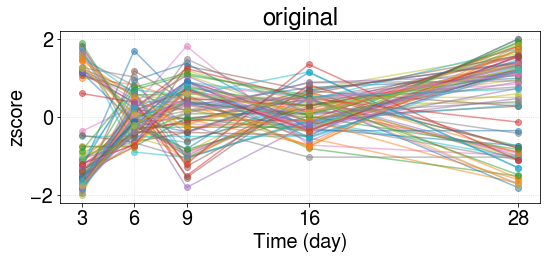

original data shape: (5, 90)
found subregulon: ['TFPI2', 'GLIPR1', 'HMGA2', 'GINS4', 'TEAD4', 'HMGA1', 'CAMK2N1', 'SPRED3', 'FIGNL1', 'S1PR3', 'SMTN', 'PAQR4', 'LYPD6', 'DCBLD2', 'LOXL2', 'PRXL2B', 'SLC29A1', 'SERPINE2', 'STMN1'] 19 0.8351360462864661
found subregulon: ['EPS8', 'SLC22A15', 'TFPI', 'LDLRAD3', 'INHBA', 'SPON1', 'CYP19A1'] 7 0.8665316361790373
found subregulon: ['SERPING1', 'PROS1', 'IL1R1', 'PLSCR1', 'ADM', 'PTGFR', 'KCNK15', 'PDGFRA', 'MAP2K6', 'RCN1', 'FGF7', 'C1S', 'THBS2', 'EPAS1', 'FMOD', 'EFEMP1', 'SOD2', 'PNRC1', 'CFH', 'ACKR1', 'CBX7', 'C1R', 'STOM', 'HSBP1L1', 'GJA1', 'CSF1', 'RAP1B', 'IFITM3', 'CRISPLD2', 'KCNT2', 'RAB31', 'SPRY1', 'LAYN', 'PTK2B', 'SULF2', 'SLC7A2', 'PRRX2', 'SVEP1', 'CHI3L1', 'PAPPA', 'CYP1B1', 'PLEKHG5', 'C7', 'LSP1', 'DHRS3', 'GLI2', 'LRRC32'] 47 0.8249662036815205
################################## FINAL
original size: 90; new size 73; lost: 17
TFPI2
GLIPR1
HMGA2
GINS4
TEAD4
HMGA1
CAMK2N1
SPRED3
FIGNL1
S1PR3
SMTN
PAQR4
LYPD6
DCBLD2
LOXL2
P

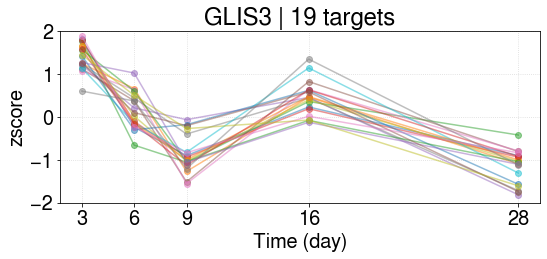

GLIS3 | 1 [ 1.40625999  0.15620417 -0.86677832  0.4480894  -1.14377523]
EPS8
SLC22A15
TFPI
LDLRAD3
INHBA
SPON1
CYP19A1
sub ['EPS8', 'SLC22A15', 'TFPI', 'LDLRAD3', 'INHBA', 'SPON1', 'CYP19A1'] 7


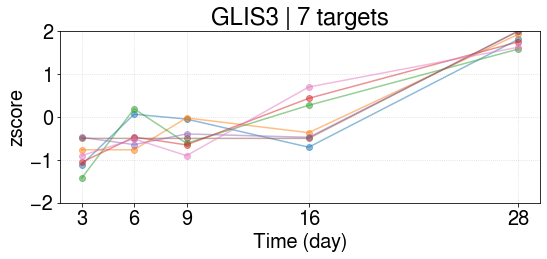

GLIS3 | 2 [-0.89066297 -0.37742837 -0.44830911 -0.0929753   1.80937574]
SERPING1
PROS1
IL1R1
PLSCR1
ADM
PTGFR
KCNK15
PDGFRA
MAP2K6
RCN1
FGF7
C1S
THBS2
EPAS1
FMOD
EFEMP1
SOD2
PNRC1
CFH
ACKR1
CBX7
C1R
STOM
HSBP1L1
GJA1
CSF1
RAP1B
IFITM3
CRISPLD2
KCNT2
RAB31
SPRY1
LAYN
PTK2B
SULF2
SLC7A2
PRRX2
SVEP1
CHI3L1
PAPPA
CYP1B1
PLEKHG5
C7
LSP1
DHRS3
GLI2
LRRC32
sub ['SERPING1', 'PROS1', 'IL1R1', 'PLSCR1', 'ADM', 'PTGFR', 'KCNK15', 'PDGFRA', 'MAP2K6', 'RCN1', 'FGF7', 'C1S', 'THBS2', 'EPAS1', 'FMOD', 'EFEMP1', 'SOD2', 'PNRC1', 'CFH', 'ACKR1', 'CBX7', 'C1R', 'STOM', 'HSBP1L1', 'GJA1', 'CSF1', 'RAP1B', 'IFITM3', 'CRISPLD2', 'KCNT2', 'RAB31', 'SPRY1', 'LAYN', 'PTK2B', 'SULF2', 'SLC7A2', 'PRRX2', 'SVEP1', 'CHI3L1', 'PAPPA', 'CYP1B1', 'PLEKHG5', 'C7', 'LSP1', 'DHRS3', 'GLI2', 'LRRC32'] 47


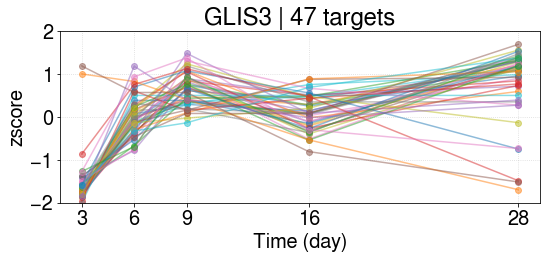

GLIS3 | 3 [-1.55635453e+00  1.05858308e-03  6.43703411e-01  1.13120135e-01
  7.98472398e-01]
----------------------------------------------------------
regulon EGR1 16
['PLAU', 'PTGES', 'TFPI2', 'TMPO', 'PPARG', 'SPRY1', 'ANGPTL4', 'UBE2S', 'GDF15', 'IL6', 'CDKN1A', 'IGF2', 'CEBPB', 'STMN1', 'FOSL1', 'STIM1']


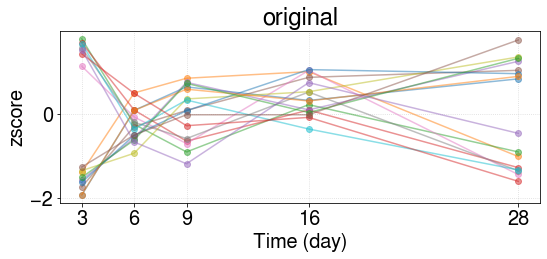

original data shape: (5, 16)
found subregulon: ['TFPI2', 'TMPO', 'ANGPTL4', 'UBE2S', 'IL6', 'STMN1'] 6 0.8642006268616401
found subregulon: ['IGF2', 'PLAU', 'SPRY1', 'CEBPB', 'GDF15'] 5 0.9268430082356054
################################## FINAL
original size: 16; new size 11; lost: 5
TFPI2
TMPO
ANGPTL4
UBE2S
IL6
STMN1
sub ['TFPI2', 'TMPO', 'ANGPTL4', 'UBE2S', 'IL6', 'STMN1'] 6


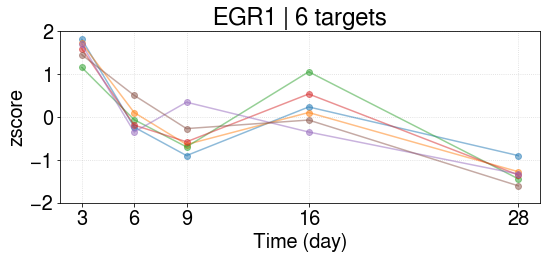

EGR1 | 1 [ 1.56698496 -0.0400589  -0.45872018  0.24873617 -1.31694205]
IGF2
PLAU
SPRY1
CEBPB
GDF15
sub ['IGF2', 'PLAU', 'SPRY1', 'CEBPB', 'GDF15'] 5


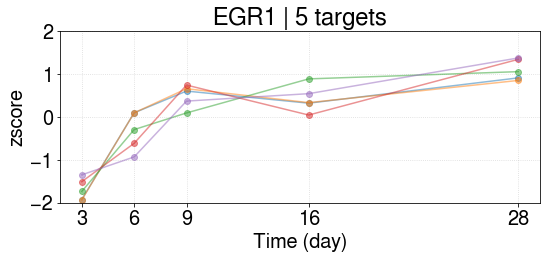

EGR1 | 2 [-1.68966086 -0.33082231  0.49180013  0.42425376  1.10442929]
----------------------------------------------------------
regulon NFKB1 23
['BRCA1', 'RRM2B', 'TFPI2', 'SERPINA3', 'IL6', 'MMP13', 'VCAM1', 'A2M', 'CCND2', 'CXCL2', 'SOCS3', 'CYP19A1', 'ADORA1', 'CCR7', 'HLA-F', 'CXCL8', 'TNC', 'TNFSF10', 'PLAU', 'SAA2', 'BIRC5', 'CSF1', 'SOD2']


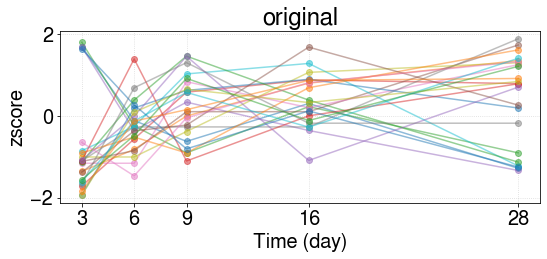

original data shape: (5, 23)
found subregulon: ['SERPINA3', 'CSF1', 'SOD2', 'RRM2B', 'SAA2', 'SOCS3'] 6 0.8789374923536956
################################## FINAL
original size: 23; new size 6; lost: 17
SERPINA3
CSF1
SOD2
RRM2B
SAA2
SOCS3
sub ['SERPINA3', 'CSF1', 'SOD2', 'RRM2B', 'SAA2', 'SOCS3'] 6


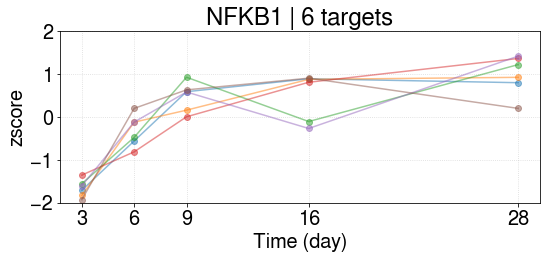

NFKB1 | 1 [-1.6637561  -0.31617123  0.47986884  0.51530951  0.98474899]
----------------------------------------------------------
regulon SOX7 33
['GRASP', 'CARD10', 'TFPI2', 'MYO1B', 'IL6', 'PNP', 'FOSL1', 'CH25H', 'IL3RA', 'EHD4', 'SOCS3', 'PTTG1', 'STOM', 'GCH1', 'GJA1', 'POSTN', 'TNFRSF10D', 'EPAS1', 'LMCD1', 'S100A16', 'CLEC3B', 'TNFSF10', 'APOL3', 'LRRC32', 'SEMA3F', 'TIAM1', 'PLAU', 'PLAT', 'PIM1', 'FAM89A', 'SPRY1', 'PLSCR1', 'ACKR1']


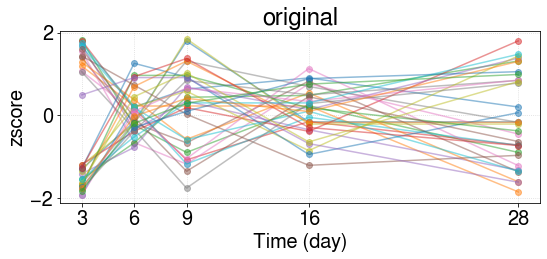

original data shape: (5, 33)
found subregulon: ['CARD10', 'TFPI2', 'MYO1B', 'PNP', 'FOSL1', 'EHD4', 'PTTG1', 'TNFRSF10D', 'S100A16', 'TIAM1'] 10 0.8433815878814339
found subregulon: ['EPAS1', 'PLSCR1', 'ACKR1', 'STOM', 'PIM1', 'FAM89A', 'SOCS3', 'GJA1', 'TNFSF10', 'SPRY1'] 10 0.8530690634386009
################################## FINAL
original size: 33; new size 20; lost: 13
CARD10
TFPI2
MYO1B
PNP
FOSL1
EHD4
PTTG1
TNFRSF10D
S100A16
TIAM1
sub ['CARD10', 'TFPI2', 'MYO1B', 'PNP', 'FOSL1', 'EHD4', 'PTTG1', 'TNFRSF10D', 'S100A16', 'TIAM1'] 10


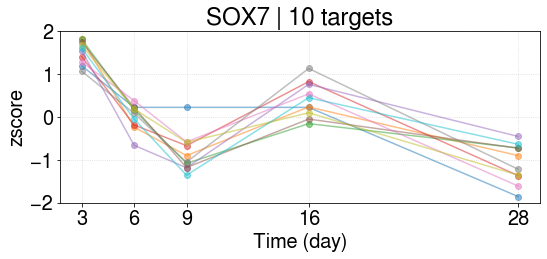

SOX7 | 1 [ 1.50876564  0.01065934 -0.83776726  0.40359004 -1.08524776]
EPAS1
PLSCR1
ACKR1
STOM
PIM1
FAM89A
SOCS3
GJA1
TNFSF10
SPRY1
sub ['EPAS1', 'PLSCR1', 'ACKR1', 'STOM', 'PIM1', 'FAM89A', 'SOCS3', 'GJA1', 'TNFSF10', 'SPRY1'] 10


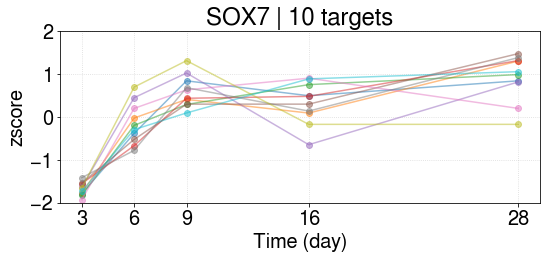

SOX7 | 2 [-1.68530516 -0.15400558  0.59990304  0.32117794  0.91822976]
----------------------------------------------------------
regulon PRRX1 131
['PDE1A', 'C1S', 'GLI2', 'NT5E', 'MCC', 'TFPI2', 'RAB31', 'ANGPTL2', 'PTGIS', 'GYPC', 'FNDC1', 'FBLN1', 'THBS2', 'CYP1B1', 'MAN1C1', 'SLIT3', 'IFITM1', 'GLIPR1', 'NRGN', 'NCAM2', 'RGS4', 'BTBD3', 'APOD', 'ACKR1', 'ATP8B4', 'RORB', 'CARD10', 'EFEMP1', 'CHRDL1', 'FOXC2', 'SHANK1', 'CYBRD1', 'FAM110B', 'CH25H', 'CPED1', 'FBLN2', 'PAMR1', 'PRRX2', 'RUNX2', 'FAM20A', 'CAP2', 'LPXN', 'KIAA1755', 'PTGES', 'PODN', 'ABI3BP', 'LMCD1', 'TGFBI', 'CNTNAP1', 'SGCD', 'ADAMTS12', 'HSD11B1', 'TNC', 'SAMSN1', 'PPARGC1A', 'FAM180A', 'AXL', 'SLC9A9', 'SLIT2', 'ENPP4', 'FST', 'MFAP4', 'PDGFRA', 'ECM2', 'SPRY1', 'CSF1', 'CSMD2', 'BOC', 'B4GALNT1', 'LEPR', 'PLXDC2', 'PDGFRL', 'VCAM1', 'RHOQ', 'MGP', 'NETO2', 'GPNMB', 'INHBA', 'SNED1', 'EBF1', 'APOL3', 'EPHB2', 'PROS1', 'SHROOM2', 'PLAU', 'DDIT4L', 'COL21A1', 'LUM', 'DKK2', 'PMP22', 'PODNL1', 'FGF7', 'SVEP1', 'C1R

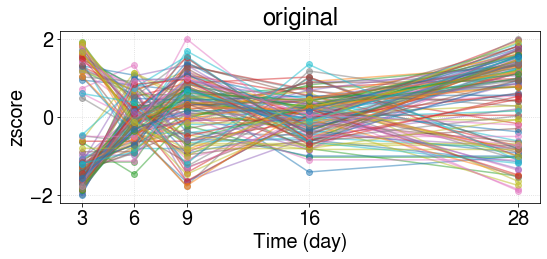

original data shape: (5, 131)
found subregulon: ['NT5E', 'TFPI2', 'GLIPR1', 'NRGN', 'SHANK1', 'CAP2', 'LPXN', 'KIAA1755', 'ABI3BP', 'CNTNAP1', 'SGCD', 'ADAMTS12', 'FAM180A', 'AXL', 'SLIT2', 'CSMD2', 'B4GALNT1', 'EPHB2', 'SHROOM2', 'DKK2', 'MYO1B', 'UCHL1', 'KIF18A', 'LRRC17', 'PKMYT1', 'RFC3'] 26 0.8243830477963655
found subregulon: ['TFPI', 'ENPP4', 'SFRP1', 'RORB', 'SAMSN1', 'INHBA'] 6 0.8957473765303683
found subregulon: ['DCN', 'PCDH18', 'FST', 'PROS1', 'HTRA1', 'GPC6', 'PDGFRA', 'THBS2', 'C1S', 'ATP8B4', 'ECM2', 'PTGFR', 'EBF1', 'MFAP4', 'EFEMP1', 'ANGPTL2', 'FGF7', 'CFH', 'FBLN1', 'COL21A1', 'DDR2', 'PLAU', 'PLXDC2', 'RCN1', 'PMP22', 'RAB31', 'GYPC', 'PDGFRL', 'SSPN', 'PLEKHF1', 'LUM', 'CYBRD1', 'C1R', 'C7', 'IFITM1', 'SLIT3', 'SLC9A9', 'MAN1C1', 'MCC', 'ACKR1', 'HMCN1', 'ASPN', 'APOD', 'MEDAG', 'SVEP1', 'BOC', 'PODNL1', 'GEM', 'MGP', 'CSF1', 'FBLN2', 'LAMA4', 'LMCD1', 'SPRY1', 'C3', 'GPNMB', 'FAM110B', 'PTGIS', 'PAPPA', 'DDIT4L', 'CHRDL1', 'KIAA1217', 'PRRX2', 'ANTXR1', 'RUNX2',

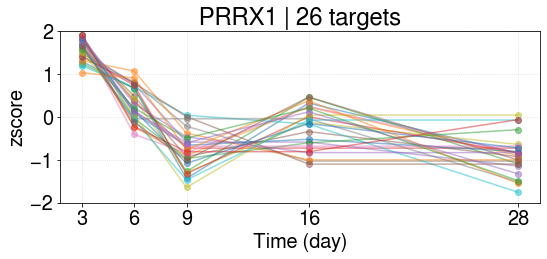

PRRX1 | 1 [ 1.60465139  0.31910704 -0.78956127 -0.24383526 -0.89036189]
TFPI
ENPP4
SFRP1
RORB
SAMSN1
INHBA
sub ['TFPI', 'ENPP4', 'SFRP1', 'RORB', 'SAMSN1', 'INHBA'] 6


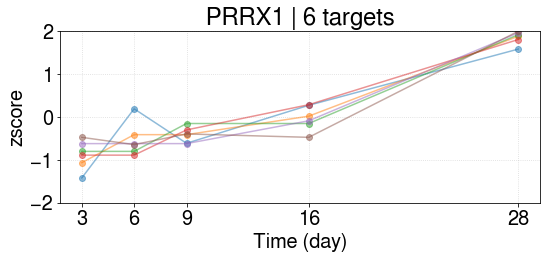

PRRX1 | 2 [-0.87998385 -0.53093792 -0.4172813  -0.02506833  1.85327142]
DCN
PCDH18
FST
PROS1
HTRA1
GPC6
PDGFRA
THBS2
C1S
ATP8B4
ECM2
PTGFR
EBF1
MFAP4
EFEMP1
ANGPTL2
FGF7
CFH
FBLN1
COL21A1
DDR2
PLAU
PLXDC2
RCN1
PMP22
RAB31
GYPC
PDGFRL
SSPN
PLEKHF1
LUM
CYBRD1
C1R
C7
IFITM1
SLIT3
SLC9A9
MAN1C1
MCC
ACKR1
HMCN1
ASPN
APOD
MEDAG
SVEP1
BOC
PODNL1
GEM
MGP
CSF1
FBLN2
LAMA4
LMCD1
SPRY1
C3
GPNMB
FAM110B
PTGIS
PAPPA
DDIT4L
CHRDL1
KIAA1217
PRRX2
ANTXR1
RUNX2
VCAM1
CH25H
RHOQ
CCL13
PDE1A
APOL3
OSR1
ABCC9
SNED1
sub ['DCN', 'PCDH18', 'FST', 'PROS1', 'HTRA1', 'GPC6', 'PDGFRA', 'THBS2', 'C1S', 'ATP8B4', 'ECM2', 'PTGFR', 'EBF1', 'MFAP4', 'EFEMP1', 'ANGPTL2', 'FGF7', 'CFH', 'FBLN1', 'COL21A1', 'DDR2', 'PLAU', 'PLXDC2', 'RCN1', 'PMP22', 'RAB31', 'GYPC', 'PDGFRL', 'SSPN', 'PLEKHF1', 'LUM', 'CYBRD1', 'C1R', 'C7', 'IFITM1', 'SLIT3', 'SLC9A9', 'MAN1C1', 'MCC', 'ACKR1', 'HMCN1', 'ASPN', 'APOD', 'MEDAG', 'SVEP1', 'BOC', 'PODNL1', 'GEM', 'MGP', 'CSF1', 'FBLN2', 'LAMA4', 'LMCD1', 'SPRY1', 'C3', 'GPNMB', 'FAM110B', 

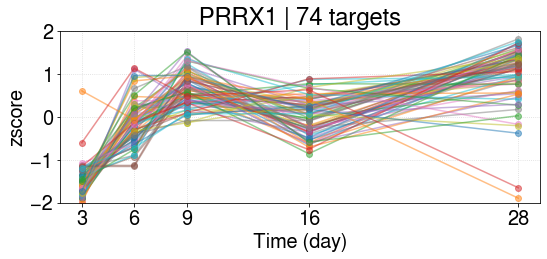

PRRX1 | 3 [-1.55599872 -0.12093013  0.64725311  0.03098958  0.99868616]
----------------------------------------------------------
regulon ZNF215 47
['GINS2', 'EXO1', 'RFC3', 'SPC25', 'TRAIP', 'FANCA', 'BLM', 'PASK', 'ZWINT', 'SH3BP1', 'SLC12A8', 'SHCBP1', 'TRIP13', 'RAD51AP1', 'ARHGAP11B', 'GINS4', 'MND1', 'SPON1', 'NUF2', 'VRK1', 'CDC7', 'STIL', 'CDC6', 'TTK', 'DDIAS', 'DNMT1', 'CENPK', 'DTL', 'NDC80', 'PNPLA3', 'CENPF', 'EZH2', 'KIF11', 'LSP1', 'EME1', 'SLC38A5', 'TPM3', 'ZWILCH', 'PARPBP', 'CDC45', 'FANCI', 'TYMS', 'PFAS', 'HELLS', 'ITPRIPL1', 'AURKA', 'SFXN2']


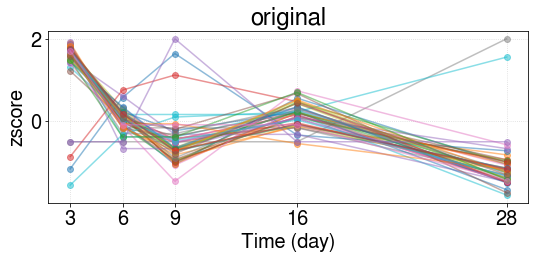

original data shape: (5, 47)
found subregulon: ['GINS2', 'EXO1', 'RFC3', 'SPC25', 'TRAIP', 'FANCA', 'BLM', 'PASK', 'ZWINT', 'SH3BP1', 'SLC12A8', 'SHCBP1', 'TRIP13', 'RAD51AP1', 'ARHGAP11B', 'GINS4', 'MND1', 'SPON1', 'NUF2', 'VRK1', 'CDC7', 'STIL', 'CDC6', 'TTK', 'DDIAS', 'DNMT1', 'CENPK', 'DTL', 'NDC80', 'CENPF', 'EZH2', 'KIF11', 'LSP1', 'EME1', 'SLC38A5', 'TPM3', 'ZWILCH', 'PARPBP', 'CDC45', 'FANCI', 'TYMS', 'PFAS', 'HELLS', 'ITPRIPL1', 'AURKA', 'SFXN2'] 46 0.8711496755901547
################################## FINAL
original size: 47; new size 46; lost: 1
GINS2
EXO1
RFC3
SPC25
TRAIP
FANCA
BLM
PASK
ZWINT
SH3BP1
SLC12A8
SHCBP1
TRIP13
RAD51AP1
ARHGAP11B
GINS4
MND1
SPON1
NUF2
VRK1
CDC7
STIL
CDC6
TTK
DDIAS
DNMT1
CENPK
DTL
NDC80
CENPF
EZH2
KIF11
LSP1
EME1
SLC38A5
TPM3
ZWILCH
PARPBP
CDC45
FANCI
TYMS
PFAS
HELLS
ITPRIPL1
AURKA
SFXN2
sub ['GINS2', 'EXO1', 'RFC3', 'SPC25', 'TRAIP', 'FANCA', 'BLM', 'PASK', 'ZWINT', 'SH3BP1', 'SLC12A8', 'SHCBP1', 'TRIP13', 'RAD51AP1', 'ARHGAP11B', 'GINS4', 'MND1',

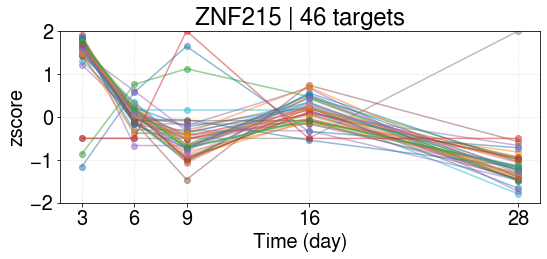

ZNF215 | 1 [ 1.43866271  0.04797306 -0.47159992  0.13792103 -1.15295688]
----------------------------------------------------------
regulon ARID5B 72
['USP53', 'FGF7', 'C1S', 'MAP3K8', 'GABARAPL1', 'C1R', 'CCDC68', 'BTG2', 'CARD10', 'SPC25', 'NCAPG', 'RAB31', 'LATS2', 'CEBPD', 'IL1R1', 'OSR2', 'PLXDC2', 'YPEL2', 'RANGAP1', 'CHAC2', 'IL6', 'VCAM1', 'PTGER2', 'HYOU1', 'CFH', 'PELI1', 'BTG1', 'KIF22', 'ABCC9', 'STOM', 'ADORA1', 'DEPDC1B', 'EPAS1', 'CDC7', 'SERPING1', 'ANTXR2', 'LMCD1', 'CDH4', 'TNFRSF1B', 'BCL6', 'PNRC1', 'C3', 'EBF1', 'TENM2', 'AXL', 'TLR4', 'APOL3', 'KLF9', 'STON1', 'GLIPR1', 'RAP1B', 'GBP2', 'FBXO32', 'PID1', 'TGFBR3', 'APOL4', 'PCSK1', 'ABCA1', 'FST', 'PDGFRA', 'KIAA1217', 'NDRG1', 'ECM2', 'FOXO1', 'INSC', 'SPRY1', 'MAP3K5', 'PLSCR1', 'SOD2', 'EPS8', 'AMIGO2', 'GEM']


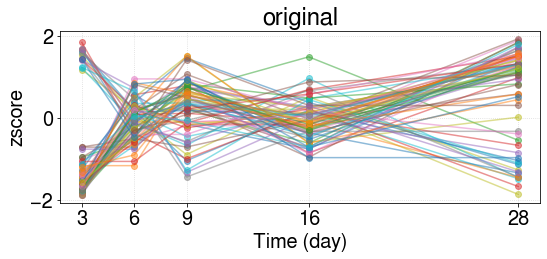

original data shape: (5, 72)
found subregulon: ['CARD10', 'SPC25', 'NCAPG', 'RANGAP1', 'CHAC2', 'IL6', 'HYOU1', 'KIF22', 'DEPDC1B', 'CDC7', 'CDH4', 'AXL', 'GLIPR1', 'INSC'] 14 0.8242899433961915
found subregulon: ['FST', 'PLSCR1', 'PDGFRA', 'GABARAPL1', 'EBF1', 'C1S', 'BTG1', 'FGF7', 'ECM2', 'TNFRSF1B', 'ABCA1', 'PLXDC2', 'PNRC1', 'CFH', 'CEBPD', 'SOD2', 'IL1R1', 'RAP1B', 'BCL6', 'RAB31', 'SERPING1', 'YPEL2', 'NDRG1', 'MAP3K5', 'KLF9', 'EPAS1', 'TENM2', 'STOM', 'C1R', 'LMCD1', 'STON1', 'FOXO1', 'MAP3K8', 'GEM', 'TLR4', 'BTG2', 'GBP2', 'LATS2', 'SPRY1', 'C3', 'VCAM1', 'EPS8', 'APOL4', 'KIAA1217', 'CCDC68', 'APOL3', 'PCSK1', 'ABCC9', 'ADORA1'] 49 0.8330385755658313
################################## FINAL
original size: 72; new size 63; lost: 9
CARD10
SPC25
NCAPG
RANGAP1
CHAC2
IL6
HYOU1
KIF22
DEPDC1B
CDC7
CDH4
AXL
GLIPR1
INSC
sub ['CARD10', 'SPC25', 'NCAPG', 'RANGAP1', 'CHAC2', 'IL6', 'HYOU1', 'KIF22', 'DEPDC1B', 'CDC7', 'CDH4', 'AXL', 'GLIPR1', 'INSC'] 14


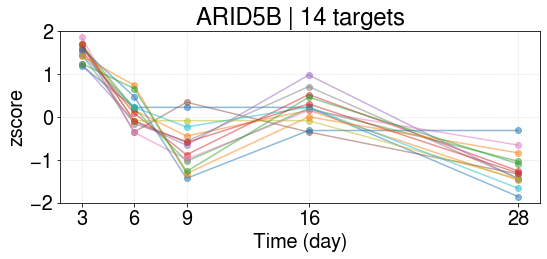

ARID5B | 1 [ 1.52242367  0.11493928 -0.63904288  0.22583616 -1.22415622]
FST
PLSCR1
PDGFRA
GABARAPL1
EBF1
C1S
BTG1
FGF7
ECM2
TNFRSF1B
ABCA1
PLXDC2
PNRC1
CFH
CEBPD
SOD2
IL1R1
RAP1B
BCL6
RAB31
SERPING1
YPEL2
NDRG1
MAP3K5
KLF9
EPAS1
TENM2
STOM
C1R
LMCD1
STON1
FOXO1
MAP3K8
GEM
TLR4
BTG2
GBP2
LATS2
SPRY1
C3
VCAM1
EPS8
APOL4
KIAA1217
CCDC68
APOL3
PCSK1
ABCC9
ADORA1
sub ['FST', 'PLSCR1', 'PDGFRA', 'GABARAPL1', 'EBF1', 'C1S', 'BTG1', 'FGF7', 'ECM2', 'TNFRSF1B', 'ABCA1', 'PLXDC2', 'PNRC1', 'CFH', 'CEBPD', 'SOD2', 'IL1R1', 'RAP1B', 'BCL6', 'RAB31', 'SERPING1', 'YPEL2', 'NDRG1', 'MAP3K5', 'KLF9', 'EPAS1', 'TENM2', 'STOM', 'C1R', 'LMCD1', 'STON1', 'FOXO1', 'MAP3K8', 'GEM', 'TLR4', 'BTG2', 'GBP2', 'LATS2', 'SPRY1', 'C3', 'VCAM1', 'EPS8', 'APOL4', 'KIAA1217', 'CCDC68', 'APOL3', 'PCSK1', 'ABCC9', 'ADORA1'] 49


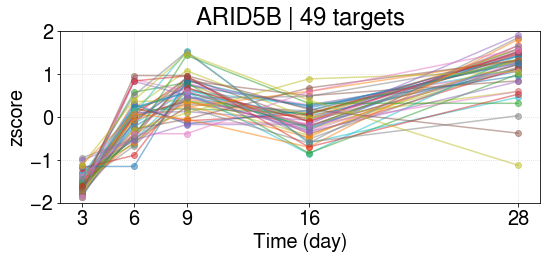

ARID5B | 2 [-1.56711017 -0.04553502  0.547575   -0.0793899   1.14446009]
----------------------------------------------------------
regulon JDP2 48
['TMEM100', 'PLEKHG5', 'GRASP', 'PTPRM', 'EPHX1', 'MCC', 'ADA', 'MMP28', 'ANTXR1', 'DDIT3', 'CFD', 'DCN', 'FAM167A', 'RRM2', 'PALM', 'VCAM1', 'KIF18A', 'CCND2', 'TSC22D1', 'DDR2', 'KCNMA1', 'FBLN2', 'FAM111B', 'ELN', 'FAM20A', 'RFTN2', 'GPNMB', 'FBLN1', 'PODN', 'APOBEC3B', 'HCFC1R1', 'SAMSN1', 'CLEC3B', 'IGF2BP3', 'DPT', 'CYGB', 'BST2', 'TSC22D3', 'SLC25A19', 'ARRB1', 'UGP2', 'MFGE8', 'OLFML3', 'FBLN5', 'CSF1', 'SMAD6', 'PMP22', 'SLC4A4']


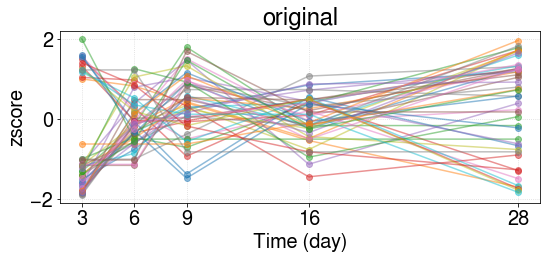

original data shape: (5, 48)
found subregulon: ['PLEKHG5', 'RRM2', 'KCNMA1', 'APOBEC3B', 'IGF2BP3', 'SLC25A19', 'ARRB1', 'FBLN5', 'SLC4A4'] 9 0.828470401722665
found subregulon: ['DCN', 'CYGB', 'DDR2', 'PMP22', 'FBLN1', 'DPT', 'TSC22D1', 'MFGE8', 'DDIT3', 'EPHX1', 'BST2', 'OLFML3', 'HCFC1R1', 'FBLN2', 'VCAM1', 'RFTN2', 'MCC', 'GPNMB', 'MMP28', 'PTPRM', 'ADA', 'TSC22D3', 'GRASP', 'TMEM100', 'ANTXR1', 'PALM'] 26 0.8225691813049132
################################## FINAL
original size: 48; new size 35; lost: 13
PLEKHG5
RRM2
KCNMA1
APOBEC3B
IGF2BP3
SLC25A19
ARRB1
FBLN5
SLC4A4
sub ['PLEKHG5', 'RRM2', 'KCNMA1', 'APOBEC3B', 'IGF2BP3', 'SLC25A19', 'ARRB1', 'FBLN5', 'SLC4A4'] 9


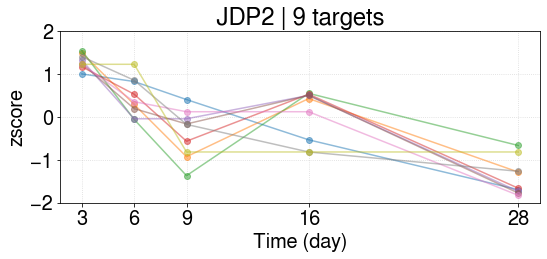

JDP2 | 1 [ 1.2917151   0.46304682 -0.39296186  0.05109086 -1.41289091]
DCN
CYGB
DDR2
PMP22
FBLN1
DPT
TSC22D1
MFGE8
DDIT3
EPHX1
BST2
OLFML3
HCFC1R1
FBLN2
VCAM1
RFTN2
MCC
GPNMB
MMP28
PTPRM
ADA
TSC22D3
GRASP
TMEM100
ANTXR1
PALM
sub ['DCN', 'CYGB', 'DDR2', 'PMP22', 'FBLN1', 'DPT', 'TSC22D1', 'MFGE8', 'DDIT3', 'EPHX1', 'BST2', 'OLFML3', 'HCFC1R1', 'FBLN2', 'VCAM1', 'RFTN2', 'MCC', 'GPNMB', 'MMP28', 'PTPRM', 'ADA', 'TSC22D3', 'GRASP', 'TMEM100', 'ANTXR1', 'PALM'] 26


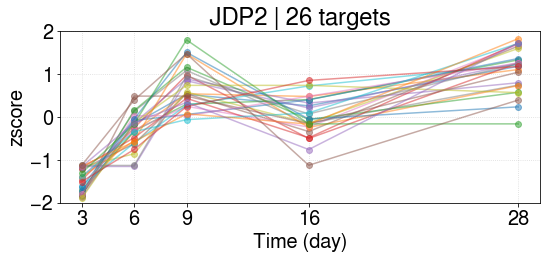

JDP2 | 2 [-1.49978942 -0.30880485  0.67052197  0.01614526  1.12192704]
----------------------------------------------------------
regulon ZNF521 94
['PDE1A', 'CPT1C', 'GLI2', 'NT5E', 'MCC', 'RNF144A', 'ANGPTL2', 'ADGRG6', 'CD302', 'FBLN1', 'CTSO', 'PRIM2', 'MAN1C1', 'SLIT3', 'IFITM1', 'TOX', 'DNAJC6', 'ADAMTS5', 'PEAR1', 'RORB', 'PTPRM', 'ST3GAL5', 'CARD10', 'FOXC2', 'CLDN11', 'PALM', 'CYBRD1', 'NMNAT2', 'FBLN2', 'PAMR1', 'RFTN2', 'KIAA1755', 'PODN', 'SERPING1', 'ABI3BP', 'MMP16', 'PCDH19', 'FAM180A', 'TNFSF10', 'SLC9A9', 'TLR3', 'MFAP4', 'ASAP3', 'ECM2', 'GAS1', 'SESN3', 'BOC', 'CIT', 'LEPR', 'PLXDC2', 'PDGFRL', 'VCAM1', 'OLFML2A', 'GPNMB', 'HNMT', 'KCNT2', 'SNED1', 'EBF1', 'PROS1', 'NREP', 'COL21A1', 'LUM', 'PMP22', 'PDCD1LG2', 'TMEM100', 'SVEP1', 'EPHX1', 'ANTXR1', 'DCN', 'RTN4RL2', 'LCA5', 'LAMA4', 'ADAMTS10', 'OLFML2B', 'DAPK1', 'CADM3', 'CFH', 'DDR2', 'LRRC17', 'MAP3K12', 'KCNJ8', 'GPC6', 'CYGB', 'SLC40A1', 'HTRA1', 'CXCL12', 'C11orf95', 'TMEM150C', 'ISM1', 'SULF2', 'CFI', 'OLFML

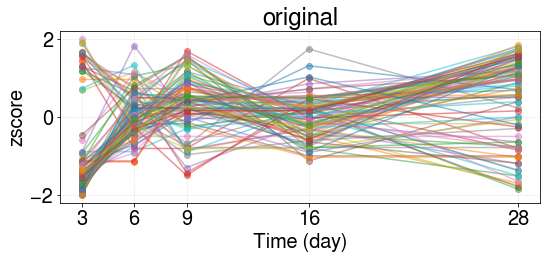

original data shape: (5, 94)
found subregulon: ['CPT1C', 'GLI2', 'ADGRG6', 'PRIM2', 'TOX', 'PEAR1', 'CARD10', 'CLDN11', 'PAMR1', 'KIAA1755', 'MMP16', 'CIT', 'NREP'] 13 0.8252642181723775
found subregulon: ['PDCD1LG2', 'LRRC17', 'PCDH19', 'FAM180A', 'NT5E', 'ABI3BP'] 6 0.8331685011987094
found subregulon: ['DCN', 'PCDH18', 'HNMT', 'PROS1', 'GPC6', 'SERPING1', 'HTRA1', 'EBF1', 'ECM2', 'RNF144A', 'ANGPTL2', 'CYGB', 'CFH', 'GAS1', 'MFAP4', 'DDR2', 'PLXDC2', 'RTN4RL2', 'PDGFRL', 'COL21A1', 'FBLN1', 'CD302', 'RFTN2', 'SSPN', 'PMP22', 'SESN3', 'LUM', 'CYBRD1', 'SLC9A9', 'ASAP3', 'SLIT3', 'SVEP1', 'CADM3', 'MAN1C1', 'MCC', 'IFITM1', 'ISM1', 'SLC40A1', 'CTSO', 'TMEM150C', 'KCNJ8', 'EPHX1', 'ADAMTS5', 'OLFML3', 'BOC', 'LAMA4', 'FBLN2', 'KCNT2', 'LCA5', 'SULF2', 'PTPRM', 'DNAJC6', 'OLFML2B', 'GPNMB', 'MAP3K12', 'PDE1A', 'TNFSF10', 'SNED1', 'OLFML2A', 'PALM', 'ADAMTS10', 'PODN'] 62 0.8215675993746352
################################## FINAL
original size: 94; new size 81; lost: 13
CPT1C
GLI2
ADGRG

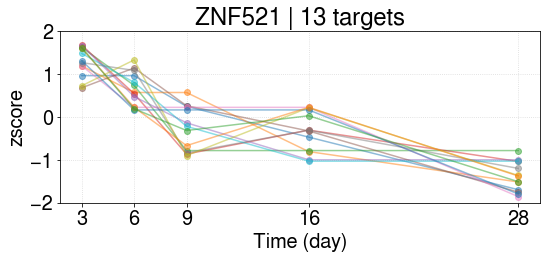

ZNF521 | 1 [ 1.30341222  0.64784768 -0.2515833  -0.32234511 -1.37733148]
PDCD1LG2
LRRC17
PCDH19
FAM180A
NT5E
ABI3BP
sub ['PDCD1LG2', 'LRRC17', 'PCDH19', 'FAM180A', 'NT5E', 'ABI3BP'] 6


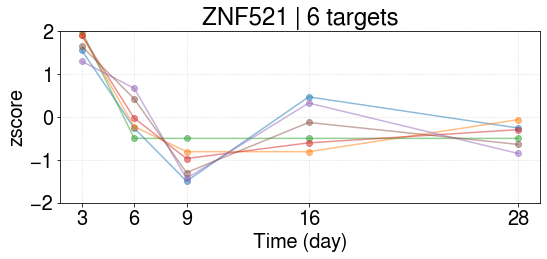

ZNF521 | 2 [ 1.71607936  0.01278427 -1.08445183 -0.20922045 -0.43519135]
DCN
PCDH18
HNMT
PROS1
GPC6
SERPING1
HTRA1
EBF1
ECM2
RNF144A
ANGPTL2
CYGB
CFH
GAS1
MFAP4
DDR2
PLXDC2
RTN4RL2
PDGFRL
COL21A1
FBLN1
CD302
RFTN2
SSPN
PMP22
SESN3
LUM
CYBRD1
SLC9A9
ASAP3
SLIT3
SVEP1
CADM3
MAN1C1
MCC
IFITM1
ISM1
SLC40A1
CTSO
TMEM150C
KCNJ8
EPHX1
ADAMTS5
OLFML3
BOC
LAMA4
FBLN2
KCNT2
LCA5
SULF2
PTPRM
DNAJC6
OLFML2B
GPNMB
MAP3K12
PDE1A
TNFSF10
SNED1
OLFML2A
PALM
ADAMTS10
PODN
sub ['DCN', 'PCDH18', 'HNMT', 'PROS1', 'GPC6', 'SERPING1', 'HTRA1', 'EBF1', 'ECM2', 'RNF144A', 'ANGPTL2', 'CYGB', 'CFH', 'GAS1', 'MFAP4', 'DDR2', 'PLXDC2', 'RTN4RL2', 'PDGFRL', 'COL21A1', 'FBLN1', 'CD302', 'RFTN2', 'SSPN', 'PMP22', 'SESN3', 'LUM', 'CYBRD1', 'SLC9A9', 'ASAP3', 'SLIT3', 'SVEP1', 'CADM3', 'MAN1C1', 'MCC', 'IFITM1', 'ISM1', 'SLC40A1', 'CTSO', 'TMEM150C', 'KCNJ8', 'EPHX1', 'ADAMTS5', 'OLFML3', 'BOC', 'LAMA4', 'FBLN2', 'KCNT2', 'LCA5', 'SULF2', 'PTPRM', 'DNAJC6', 'OLFML2B', 'GPNMB', 'MAP3K12', 'PDE1A', 'TNFSF10', 'SNED1', '

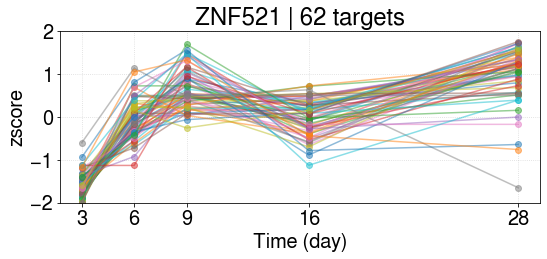

ZNF521 | 3 [-1.58760369 -0.0427622   0.62939022 -0.0131218   1.01409747]
----------------------------------------------------------
regulon NFIB 35
['MCC', 'ANTXR1', 'TLE2', 'CHRDL1', 'DCN', 'CDKN1A', 'ABCA6', 'CCND2', 'CFH', 'FZD4', 'SNCG', 'ABCC9', 'NES', 'ADH1B', 'MGP', 'RFTN2', 'CAP2', 'HNMT', 'MMP16', 'HMCN1', 'EBF1', 'C7', 'TNFSF10', 'MAN1C1', 'STON1', 'DCBLD2', 'ABCA9', 'FMOD', 'DTNA', 'MYLK', 'ASAP3', 'ECM2', 'CFI', 'ARHGAP18', 'SSBP2']


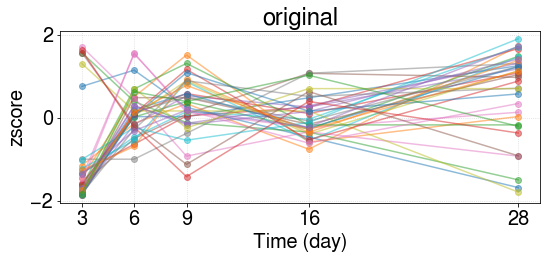

original data shape: (5, 35)
found subregulon: ['NES', 'CAP2', 'MMP16', 'DCBLD2'] 4 0.8283113140593922
found subregulon: ['ADH1B', 'EBF1', 'DCN', 'ECM2', 'TLE2', 'RFTN2', 'CFH', 'MCC', 'MGP', 'STON1', 'FMOD', 'SSBP2', 'ASAP3', 'MAN1C1', 'FZD4', 'C7', 'DTNA', 'HMCN1', 'CDKN1A', 'TNFSF10', 'ANTXR1', 'ABCA6'] 22 0.8368073006403115
################################## FINAL
original size: 35; new size 26; lost: 9
NES
CAP2
MMP16
DCBLD2
sub ['NES', 'CAP2', 'MMP16', 'DCBLD2'] 4


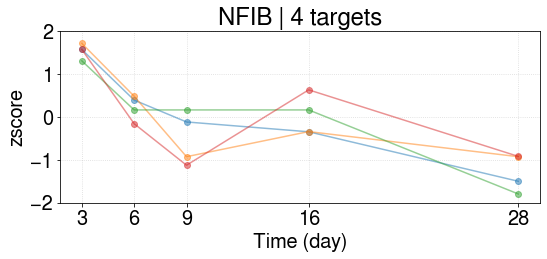

NFIB | 1 [ 1.54036655  0.21945028 -0.5016437   0.02587468 -1.2840478 ]
ADH1B
EBF1
DCN
ECM2
TLE2
RFTN2
CFH
MCC
MGP
STON1
FMOD
SSBP2
ASAP3
MAN1C1
FZD4
C7
DTNA
HMCN1
CDKN1A
TNFSF10
ANTXR1
ABCA6
sub ['ADH1B', 'EBF1', 'DCN', 'ECM2', 'TLE2', 'RFTN2', 'CFH', 'MCC', 'MGP', 'STON1', 'FMOD', 'SSBP2', 'ASAP3', 'MAN1C1', 'FZD4', 'C7', 'DTNA', 'HMCN1', 'CDKN1A', 'TNFSF10', 'ANTXR1', 'ABCA6'] 22


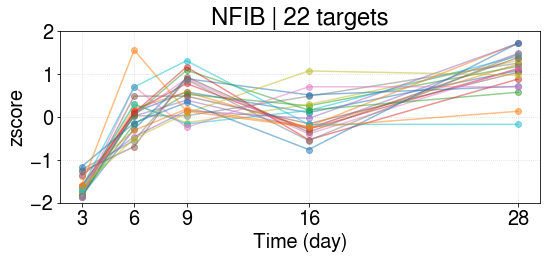

NFIB | 2 [-1.63223674  0.07046652  0.49297598 -0.02372555  1.09251979]
----------------------------------------------------------
regulon TGIF1 95
['PLEKHG5', 'MAP3K8', 'MCC', 'DHRS3', 'NFKBIZ', 'ARMC9', 'PASK', 'CDKN1A', 'THOP1', 'STOM', 'MT2A', 'PNRC1', 'DBF4', 'CRISPLD2', 'CALM1', 'IFITM1', 'PKIG', 'PIM1', 'MGLL', 'BTBD3', 'PLSCR1', 'PLPP1', 'ARHGAP6', 'GPER1', 'SECTM1', 'ATP8B4', 'SLC2A5', 'CARD10', 'CCNF', 'ANKRD28', 'YPEL2', 'PALM', 'PNP', 'COQ8A', 'CH25H', 'IL3RA', 'TLE6', 'GCH1', 'CCR7', 'SGCD', 'CXCL8', 'SAMSN1', 'LRRK2', 'MLPH', 'ABCA1', 'HMGA1', 'MAP3K5', 'SPRED3', 'SLC27A4', 'GABARAPL1', 'CCDC68', 'CEBPD', 'SAMD11', 'EFNA1', 'FOSL1', 'UBASH3B', 'PIK3IP1', 'PAQR4', 'IFNGR1', 'NETO2', 'CDCA3', 'DNMT1', 'ABHD4', 'TIPARP', 'NREP', 'GPR89A', 'IL11', 'PTPRF', 'PRR11', 'SOD2', 'PMP22', 'TLE2', 'SERPINA3', 'IL1R1', 'CD55', 'CHI3L1', 'IL6', 'TFPI', 'BTG1', 'TNFRSF10D', 'SAA1', 'SAT1', 'CDC7', 'CEBPB', 'HSBP1L1', 'VGLL4', 'ATP6V0E2', 'RAP1B', 'LSP1', 'MEDAG', 'PKMYT1', 'NABP1', 'SLC1

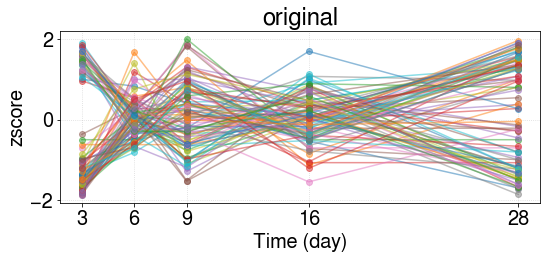

original data shape: (5, 95)
found subregulon: ['PLEKHG5', 'PASK', 'THOP1', 'MT2A', 'DBF4', 'CALM1', 'MGLL', 'GPER1', 'CARD10', 'CCNF', 'PNP', 'SGCD', 'MLPH', 'HMGA1', 'SPRED3', 'SLC27A4', 'FOSL1', 'UBASH3B', 'PAQR4', 'NETO2', 'CDCA3', 'DNMT1', 'TIPARP', 'NREP', 'PTPRF', 'PRR11', 'IL6', 'TNFRSF10D', 'CDC7', 'ATP6V0E2', 'PKMYT1', 'SLC19A1', 'WRAP53'] 33 0.8239847829094066
found subregulon: ['IL1R1', 'GABARAPL1', 'ABCA1', 'ATP8B4', 'BTG1', 'PKIG', 'TLE2', 'PNRC1', 'SOD2', 'CEBPB', 'CEBPD', 'STOM', 'RAP1B', 'MCC', 'ARHGAP6', 'CRISPLD2', 'PMP22', 'ABHD4', 'IFITM1', 'MAP3K5', 'HSBP1L1', 'IFNGR1', 'SERPINA3', 'YPEL2', 'NFKBIZ', 'SAA1', 'GPR89A', 'PIM1', 'CDKN1A', 'PLPP1', 'CHI3L1', 'TLE6', 'MEDAG', 'CH25H', 'PIK3IP1', 'BTBD3', 'COQ8A'] 37 0.8436995260311396
################################## FINAL
original size: 95; new size 70; lost: 25
PLEKHG5
PASK
THOP1
MT2A
DBF4
CALM1
MGLL
GPER1
CARD10
CCNF
PNP
SGCD
MLPH
HMGA1
SPRED3
SLC27A4
FOSL1
UBASH3B
PAQR4
NETO2
CDCA3
DNMT1
TIPARP
NREP
PTPRF
PRR11
I

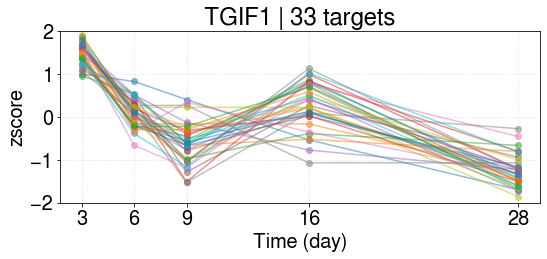

TGIF1 | 1 [ 1.47801504  0.09084468 -0.59156537  0.27246168 -1.24975602]
IL1R1
GABARAPL1
ABCA1
ATP8B4
BTG1
PKIG
TLE2
PNRC1
SOD2
CEBPB
CEBPD
STOM
RAP1B
MCC
ARHGAP6
CRISPLD2
PMP22
ABHD4
IFITM1
MAP3K5
HSBP1L1
IFNGR1
SERPINA3
YPEL2
NFKBIZ
SAA1
GPR89A
PIM1
CDKN1A
PLPP1
CHI3L1
TLE6
MEDAG
CH25H
PIK3IP1
BTBD3
COQ8A
sub ['IL1R1', 'GABARAPL1', 'ABCA1', 'ATP8B4', 'BTG1', 'PKIG', 'TLE2', 'PNRC1', 'SOD2', 'CEBPB', 'CEBPD', 'STOM', 'RAP1B', 'MCC', 'ARHGAP6', 'CRISPLD2', 'PMP22', 'ABHD4', 'IFITM1', 'MAP3K5', 'HSBP1L1', 'IFNGR1', 'SERPINA3', 'YPEL2', 'NFKBIZ', 'SAA1', 'GPR89A', 'PIM1', 'CDKN1A', 'PLPP1', 'CHI3L1', 'TLE6', 'MEDAG', 'CH25H', 'PIK3IP1', 'BTBD3', 'COQ8A'] 37


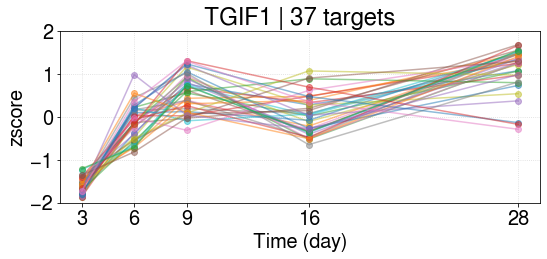

TGIF1 | 2 [-1.6043757  -0.12349898  0.55552599  0.04500246  1.12734623]
----------------------------------------------------------
regulon SMAD9 31
['NFYB', 'MCC', 'NATD1', 'LCA5', 'PNMA2', 'SAMD11', 'ANGPT1', 'ID2', 'SH3BP1', 'ESPL1', 'GEM', 'RGMB', 'FZD1', 'DDR2', 'ABCC9', 'RFTN2', 'HMCN1', 'KCNT2', 'EBF1', 'STON1', 'DCBLD2', 'FRZB', 'CBX7', 'DTNA', 'LIMS2', 'LIFR', 'SMAD6', 'FEN1', 'ARHGAP6', 'LAYN', 'SSBP2']


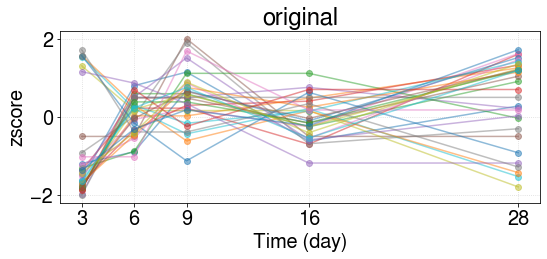

original data shape: (5, 31)
found subregulon: ['SH3BP1', 'ESPL1', 'RGMB', 'DCBLD2', 'FEN1'] 5 0.8439145995387691
found subregulon: ['EBF1', 'CBX7', 'FRZB', 'RFTN2', 'DDR2', 'LAYN', 'MCC', 'NATD1', 'ANGPT1', 'ARHGAP6', 'KCNT2', 'STON1', 'SSBP2', 'PNMA2', 'HMCN1', 'GEM', 'NFYB'] 17 0.868284410516357
################################## FINAL
original size: 31; new size 22; lost: 9
SH3BP1
ESPL1
RGMB
DCBLD2
FEN1
sub ['SH3BP1', 'ESPL1', 'RGMB', 'DCBLD2', 'FEN1'] 5


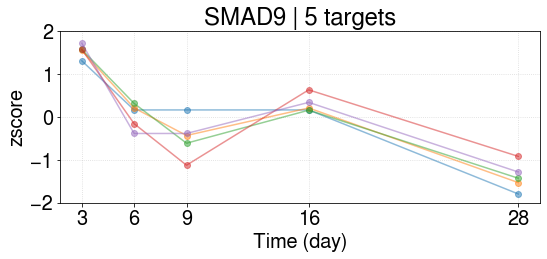

SMAD9 | 1 [ 1.54192486  0.02791689 -0.47878924  0.2987856  -1.38983811]
EBF1
CBX7
FRZB
RFTN2
DDR2
LAYN
MCC
NATD1
ANGPT1
ARHGAP6
KCNT2
STON1
SSBP2
PNMA2
HMCN1
GEM
NFYB
sub ['EBF1', 'CBX7', 'FRZB', 'RFTN2', 'DDR2', 'LAYN', 'MCC', 'NATD1', 'ANGPT1', 'ARHGAP6', 'KCNT2', 'STON1', 'SSBP2', 'PNMA2', 'HMCN1', 'GEM', 'NFYB'] 17


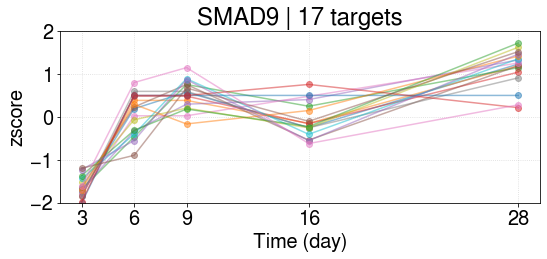

SMAD9 | 2 [-1.64982     0.05763159  0.50999998 -0.05723193  1.13942036]
----------------------------------------------------------
regulon TFEC 81
['C1S', 'RAB31', 'BLM', 'WDR62', 'SHCBP1', 'BUB1B', 'IQGAP3', 'RACGAP1', 'CD302', 'ARHGAP11B', 'LAMA2', 'FTL', 'CHAF1A', 'GLIPR1', 'PLTP', 'ADAMTS5', 'ALOX15B', 'ARHGAP18', 'KYNU', 'KIF20A', 'BUB1', 'ATP8B4', 'GAS2L3', 'SAMHD1', 'ARHGAP11A', 'PLK4', 'LPXN', 'TGFBI', 'TNFRSF1B', 'SAMSN1', 'CDCP1', 'DEPDC1', 'DLGAP5', 'SLC9A9', 'CEP55', 'CD14', 'SGO1', 'MTFR2', 'PDGFRA', 'SPRED3', 'MELK', 'DOCK10', 'PLXDC2', 'POLQ', 'UBASH3B', 'GPNMB', 'HNMT', 'NUSAP1', 'APOC1', 'FOXM1', 'TLR4', 'DNMT1', 'EVI2A', 'METTL7A', 'ANLN', 'SLC17A9', 'RGS18', 'LATS2', 'PDCD1LG2', 'APBB1IP', 'C1R', 'TOP2A', 'ASPM', 'DCN', 'CREG1', 'TACC3', 'DAPK1', 'NCEH1', 'MMP7', 'IFI30', 'EVI2B', 'C3', 'ECT2', 'PTK2B', 'CENPF', 'EME1', 'CENPE', 'SELPLG', 'NABP1', 'MAFB', 'MKI67']


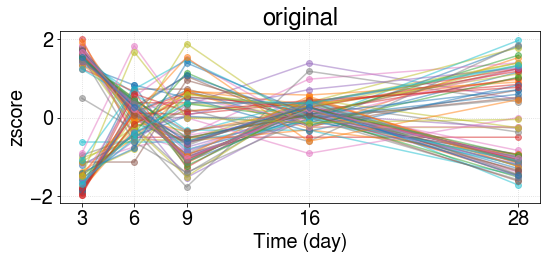

original data shape: (5, 81)
found subregulon: ['RAB31', 'BLM', 'WDR62', 'SHCBP1', 'BUB1B', 'IQGAP3', 'RACGAP1', 'CD302', 'ARHGAP11B', 'LAMA2', 'FTL', 'CHAF1A', 'GLIPR1', 'PLTP', 'ADAMTS5', 'ALOX15B', 'ARHGAP18', 'KYNU', 'KIF20A', 'BUB1', 'ATP8B4', 'GAS2L3', 'SAMHD1', 'ARHGAP11A', 'PLK4', 'LPXN', 'TGFBI', 'TNFRSF1B', 'SAMSN1', 'CDCP1', 'DEPDC1', 'DLGAP5', 'SLC9A9', 'CEP55', 'CD14', 'SGO1', 'MTFR2', 'PDGFRA', 'SPRED3', 'MELK', 'DOCK10', 'PLXDC2', 'POLQ', 'UBASH3B', 'GPNMB', 'HNMT', 'NUSAP1', 'APOC1', 'FOXM1', 'TLR4', 'DNMT1', 'EVI2A', 'METTL7A', 'ANLN', 'SLC17A9', 'RGS18', 'LATS2', 'PDCD1LG2', 'APBB1IP', 'C1R', 'TOP2A', 'ASPM', 'DCN', 'CREG1', 'TACC3', 'DAPK1', 'NCEH1', 'MMP7', 'IFI30', 'EVI2B', 'C3', 'ECT2', 'PTK2B', 'CENPF', 'EME1', 'CENPE', 'SELPLG', 'NABP1', 'MAFB', 'MKI67'] 80 0.8210739668393113
################################## FINAL
original size: 81; new size 80; lost: 1
RAB31
BLM
WDR62
SHCBP1
BUB1B
IQGAP3
RACGAP1
CD302
ARHGAP11B
LAMA2
FTL
CHAF1A
GLIPR1
PLTP
ADAMTS5
ALOX15B
ARH

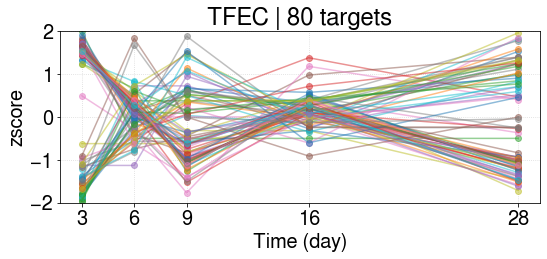

TFEC | 1 [ 0.17693716  0.06966728 -0.24509874  0.15525118 -0.15675689]
----------------------------------------------------------
regulon TFCP2L1 38
['KLF15', 'LEP', 'PPARG', 'LAMA4', 'ADAM19', 'BLM', 'PASK', 'SMTN', 'RARRES2', 'CSTA', 'GALNT6', 'MMP7', 'TIMP4', 'AKR1C3', 'TMEM171', 'TMEM86A', 'EVI2B', 'CDCP1', 'IL1R2', 'INCENP', 'GLUL', 'SAPCD2', 'MT1X', 'PTK2B', 'MTSS1', 'PKIG', 'MLPH', 'SLC25A10', 'FANCI', 'PCSK1', 'ALOX15B', 'CD24', 'ATP1B1', 'MAFB', 'LIFR', 'GEM', 'NEBL', 'PSD4']


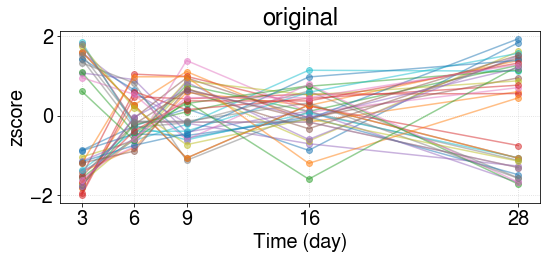

original data shape: (5, 38)
found subregulon: ['ADAM19', 'BLM', 'PASK', 'SMTN', 'GALNT6', 'TMEM171', 'CDCP1', 'INCENP', 'SAPCD2', 'MT1X', 'MLPH', 'SLC25A10', 'FANCI', 'PSD4'] 14 0.8223968894787518
found subregulon: ['LIFR', 'MAFB', 'NEBL', 'TMEM86A', 'PKIG', 'IL1R2', 'MMP7', 'TIMP4', 'LEP', 'GEM', 'PTK2B'] 11 0.9064952218317934
################################## FINAL
original size: 38; new size 25; lost: 13
ADAM19
BLM
PASK
SMTN
GALNT6
TMEM171
CDCP1
INCENP
SAPCD2
MT1X
MLPH
SLC25A10
FANCI
PSD4
sub ['ADAM19', 'BLM', 'PASK', 'SMTN', 'GALNT6', 'TMEM171', 'CDCP1', 'INCENP', 'SAPCD2', 'MT1X', 'MLPH', 'SLC25A10', 'FANCI', 'PSD4'] 14


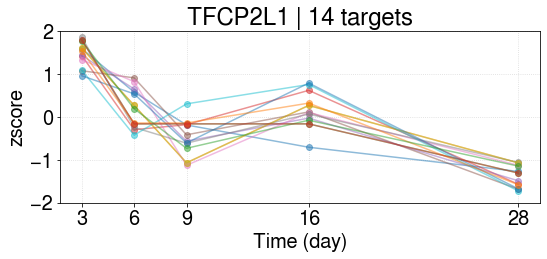

TFCP2L1 | 1 [ 1.48932934  0.19884245 -0.48071142  0.15446573 -1.3619261 ]
LIFR
MAFB
NEBL
TMEM86A
PKIG
IL1R2
MMP7
TIMP4
LEP
GEM
PTK2B
sub ['LIFR', 'MAFB', 'NEBL', 'TMEM86A', 'PKIG', 'IL1R2', 'MMP7', 'TIMP4', 'LEP', 'GEM', 'PTK2B'] 11


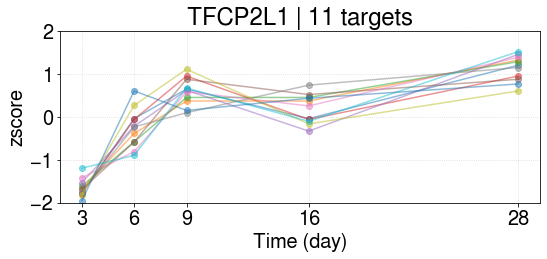

TFCP2L1 | 2 [-1.65492935 -0.26648072  0.59403813  0.18890557  1.13846636]
----------------------------------------------------------
regulon ESR1 28
['FOS', 'BTG2', 'PPARG', 'E2F1', 'BLM', 'PTPRG', 'MMP13', 'CDKN1A', 'FOSL1', 'SOCS3', 'FBLN2', 'CYP19A1', 'RUNX2', 'SLC8A1', 'ADORA1', 'ANGPTL4', 'FBLN1', 'CEBPB', 'CXCL8', 'C3', 'CYP1B1', 'TSC22D3', 'CXCL12', 'TYMS', 'CD24', 'FOXO1', 'CAD', 'STAT5A']


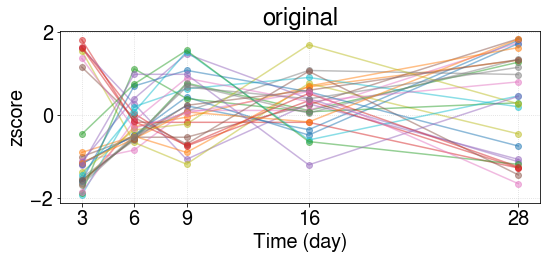

original data shape: (5, 28)
found subregulon: ['E2F1', 'BLM', 'SLC8A1', 'ANGPTL4', 'TYMS', 'CAD'] 6 0.8951273732090294
found subregulon: ['STAT5A', 'PPARG', 'CEBPB', 'SOCS3', 'RUNX2'] 5 0.8616744781444788
################################## FINAL
original size: 28; new size 11; lost: 17
E2F1
BLM
SLC8A1
ANGPTL4
TYMS
CAD
sub ['E2F1', 'BLM', 'SLC8A1', 'ANGPTL4', 'TYMS', 'CAD'] 6


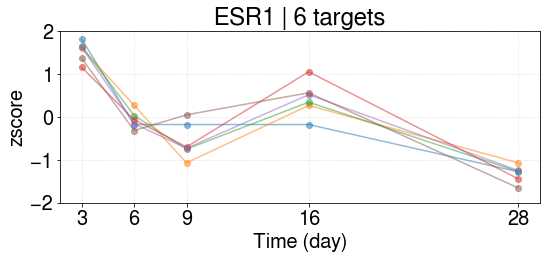

ESR1 | 1 [ 1.53147317 -0.06938998 -0.563067    0.42708336 -1.32609955]
STAT5A
PPARG
CEBPB
SOCS3
RUNX2
sub ['STAT5A', 'PPARG', 'CEBPB', 'SOCS3', 'RUNX2'] 5


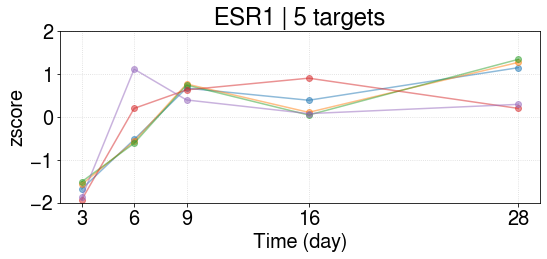

ESR1 | 2 [-1.71160834 -0.08033629  0.64008752  0.30305462  0.84880249]
----------------------------------------------------------
regulon TBX18 81
['PDE1A', 'C1S', 'NT5E', 'ABCA6', 'ADGRG6', 'PTGIS', 'FBLN1', 'CYP1B1', 'SLIT3', 'GLIPR1', 'CNN1', 'PEAR1', 'VIT', 'APOD', 'EPS8', 'AMIGO2', 'ATP8B4', 'EFEMP1', 'CHRDL1', 'FOXC2', 'ADAM19', 'CLDN11', 'CYBRD1', 'FAM110B', 'CPED1', 'FBLN2', 'PRRX2', 'ADH1B', 'PTGDS', 'KIAA1755', 'PODN', 'SERPING1', 'MMP16', 'AXL', 'RANBP3L', 'SLIT2', 'FRZB', 'FST', 'MFAP4', 'ECM2', 'C6', 'GAS1', 'BOC', 'SERPINF1', 'LEPR', 'PLXDC2', 'OLFML2A', 'MGP', 'HNMT', 'KCNT2', 'EBF1', 'PROS1', 'FMO3', 'FBLN5', 'DKK2', 'FGF7', 'SVEP1', 'HHIP', 'ANTXR1', 'DCN', 'OSR2', 'LAMA4', 'OLFML2B', 'CADM3', 'CFH', 'FMO2', 'DDR2', 'OSR1', 'MAP3K12', 'ASPN', 'CLEC3B', 'LCNL1', 'GPC6', 'C3', 'C7', 'SFRP1', 'CXCL12', 'FMOD', 'OLFML3', 'CCL13', 'PCDH18']


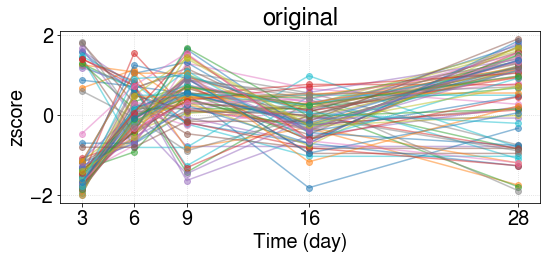

original data shape: (5, 81)
found subregulon: ['NT5E', 'ADGRG6', 'GLIPR1', 'ADAM19', 'CLDN11', 'KIAA1755', 'AXL', 'SLIT2', 'FBLN5', 'DKK2', 'HHIP'] 11 0.835455328633792
found subregulon: ['PTGDS', 'LEPR', 'C1S', 'HNMT', 'PCDH18', 'DCN', 'ECM2', 'GPC6', 'SERPING1', 'EBF1', 'FST', 'EFEMP1', 'PROS1', 'SERPINF1', 'ATP8B4', 'CFH', 'FGF7', 'FRZB', 'MFAP4', 'FBLN1', 'FMO3', 'GAS1', 'DDR2', 'VIT', 'CYBRD1', 'PLXDC2', 'ASPN', 'FMOD', 'SVEP1', 'FMO2', 'C7', 'CADM3', 'APOD', 'OLFML3', 'SLIT3', 'KCNT2', 'C3', 'FBLN2', 'LAMA4', 'MGP', 'PTGIS', 'FAM110B', 'ANTXR1', 'C6', 'OLFML2A', 'MAP3K12', 'RANBP3L', 'CCL13', 'BOC', 'CLEC3B', 'MMP16', 'FOXC2', 'CXCL12'] 53 0.8408647026360639
################################## FINAL
original size: 81; new size 64; lost: 17
NT5E
ADGRG6
GLIPR1
ADAM19
CLDN11
KIAA1755
AXL
SLIT2
FBLN5
DKK2
HHIP
sub ['NT5E', 'ADGRG6', 'GLIPR1', 'ADAM19', 'CLDN11', 'KIAA1755', 'AXL', 'SLIT2', 'FBLN5', 'DKK2', 'HHIP'] 11


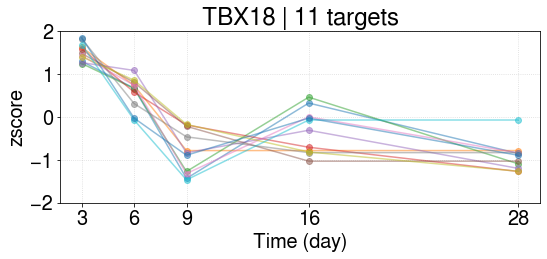

TBX18 | 1 [ 1.51400465  0.57460016 -0.82245392 -0.34544383 -0.92070705]
PTGDS
LEPR
C1S
HNMT
PCDH18
DCN
ECM2
GPC6
SERPING1
EBF1
FST
EFEMP1
PROS1
SERPINF1
ATP8B4
CFH
FGF7
FRZB
MFAP4
FBLN1
FMO3
GAS1
DDR2
VIT
CYBRD1
PLXDC2
ASPN
FMOD
SVEP1
FMO2
C7
CADM3
APOD
OLFML3
SLIT3
KCNT2
C3
FBLN2
LAMA4
MGP
PTGIS
FAM110B
ANTXR1
C6
OLFML2A
MAP3K12
RANBP3L
CCL13
BOC
CLEC3B
MMP16
FOXC2
CXCL12
sub ['PTGDS', 'LEPR', 'C1S', 'HNMT', 'PCDH18', 'DCN', 'ECM2', 'GPC6', 'SERPING1', 'EBF1', 'FST', 'EFEMP1', 'PROS1', 'SERPINF1', 'ATP8B4', 'CFH', 'FGF7', 'FRZB', 'MFAP4', 'FBLN1', 'FMO3', 'GAS1', 'DDR2', 'VIT', 'CYBRD1', 'PLXDC2', 'ASPN', 'FMOD', 'SVEP1', 'FMO2', 'C7', 'CADM3', 'APOD', 'OLFML3', 'SLIT3', 'KCNT2', 'C3', 'FBLN2', 'LAMA4', 'MGP', 'PTGIS', 'FAM110B', 'ANTXR1', 'C6', 'OLFML2A', 'MAP3K12', 'RANBP3L', 'CCL13', 'BOC', 'CLEC3B', 'MMP16', 'FOXC2', 'CXCL12'] 53


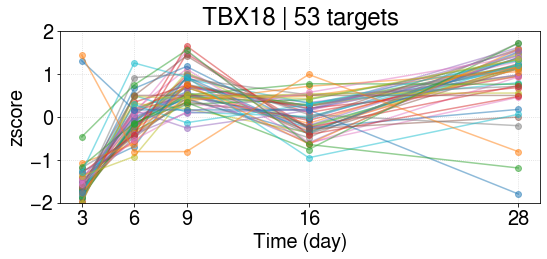

TBX18 | 2 [-1.51282424 -0.03746159  0.6274795  -0.00850847  0.9313148 ]
----------------------------------------------------------
regulon KLF15 89
['CLMN', 'ABCA6', 'FIBIN', 'LAMA2', 'MT2A', 'PTGIS', 'ENPP1', 'TXNIP', 'LOXL4', 'ADAMTS14', 'KLF9', 'STON1', 'MT1X', 'CALCOCO2', 'ZBTB16', 'EIF4EBP3', 'SRPX', 'RGS4', 'CCDC69', 'ALOX15B', 'MFGE8', 'VIT', 'APOD', 'SFXN2', 'INSR', 'PTPRM', 'SUSD2', 'CARD10', 'SAMHD1', 'ADAM19', 'PTPRG', 'PALM', 'COQ8A', 'REPS2', 'PIK3R1', 'SESN1', 'GPX3', 'TIMP4', 'ADH1B', 'HLA-F', 'TMEM86A', 'SERPING1', 'CDC6', 'CORO6', 'RGCC', 'CDKN1C', 'TPM3', 'TGFBR3', 'FOXO1', 'MAOA', 'MARC1', 'SERPINF1', 'DOCK10', 'GABARAPL1', 'CEBPD', 'DEPTOR', 'RASD1', 'BCL6', 'FZD5', 'GLUL', 'TSC22D3', 'METTL7A', 'FBXO32', 'NREP', 'PLAU', 'ADHFE1', 'RASL10B', 'DDIT4L', 'LIFR', 'MT1E', 'USP53', 'IL7', 'PDK4', 'SERPINA3', 'SHB', 'ID2', 'SH3BP1', 'CEBPB', 'S100A16', 'GGT1', 'LSP1', 'PID1', 'PLEKHF1', 'LIMS2', 'STAT5A', 'TOX2', 'CNR1', 'GALNT15', 'NFATC2']


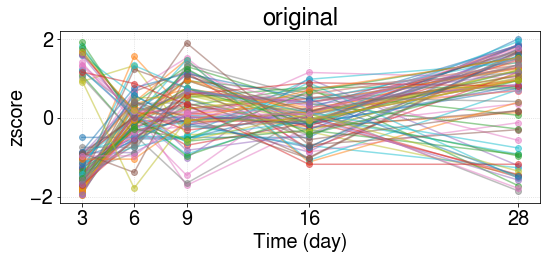

original data shape: (5, 89)
found subregulon: ['MT2A', 'LOXL4', 'ADAMTS14', 'MT1X', 'SFXN2', 'CARD10', 'ADAM19', 'CDC6', 'DOCK10', 'NREP', 'MT1E', 'SHB', 'SH3BP1', 'S100A16'] 14 0.8414611496665951
found subregulon: ['SRPX', 'PTPRG', 'GLUL', 'CALCOCO2', 'PID1', 'ALOX15B', 'RGCC', 'CLMN'] 8 0.8206978152933451
found subregulon: ['CNR1', 'TGFBR3', 'INSR', 'PIK3R1', 'ADHFE1'] 5 0.8470789204128296
found subregulon: ['ADH1B', 'FBXO32', 'CCDC69', 'SAMHD1', 'SERPING1', 'IL7', 'TMEM86A', 'SERPINF1', 'PLAU', 'GABARAPL1', 'GPX3', 'STAT5A', 'MFGE8', 'CEBPD', 'CEBPB', 'VIT', 'FZD5', 'REPS2', 'MARC1', 'METTL7A', 'BCL6', 'TXNIP', 'EIF4EBP3', 'PLEKHF1', 'RASD1', 'ZBTB16', 'RASL10B', 'APOD', 'KLF9', 'CORO6', 'STON1', 'TIMP4', 'PTGIS', 'FOXO1', 'GALNT15', 'HLA-F', 'FIBIN', 'SESN1', 'PALM', 'SERPINA3', 'DEPTOR', 'PTPRM', 'SUSD2', 'LAMA2', 'COQ8A'] 45 0.8399168260902624
################################## FINAL
original size: 89; new size 72; lost: 17
MT2A
LOXL4
ADAMTS14
MT1X
SFXN2
CARD10
ADAM19
CDC6
DOCK1

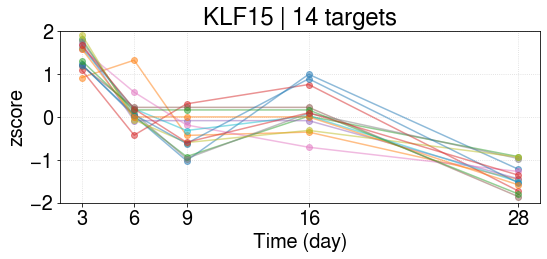

KLF15 | 1 [ 1.46963307  0.16093781 -0.36120576  0.12743748 -1.3968026 ]
SRPX
PTPRG
GLUL
CALCOCO2
PID1
ALOX15B
RGCC
CLMN
sub ['SRPX', 'PTPRG', 'GLUL', 'CALCOCO2', 'PID1', 'ALOX15B', 'RGCC', 'CLMN'] 8


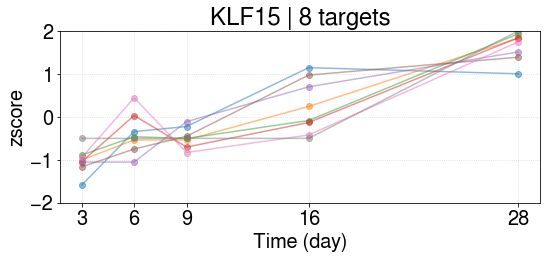

KLF15 | 2 [-1.02206321 -0.39530422 -0.4820436   0.24143987  1.65797115]
CNR1
TGFBR3
INSR
PIK3R1
ADHFE1
sub ['CNR1', 'TGFBR3', 'INSR', 'PIK3R1', 'ADHFE1'] 5


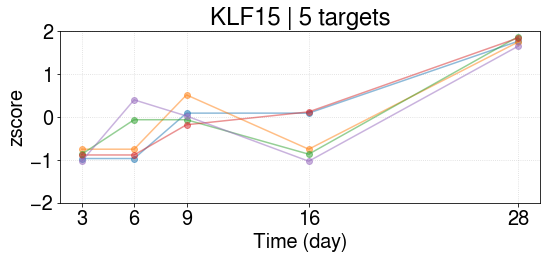

KLF15 | 3 [-0.90146759 -0.45523325  0.07441489 -0.48946188  1.77174783]
ADH1B
FBXO32
CCDC69
SAMHD1
SERPING1
IL7
TMEM86A
SERPINF1
PLAU
GABARAPL1
GPX3
STAT5A
MFGE8
CEBPD
CEBPB
VIT
FZD5
REPS2
MARC1
METTL7A
BCL6
TXNIP
EIF4EBP3
PLEKHF1
RASD1
ZBTB16
RASL10B
APOD
KLF9
CORO6
STON1
TIMP4
PTGIS
FOXO1
GALNT15
HLA-F
FIBIN
SESN1
PALM
SERPINA3
DEPTOR
PTPRM
SUSD2
LAMA2
COQ8A
sub ['ADH1B', 'FBXO32', 'CCDC69', 'SAMHD1', 'SERPING1', 'IL7', 'TMEM86A', 'SERPINF1', 'PLAU', 'GABARAPL1', 'GPX3', 'STAT5A', 'MFGE8', 'CEBPD', 'CEBPB', 'VIT', 'FZD5', 'REPS2', 'MARC1', 'METTL7A', 'BCL6', 'TXNIP', 'EIF4EBP3', 'PLEKHF1', 'RASD1', 'ZBTB16', 'RASL10B', 'APOD', 'KLF9', 'CORO6', 'STON1', 'TIMP4', 'PTGIS', 'FOXO1', 'GALNT15', 'HLA-F', 'FIBIN', 'SESN1', 'PALM', 'SERPINA3', 'DEPTOR', 'PTPRM', 'SUSD2', 'LAMA2', 'COQ8A'] 45


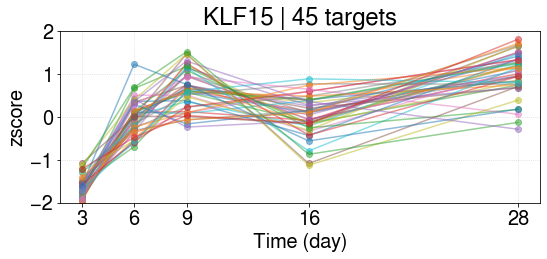

KLF15 | 4 [-1.65217883 -0.01585905  0.63153428  0.02972983  1.00677376]
----------------------------------------------------------
regulon PRDM6 64
['KIF23', 'PLEKHG5', 'GLI2', 'NT5E', 'TOP2A', 'EFEMP1', 'DHRS3', 'FOXC2', 'DCN', 'FANCA', 'PLXDC2', 'CLDN11', 'PNMA2', 'E2F8', 'PDGFRL', 'CYBRD1', 'DAPK1', 'ABCA6', 'REPS2', 'FMO2', 'DDR2', 'OSR1', 'FBLN2', 'LRRC17', 'AKR1C3', 'MGP', 'RFTN2', 'NUPR1', 'PTGIS', 'FAXDC2', 'KIAA1755', 'FBLN1', 'PODN', 'ASPN', 'MMP16', 'CTSO', 'KCNT2', 'IL1R2', 'EBF1', 'CDK1', 'SLC40A1', 'AURKB', 'MAN1C1', 'SLIT3', 'MYLIP', 'SLIT2', 'ABCA9', 'TOX', 'SIAE', 'PCDH10', 'FRZB', 'AHNAK2', 'RGS4', 'MFAP4', 'DIAPH3', 'ECM2', 'ROR2', 'NABP1', 'OLFML3', 'DKK2', 'GAS1', 'BOC', 'SERPINF1', 'STIM1']


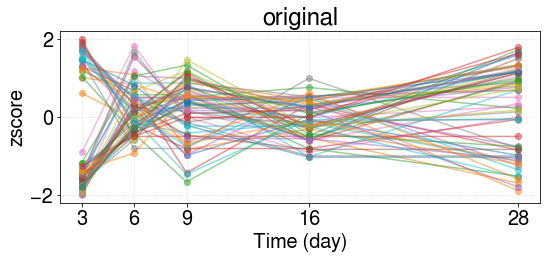

original data shape: (5, 64)
found subregulon: ['KIF23', 'PLEKHG5', 'GLI2', 'NT5E', 'TOP2A', 'FANCA', 'CLDN11', 'E2F8', 'KIAA1755', 'MMP16', 'CDK1', 'AURKB', 'SLIT2', 'TOX', 'PCDH10', 'AHNAK2', 'DIAPH3'] 17 0.8222540999168639
found subregulon: ['ECM2', 'EFEMP1', 'MYLIP', 'ROR2', 'RFTN2', 'DCN', 'SIAE', 'PDGFRL', 'NUPR1', 'SERPINF1', 'FMO2', 'FBLN1', 'MFAP4', 'CTSO', 'MAN1C1', 'GAS1', 'ASPN', 'MGP', 'FRZB', 'KCNT2', 'CYBRD1', 'REPS2', 'PTGIS', 'DDR2', 'DHRS3', 'SLC40A1', 'FAXDC2', 'PLXDC2', 'PNMA2', 'ABCA9', 'SLIT3', 'IL1R2', 'ABCA6', 'FBLN2'] 34 0.8518330882236784
################################## FINAL
original size: 64; new size 51; lost: 13
KIF23
PLEKHG5
GLI2
NT5E
TOP2A
FANCA
CLDN11
E2F8
KIAA1755
MMP16
CDK1
AURKB
SLIT2
TOX
PCDH10
AHNAK2
DIAPH3
sub ['KIF23', 'PLEKHG5', 'GLI2', 'NT5E', 'TOP2A', 'FANCA', 'CLDN11', 'E2F8', 'KIAA1755', 'MMP16', 'CDK1', 'AURKB', 'SLIT2', 'TOX', 'PCDH10', 'AHNAK2', 'DIAPH3'] 17


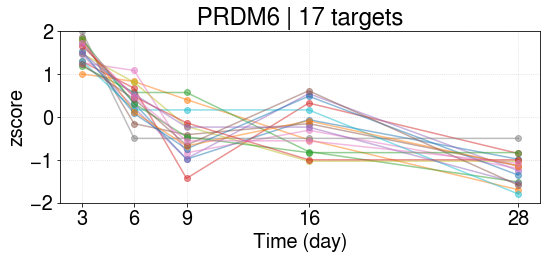

PRDM6 | 1 [ 1.51997554  0.37445473 -0.45305996 -0.23559181 -1.20577851]
ECM2
EFEMP1
MYLIP
ROR2
RFTN2
DCN
SIAE
PDGFRL
NUPR1
SERPINF1
FMO2
FBLN1
MFAP4
CTSO
MAN1C1
GAS1
ASPN
MGP
FRZB
KCNT2
CYBRD1
REPS2
PTGIS
DDR2
DHRS3
SLC40A1
FAXDC2
PLXDC2
PNMA2
ABCA9
SLIT3
IL1R2
ABCA6
FBLN2
sub ['ECM2', 'EFEMP1', 'MYLIP', 'ROR2', 'RFTN2', 'DCN', 'SIAE', 'PDGFRL', 'NUPR1', 'SERPINF1', 'FMO2', 'FBLN1', 'MFAP4', 'CTSO', 'MAN1C1', 'GAS1', 'ASPN', 'MGP', 'FRZB', 'KCNT2', 'CYBRD1', 'REPS2', 'PTGIS', 'DDR2', 'DHRS3', 'SLC40A1', 'FAXDC2', 'PLXDC2', 'PNMA2', 'ABCA9', 'SLIT3', 'IL1R2', 'ABCA6', 'FBLN2'] 34


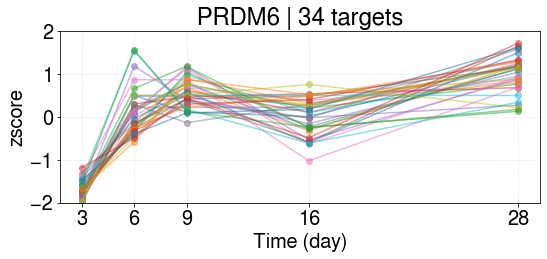

PRDM6 | 2 [-1.69965198  0.13569238  0.56273281  0.00871562  0.99251116]
----------------------------------------------------------
regulon FOXN3 57
['USP53', 'ANGPTL1', 'INSR', 'SVEP1', 'BCL2L11', 'PTPRM', 'ANTXR1', 'PLXDC2', 'YPEL2', 'CREG1', 'CYBRD1', 'THOP1', 'ABCA6', 'RHOQ', 'CPED1', 'PIK3R1', 'BTG1', 'CD302', 'ADH1B', 'LAMA2', 'FAXDC2', 'GPNMB', 'SDF2L1', 'ANTXR2', 'WASL', 'S100A16', 'C1orf21', 'KLHL24', 'ADAMTS14', 'PYCR3', 'WDR77', 'EPHB2', 'CALCOCO2', 'LRRK2', 'MTSS1', 'SLC2A6', 'FBXO32', 'NCLN', 'SLC38A5', 'TGFBR3', 'CCDC69', 'ADAMTS5', 'ABCA1', 'MYLK', 'MTFP1', 'PKMYT1', 'FOXO1', 'GFRA1', 'PDGFD', 'MAOA', 'FBLN5', 'LIFR', 'PFAS', 'WDR4', 'KLF11', 'LATS2', 'GALNT15']


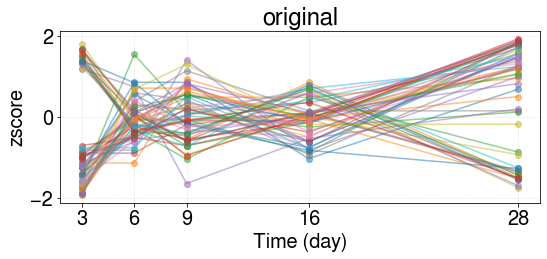

original data shape: (5, 57)
found subregulon: ['THOP1', 'SDF2L1', 'ADAMTS14', 'PYCR3', 'NCLN'] 5 0.8681895803214096
found subregulon: ['BTG1', 'FBXO32', 'PTPRM', 'ANTXR1', 'CD302', 'LAMA2', 'ABCA1', 'ADH1B', 'RHOQ', 'GALNT15', 'MTSS1', 'MAOA', 'C1orf21', 'KLF11', 'LATS2', 'ANGPTL1', 'KLHL24', 'FOXO1', 'USP53', 'INSR', 'CREG1', 'TGFBR3', 'MYLK', 'GPNMB', 'WASL', 'CALCOCO2', 'PIK3R1', 'LRRK2', 'ANTXR2'] 29 0.824244098818948
found subregulon: ['EPHB2', 'S100A16', 'PKMYT1', 'SLC2A6', 'WDR4', 'SLC38A5', 'WDR77', 'MTFP1', 'PFAS', 'FBLN5'] 10 0.8488751793875494
found subregulon: ['LIFR', 'ADAMTS5', 'CYBRD1', 'GFRA1', 'SVEP1', 'FAXDC2', 'PLXDC2', 'PDGFD'] 8 0.8463627341205148
################################## FINAL
original size: 57; new size 52; lost: 5
THOP1
SDF2L1
ADAMTS14
PYCR3
NCLN
sub ['THOP1', 'SDF2L1', 'ADAMTS14', 'PYCR3', 'NCLN'] 5


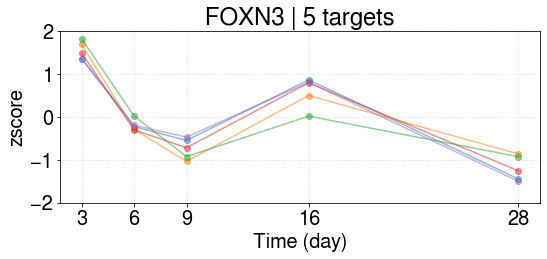

FOXN3 | 1 [ 1.5386378  -0.19878742 -0.73935907  0.59542033 -1.19591164]
BTG1
FBXO32
PTPRM
ANTXR1
CD302
LAMA2
ABCA1
ADH1B
RHOQ
GALNT15
MTSS1
MAOA
C1orf21
KLF11
LATS2
ANGPTL1
KLHL24
FOXO1
USP53
INSR
CREG1
TGFBR3
MYLK
GPNMB
WASL
CALCOCO2
PIK3R1
LRRK2
ANTXR2
sub ['BTG1', 'FBXO32', 'PTPRM', 'ANTXR1', 'CD302', 'LAMA2', 'ABCA1', 'ADH1B', 'RHOQ', 'GALNT15', 'MTSS1', 'MAOA', 'C1orf21', 'KLF11', 'LATS2', 'ANGPTL1', 'KLHL24', 'FOXO1', 'USP53', 'INSR', 'CREG1', 'TGFBR3', 'MYLK', 'GPNMB', 'WASL', 'CALCOCO2', 'PIK3R1', 'LRRK2', 'ANTXR2'] 29


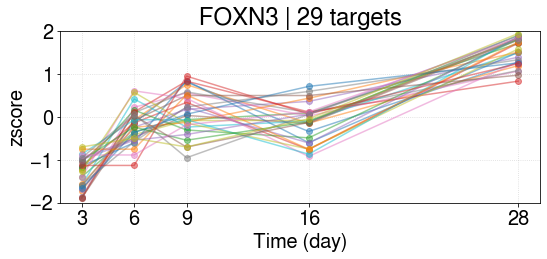

FOXN3 | 2 [-1.3171277  -0.20784577  0.11415456 -0.12464527  1.53546419]
EPHB2
S100A16
PKMYT1
SLC2A6
WDR4
SLC38A5
WDR77
MTFP1
PFAS
FBLN5
sub ['EPHB2', 'S100A16', 'PKMYT1', 'SLC2A6', 'WDR4', 'SLC38A5', 'WDR77', 'MTFP1', 'PFAS', 'FBLN5'] 10


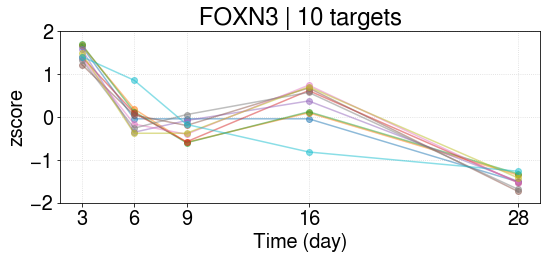

FOXN3 | 3 [ 1.47759258  0.00823965 -0.30079531  0.30207426 -1.48711118]
LIFR
ADAMTS5
CYBRD1
GFRA1
SVEP1
FAXDC2
PLXDC2
PDGFD
sub ['LIFR', 'ADAMTS5', 'CYBRD1', 'GFRA1', 'SVEP1', 'FAXDC2', 'PLXDC2', 'PDGFD'] 8


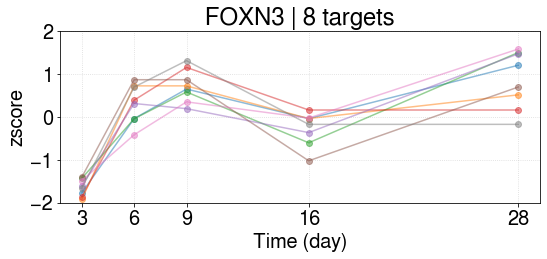

FOXN3 | 4 [-1.64237446  0.31056118  0.72757062 -0.26361824  0.86786089]
----------------------------------------------------------
regulon EBF3 63
['FGF7', 'CCDC68', 'NT5E', 'MMP28', 'CFD', 'CHRDL1', 'FOXC2', 'LCA5', 'DCN', 'CLDN11', 'ADAMTS10', 'ANGPT1', 'LEPR', 'CDKN1A', 'IGF2', 'ABCA6', 'FIBIN', 'CADM3', 'FZD4', 'FMO2', 'CPED1', 'NMNAT2', 'SNCG', 'DDR2', 'FBLN2', 'ADH1B', 'OLFML2A', 'MGP', 'MAP3K12', 'RFTN2', 'PODN', 'HNMT', 'MMP16', 'CLEC3B', 'FAM83G', 'CDCP1', 'PCDH19', 'EBF1', 'DPT', 'PRCD', 'CYGB', 'EEPD1', 'APOL3', 'TNNT3', 'SLIT3', 'ABCA9', 'MTSS1', 'TMEM150C', 'ADAMTS5', 'PEAR1', 'MFAP4', 'VIT', 'ECM2', 'GFRA1', 'CFI', 'C6', 'LIFR', 'APOD', 'GAS1', 'PMP22', 'MYL3', 'BOC', 'SERPINF1']


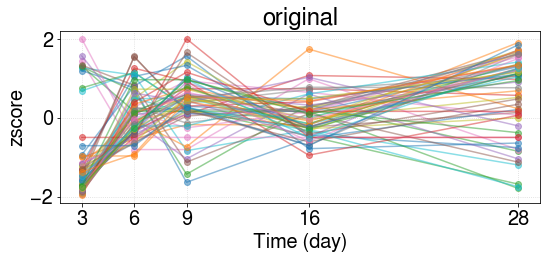

original data shape: (5, 63)
found subregulon: ['ADH1B', 'DCN', 'HNMT', 'LEPR', 'FGF7', 'IGF2', 'EBF1', 'ECM2', 'CYGB', 'SERPINF1', 'GAS1', 'DDR2', 'CFD', 'RFTN2', 'MFAP4', 'VIT', 'ANGPT1', 'CADM3', 'FMO2', 'PMP22', 'APOD', 'SLIT3', 'MGP', 'MMP28', 'FZD4', 'ADAMTS5', 'TMEM150C', 'GFRA1', 'DPT', 'OLFML2A', 'LCA5', 'FIBIN', 'MTSS1', 'MAP3K12', 'BOC', 'PRCD', 'APOL3', 'FBLN2', 'C6', 'CFI', 'CHRDL1', 'CLEC3B'] 42 0.8312364046550278
################################## FINAL
original size: 63; new size 42; lost: 21
ADH1B
DCN
HNMT
LEPR
FGF7
IGF2
EBF1
ECM2
CYGB
SERPINF1
GAS1
DDR2
CFD
RFTN2
MFAP4
VIT
ANGPT1
CADM3
FMO2
PMP22
APOD
SLIT3
MGP
MMP28
FZD4
ADAMTS5
TMEM150C
GFRA1
DPT
OLFML2A
LCA5
FIBIN
MTSS1
MAP3K12
BOC
PRCD
APOL3
FBLN2
C6
CFI
CHRDL1
CLEC3B
sub ['ADH1B', 'DCN', 'HNMT', 'LEPR', 'FGF7', 'IGF2', 'EBF1', 'ECM2', 'CYGB', 'SERPINF1', 'GAS1', 'DDR2', 'CFD', 'RFTN2', 'MFAP4', 'VIT', 'ANGPT1', 'CADM3', 'FMO2', 'PMP22', 'APOD', 'SLIT3', 'MGP', 'MMP28', 'FZD4', 'ADAMTS5', 'TMEM150C', 'GFRA1', 'DPT

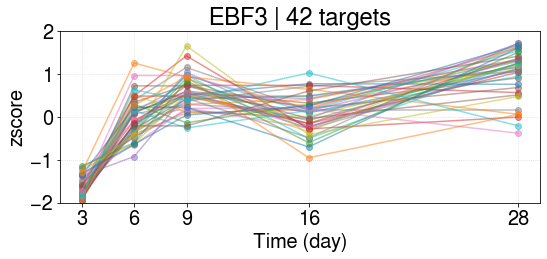

EBF3 | 1 [-1.63933817 -0.02687162  0.55474809  0.06737089  1.04409081]
----------------------------------------------------------
regulon HIF3A 85
['ANGPTL1', 'CLMN', 'ABCA6', 'FIBIN', 'FJX1', 'ELN', 'LAMA2', 'ANTXR2', 'C1orf21', 'CACNB2', 'CRISPLD2', 'KLF9', 'CALCOCO2', 'SMOC1', 'ZBTB16', 'SRPX', 'TPM1', 'ALOX15B', 'PEAR1', 'VIT', 'MFGE8', 'MYL3', 'ARHGAP6', 'INSR', 'PTPRM', 'EFEMP1', 'SAMHD1', 'PTPRG', 'POLE', 'FZD4', 'PIK3R1', 'SESN1', 'GPX3', 'TIMP4', 'ADH1B', 'FAXDC2', 'TGFBI', 'CORO6', 'PCDH19', 'HSPA5', 'RANBP3L', 'CDKN1C', 'MTSS1', 'IGFBP5', 'TGFBR3', 'FOXO1', 'MAOA', 'C6', 'CCDC68', 'GGT5', 'EPAS1', 'GPR17', 'APOL3', 'TSC22D3', 'METTL7A', 'FBXO32', 'PLAU', 'RASL11A', 'ADHFE1', 'RASL10B', 'SUV39H1', 'TMEM59L', 'LIFR', 'TMEM100', 'EPHB6', 'KLF15', 'PPARG', 'PDK4', 'OSR2', 'FMO2', 'PAK3', 'PTH1R', 'SERPINE2', 'PRCD', 'ABCA9', 'PID1', 'TMEM150C', 'CSPG4', 'CBX7', 'KIAA1217', 'PLEKHF1', 'LIMS2', 'TOX2', 'CNR1', 'GALNT15']


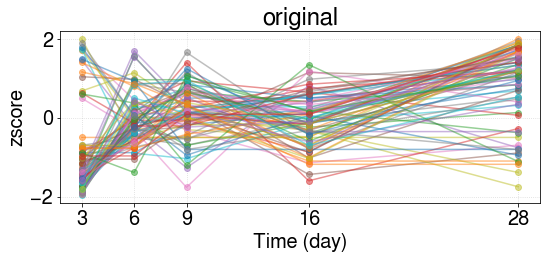

original data shape: (5, 85)
found subregulon: ['TPM1', 'POLE', 'PCDH19', 'GPR17', 'SUV39H1', 'PAK3', 'CSPG4', 'LIMS2'] 8 0.833052977073783
found subregulon: ['PIK3R1', 'KLF15', 'PDK4', 'PTPRG', 'CDKN1C', 'PID1', 'PTH1R', 'TGFBR3', 'INSR', 'CALCOCO2', 'MYL3', 'ALOX15B', 'OSR2', 'ADHFE1', 'TMEM59L', 'ANTXR2', 'CLMN'] 17 0.8328802140718115
found subregulon: ['ADH1B', 'FBXO32', 'SMOC1', 'SAMHD1', 'CACNB2', 'METTL7A', 'EFEMP1', 'ANGPTL1', 'PPARG', 'CBX7', 'GGT5', 'CRISPLD2', 'PLAU', 'ZBTB16', 'GPX3', 'FZD4', 'ARHGAP6', 'RASL10B', 'FMO2', 'EPAS1', 'SESN1', 'VIT', 'KLF9', 'MFGE8', 'MAOA', 'TMEM150C', 'FOXO1', 'PLEKHF1', 'GALNT15', 'TIMP4', 'CORO6', 'PTPRM', 'RASL11A', 'RANBP3L', 'KIAA1217', 'MTSS1', 'PRCD', 'FIBIN', 'FAXDC2', 'LAMA2', 'C6', 'ABCA9', 'PEAR1'] 43 0.8389517482991065
################################## FINAL
original size: 85; new size 68; lost: 17
TPM1
POLE
PCDH19
GPR17
SUV39H1
PAK3
CSPG4
LIMS2
sub ['TPM1', 'POLE', 'PCDH19', 'GPR17', 'SUV39H1', 'PAK3', 'CSPG4', 'LIMS2'] 8


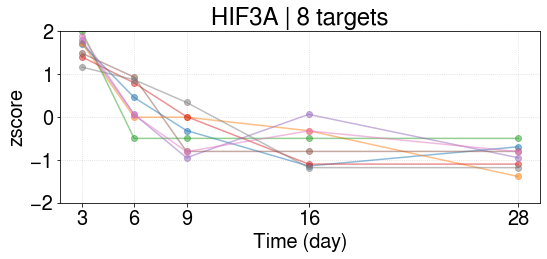

HIF3A | 1 [ 1.64362686  0.32957283 -0.38043934 -0.66442224 -0.92833812]
PIK3R1
KLF15
PDK4
PTPRG
CDKN1C
PID1
PTH1R
TGFBR3
INSR
CALCOCO2
MYL3
ALOX15B
OSR2
ADHFE1
TMEM59L
ANTXR2
CLMN
sub ['PIK3R1', 'KLF15', 'PDK4', 'PTPRG', 'CDKN1C', 'PID1', 'PTH1R', 'TGFBR3', 'INSR', 'CALCOCO2', 'MYL3', 'ALOX15B', 'OSR2', 'ADHFE1', 'TMEM59L', 'ANTXR2', 'CLMN'] 17


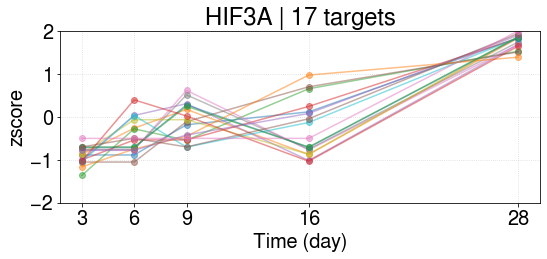

HIF3A | 2 [-0.89479973 -0.47487867 -0.12088347 -0.27193379  1.76249565]
ADH1B
FBXO32
SMOC1
SAMHD1
CACNB2
METTL7A
EFEMP1
ANGPTL1
PPARG
CBX7
GGT5
CRISPLD2
PLAU
ZBTB16
GPX3
FZD4
ARHGAP6
RASL10B
FMO2
EPAS1
SESN1
VIT
KLF9
MFGE8
MAOA
TMEM150C
FOXO1
PLEKHF1
GALNT15
TIMP4
CORO6
PTPRM
RASL11A
RANBP3L
KIAA1217
MTSS1
PRCD
FIBIN
FAXDC2
LAMA2
C6
ABCA9
PEAR1
sub ['ADH1B', 'FBXO32', 'SMOC1', 'SAMHD1', 'CACNB2', 'METTL7A', 'EFEMP1', 'ANGPTL1', 'PPARG', 'CBX7', 'GGT5', 'CRISPLD2', 'PLAU', 'ZBTB16', 'GPX3', 'FZD4', 'ARHGAP6', 'RASL10B', 'FMO2', 'EPAS1', 'SESN1', 'VIT', 'KLF9', 'MFGE8', 'MAOA', 'TMEM150C', 'FOXO1', 'PLEKHF1', 'GALNT15', 'TIMP4', 'CORO6', 'PTPRM', 'RASL11A', 'RANBP3L', 'KIAA1217', 'MTSS1', 'PRCD', 'FIBIN', 'FAXDC2', 'LAMA2', 'C6', 'ABCA9', 'PEAR1'] 43


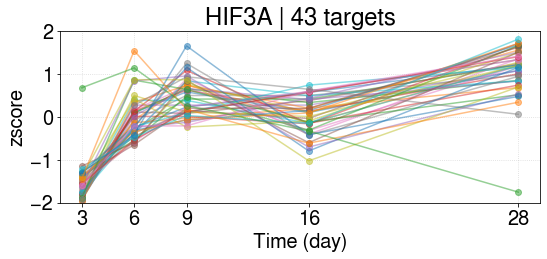

HIF3A | 3 [-1.5732977  -0.00954179  0.45723766  0.04170939  1.08389244]
----------------------------------------------------------
regulon SOX5 95
['GRASP', 'MMP28', 'ABCA6', 'CD302', 'LAMA2', 'ENPP1', 'CTSO', 'STON1', 'TOX', 'GBP2', 'NCLN', 'PLD5', 'ADAMTS5', 'VIT', 'GFRA1', 'KIF18B', 'PLPP1', 'EPS8', 'ATP8B4', 'SLC7A2', 'RORB', 'ANKRD28', 'CHRDL1', 'CYBRD1', 'FERMT1', 'CPED1', 'TSC22D1', 'NMNAT2', 'PCMTD1', 'PIK3R1', 'FBLN2', 'LRP8', 'ADH1B', 'POSTN', 'FAXDC2', 'PODN', 'SERPING1', 'ABI3BP', 'SGCD', 'PCDH19', 'DEPDC1', 'RANBP3L', 'PRR15', 'SLIT2', 'LRRK2', 'PCDH10', 'IGFBP5', 'FRZB', 'TGFBR3', 'MFAP4', 'PDGFRA', 'ECM2', 'COL11A1', 'GAS1', 'SSBP2', 'ESCO2', 'CCDC68', 'A2M', 'HNMT', 'GLYATL1', 'LYPD6', 'EBF1', 'FBLN5', 'NF2', 'LIFR', 'COL21A1', 'LATS2', 'PMP22', 'TMEM100', 'EPHX1', 'NRCAM', 'EPHB6', 'TLE2', 'DCN', 'LCA5', 'OSR2', 'ANGPT1', 'PAK3', 'DDR2', 'KCNMA1', 'ABCC9', 'ACSS3', 'ASPN', 'HMCN1', 'GPC6', 'C7', 'IL1RL1', 'HTRA1', 'ABCA9', 'TIAM1', 'PID1', 'CSPG4', 'IL18R1', 'MYLK', 'O

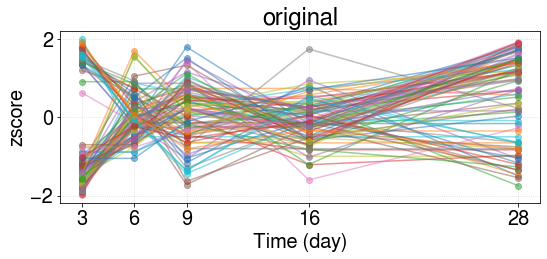

original data shape: (5, 95)
found subregulon: ['TOX', 'NCLN', 'PLD5', 'KIF18B', 'FERMT1', 'LRP8', 'ABI3BP', 'SGCD', 'PCDH19', 'DEPDC1', 'PRR15', 'SLIT2', 'PCDH10', 'ESCO2', 'GLYATL1', 'LYPD6', 'FBLN5', 'NF2', 'PAK3', 'KCNMA1', 'TIAM1', 'CSPG4'] 22 0.8291556426878405
found subregulon: ['PID1', 'RORB', 'OSR2', 'IL1RL1'] 4 0.8926737160552495
found subregulon: ['HNMT', 'PDGFRA', 'TLE2', 'EBF1', 'IL18R1', 'ADH1B', 'DCN', 'ECM2', 'ANGPT1', 'GPC6', 'SERPING1', 'CYBRD1', 'HTRA1', 'TSC22D1', 'CD302', 'ATP8B4', 'COL21A1', 'MFAP4', 'DDR2', 'PMP22', 'SSBP2', 'FRZB', 'GAS1', 'LCA5', 'STON1', 'ASPN', 'VIT', 'NRCAM', 'SLC7A2', 'FBLN2', 'CTSO', 'HMCN1', 'PCMTD1', 'ADAMTS5', 'PLPP1', 'GBP2', 'C7', 'ANKRD28', 'LAMA2', 'GFRA1', 'EPS8', 'MMP28', 'FAXDC2', 'RANBP3L', 'COL11A1', 'EPHX1', 'ABCA9', 'OLFML3', 'ACSS3', 'ABCA6', 'LATS2', 'ABCC9'] 52 0.835816545806518
################################## FINAL
original size: 95; new size 78; lost: 17
TOX
NCLN
PLD5
KIF18B
FERMT1
LRP8
ABI3BP
SGCD
PCDH19
DEPDC1
PRR15

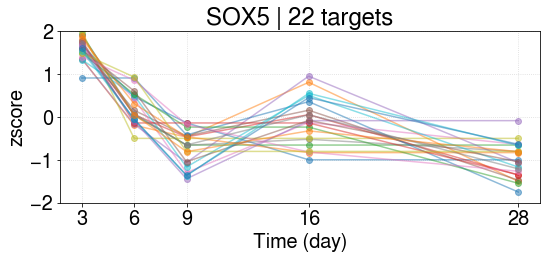

SOX5 | 1 [ 1.61106722  0.21551373 -0.71699105 -0.10304461 -1.00654529]
PID1
RORB
OSR2
IL1RL1
sub ['PID1', 'RORB', 'OSR2', 'IL1RL1'] 4


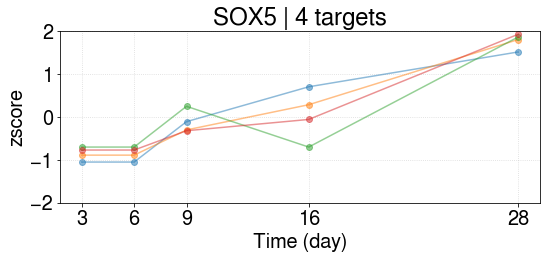

SOX5 | 2 [-0.85378117 -0.85378117 -0.1223883   0.05568069  1.77426994]
HNMT
PDGFRA
TLE2
EBF1
IL18R1
ADH1B
DCN
ECM2
ANGPT1
GPC6
SERPING1
CYBRD1
HTRA1
TSC22D1
CD302
ATP8B4
COL21A1
MFAP4
DDR2
PMP22
SSBP2
FRZB
GAS1
LCA5
STON1
ASPN
VIT
NRCAM
SLC7A2
FBLN2
CTSO
HMCN1
PCMTD1
ADAMTS5
PLPP1
GBP2
C7
ANKRD28
LAMA2
GFRA1
EPS8
MMP28
FAXDC2
RANBP3L
COL11A1
EPHX1
ABCA9
OLFML3
ACSS3
ABCA6
LATS2
ABCC9
sub ['HNMT', 'PDGFRA', 'TLE2', 'EBF1', 'IL18R1', 'ADH1B', 'DCN', 'ECM2', 'ANGPT1', 'GPC6', 'SERPING1', 'CYBRD1', 'HTRA1', 'TSC22D1', 'CD302', 'ATP8B4', 'COL21A1', 'MFAP4', 'DDR2', 'PMP22', 'SSBP2', 'FRZB', 'GAS1', 'LCA5', 'STON1', 'ASPN', 'VIT', 'NRCAM', 'SLC7A2', 'FBLN2', 'CTSO', 'HMCN1', 'PCMTD1', 'ADAMTS5', 'PLPP1', 'GBP2', 'C7', 'ANKRD28', 'LAMA2', 'GFRA1', 'EPS8', 'MMP28', 'FAXDC2', 'RANBP3L', 'COL11A1', 'EPHX1', 'ABCA9', 'OLFML3', 'ACSS3', 'ABCA6', 'LATS2', 'ABCC9'] 52


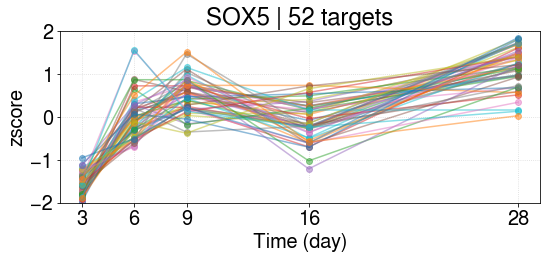

SOX5 | 3 [-1.57028086 -0.01510714  0.50137994 -0.09867483  1.18268289]
----------------------------------------------------------
regulon HAND2 64
['ANGPTL1', 'TMEM100', 'C1S', 'C1R', 'EFEMP1', 'ANTXR1', 'UCHL1', 'DCN', 'ARMC9', 'PDGFRL', 'SMTN', 'ABCA6', 'FIBIN', 'CADM3', 'PTH1R', 'ATP10A', 'DDR2', 'GGT5', 'ELN', 'LAMA2', 'OTOGL', 'CAP2', 'MGP', 'PTGIS', 'SLC29A1', 'FBLN1', 'SERPING1', 'ASPN', 'ANTXR2', 'PODN', 'CTXN1', 'CACNB2', 'C7', 'AXL', 'TSC22D3', 'STON1', 'HTRA1', 'SLIT2', 'FMOD', 'NCAM2', 'CDH2', 'RSPO1', 'PID1', 'SRPX', 'CNN1', 'TPM1', 'RASL11A', 'CBX7', 'CCDC69', 'MFAP4', 'MYLK', 'MFGE8', 'PDGFRA', 'ROR2', 'LIMS2', 'TMEM59L', 'FBLN5', 'VIT', 'COL21A1', 'OLFML3', 'GAS1', 'PMP22', 'B3GALT2', 'SSPN']


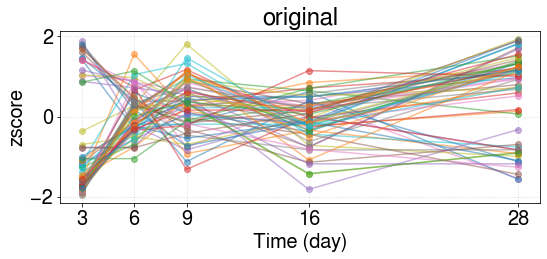

original data shape: (5, 64)
found subregulon: ['UCHL1', 'SMTN', 'ATP10A', 'CAP2', 'SLC29A1', 'CTXN1', 'AXL', 'SLIT2', 'CDH2', 'TPM1', 'FBLN5'] 11 0.8333045553053388
found subregulon: ['DCN', 'PDGFRA', 'DDR2', 'CCDC69', 'GAS1', 'SERPING1', 'SSPN', 'PDGFRL', 'COL21A1', 'HTRA1', 'C1S', 'GGT5', 'ANGPTL1', 'EFEMP1', 'CACNB2', 'CBX7', 'CADM3', 'MFAP4', 'FBLN1', 'STON1', 'PMP22', 'MGP', 'LAMA2', 'FMOD', 'C7', 'TSC22D3', 'VIT', 'TMEM100', 'NCAM2', 'MFGE8', 'OTOGL', 'SRPX', 'C1R', 'ANTXR1', 'PID1', 'ASPN', 'MYLK', 'OLFML3', 'TMEM59L', 'FIBIN', 'ANTXR2', 'RASL11A', 'B3GALT2', 'PTGIS'] 44 0.8275644210776122
################################## FINAL
original size: 64; new size 55; lost: 9
UCHL1
SMTN
ATP10A
CAP2
SLC29A1
CTXN1
AXL
SLIT2
CDH2
TPM1
FBLN5
sub ['UCHL1', 'SMTN', 'ATP10A', 'CAP2', 'SLC29A1', 'CTXN1', 'AXL', 'SLIT2', 'CDH2', 'TPM1', 'FBLN5'] 11


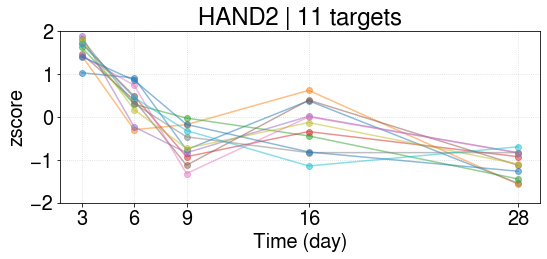

HAND2 | 1 [ 1.57106353  0.3697358  -0.62402514 -0.20973603 -1.10703817]
DCN
PDGFRA
DDR2
CCDC69
GAS1
SERPING1
SSPN
PDGFRL
COL21A1
HTRA1
C1S
GGT5
ANGPTL1
EFEMP1
CACNB2
CBX7
CADM3
MFAP4
FBLN1
STON1
PMP22
MGP
LAMA2
FMOD
C7
TSC22D3
VIT
TMEM100
NCAM2
MFGE8
OTOGL
SRPX
C1R
ANTXR1
PID1
ASPN
MYLK
OLFML3
TMEM59L
FIBIN
ANTXR2
RASL11A
B3GALT2
PTGIS
sub ['DCN', 'PDGFRA', 'DDR2', 'CCDC69', 'GAS1', 'SERPING1', 'SSPN', 'PDGFRL', 'COL21A1', 'HTRA1', 'C1S', 'GGT5', 'ANGPTL1', 'EFEMP1', 'CACNB2', 'CBX7', 'CADM3', 'MFAP4', 'FBLN1', 'STON1', 'PMP22', 'MGP', 'LAMA2', 'FMOD', 'C7', 'TSC22D3', 'VIT', 'TMEM100', 'NCAM2', 'MFGE8', 'OTOGL', 'SRPX', 'C1R', 'ANTXR1', 'PID1', 'ASPN', 'MYLK', 'OLFML3', 'TMEM59L', 'FIBIN', 'ANTXR2', 'RASL11A', 'B3GALT2', 'PTGIS'] 44


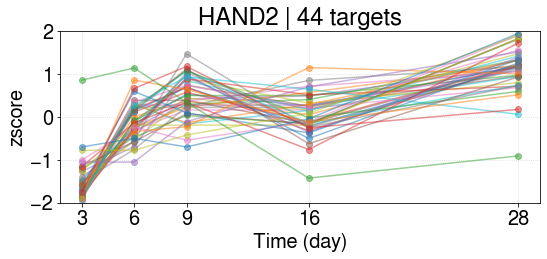

HAND2 | 2 [-1.54214368 -0.08254084  0.43836477  0.05892387  1.12739589]
----------------------------------------------------------
regulon NFATC4 99
['ANGPTL1', 'CPT1C', 'C1S', 'GLI2', 'NT5E', 'ARMC9', 'THOP1', 'ABCA6', 'RARRES2', 'RACGAP1', 'SPON1', 'NUPR1', 'GYPC', 'FBLN1', 'HCFC1R1', 'FTL', 'STON1', 'NCAM2', 'ALCAM', 'PEAR1', 'MEST', 'BTBD3', 'PLPP1', 'EPS8', 'ARHGAP6', 'ST3GAL5', 'CLDN11', 'PALM', 'FAM110B', 'FZD4', 'IL3RA', 'PAMR1', 'FAM20A', 'FBLN7', 'KIAA1755', 'PODN', 'SERPING1', 'SDF2L1', 'CNTNAP1', 'CORO6', 'CDK1', 'AXL', 'PXN', 'LRRK2', 'NBL1', 'FST', 'ASAP3', 'BOC', 'PLEKHH2', 'SSBP2', 'ZCCHC24', 'CIT', 'GNB3', 'B4GALNT1', 'SAMD11', 'WDR86', 'SMTN', 'CCND2', 'IFNGR1', 'GGT5', 'MGP', 'MYO15B', 'KCNT2', 'SNED1', 'EBF1', 'VWA5A', 'FMO3', 'TMEM59L', 'FBLN5', 'LUM', 'PSD4', 'SVEP1', 'C1R', 'NRCAM', 'ADA', 'MYO1B', 'TLE2', 'DCN', 'OSR2', 'ADAMTS10', 'CFH', 'PTH1R', 'MAP3K12', 'ADAMTSL4', 'SLC29A1', 'KCNJ8', 'ECT2', 'PAPPA', 'PRCD', 'CYGB', 'HTRA1', 'ABCA9', 'FMOD', 'C11orf95', 'C

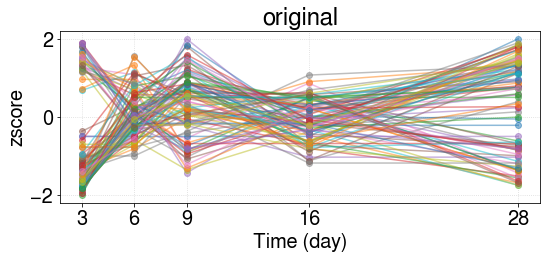

original data shape: (5, 99)
found subregulon: ['NT5E', 'THOP1', 'RACGAP1', 'CLDN11', 'PAMR1', 'KIAA1755', 'SDF2L1', 'CNTNAP1', 'CDK1', 'AXL', 'PXN', 'CIT', 'B4GALNT1', 'SMTN', 'FBLN5', 'PSD4', 'MYO1B', 'SLC29A1', 'ECT2', 'CSPG4', 'MTFP1'] 21 0.8280907352004617
found subregulon: ['TMEM59L', 'CCND2', 'LRRK2', 'BTBD3'] 4 0.8346401365820033
found subregulon: ['PRCD', 'ST3GAL5', 'SPON1', 'OSR2'] 4 0.863292857325912
found subregulon: ['SERPING1', 'DCN', 'C1S', 'NUPR1', 'MYO15B', 'PCDH18', 'EBF1', 'FST', 'FBLN1', 'CFH', 'CYGB', 'NBL1', 'ANGPTL1', 'ZCCHC24', 'TLE2', 'GYPC', 'ARHGAP6', 'FTL', 'ASAP3', 'FMO3', 'C1R', 'FMOD', 'LUM', 'GGT5', 'HCFC1R1', 'SVEP1', 'FBLN7', 'SSBP2', 'PLPP1', 'KCNT2', 'CORO6', 'MGP', 'OLFML3', 'IFNGR1', 'ADAMTSL4', 'FZD4', 'ADA', 'STON1', 'KCNJ8', 'MEST', 'CPT1C', 'MAP3K12', 'GLI2', 'FAM20A', 'GNB3'] 45 0.8413516731033862
################################## FINAL
original size: 99; new size 74; lost: 25
NT5E
THOP1
RACGAP1
CLDN11
PAMR1
KIAA1755
SDF2L1
CNTNAP1
CDK1
AXL
P

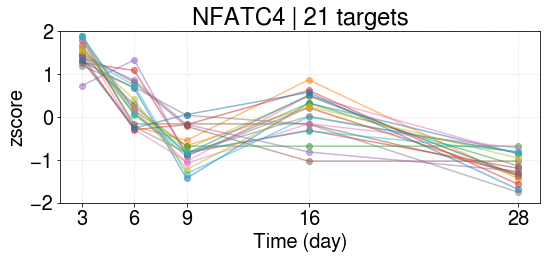

NFATC4 | 1 [ 1.5047016   0.29188922 -0.69236665  0.05817451 -1.16239869]
TMEM59L
CCND2
LRRK2
BTBD3
sub ['TMEM59L', 'CCND2', 'LRRK2', 'BTBD3'] 4


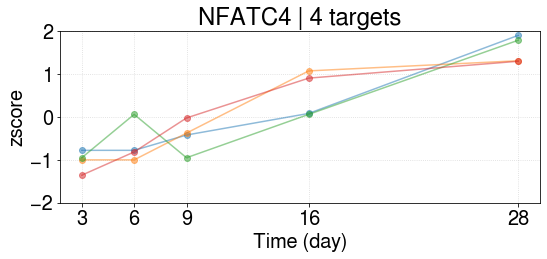

NFATC4 | 2 [-1.02175592 -0.6341281  -0.44359767  0.52824843  1.57123327]
PRCD
ST3GAL5
SPON1
OSR2
sub ['PRCD', 'ST3GAL5', 'SPON1', 'OSR2'] 4


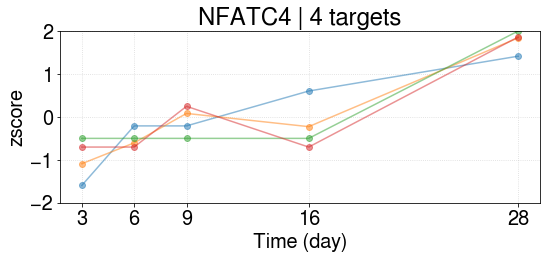

NFATC4 | 3 [-0.9723922  -0.50397563 -0.09548668 -0.20679507  1.77864956]
SERPING1
DCN
C1S
NUPR1
MYO15B
PCDH18
EBF1
FST
FBLN1
CFH
CYGB
NBL1
ANGPTL1
ZCCHC24
TLE2
GYPC
ARHGAP6
FTL
ASAP3
FMO3
C1R
FMOD
LUM
GGT5
HCFC1R1
SVEP1
FBLN7
SSBP2
PLPP1
KCNT2
CORO6
MGP
OLFML3
IFNGR1
ADAMTSL4
FZD4
ADA
STON1
KCNJ8
MEST
CPT1C
MAP3K12
GLI2
FAM20A
GNB3
sub ['SERPING1', 'DCN', 'C1S', 'NUPR1', 'MYO15B', 'PCDH18', 'EBF1', 'FST', 'FBLN1', 'CFH', 'CYGB', 'NBL1', 'ANGPTL1', 'ZCCHC24', 'TLE2', 'GYPC', 'ARHGAP6', 'FTL', 'ASAP3', 'FMO3', 'C1R', 'FMOD', 'LUM', 'GGT5', 'HCFC1R1', 'SVEP1', 'FBLN7', 'SSBP2', 'PLPP1', 'KCNT2', 'CORO6', 'MGP', 'OLFML3', 'IFNGR1', 'ADAMTSL4', 'FZD4', 'ADA', 'STON1', 'KCNJ8', 'MEST', 'CPT1C', 'MAP3K12', 'GLI2', 'FAM20A', 'GNB3'] 45


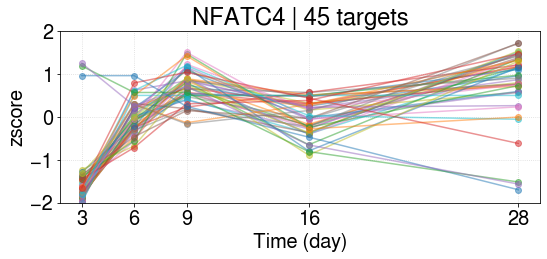

NFATC4 | 4 [-1.48659794 -0.00693141  0.7062005  -0.02575455  0.8130834 ]
----------------------------------------------------------
regulon SP100 47
['FGF7', 'PDE1A', 'ATP8B4', 'MAP3K8', 'CFAP69', 'ANKRD28', 'MYO1B', 'YPEL2', 'CREG1', 'RCN1', 'VCAM1', 'ABCA6', 'FAM110B', 'CFH', 'PIK3IP1', 'BTG1', 'TP53INP1', 'IFNGR1', 'CCNG2', 'STOM', 'RUNX2', 'FAM20A', 'ST6GAL1', 'GYPC', 'HLA-F', 'ASPN', 'CREBRF', 'PNRC1', 'TNFSF10', 'APOL3', 'BST2', 'STON1', 'TUBB4B', 'IFITM1', 'SLC22A15', 'VWA5A', 'VGLL4', 'RAP1B', 'GBP2', 'APOL6', 'ZNF277', 'APOL1', 'SLC44A1', 'ABCA1', 'NABP1', 'PLSCR1', 'PLEKHH2']


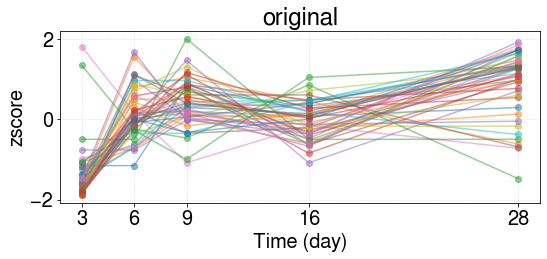

original data shape: (5, 47)
found subregulon: ['ABCA1', 'FGF7', 'PNRC1', 'TP53INP1', 'CREBRF', 'APOL1', 'BTG1', 'ATP8B4', 'CFH', 'RCN1', 'BST2', 'STON1', 'RAP1B', 'YPEL2', 'GBP2', 'GYPC', 'PLEKHH2', 'ASPN', 'CCNG2', 'CREG1', 'PIK3IP1', 'STOM', 'IFITM1', 'MAP3K8', 'ZNF277', 'RUNX2', 'IFNGR1', 'CFAP69', 'TNFSF10', 'ANKRD28', 'APOL3', 'PDE1A', 'FAM20A', 'FAM110B'] 34 0.8223068783822703
################################## FINAL
original size: 47; new size 34; lost: 13
ABCA1
FGF7
PNRC1
TP53INP1
CREBRF
APOL1
BTG1
ATP8B4
CFH
RCN1
BST2
STON1
RAP1B
YPEL2
GBP2
GYPC
PLEKHH2
ASPN
CCNG2
CREG1
PIK3IP1
STOM
IFITM1
MAP3K8
ZNF277
RUNX2
IFNGR1
CFAP69
TNFSF10
ANKRD28
APOL3
PDE1A
FAM20A
FAM110B
sub ['ABCA1', 'FGF7', 'PNRC1', 'TP53INP1', 'CREBRF', 'APOL1', 'BTG1', 'ATP8B4', 'CFH', 'RCN1', 'BST2', 'STON1', 'RAP1B', 'YPEL2', 'GBP2', 'GYPC', 'PLEKHH2', 'ASPN', 'CCNG2', 'CREG1', 'PIK3IP1', 'STOM', 'IFITM1', 'MAP3K8', 'ZNF277', 'RUNX2', 'IFNGR1', 'CFAP69', 'TNFSF10', 'ANKRD28', 'APOL3', 'PDE1A', 'FAM20A', 'FAM1

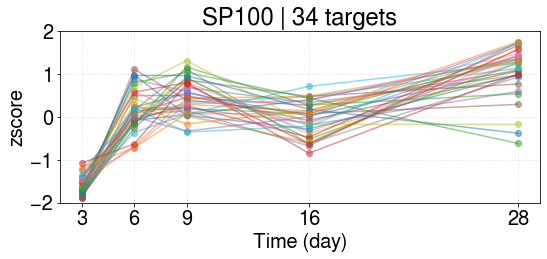

SP100 | 1 [-1.62404357  0.1396359   0.45411371 -0.0541751   1.08446906]
----------------------------------------------------------
regulon EMX2 48
['ANGPTL1', 'SUSD2', 'MMP28', 'TLE2', 'CHRDL1', 'NDNF', 'OSR2', 'DCN', 'ADAMTS10', 'PDGFRL', 'PALM', 'CYBRD1', 'FIBIN', 'CADM3', 'FZD1', 'SNCG', 'DDR2', 'KCNMA1', 'FBLN2', 'CRLF1', 'MYO1D', 'PRRX2', 'ARHGAP11B', 'ELN', 'OLFML2A', 'RFTN2', 'CAP2', 'FBLN1', 'PODN', 'HNMT', 'KCNJ8', 'KCNT2', 'EBF1', 'FAM180A', 'CTXN1', 'SMOC1', 'MYBBP1A', 'IGFBP5', 'RSPO1', 'AHNAK2', 'CNN1', 'MYLK', 'VIT', 'ECM2', 'C6', 'MAP4K2', 'GAS1', 'AMIGO2']


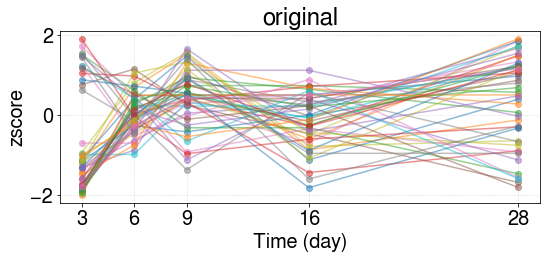

original data shape: (5, 48)
found subregulon: ['KCNMA1', 'ARHGAP11B', 'CAP2', 'CTXN1', 'MYBBP1A', 'AHNAK2', 'MAP4K2'] 7 0.8260327378084529
found subregulon: ['SMOC1', 'GAS1', 'DDR2', 'HNMT', 'ANGPTL1', 'PDGFRL', 'EBF1', 'TLE2', 'CADM3', 'FBLN1', 'ECM2', 'NDNF', 'CHRDL1', 'RFTN2', 'OLFML2A', 'MMP28', 'CYBRD1', 'VIT', 'CRLF1', 'FBLN2', 'KCNT2', 'MYO1D', 'PRRX2', 'FIBIN', 'MYLK', 'FZD1', 'OSR2', 'KCNJ8'] 28 0.8276695512377137
################################## FINAL
original size: 48; new size 35; lost: 13
KCNMA1
ARHGAP11B
CAP2
CTXN1
MYBBP1A
AHNAK2
MAP4K2
sub ['KCNMA1', 'ARHGAP11B', 'CAP2', 'CTXN1', 'MYBBP1A', 'AHNAK2', 'MAP4K2'] 7


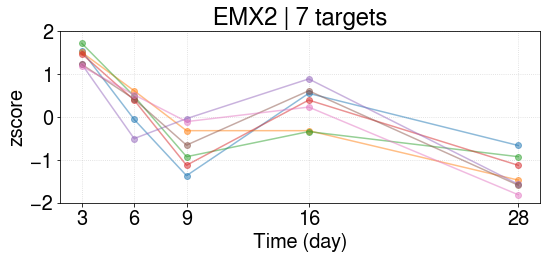

EMX2 | 1 [ 1.40809137  0.26435021 -0.64982791  0.28561077 -1.30822443]
SMOC1
GAS1
DDR2
HNMT
ANGPTL1
PDGFRL
EBF1
TLE2
CADM3
FBLN1
ECM2
NDNF
CHRDL1
RFTN2
OLFML2A
MMP28
CYBRD1
VIT
CRLF1
FBLN2
KCNT2
MYO1D
PRRX2
FIBIN
MYLK
FZD1
OSR2
KCNJ8
sub ['SMOC1', 'GAS1', 'DDR2', 'HNMT', 'ANGPTL1', 'PDGFRL', 'EBF1', 'TLE2', 'CADM3', 'FBLN1', 'ECM2', 'NDNF', 'CHRDL1', 'RFTN2', 'OLFML2A', 'MMP28', 'CYBRD1', 'VIT', 'CRLF1', 'FBLN2', 'KCNT2', 'MYO1D', 'PRRX2', 'FIBIN', 'MYLK', 'FZD1', 'OSR2', 'KCNJ8'] 28


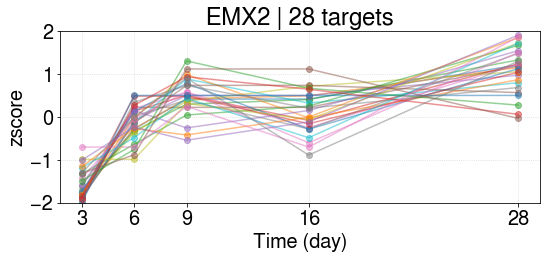

EMX2 | 2 [-1.58556562 -0.15033873  0.48014375  0.12115154  1.13460906]
----------------------------------------------------------
regulon ZHX3 61
['USP53', 'NFYB', 'ZCCHC24', 'ANGPTL1', 'PTPRM', 'CA2', 'KLF15', 'RAB31', 'CHRDL1', 'SAMHD1', 'PTPRG', 'APOB', 'CKS2', 'PNP', 'FIBIN', 'PTH1R', 'G0S2', 'PIK3IP1', 'PIK3R1', 'KCNMA1', 'TIMP4', 'ADH1B', 'LAMA2', 'TMEM86A', 'TXNIP', 'C1orf21', 'CORO6', 'CACNB2', 'KLF9', 'TSC22D3', 'STON1', 'GDF15', 'METTL7A', 'CALCOCO2', 'ZBTB16', 'MTSS1', 'HBEGF', 'FBXO32', 'TGFBR3', 'CBX7', 'TPM1', 'ISM1', 'DTNA', 'SLC44A1', 'CCDC69', 'PDGFRA', 'RASL10B', 'MFGE8', 'FOXO1', 'VIT', 'PLEK2', 'MAOA', 'NF2', 'LIFR', 'TOX2', 'CNR1', 'PLPP1', 'LATS2', 'ARHGAP6', 'GALNT15', 'STIM1']


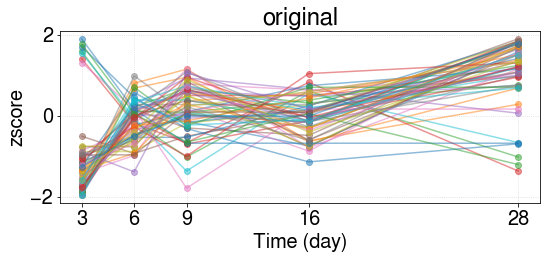

original data shape: (5, 61)
found subregulon: ['CKS2', 'PNP', 'KCNMA1', 'PLEK2', 'NF2'] 5 0.8566299941758456
found subregulon: ['KLF15', 'USP53', 'PTH1R', 'PIK3R1', 'TGFBR3', 'PTPRG', 'CALCOCO2', 'CA2'] 8 0.8210632026688548
found subregulon: ['LIFR', 'CCDC69', 'FBXO32', 'ADH1B', 'SAMHD1', 'METTL7A', 'ZBTB16', 'RAB31', 'ANGPTL1', 'RASL10B', 'ISM1', 'CACNB2', 'CBX7', 'FOXO1', 'KLF9', 'TMEM86A', 'PTPRM', 'ARHGAP6', 'MAOA', 'TIMP4', 'CHRDL1', 'ZCCHC24', 'PLPP1', 'STON1', 'TXNIP', 'STIM1', 'MFGE8', 'LAMA2', 'VIT', 'TSC22D3', 'GDF15', 'MTSS1', 'GALNT15', 'CORO6', 'G0S2', 'PIK3IP1', 'APOB', 'CNR1', 'FIBIN', 'C1orf21', 'DTNA', 'TOX2', 'NFYB'] 43 0.8389867226537364
################################## FINAL
original size: 61; new size 56; lost: 5
CKS2
PNP
KCNMA1
PLEK2
NF2
sub ['CKS2', 'PNP', 'KCNMA1', 'PLEK2', 'NF2'] 5


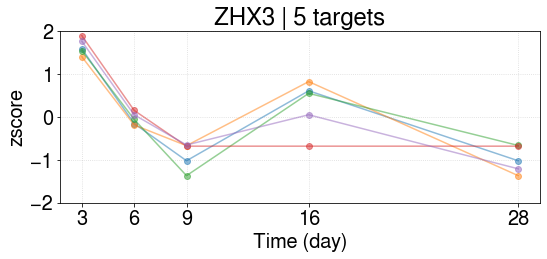

ZHX3 | 1 [ 1.63801497 -0.03966429 -0.87884779  0.26931847 -0.98882135]
KLF15
USP53
PTH1R
PIK3R1
TGFBR3
PTPRG
CALCOCO2
CA2
sub ['KLF15', 'USP53', 'PTH1R', 'PIK3R1', 'TGFBR3', 'PTPRG', 'CALCOCO2', 'CA2'] 8


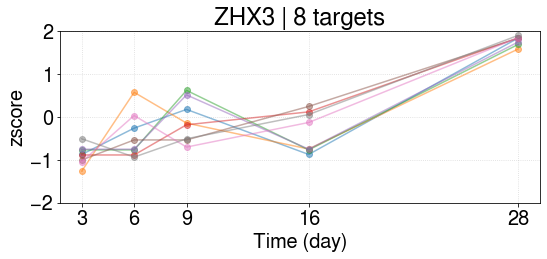

ZHX3 | 2 [-0.88741606 -0.44178941 -0.09635274 -0.35713689  1.7826951 ]
LIFR
CCDC69
FBXO32
ADH1B
SAMHD1
METTL7A
ZBTB16
RAB31
ANGPTL1
RASL10B
ISM1
CACNB2
CBX7
FOXO1
KLF9
TMEM86A
PTPRM
ARHGAP6
MAOA
TIMP4
CHRDL1
ZCCHC24
PLPP1
STON1
TXNIP
STIM1
MFGE8
LAMA2
VIT
TSC22D3
GDF15
MTSS1
GALNT15
CORO6
G0S2
PIK3IP1
APOB
CNR1
FIBIN
C1orf21
DTNA
TOX2
NFYB
sub ['LIFR', 'CCDC69', 'FBXO32', 'ADH1B', 'SAMHD1', 'METTL7A', 'ZBTB16', 'RAB31', 'ANGPTL1', 'RASL10B', 'ISM1', 'CACNB2', 'CBX7', 'FOXO1', 'KLF9', 'TMEM86A', 'PTPRM', 'ARHGAP6', 'MAOA', 'TIMP4', 'CHRDL1', 'ZCCHC24', 'PLPP1', 'STON1', 'TXNIP', 'STIM1', 'MFGE8', 'LAMA2', 'VIT', 'TSC22D3', 'GDF15', 'MTSS1', 'GALNT15', 'CORO6', 'G0S2', 'PIK3IP1', 'APOB', 'CNR1', 'FIBIN', 'C1orf21', 'DTNA', 'TOX2', 'NFYB'] 43


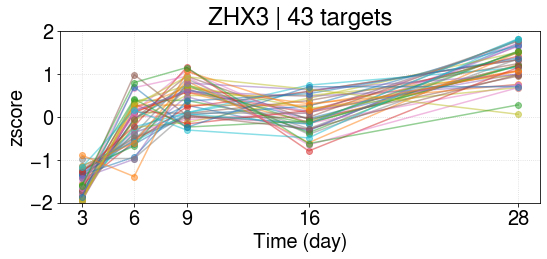

ZHX3 | 3 [-1.56345792 -0.12871675  0.42507492  0.0380113   1.22908845]
----------------------------------------------------------
regulon EBF2 84
['ANGPTL1', 'PDE1A', 'NT5E', 'FIBIN', 'ATP10A', 'PTGIS', 'GYPC', 'CTSO', 'DPT', 'SLIT3', 'SMOC1', 'NCAM2', 'SRPX', 'TPM1', 'ADAMTS5', 'PEAR1', 'VIT', 'APOD', 'ACKR1', 'EPS8', 'ARHGAP6', 'SLC7A2', 'CHRDL1', 'IGF2', 'FZD4', 'NMNAT2', 'SNCG', 'FBLN2', 'POSTN', 'PTGDS', 'PODN', 'ABI3BP', 'MMP16', 'ADAMTS12', 'AXL', 'SLIT2', 'IGFBP5', 'ENPP4', 'ECM2', 'C6', 'GAS1', 'BOC', 'ZCCHC24', 'B4GALNT1', 'CFD', 'S1PR3', 'PDGFRL', 'NES', 'MGP', 'EPAS1', 'EBF1', 'LRRC32', 'NTM', 'PMP22', 'FGF7', 'SVEP1', 'EYA2', 'DCN', 'OSR2', 'LAMA4', 'OLFML2B', 'ANGPT1', 'CADM3', 'DDR2', 'C1QTNF1', 'OSR1', 'ABCC9', 'SLC8A1', 'KCNJ8', 'CLEC3B', 'GPC6', 'C3', 'C7', 'TNNT3', 'HTRA1', 'SFRP1', 'CXCL12', 'MEDAG', 'TMEM150C', 'CSPG4', 'PLAT', 'ISM1', 'PTGFR', 'LIMS2']


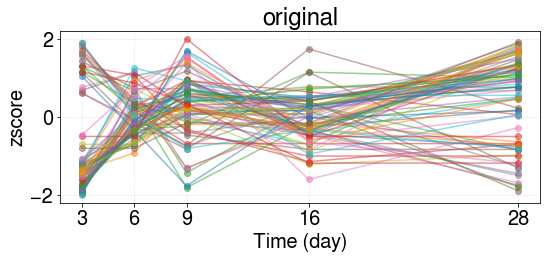

original data shape: (5, 84)
found subregulon: ['ATP10A', 'TPM1', 'POSTN', 'ABI3BP', 'MMP16', 'ADAMTS12', 'AXL', 'SLIT2', 'B4GALNT1', 'NES', 'SLC8A1', 'CSPG4', 'LIMS2'] 13 0.832883780099584
found subregulon: ['CLEC3B', 'CXCL12', 'PODN', 'LRRC32'] 4 0.8330252299122286
found subregulon: ['DCN', 'GPC6', 'HTRA1', 'SMOC1', 'FGF7', 'PTGFR', 'CFD', 'EBF1', 'DDR2', 'ECM2', 'GAS1', 'IGF2', 'ARHGAP6', 'ANGPTL1', 'PDGFRL', 'ANGPT1', 'PMP22', 'EPAS1', 'SLIT3', 'GYPC', 'ISM1', 'ZCCHC24', 'FZD4', 'C7', 'CADM3', 'SVEP1', 'VIT', 'DPT', 'TMEM150C', 'MEDAG', 'ACKR1', 'APOD', 'KCNJ8', 'SLC7A2', 'CTSO', 'FBLN2', 'ADAMTS5', 'BOC', 'C3', 'C1QTNF1', 'LAMA4', 'C6', 'MGP', 'CHRDL1', 'OLFML2B', 'PDE1A', 'PTGIS', 'EPS8', 'ABCC9', 'NCAM2', 'FIBIN', 'NT5E', 'OSR1', 'PLAT'] 54 0.8229764588516223
################################## FINAL
original size: 84; new size 71; lost: 13
ATP10A
TPM1
POSTN
ABI3BP
MMP16
ADAMTS12
AXL
SLIT2
B4GALNT1
NES
SLC8A1
CSPG4
LIMS2
sub ['ATP10A', 'TPM1', 'POSTN', 'ABI3BP', 'MMP16', 'ADAMTS1

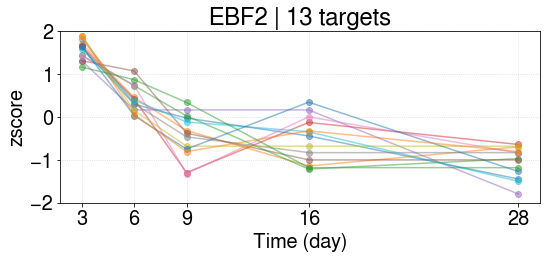

EBF2 | 1 [ 1.57071791  0.435684   -0.43355032 -0.52236797 -1.05048362]
CLEC3B
CXCL12
PODN
LRRC32
sub ['CLEC3B', 'CXCL12', 'PODN', 'LRRC32'] 4


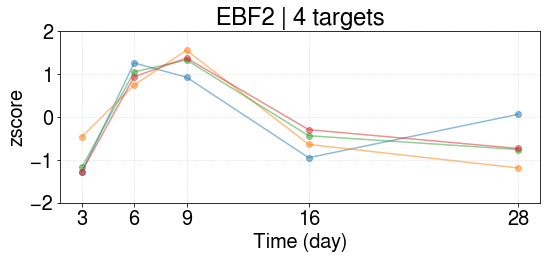

EBF2 | 2 [-1.05024815  0.99423432  1.29339984 -0.58138315 -0.65600286]
DCN
GPC6
HTRA1
SMOC1
FGF7
PTGFR
CFD
EBF1
DDR2
ECM2
GAS1
IGF2
ARHGAP6
ANGPTL1
PDGFRL
ANGPT1
PMP22
EPAS1
SLIT3
GYPC
ISM1
ZCCHC24
FZD4
C7
CADM3
SVEP1
VIT
DPT
TMEM150C
MEDAG
ACKR1
APOD
KCNJ8
SLC7A2
CTSO
FBLN2
ADAMTS5
BOC
C3
C1QTNF1
LAMA4
C6
MGP
CHRDL1
OLFML2B
PDE1A
PTGIS
EPS8
ABCC9
NCAM2
FIBIN
NT5E
OSR1
PLAT
sub ['DCN', 'GPC6', 'HTRA1', 'SMOC1', 'FGF7', 'PTGFR', 'CFD', 'EBF1', 'DDR2', 'ECM2', 'GAS1', 'IGF2', 'ARHGAP6', 'ANGPTL1', 'PDGFRL', 'ANGPT1', 'PMP22', 'EPAS1', 'SLIT3', 'GYPC', 'ISM1', 'ZCCHC24', 'FZD4', 'C7', 'CADM3', 'SVEP1', 'VIT', 'DPT', 'TMEM150C', 'MEDAG', 'ACKR1', 'APOD', 'KCNJ8', 'SLC7A2', 'CTSO', 'FBLN2', 'ADAMTS5', 'BOC', 'C3', 'C1QTNF1', 'LAMA4', 'C6', 'MGP', 'CHRDL1', 'OLFML2B', 'PDE1A', 'PTGIS', 'EPS8', 'ABCC9', 'NCAM2', 'FIBIN', 'NT5E', 'OSR1', 'PLAT'] 54


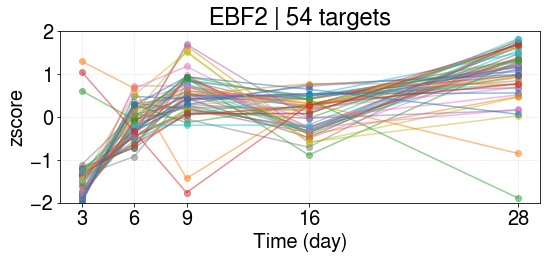

EBF2 | 3 [-1.46056235 -0.14194373  0.49494266  0.0770885   1.03047492]
----------------------------------------------------------
regulon TBX15 71
['USP53', 'ANGPTL1', 'SVEP1', 'C1S', 'CIDEC', 'PTPRM', 'SLC7A2', 'SLC2A5', 'C1R', 'PRKAR1B', 'TNFRSF19', 'ANKRD28', 'NRCAM', 'LATS2', 'CHRDL1', 'ARHGAP6', 'PPARG', 'DCN', 'SAMD11', 'PTPRG', 'THOP1', 'IGF2', 'PNP', 'TFPI', 'FIBIN', 'CPZ', 'COMP', 'CFH', 'GALNT15', 'ATP10A', 'RRM1', 'DDR2', 'C1QTNF1', 'IL3RA', 'FBLN2', 'GGT5', 'LAMA2', 'MGP', 'PODN', 'SERPING1', 'ABI3BP', 'LMCD1', 'BCL6', 'KCNT2', 'PMP22', 'C3', 'GLUL', 'CACNB2', 'AXL', 'STON1', 'VGLL4', 'DNMT1', 'EVI2A', 'SMOC1', 'FMOD', 'TIAM1', 'MTSS1', 'MEDAG', 'SRPX', 'TGFBR3', 'ISM1', 'ADAMTS5', 'VIT', 'FOXO1', 'C6', 'PLPP1', 'EPS8', 'MYL3', 'WRAP53', 'SERPINF1', 'ACER2']


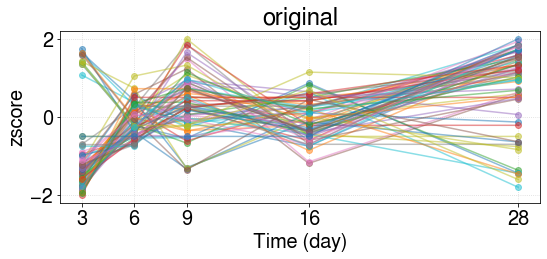

original data shape: (5, 71)
found subregulon: ['PRKAR1B', 'THOP1', 'PNP', 'ATP10A', 'ABI3BP', 'AXL', 'DNMT1', 'TIAM1', 'WRAP53'] 9 0.833194160157773
found subregulon: ['MYL3', 'TFPI', 'GLUL', 'PTPRG', 'ACER2'] 5 0.8462318964129485
found subregulon: ['C1S', 'TNFRSF19', 'PPARG', 'CFH', 'SMOC1', 'SERPING1', 'ARHGAP6', 'DDR2', 'SERPINF1', 'BCL6', 'ISM1', 'PMP22', 'CIDEC', 'SVEP1', 'IGF2', 'NRCAM', 'EVI2A', 'CACNB2', 'SLC7A2', 'ANGPTL1', 'PLPP1', 'GGT5', 'FBLN2', 'MEDAG', 'VIT', 'LMCD1', 'PTPRM', 'C1R', 'STON1', 'MTSS1', 'FMOD', 'MGP', 'LAMA2', 'FOXO1', 'ADAMTS5', 'CHRDL1', 'C3', 'GALNT15', 'LATS2', 'C6', 'C1QTNF1', 'KCNT2', 'EPS8', 'COMP', 'FIBIN', 'VGLL4', 'CPZ', 'ANKRD28'] 48 0.8373801686543118
################################## FINAL
original size: 71; new size 62; lost: 9
PRKAR1B
THOP1
PNP
ATP10A
ABI3BP
AXL
DNMT1
TIAM1
WRAP53
sub ['PRKAR1B', 'THOP1', 'PNP', 'ATP10A', 'ABI3BP', 'AXL', 'DNMT1', 'TIAM1', 'WRAP53'] 9


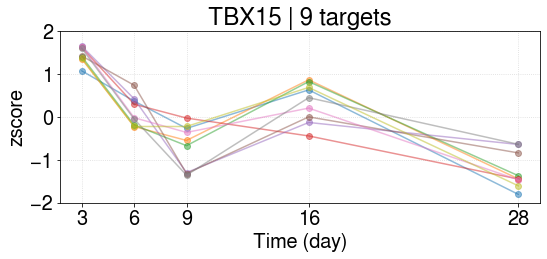

TBX15 | 1 [ 1.45710344  0.12417786 -0.67462208  0.34218316 -1.24884238]
MYL3
TFPI
GLUL
PTPRG
ACER2
sub ['MYL3', 'TFPI', 'GLUL', 'PTPRG', 'ACER2'] 5


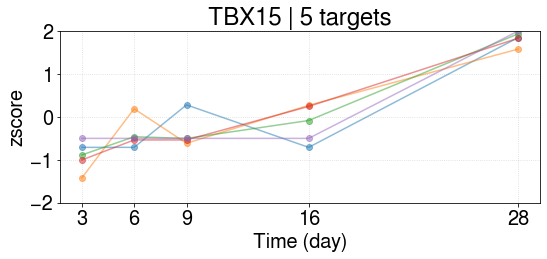

TBX15 | 2 [-0.90445196 -0.40371846 -0.37449034 -0.1557912   1.83845195]
C1S
TNFRSF19
PPARG
CFH
SMOC1
SERPING1
ARHGAP6
DDR2
SERPINF1
BCL6
ISM1
PMP22
CIDEC
SVEP1
IGF2
NRCAM
EVI2A
CACNB2
SLC7A2
ANGPTL1
PLPP1
GGT5
FBLN2
MEDAG
VIT
LMCD1
PTPRM
C1R
STON1
MTSS1
FMOD
MGP
LAMA2
FOXO1
ADAMTS5
CHRDL1
C3
GALNT15
LATS2
C6
C1QTNF1
KCNT2
EPS8
COMP
FIBIN
VGLL4
CPZ
ANKRD28
sub ['C1S', 'TNFRSF19', 'PPARG', 'CFH', 'SMOC1', 'SERPING1', 'ARHGAP6', 'DDR2', 'SERPINF1', 'BCL6', 'ISM1', 'PMP22', 'CIDEC', 'SVEP1', 'IGF2', 'NRCAM', 'EVI2A', 'CACNB2', 'SLC7A2', 'ANGPTL1', 'PLPP1', 'GGT5', 'FBLN2', 'MEDAG', 'VIT', 'LMCD1', 'PTPRM', 'C1R', 'STON1', 'MTSS1', 'FMOD', 'MGP', 'LAMA2', 'FOXO1', 'ADAMTS5', 'CHRDL1', 'C3', 'GALNT15', 'LATS2', 'C6', 'C1QTNF1', 'KCNT2', 'EPS8', 'COMP', 'FIBIN', 'VGLL4', 'CPZ', 'ANKRD28'] 48


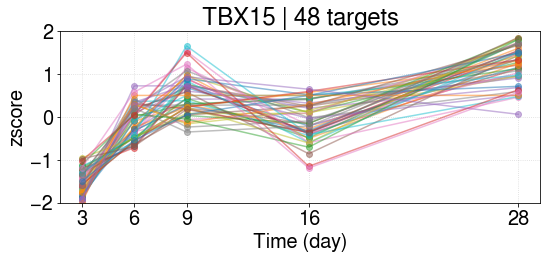

TBX15 | 3 [-1.53480869 -0.12097312  0.51934007 -0.0892787   1.22572043]
----------------------------------------------------------
regulon FOXC1 128
['PDE1A', 'C1S', 'GRASP', 'NT5E', 'RAB31', 'CDKN1A', 'FIBIN', 'ATP10A', 'MYO1D', 'STOM', 'ADGRG6', 'LAMA2', 'PTGIS', 'GYPC', 'FNDC1', 'FBLN1', 'CTSO', 'CYP1B1', 'CACNB2', 'SLIT3', 'GLIPR1', 'NCAM2', 'ALCAM', 'SRPX', 'CNN1', 'TPM1', 'PEAR1', 'POLA2', 'MFGE8', 'APOD', 'KLF11', 'ACKR1', 'AMIGO2', 'ARHGAP6', 'INSR', 'ATP8B4', 'SLC7A2', 'NDRG1', 'EFEMP1', 'FOXC2', 'CYBRD1', 'IGF2', 'CPED1', 'TSC22D1', 'SNCG', 'PCMTD1', 'FBLN2', 'GPX3', 'PRRX2', 'POSTN', 'FAXDC2', 'ARSJ', 'SERPING1', 'ABI3BP', 'LMCD1', 'PPARGC1A', 'BRINP1', 'AXL', 'KCNS3', 'SESN2', 'PCDH10', 'NBL1', 'FRZB', 'TGFBR3', 'ENPP4', 'MFAP4', 'FOXO1', 'MARC1', 'B3GALT2', 'SERPINF1', 'ENPP5', 'DOCK10', 'CFAP69', 'CFD', 'S1PR3', 'NDNF', 'DUSP4', 'LEPR', 'VCAM1', 'A2M', 'GGT5', 'CRLF1', 'NUDT4', 'MGP', 'INHBA', 'EPAS1', 'SCG2', 'EBF1', 'LRRC32', 'PROS1', 'CENPI', 'RASL11A', 'FBLN5', 'DKK2'

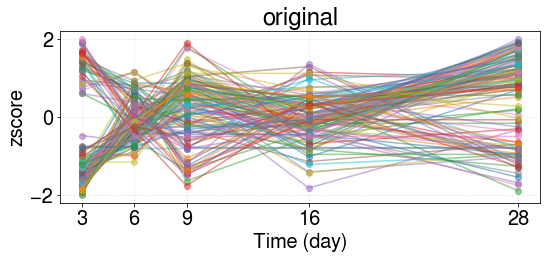

original data shape: (5, 128)
found subregulon: ['NT5E', 'ATP10A', 'ADGRG6', 'GLIPR1', 'TPM1', 'POLA2', 'POSTN', 'ARSJ', 'ABI3BP', 'AXL', 'PCDH10', 'DOCK10', 'CENPI', 'FBLN5', 'DKK2', 'PDCD1LG2', 'SYT1', 'PAK3', 'KCNMA1', 'SLC8A1', 'CSPG4', 'AUNIP'] 22 0.8264477132842831
found subregulon: ['DCN', 'PROS1', 'DDR2', 'FRZB', 'IL1R1', 'SCG2', 'SLIT3', 'NBL1', 'NUDT4', 'TSC22D1', 'CFD', 'RAB31', 'GPC6', 'GGT5', 'SLC7A2', 'ATP8B4', 'STOM', 'EBF1', 'C1S', 'NDRG1', 'SERPING1', 'FOXO1', 'EFEMP1', 'C1QTNF1', 'ARHGAP6', 'SERPINF1', 'CACNB2', 'MFAP4', 'LAMA2', 'IGF2', 'CYBRD1', 'SVEP1', 'PDE1A', 'CFH', 'ACKR1', 'FBLN2', 'GPX3', 'MEDAG', 'MGP', 'EPAS1', 'NCAM2', 'FBLN1', 'C7', 'KLF11', 'NEDD9', 'NDNF', 'HMCN1', 'GYPC', 'ENPP5', 'CRLF1', 'GALNT15', 'APOD', 'PPARGC1A', 'FMOD', 'MYO1D', 'CFAP69', 'MARC1', 'A2M', 'CDKN1A', 'DUSP4', 'CTSO', 'ANTXR1', 'SESN2', 'MFGE8', 'ENPP4', 'PCMTD1', 'VCAM1', 'C1R', 'TFPI', 'LMCD1', 'SRPX', 'EVI2B', 'MYLK', 'LAMA4', 'IL1RL1', 'PRRX2', 'EYA2', 'FIBIN', 'SNCG', 'RASL11A

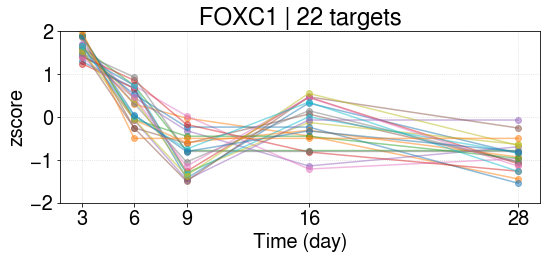

FOXC1 | 1 [ 1.60862835  0.29961717 -0.81345304 -0.20134187 -0.89345062]
DCN
PROS1
DDR2
FRZB
IL1R1
SCG2
SLIT3
NBL1
NUDT4
TSC22D1
CFD
RAB31
GPC6
GGT5
SLC7A2
ATP8B4
STOM
EBF1
C1S
NDRG1
SERPING1
FOXO1
EFEMP1
C1QTNF1
ARHGAP6
SERPINF1
CACNB2
MFAP4
LAMA2
IGF2
CYBRD1
SVEP1
PDE1A
CFH
ACKR1
FBLN2
GPX3
MEDAG
MGP
EPAS1
NCAM2
FBLN1
C7
KLF11
NEDD9
NDNF
HMCN1
GYPC
ENPP5
CRLF1
GALNT15
APOD
PPARGC1A
FMOD
MYO1D
CFAP69
MARC1
A2M
CDKN1A
DUSP4
CTSO
ANTXR1
SESN2
MFGE8
ENPP4
PCMTD1
VCAM1
C1R
TFPI
LMCD1
SRPX
EVI2B
MYLK
LAMA4
IL1RL1
PRRX2
EYA2
FIBIN
SNCG
RASL11A
PEAR1
sub ['DCN', 'PROS1', 'DDR2', 'FRZB', 'IL1R1', 'SCG2', 'SLIT3', 'NBL1', 'NUDT4', 'TSC22D1', 'CFD', 'RAB31', 'GPC6', 'GGT5', 'SLC7A2', 'ATP8B4', 'STOM', 'EBF1', 'C1S', 'NDRG1', 'SERPING1', 'FOXO1', 'EFEMP1', 'C1QTNF1', 'ARHGAP6', 'SERPINF1', 'CACNB2', 'MFAP4', 'LAMA2', 'IGF2', 'CYBRD1', 'SVEP1', 'PDE1A', 'CFH', 'ACKR1', 'FBLN2', 'GPX3', 'MEDAG', 'MGP', 'EPAS1', 'NCAM2', 'FBLN1', 'C7', 'KLF11', 'NEDD9', 'NDNF', 'HMCN1', 'GYPC', 'ENPP5', 'CRLF1', 'GA

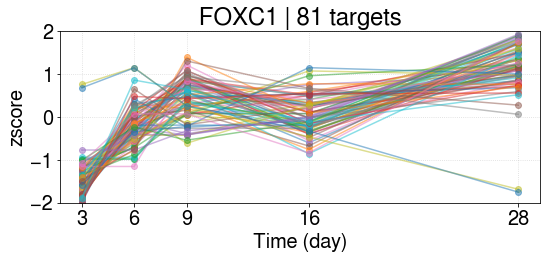

FOXC1 | 2 [-1.4777571  -0.20131209  0.44008865  0.05581004  1.1831705 ]
----------------------------------------------------------
regulon SOX17 81
['LPCAT4', 'CPT1C', 'GRASP', 'THOP1', 'FIBIN', 'PELI1', 'STOM', 'KIF2C', 'GYPC', 'IFITM1', 'TOX', 'PKIG', 'SRPX', 'BTBD3', 'ACKR1', 'EPS8', 'PSG5', 'PSG4', 'CARD10', 'DUSP5', 'ANKRD28', 'CHRDL1', 'ADAM19', 'PALM', 'IGF2', 'SYNJ2', 'CH25H', 'CPED1', 'NMNAT2', 'IL3RA', 'AKR1C3', 'POSTN', 'HLA-F', 'TNFRSF1B', 'RGCC', 'PXN', 'ERCC6', 'HBEGF', 'AHNAK2', 'CDC45', 'UGP2', 'SPRY1', 'CSMD2', 'FIGNL1', 'KIF23', 'GINS2', 'GNB3', 'CEBPD', 'MMP13', 'SLC12A8', 'A2M', 'GGT5', 'NES', 'RASD1', 'EPAS1', 'KCNT2', 'LYPD6', 'APOL3', 'LRRC32', 'DNMT1', 'NREP', 'PMP22', 'PDCD1LG2', 'IL6', 'SH3BP1', 'CADM3', 'C1QTNF1', 'CENPO', 'NEDD9', 'KIF20B', 'CYGB', 'PTK2B', 'CXCL12', 'DUSP10', 'STMN1', 'PLAT', 'SULF2', 'LIMS2', 'OLFML3', 'INHBB', 'FEN1']


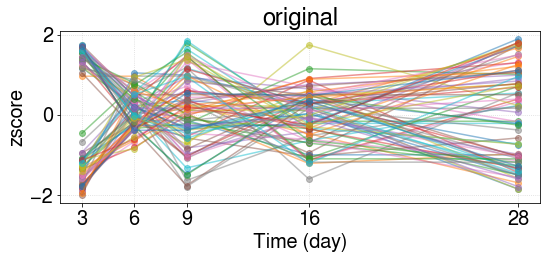

original data shape: (5, 81)
found subregulon: ['LPCAT4', 'CPT1C', 'THOP1', 'KIF2C', 'TOX', 'CARD10', 'ADAM19', 'SYNJ2', 'POSTN', 'PXN', 'ERCC6', 'AHNAK2', 'CDC45', 'CSMD2', 'FIGNL1', 'KIF23', 'GINS2', 'GNB3', 'NES', 'LYPD6', 'DNMT1', 'NREP', 'IL6', 'SH3BP1', 'CENPO', 'KIF20B', 'STMN1', 'LIMS2', 'FEN1'] 29 0.8256271490702771
found subregulon: ['GYPC', 'EPAS1', 'IGF2', 'CYGB', 'RASD1', 'IFITM1', 'PKIG', 'GGT5', 'PMP22', 'CADM3', 'ACKR1', 'SULF2', 'STOM', 'OLFML3', 'CEBPD', 'KCNT2', 'PTK2B', 'FIBIN', 'HLA-F', 'C1QTNF1', 'INHBB', 'SPRY1', 'GRASP'] 23 0.8357086184881929
################################## FINAL
original size: 81; new size 52; lost: 29
LPCAT4
CPT1C
THOP1
KIF2C
TOX
CARD10
ADAM19
SYNJ2
POSTN
PXN
ERCC6
AHNAK2
CDC45
CSMD2
FIGNL1
KIF23
GINS2
GNB3
NES
LYPD6
DNMT1
NREP
IL6
SH3BP1
CENPO
KIF20B
STMN1
LIMS2
FEN1
sub ['LPCAT4', 'CPT1C', 'THOP1', 'KIF2C', 'TOX', 'CARD10', 'ADAM19', 'SYNJ2', 'POSTN', 'PXN', 'ERCC6', 'AHNAK2', 'CDC45', 'CSMD2', 'FIGNL1', 'KIF23', 'GINS2', 'GNB3', 'NES', '

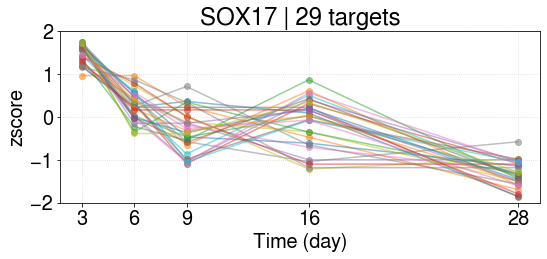

SOX17 | 1 [ 1.49138023  0.28111884 -0.30670577 -0.13797342 -1.32781988]
GYPC
EPAS1
IGF2
CYGB
RASD1
IFITM1
PKIG
GGT5
PMP22
CADM3
ACKR1
SULF2
STOM
OLFML3
CEBPD
KCNT2
PTK2B
FIBIN
HLA-F
C1QTNF1
INHBB
SPRY1
GRASP
sub ['GYPC', 'EPAS1', 'IGF2', 'CYGB', 'RASD1', 'IFITM1', 'PKIG', 'GGT5', 'PMP22', 'CADM3', 'ACKR1', 'SULF2', 'STOM', 'OLFML3', 'CEBPD', 'KCNT2', 'PTK2B', 'FIBIN', 'HLA-F', 'C1QTNF1', 'INHBB', 'SPRY1', 'GRASP'] 23


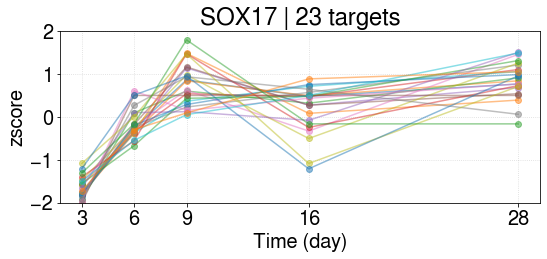

SOX17 | 2 [-1.65627102 -0.14516169  0.74223227  0.18514204  0.87405841]
----------------------------------------------------------
regulon SP5 10
['PIK3IP1', 'PPL', 'ORAI3', 'GJA1', 'GPER1', 'ABCA9', 'WDR86', 'FBLN1', 'FIBIN', 'RSPO1']


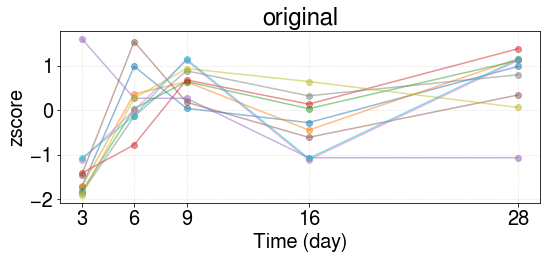

original data shape: (5, 10)
found subregulon: ['PPL', 'FBLN1', 'PIK3IP1', 'GJA1', 'WDR86'] 5 0.8598467168532017
################################## FINAL
original size: 10; new size 5; lost: 5
PPL
FBLN1
PIK3IP1
GJA1
WDR86
sub ['PPL', 'FBLN1', 'PIK3IP1', 'GJA1', 'WDR86'] 5


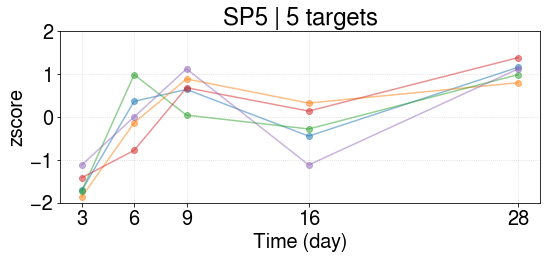

SP5 | 1 [-1.56644641  0.08527394  0.67235641 -0.27788856  1.08670462]
----------------------------------------------------------
regulon ZFHX4 59
['ZCCHC24', 'C1S', 'GLI2', 'ST3GAL5', 'NT5E', 'CHRDL1', 'DCN', 'LAMA4', 'ANGPT1', 'PDGFRL', 'PALM', 'IGF2', 'FIBIN', 'CPED1', 'ANGPTL2', 'DDR2', 'OSR1', 'FBLN2', 'ABCC9', 'ELN', 'SLC8A1', 'MAP3K12', 'OTOGL', 'OLFML2A', 'PTGIS', 'FNDC1', 'FBLN1', 'PODN', 'ANTXR2', 'SGCD', 'HMCN1', 'GPC6', 'EBF1', 'FAM180A', 'DPT', 'MAN1C1', 'SLIT3', 'HTRA1', 'DCBLD2', 'SLIT2', 'ABCA9', 'IGFBP5', 'AHNAK2', 'CNN1', 'TPM1', 'MFAP4', 'MYLK', 'ECM2', 'COL11A1', 'GFRA1', 'LIMS2', 'FBLN5', 'COL21A1', 'OLFML3', 'PCDH18', 'GAS1', 'LATS2', 'BOC', 'SSPN']


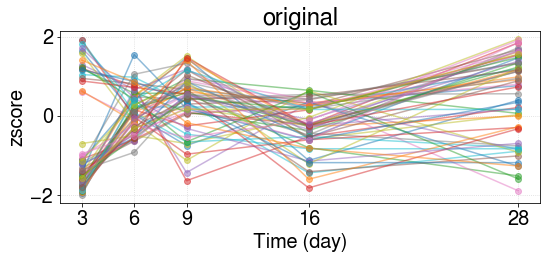

original data shape: (5, 59)
found subregulon: ['GLI2', 'ELN', 'FNDC1', 'SGCD', 'FAM180A', 'SLIT2', 'TPM1', 'LIMS2', 'FBLN5'] 9 0.8217159663882738
found subregulon: ['DCBLD2', 'NT5E', 'AHNAK2', 'SLC8A1'] 4 0.8378418011826874
found subregulon: ['DCN', 'C1S', 'GPC6', 'HTRA1', 'EBF1', 'ECM2', 'ANGPTL2', 'GAS1', 'MFAP4', 'DDR2', 'IGF2', 'COL21A1', 'PDGFRL', 'FBLN1', 'ANGPT1', 'SSPN', 'ZCCHC24', 'MAN1C1', 'SLIT3', 'HMCN1', 'DPT', 'OTOGL', 'OLFML3', 'LAMA4', 'BOC', 'FBLN2', 'GFRA1', 'OLFML2A', 'PTGIS', 'CHRDL1', 'FIBIN', 'COL11A1', 'ST3GAL5'] 33 0.8630137262190327
################################## FINAL
original size: 59; new size 46; lost: 13
GLI2
ELN
FNDC1
SGCD
FAM180A
SLIT2
TPM1
LIMS2
FBLN5
sub ['GLI2', 'ELN', 'FNDC1', 'SGCD', 'FAM180A', 'SLIT2', 'TPM1', 'LIMS2', 'FBLN5'] 9


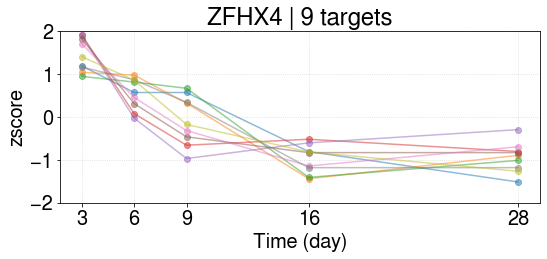

ZFHX4 | 1 [ 1.45114784  0.54244115 -0.0767244  -0.97271555 -0.94414904]
DCBLD2
NT5E
AHNAK2
SLC8A1
sub ['DCBLD2', 'NT5E', 'AHNAK2', 'SLC8A1'] 4


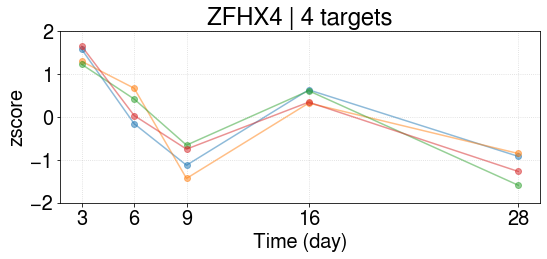

ZFHX4 | 2 [ 1.433226    0.23957466 -0.99128642  0.47592173 -1.15743596]
DCN
C1S
GPC6
HTRA1
EBF1
ECM2
ANGPTL2
GAS1
MFAP4
DDR2
IGF2
COL21A1
PDGFRL
FBLN1
ANGPT1
SSPN
ZCCHC24
MAN1C1
SLIT3
HMCN1
DPT
OTOGL
OLFML3
LAMA4
BOC
FBLN2
GFRA1
OLFML2A
PTGIS
CHRDL1
FIBIN
COL11A1
ST3GAL5
sub ['DCN', 'C1S', 'GPC6', 'HTRA1', 'EBF1', 'ECM2', 'ANGPTL2', 'GAS1', 'MFAP4', 'DDR2', 'IGF2', 'COL21A1', 'PDGFRL', 'FBLN1', 'ANGPT1', 'SSPN', 'ZCCHC24', 'MAN1C1', 'SLIT3', 'HMCN1', 'DPT', 'OTOGL', 'OLFML3', 'LAMA4', 'BOC', 'FBLN2', 'GFRA1', 'OLFML2A', 'PTGIS', 'CHRDL1', 'FIBIN', 'COL11A1', 'ST3GAL5'] 33


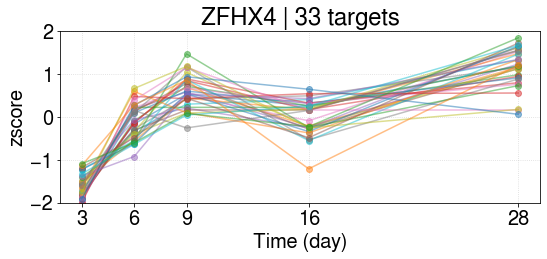

ZFHX4 | 3 [-1.61428826 -0.1130482   0.5805692  -0.00344842  1.15021568]
----------------------------------------------------------
regulon OSR2 95
['ANGPTL1', 'C1S', 'CIDEC', 'GRASP', 'FIBIN', 'ELN', 'LAMA2', 'PTGIS', 'FBLN1', 'THBS2', 'CRISPLD2', 'LOXL4', 'DPT', 'CALM1', 'SMOC1', 'PLTP', 'LSAMP', 'SRPX', 'PIM1', 'PSRC1', 'ADAMTS5', 'MFGE8', 'VIT', 'APOD', 'EFEMP1', 'CLDN11', 'PALM', 'CYBRD1', 'FZD4', 'FBLN2', 'GPX3', 'LRP8', 'ADH1B', 'RUNX2', 'FBLN7', 'PTGDS', 'PTGES', 'SERPING1', 'PODN', 'ABI3BP', 'VMO1', 'CORO6', 'FAM180A', 'AXL', 'IGFBP5', 'NBL1', 'B4GALNT4', 'MFAP4', 'GAS1', 'BOC', 'SERPINF1', 'CFD', 'PDGFRL', 'COMP', 'GGT5', 'CRLF1', 'NUDT4', 'MGP', 'RASD1', 'GPR17', 'SNED1', 'EBF1', 'FNDC10', 'TSC22D3', 'PDGFD', 'TMEM59L', 'FBLN5', 'PMP22', 'PODNL1', 'SVEP1', 'EYA2', 'PPARG', 'DCN', 'ADAMTS10', 'ANGPT1', 'APOB', 'ITGA3', 'CADM3', 'PTH1R', 'DDR2', 'OSR1', 'MAP3K12', 'IFI30', 'C7', 'HTRA1', 'SFRP1', 'ABCA9', 'C11orf95', 'MEDAG', 'PID1', 'CSPG4', 'ISM1', 'PPL', 'OLFML3', 'GALNT15']

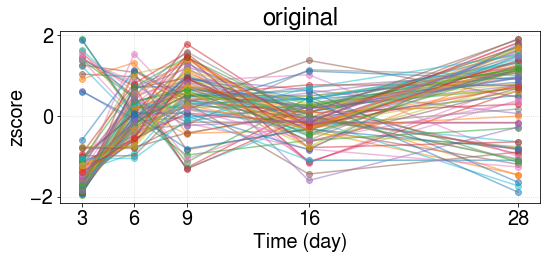

original data shape: (5, 95)
found subregulon: ['LOXL4', 'CALM1', 'CLDN11', 'LRP8', 'ABI3BP', 'FAM180A', 'AXL', 'GPR17', 'FNDC10', 'FBLN5', 'ITGA3', 'CSPG4'] 12 0.8314952405283799
found subregulon: ['GRASP', 'PALM', 'C11orf95', 'PODN', 'ADAMTS10', 'IFI30'] 6 0.8504186074135828
found subregulon: ['DCN', 'THBS2', 'SMOC1', 'ADH1B', 'PPARG', 'DDR2', 'C1S', 'SERPING1', 'CFD', 'GAS1', 'EBF1', 'NBL1', 'HTRA1', 'CIDEC', 'EFEMP1', 'SERPINF1', 'NUDT4', 'ANGPT1', 'ANGPTL1', 'PDGFRL', 'GGT5', 'MFAP4', 'CRISPLD2', 'FZD4', 'FBLN1', 'ISM1', 'GPX3', 'PMP22', 'CYBRD1', 'CADM3', 'SVEP1', 'DPT', 'PPL', 'BOC', 'C7', 'APOD', 'MGP', 'MEDAG', 'MFGE8', 'RASD1', 'LAMA2', 'VIT', 'FBLN2', 'FBLN7', 'TSC22D3', 'GALNT15', 'VMO1', 'PODNL1', 'CRLF1', 'ADAMTS5', 'SRPX', 'CORO6', 'PIM1', 'PID1', 'EYA2', 'FIBIN', 'SFRP1', 'PLTP', 'APOB', 'TMEM59L', 'RUNX2', 'OLFML3', 'PTH1R', 'PTGIS'] 64 0.8368761669448778
################################## FINAL
original size: 95; new size 82; lost: 13
LOXL4
CALM1
CLDN11
LRP8
ABI3BP
FA

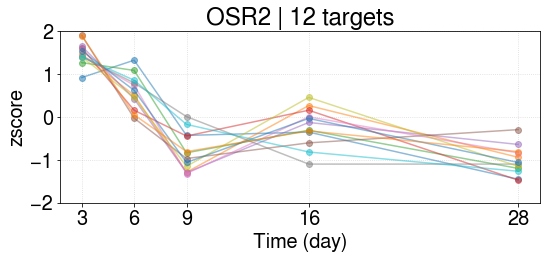

OSR2 | 1 [ 1.48692429  0.57952782 -0.81444462 -0.23346819 -1.0185393 ]
GRASP
PALM
C11orf95
PODN
ADAMTS10
IFI30
sub ['GRASP', 'PALM', 'C11orf95', 'PODN', 'ADAMTS10', 'IFI30'] 6


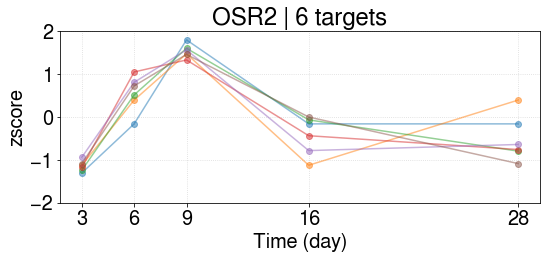

OSR2 | 2 [-1.14624441  0.55233376  1.5336756  -0.43047883 -0.50928611]
DCN
THBS2
SMOC1
ADH1B
PPARG
DDR2
C1S
SERPING1
CFD
GAS1
EBF1
NBL1
HTRA1
CIDEC
EFEMP1
SERPINF1
NUDT4
ANGPT1
ANGPTL1
PDGFRL
GGT5
MFAP4
CRISPLD2
FZD4
FBLN1
ISM1
GPX3
PMP22
CYBRD1
CADM3
SVEP1
DPT
PPL
BOC
C7
APOD
MGP
MEDAG
MFGE8
RASD1
LAMA2
VIT
FBLN2
FBLN7
TSC22D3
GALNT15
VMO1
PODNL1
CRLF1
ADAMTS5
SRPX
CORO6
PIM1
PID1
EYA2
FIBIN
SFRP1
PLTP
APOB
TMEM59L
RUNX2
OLFML3
PTH1R
PTGIS
sub ['DCN', 'THBS2', 'SMOC1', 'ADH1B', 'PPARG', 'DDR2', 'C1S', 'SERPING1', 'CFD', 'GAS1', 'EBF1', 'NBL1', 'HTRA1', 'CIDEC', 'EFEMP1', 'SERPINF1', 'NUDT4', 'ANGPT1', 'ANGPTL1', 'PDGFRL', 'GGT5', 'MFAP4', 'CRISPLD2', 'FZD4', 'FBLN1', 'ISM1', 'GPX3', 'PMP22', 'CYBRD1', 'CADM3', 'SVEP1', 'DPT', 'PPL', 'BOC', 'C7', 'APOD', 'MGP', 'MEDAG', 'MFGE8', 'RASD1', 'LAMA2', 'VIT', 'FBLN2', 'FBLN7', 'TSC22D3', 'GALNT15', 'VMO1', 'PODNL1', 'CRLF1', 'ADAMTS5', 'SRPX', 'CORO6', 'PIM1', 'PID1', 'EYA2', 'FIBIN', 'SFRP1', 'PLTP', 'APOB', 'TMEM59L', 'RUNX2', 'OLFML3', 'P

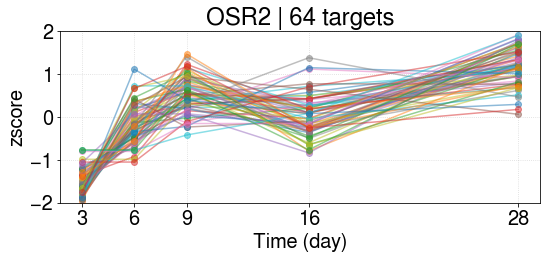

OSR2 | 3 [-1.56220856 -0.18410435  0.54141137  0.03111459  1.17378695]
----------------------------------------------------------
regulon BNC2 112
['ANGPTL1', 'PDE1A', 'CPT1C', 'C1S', 'GLI2', 'NT5E', 'RNF144A', 'FIBIN', 'ANGPTL2', 'SPON1', 'PTGIS', 'FNDC1', 'FBLN1', 'THBS2', 'CYP1B1', 'CACNB2', 'LOXL4', 'ADAMTS6', 'MAN1C1', 'SLIT3', 'STON1', 'GLIPR1', 'TOX', 'NCAM2', 'LSAMP', 'CNN1', 'TPM1', 'CCDC69', 'MEST', 'GFRA1', 'ARHGAP6', 'EFEMP1', 'CHRDL1', 'PNMA2', 'ADAM19', 'CYBRD1', 'CPED1', 'FBLN2', 'CAP2', 'PTGDS', 'KIAA1755', 'PODN', 'SERPING1', 'ABI3BP', 'MMP16', 'CNTNAP1', 'SGCD', 'ADAMTS12', 'FAM180A', 'AXL', 'SLC9A9', 'SLIT2', 'PCDH10', 'AHNAK2', 'PDGFRA', 'ECM2', 'GAS1', 'BOC', 'SERPINF1', 'ZCCHC24', 'CHRDL2', 'PLXDC2', 'PDGFRL', 'TUBA1A', 'MGP', 'GPNMB', 'EBF1', 'EPHB2', 'DCBLD2', 'PROS1', 'DDIT4L', 'COL21A1', 'LUM', 'PMP22', 'NFYB', 'SVEP1', 'C1R', 'EYA2', 'ANTXR1', 'UCHL1', 'DCN', 'OSR2', 'LAMA4', 'OLFML2B', 'ANGPT1', 'DAPK1', 'CADM3', 'GYG2', 'PAK3', 'FZD1', 'DDR2', 'KCNMA1', 'OS

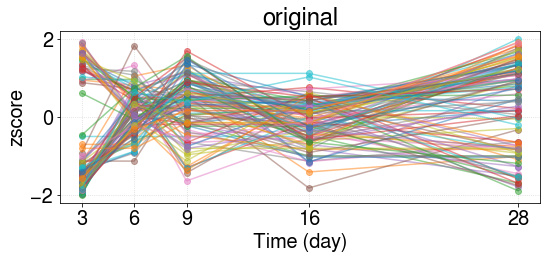

original data shape: (5, 112)
found subregulon: ['CPT1C', 'NT5E', 'LOXL4', 'ADAMTS6', 'GLIPR1', 'TOX', 'TPM1', 'ADAM19', 'CAP2', 'KIAA1755', 'ABI3BP', 'MMP16', 'CNTNAP1', 'SGCD', 'ADAMTS12', 'AXL', 'SLIT2', 'PCDH10', 'AHNAK2', 'TUBA1A', 'EPHB2', 'UCHL1', 'PAK3', 'SLC8A1', 'CSPG4'] 25 0.8232909241346853
found subregulon: ['PTGDS', 'DCN', 'GPC6', 'CCDC69', 'SERPING1', 'HTRA1', 'PROS1', 'C1S', 'PDGFRA', 'RNF144A', 'SERPINF1', 'ECM2', 'THBS2', 'EBF1', 'EFEMP1', 'PTGFR', 'FBLN1', 'ANGPTL1', 'GAS1', 'ANGPTL2', 'PDGFRL', 'ZCCHC24', 'DDR2', 'ARHGAP6', 'CACNB2', 'PMP22', 'GYG2', 'COL21A1', 'FMOD', 'PLXDC2', 'C1R', 'LUM', 'SSPN', 'SLC9A9', 'MAN1C1', 'ANGPT1', 'CADM3', 'ASPN', 'CYBRD1', 'SVEP1', 'C7', 'LAMA4', 'SLIT3', 'SULF2', 'MGP', 'OLFML3', 'GFRA1', 'BOC', 'STON1', 'C3', 'TENM2', 'FIBIN', 'FBLN2', 'PNMA2', 'GPNMB', 'PTGIS', 'CHRDL1', 'DDIT4L', 'ANTXR1', 'MEST', 'PDE1A', 'NFYB', 'NCAM2', 'OLFML2B', 'CFI', 'GLI2', 'SFRP1', 'CYP1B1', 'ABCC9', 'OSR1'] 70 0.8207310132522371
#######################

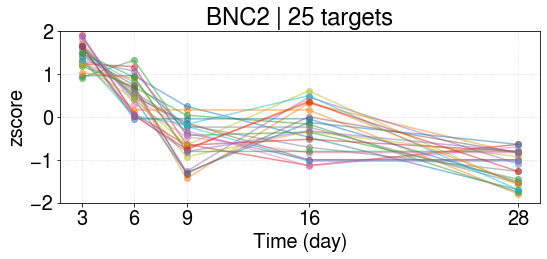

BNC2 | 1 [ 1.44627809  0.55515245 -0.53889716 -0.29886617 -1.16366721]
PTGDS
DCN
GPC6
CCDC69
SERPING1
HTRA1
PROS1
C1S
PDGFRA
RNF144A
SERPINF1
ECM2
THBS2
EBF1
EFEMP1
PTGFR
FBLN1
ANGPTL1
GAS1
ANGPTL2
PDGFRL
ZCCHC24
DDR2
ARHGAP6
CACNB2
PMP22
GYG2
COL21A1
FMOD
PLXDC2
C1R
LUM
SSPN
SLC9A9
MAN1C1
ANGPT1
CADM3
ASPN
CYBRD1
SVEP1
C7
LAMA4
SLIT3
SULF2
MGP
OLFML3
GFRA1
BOC
STON1
C3
TENM2
FIBIN
FBLN2
PNMA2
GPNMB
PTGIS
CHRDL1
DDIT4L
ANTXR1
MEST
PDE1A
NFYB
NCAM2
OLFML2B
CFI
GLI2
SFRP1
CYP1B1
ABCC9
OSR1
sub ['PTGDS', 'DCN', 'GPC6', 'CCDC69', 'SERPING1', 'HTRA1', 'PROS1', 'C1S', 'PDGFRA', 'RNF144A', 'SERPINF1', 'ECM2', 'THBS2', 'EBF1', 'EFEMP1', 'PTGFR', 'FBLN1', 'ANGPTL1', 'GAS1', 'ANGPTL2', 'PDGFRL', 'ZCCHC24', 'DDR2', 'ARHGAP6', 'CACNB2', 'PMP22', 'GYG2', 'COL21A1', 'FMOD', 'PLXDC2', 'C1R', 'LUM', 'SSPN', 'SLC9A9', 'MAN1C1', 'ANGPT1', 'CADM3', 'ASPN', 'CYBRD1', 'SVEP1', 'C7', 'LAMA4', 'SLIT3', 'SULF2', 'MGP', 'OLFML3', 'GFRA1', 'BOC', 'STON1', 'C3', 'TENM2', 'FIBIN', 'FBLN2', 'PNMA2', 'GPNMB', 'PTGI

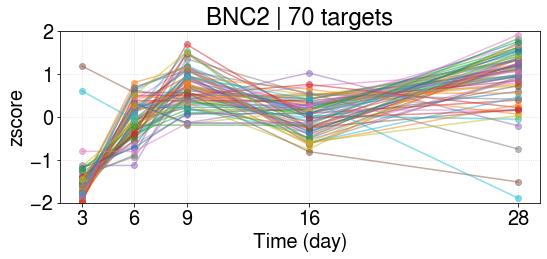

BNC2 | 2 [-1.55920841 -0.05902236  0.65216743  0.02993919  0.93612415]
----------------------------------------------------------
regulon E2F1 54
['BRCA1', 'DDIT4', 'KIF23', 'UHRF1', 'DGKI', 'TK1', 'CDCA7', 'MAP2K6', 'EYA2', 'TOP2A', 'PPARG', 'PDK4', 'MCM5', 'FANCA', 'DUSP4', 'MCM10', 'RRM2', 'H19', 'CDKN1A', 'CDC25A', 'PLK4', 'RRM1', 'OSR1', 'RACGAP1', 'KIF2C', 'MYBL2', 'FBXO5', 'DAPK2', 'CDC6', 'CDT1', 'ACSL1', 'DBF4', 'ECT2', 'PLK1', 'CDK1', 'HSPA5', 'FOXM1', 'PRIM2', 'MT1X', 'DNMT1', 'DTL', 'CDKN1C', 'MCM8', 'RAD51', 'CDC45', 'TYMS', 'ABCA1', 'POLA2', 'HMGA1', 'ASF1B', 'MAP3K5', 'HELLS', 'BIRC5', 'AURKA']


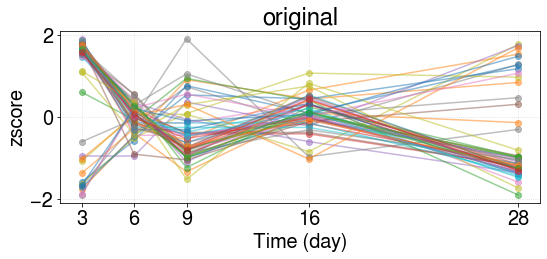

original data shape: (5, 54)
found subregulon: ['BRCA1', 'DDIT4', 'KIF23', 'UHRF1', 'DGKI', 'TK1', 'CDCA7', 'EYA2', 'TOP2A', 'PPARG', 'PDK4', 'MCM5', 'FANCA', 'DUSP4', 'MCM10', 'RRM2', 'H19', 'CDKN1A', 'CDC25A', 'PLK4', 'RRM1', 'OSR1', 'RACGAP1', 'KIF2C', 'MYBL2', 'FBXO5', 'DAPK2', 'CDC6', 'CDT1', 'ACSL1', 'DBF4', 'ECT2', 'PLK1', 'CDK1', 'HSPA5', 'FOXM1', 'PRIM2', 'MT1X', 'DNMT1', 'DTL', 'CDKN1C', 'MCM8', 'RAD51', 'CDC45', 'TYMS', 'ABCA1', 'POLA2', 'HMGA1', 'ASF1B', 'MAP3K5', 'HELLS', 'BIRC5', 'AURKA'] 53 0.8646680684959688
################################## FINAL
original size: 54; new size 53; lost: 1
BRCA1
DDIT4
KIF23
UHRF1
DGKI
TK1
CDCA7
EYA2
TOP2A
PPARG
PDK4
MCM5
FANCA
DUSP4
MCM10
RRM2
H19
CDKN1A
CDC25A
PLK4
RRM1
OSR1
RACGAP1
KIF2C
MYBL2
FBXO5
DAPK2
CDC6
CDT1
ACSL1
DBF4
ECT2
PLK1
CDK1
HSPA5
FOXM1
PRIM2
MT1X
DNMT1
DTL
CDKN1C
MCM8
RAD51
CDC45
TYMS
ABCA1
POLA2
HMGA1
ASF1B
MAP3K5
HELLS
BIRC5
AURKA
sub ['BRCA1', 'DDIT4', 'KIF23', 'UHRF1', 'DGKI', 'TK1', 'CDCA7', 'EYA2', 'TOP2A', 'PPARG

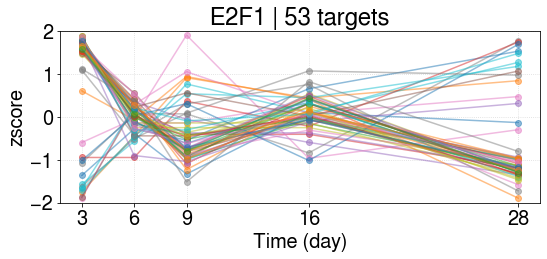

E2F1 | 1 [ 0.9408438  -0.00781353 -0.39486933  0.09860354 -0.63676448]
----------------------------------------------------------
regulon ZNF92 39
['GLI2', 'PTPRM', 'EYA2', 'TLE2', 'PLXDC2', 'PALM', 'RAC2', 'LINC00598', 'ABCA13', 'KCNMA1', 'FBLN2', 'MBNL2', 'ELN', 'SLC8A1', 'ADORA1', 'PTGIS', 'KIAA1755', 'FBLN1', 'CEBPB', 'NFATC2', 'TGFBI', 'PAPPA', 'CACNB2', 'TENM2', 'AXL', 'MAN1C1', 'SLIT3', 'EPHB2', 'GDF15', 'DUSP10', 'TIAM1', 'ALCAM', 'ZNF469', 'DPP9', 'DNAJC6', 'CCDC85C', 'TOX2', 'SMAD6', 'SYT1']


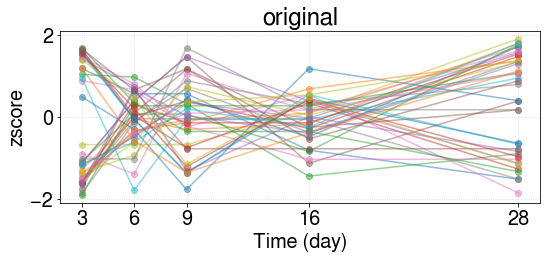

original data shape: (5, 39)
found subregulon: ['RAC2', 'KCNMA1', 'SLC8A1', 'AXL', 'EPHB2', 'TIAM1', 'ZNF469', 'DPP9', 'CCDC85C', 'SYT1'] 10 0.8435220729726096
found subregulon: ['TLE2', 'SLIT3', 'LINC00598', 'PTPRM', 'CEBPB', 'CACNB2', 'DUSP10', 'FBLN1', 'TENM2', 'GLI2', 'MAN1C1', 'PAPPA'] 12 0.8858705794162332
################################## FINAL
original size: 39; new size 22; lost: 17
RAC2
KCNMA1
SLC8A1
AXL
EPHB2
TIAM1
ZNF469
DPP9
CCDC85C
SYT1
sub ['RAC2', 'KCNMA1', 'SLC8A1', 'AXL', 'EPHB2', 'TIAM1', 'ZNF469', 'DPP9', 'CCDC85C', 'SYT1'] 10


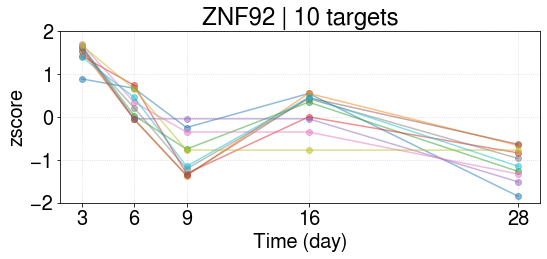

ZNF92 | 1 [ 1.50275832  0.29462532 -0.85721686  0.15912028 -1.09928707]
TLE2
SLIT3
LINC00598
PTPRM
CEBPB
CACNB2
DUSP10
FBLN1
TENM2
GLI2
MAN1C1
PAPPA
sub ['TLE2', 'SLIT3', 'LINC00598', 'PTPRM', 'CEBPB', 'CACNB2', 'DUSP10', 'FBLN1', 'TENM2', 'GLI2', 'MAN1C1', 'PAPPA'] 12


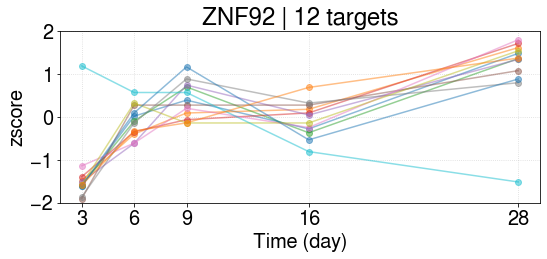

ZNF92 | 2 [-1.33896052 -0.10518363  0.38886251 -0.06513679  1.12041842]
----------------------------------------------------------
regulon MKX 32
['PDE1A', 'FGF7', 'RAB31', 'ANTXR1', 'CHRDL1', 'LCA5', 'ANGPT1', 'CREG1', 'CYBRD1', 'COMP', 'CPED1', 'DDR2', 'KCNMA1', 'MYO1D', 'MBNL2', 'NUDT4', 'CD302', 'ACSS3', 'MGP', 'CAP2', 'PTGIS', 'INHBA', 'FBLN1', 'ASPN', 'CACNB2', 'GLIPR1', 'FMOD', 'RSPO1', 'DNAJC6', 'MYLK', 'ECM2', 'AMIGO2']


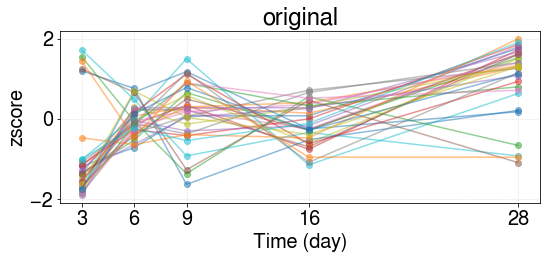

original data shape: (5, 32)
found subregulon: ['ACSS3', 'MYO1D', 'MYLK', 'INHBA'] 4 0.8221434482047183
found subregulon: ['ANGPT1', 'NUDT4', 'CD302', 'DDR2', 'CYBRD1', 'RAB31', 'MGP', 'ECM2', 'MBNL2', 'CACNB2', 'LCA5', 'CHRDL1', 'ANTXR1', 'CREG1', 'DNAJC6', 'PDE1A', 'FBLN1', 'ASPN', 'AMIGO2', 'PTGIS', 'COMP', 'RSPO1', 'FMOD'] 23 0.8227426258858976
################################## FINAL
original size: 32; new size 27; lost: 5
ACSS3
MYO1D
MYLK
INHBA
sub ['ACSS3', 'MYO1D', 'MYLK', 'INHBA'] 4


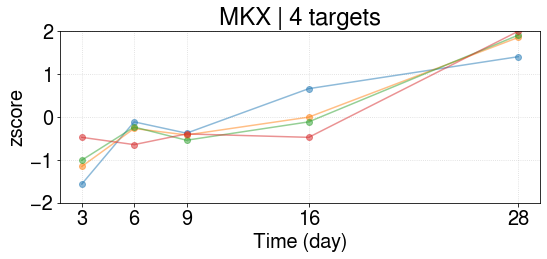

MKX | 1 [-1.05038325 -0.31659198 -0.43482365  0.01511587  1.78668301]
ANGPT1
NUDT4
CD302
DDR2
CYBRD1
RAB31
MGP
ECM2
MBNL2
CACNB2
LCA5
CHRDL1
ANTXR1
CREG1
DNAJC6
PDE1A
FBLN1
ASPN
AMIGO2
PTGIS
COMP
RSPO1
FMOD
sub ['ANGPT1', 'NUDT4', 'CD302', 'DDR2', 'CYBRD1', 'RAB31', 'MGP', 'ECM2', 'MBNL2', 'CACNB2', 'LCA5', 'CHRDL1', 'ANTXR1', 'CREG1', 'DNAJC6', 'PDE1A', 'FBLN1', 'ASPN', 'AMIGO2', 'PTGIS', 'COMP', 'RSPO1', 'FMOD'] 23


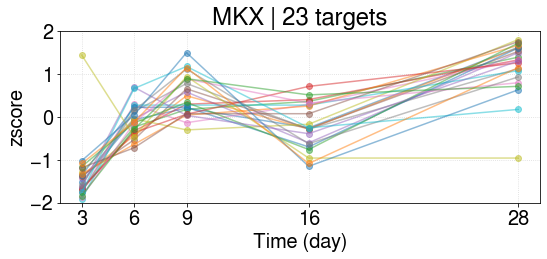

MKX | 2 [-1.38111345 -0.0912025   0.49735216 -0.19964709  1.17461088]
----------------------------------------------------------
regulon ZNF726 47
['LPCAT4', 'ESCO2', 'CCNF', 'TRAIP', 'FANCA', 'C21orf58', 'MCM5', 'XRCC2', 'RRM2', 'PASK', 'WDR62', 'POLQ', 'GINS1', 'CDC20', 'CCNB2', 'PLK4', 'ABCA13', 'KIF22', 'RAD51AP1', 'KIF2C', 'ARHGAP11B', 'GINS4', 'DSN1', 'NUF2', 'ORC6', 'STIL', 'KIF14', 'SPAG5', 'CHAF1A', 'FOXM1', 'PRC1', 'CENPK', 'KNL1', 'KIF11', 'EME1', 'CENPE', 'ZWILCH', 'SGO1', 'PARPBP', 'POLA2', 'CHTF18', 'PRR11', 'HELLS', 'SKA1', 'TROAP', 'BUB1', 'LIG1']


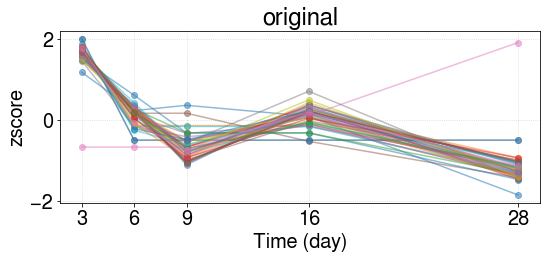

original data shape: (5, 47)
found subregulon: ['LPCAT4', 'ESCO2', 'CCNF', 'TRAIP', 'FANCA', 'C21orf58', 'MCM5', 'XRCC2', 'RRM2', 'PASK', 'WDR62', 'POLQ', 'GINS1', 'CDC20', 'CCNB2', 'PLK4', 'KIF22', 'RAD51AP1', 'KIF2C', 'ARHGAP11B', 'GINS4', 'DSN1', 'NUF2', 'ORC6', 'STIL', 'KIF14', 'SPAG5', 'CHAF1A', 'FOXM1', 'PRC1', 'CENPK', 'KNL1', 'KIF11', 'EME1', 'CENPE', 'ZWILCH', 'SGO1', 'PARPBP', 'POLA2', 'CHTF18', 'PRR11', 'HELLS', 'SKA1', 'TROAP', 'BUB1', 'LIG1'] 46 0.9307020958091278
################################## FINAL
original size: 47; new size 46; lost: 1
LPCAT4
ESCO2
CCNF
TRAIP
FANCA
C21orf58
MCM5
XRCC2
RRM2
PASK
WDR62
POLQ
GINS1
CDC20
CCNB2
PLK4
KIF22
RAD51AP1
KIF2C
ARHGAP11B
GINS4
DSN1
NUF2
ORC6
STIL
KIF14
SPAG5
CHAF1A
FOXM1
PRC1
CENPK
KNL1
KIF11
EME1
CENPE
ZWILCH
SGO1
PARPBP
POLA2
CHTF18
PRR11
HELLS
SKA1
TROAP
BUB1
LIG1
sub ['LPCAT4', 'ESCO2', 'CCNF', 'TRAIP', 'FANCA', 'C21orf58', 'MCM5', 'XRCC2', 'RRM2', 'PASK', 'WDR62', 'POLQ', 'GINS1', 'CDC20', 'CCNB2', 'PLK4', 'KIF22', 'RAD51A

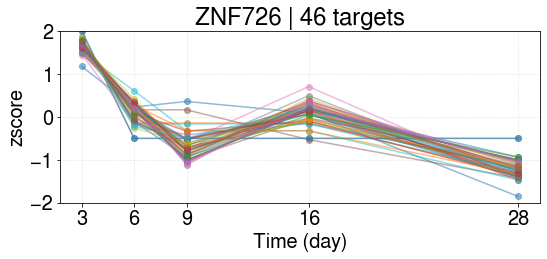

ZNF726 | 1 [ 1.66807692  0.11795391 -0.68903877  0.09651118 -1.19350323]
----------------------------------------------------------
regulon ZNF175 41
['DDIT4', 'INSR', 'SECTM1', 'CARD10', 'RAB31', 'IL1R1', 'CLMN', 'TACC3', 'CDKN1A', 'MME', 'SYNJ2', 'PIK3R1', 'LINC00598', 'ACSS3', 'ADGRG6', 'ST6GAL1', 'AC007246.3', 'EPAS1', 'HNMT', 'ANTXR2', 'NEDD9', 'CDCP1', 'IGF2BP3', 'PTK2B', 'VGLL4', 'GDF15', 'SMOC1', 'DUSP10', 'MTSS1', 'CDH2', 'MLPH', 'TGFBR3', 'PIM1', 'SLC44A1', 'FST', 'MYLK', 'FOXO1', 'ARHGAP18', 'CAMK2N1', 'CCDC85C', 'STIM1']


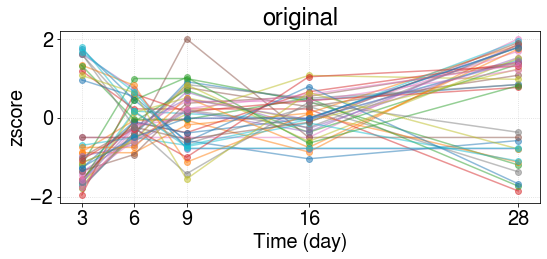

original data shape: (5, 41)
found subregulon: ['SYNJ2', 'ADGRG6', 'ARHGAP18', 'CCDC85C'] 4 0.8363342679190975
found subregulon: ['FST', 'RAB31', 'AC007246.3', 'SMOC1', 'STIM1', 'LINC00598', 'FOXO1', 'DUSP10', 'IL1R1', 'MME', 'HNMT', 'GDF15', 'VGLL4', 'DDIT4', 'MTSS1', 'NEDD9', 'EPAS1', 'ACSS3', 'PIK3R1', 'CDKN1A', 'TGFBR3', 'PTK2B', 'MYLK', 'INSR', 'ANTXR2', 'CLMN'] 26 0.831099517593364
found subregulon: ['CARD10', 'IGF2BP3', 'CDH2', 'CDCP1'] 4 0.8340608301675887
################################## FINAL
original size: 41; new size 34; lost: 7
SYNJ2
ADGRG6
ARHGAP18
CCDC85C
sub ['SYNJ2', 'ADGRG6', 'ARHGAP18', 'CCDC85C'] 4


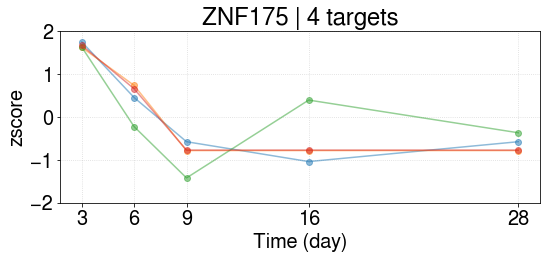

ZNF175 | 1 [ 1.66399261  0.40241863 -0.88902265 -0.55138243 -0.62600615]
FST
RAB31
AC007246.3
SMOC1
STIM1
LINC00598
FOXO1
DUSP10
IL1R1
MME
HNMT
GDF15
VGLL4
DDIT4
MTSS1
NEDD9
EPAS1
ACSS3
PIK3R1
CDKN1A
TGFBR3
PTK2B
MYLK
INSR
ANTXR2
CLMN
sub ['FST', 'RAB31', 'AC007246.3', 'SMOC1', 'STIM1', 'LINC00598', 'FOXO1', 'DUSP10', 'IL1R1', 'MME', 'HNMT', 'GDF15', 'VGLL4', 'DDIT4', 'MTSS1', 'NEDD9', 'EPAS1', 'ACSS3', 'PIK3R1', 'CDKN1A', 'TGFBR3', 'PTK2B', 'MYLK', 'INSR', 'ANTXR2', 'CLMN'] 26


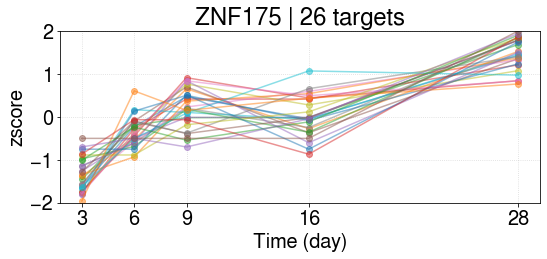

ZNF175 | 2 [-1.3524374  -0.35322538  0.19784146  0.02628279  1.48153852]
CARD10
IGF2BP3
CDH2
CDCP1
sub ['CARD10', 'IGF2BP3', 'CDH2', 'CDCP1'] 4


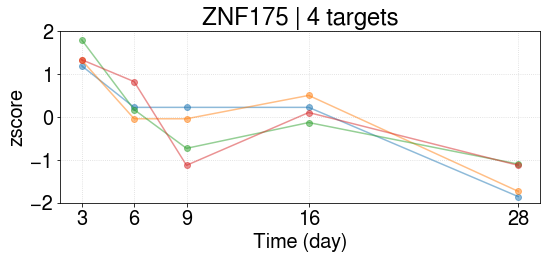

ZNF175 | 3 [ 1.40803919  0.29223324 -0.42020227  0.17323157 -1.45330173]
----------------------------------------------------------
regulon NHLH1 46
['BRCA1', 'PLEKHG5', 'PRKAR1B', 'RAB31', 'CDC25A', 'HYOU1', 'CPZ', 'FZD4', 'RGMB', 'NMNAT2', 'TP53INP1', 'ABCC9', 'MYO1D', 'TRIM46', 'ADGRG6', 'NOP56', 'PLSCR2', 'APOBEC3B', 'ACSL1', 'CDCP1', 'LYPD6', 'CDK1', 'CALM1', 'CDCA3', 'LRRC32', 'SLIT3', 'TUBB4B', 'CLSPN', 'ZBTB16', 'MTSS1', 'TEAD4', 'CDH2', 'TUBB6', 'SPC24', 'PID1', 'ISM1', 'SLC44A1', 'INSC', 'POLA2', 'DDIT4L', 'MEST', 'ID1', 'ROR2', 'FAM20C', 'FIGNL1', 'KLF11']


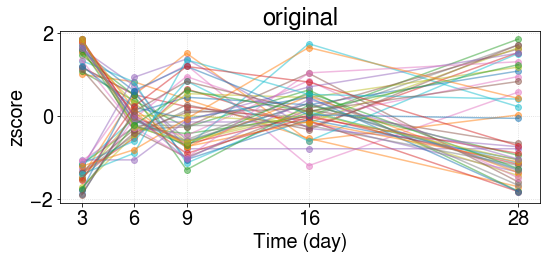

original data shape: (5, 46)
found subregulon: ['BRCA1', 'PLEKHG5', 'PRKAR1B', 'CDC25A', 'HYOU1', 'RGMB', 'TRIM46', 'ADGRG6', 'NOP56', 'APOBEC3B', 'CDCP1', 'LYPD6', 'CDK1', 'CALM1', 'CDCA3', 'TUBB4B', 'CLSPN', 'TEAD4', 'CDH2', 'TUBB6', 'SPC24', 'INSC', 'POLA2', 'FIGNL1'] 24 0.84270585342545
found subregulon: ['PLSCR2', 'ACSL1', 'TP53INP1', 'RAB31', 'KLF11', 'SLIT3', 'ISM1', 'MTSS1', 'ZBTB16', 'MEST', 'DDIT4L', 'FZD4', 'ABCC9'] 13 0.8343339220861914
################################## FINAL
original size: 46; new size 37; lost: 9
BRCA1
PLEKHG5
PRKAR1B
CDC25A
HYOU1
RGMB
TRIM46
ADGRG6
NOP56
APOBEC3B
CDCP1
LYPD6
CDK1
CALM1
CDCA3
TUBB4B
CLSPN
TEAD4
CDH2
TUBB6
SPC24
INSC
POLA2
FIGNL1
sub ['BRCA1', 'PLEKHG5', 'PRKAR1B', 'CDC25A', 'HYOU1', 'RGMB', 'TRIM46', 'ADGRG6', 'NOP56', 'APOBEC3B', 'CDCP1', 'LYPD6', 'CDK1', 'CALM1', 'CDCA3', 'TUBB4B', 'CLSPN', 'TEAD4', 'CDH2', 'TUBB6', 'SPC24', 'INSC', 'POLA2', 'FIGNL1'] 24


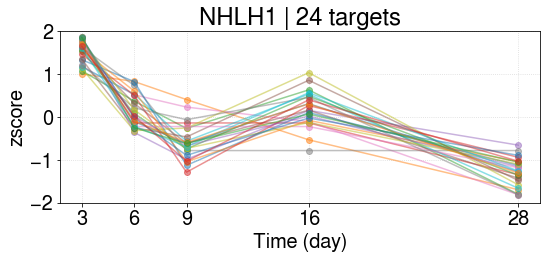

NHLH1 | 1 [ 1.52437721  0.15497353 -0.57491922  0.17804662 -1.28247813]
PLSCR2
ACSL1
TP53INP1
RAB31
KLF11
SLIT3
ISM1
MTSS1
ZBTB16
MEST
DDIT4L
FZD4
ABCC9
sub ['PLSCR2', 'ACSL1', 'TP53INP1', 'RAB31', 'KLF11', 'SLIT3', 'ISM1', 'MTSS1', 'ZBTB16', 'MEST', 'DDIT4L', 'FZD4', 'ABCC9'] 13


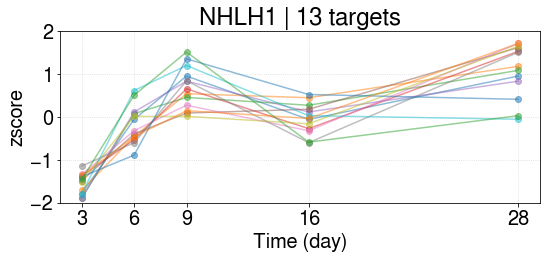

NHLH1 | 2 [-1.54665348 -0.18449481  0.68079889 -0.03674607  1.08709547]
----------------------------------------------------------
regulon STAT1 26
['FOS', 'IL1R1', 'IL6', 'MMP13', 'ZNF367', 'CDKN1A', 'A2M', 'CCND2', 'SOCS3', 'CYP19A1', 'APOE', 'FBXO5', 'CDC7', 'BCL6', 'CXCL8', 'BST2', 'IFITM1', 'PROS1', 'PLAU', 'TLR3', 'PIM1', 'APOL4', 'PTGFR', 'IFITM3', 'CSF1', 'PLSCR1']


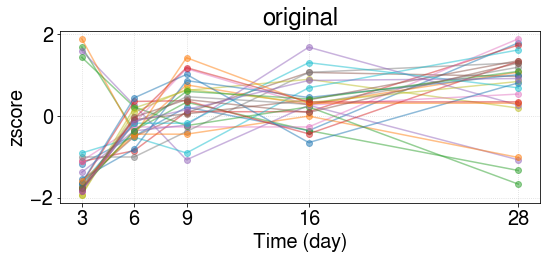

original data shape: (5, 26)
found subregulon: ['PTGFR', 'IL1R1', 'BST2', 'PLSCR1', 'CSF1', 'PLAU', 'APOE', 'CDKN1A', 'IFITM1', 'MMP13', 'TLR3', 'BCL6', 'IFITM3', 'FOS', 'CCND2', 'SOCS3', 'A2M'] 17 0.8365259498857389
################################## FINAL
original size: 26; new size 17; lost: 9
PTGFR
IL1R1
BST2
PLSCR1
CSF1
PLAU
APOE
CDKN1A
IFITM1
MMP13
TLR3
BCL6
IFITM3
FOS
CCND2
SOCS3
A2M
sub ['PTGFR', 'IL1R1', 'BST2', 'PLSCR1', 'CSF1', 'PLAU', 'APOE', 'CDKN1A', 'IFITM1', 'MMP13', 'TLR3', 'BCL6', 'IFITM3', 'FOS', 'CCND2', 'SOCS3', 'A2M'] 17


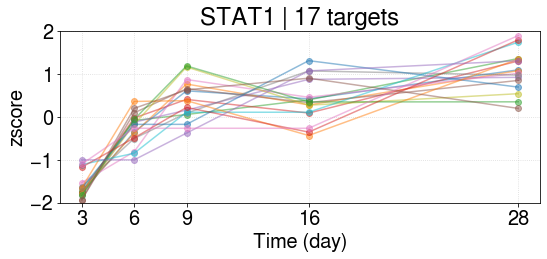

STAT1 | 1 [-1.5985386  -0.2726186   0.38111474  0.40465662  1.08538584]
----------------------------------------------------------
regulon FOXL1 66
['INSR', 'PLEKHG5', 'SLC7A2', 'SUSD2', 'PRKAR1B', 'B4GALNT1', 'ANTXR1', 'MMP28', 'FOXC2', 'DHRS3', 'ANKRD28', 'CFD', 'PPARG', 'CLMN', 'PTGER2', 'ITGA3', 'HAPLN1', 'SYNJ2', 'COMP', 'CFH', 'GYG2', 'ATP10A', 'A2M', 'GALNT15', 'C1QTNF1', 'KCNMA1', 'GGT5', 'ABCC9', 'NR1D2', 'MYO1D', 'PRRX2', 'PDCD1LG2', 'APOE', 'ELN', 'SPON1', 'MGP', 'POSTN', 'PTGIS', 'INHBA', 'LAYN', 'AK5', 'LMCD1', 'TNC', 'CACNB2', 'ADAMTS14', 'TNNT3', 'SLIT3', 'DNMT1', 'GDF15', 'FMOD', 'ABHD4', 'PCDH10', 'FRZB', 'MCM8', 'CSPG4', 'CNN1', 'PEAR1', 'MFAP4', 'MYLK', 'MFGE8', 'FAM20C', 'BTBD3', 'PLPP1', 'EPS8', 'ARHGAP6', 'NEBL']


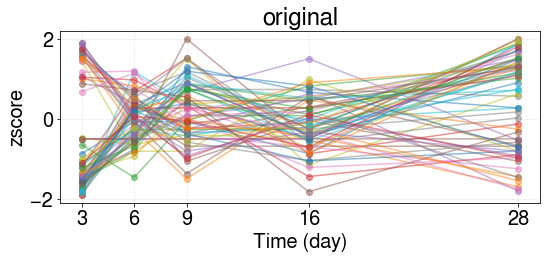

original data shape: (5, 66)
found subregulon: ['PLEKHG5', 'PRKAR1B', 'B4GALNT1', 'ITGA3', 'HAPLN1', 'SYNJ2', 'ATP10A', 'POSTN', 'AK5', 'ADAMTS14', 'DNMT1', 'PCDH10', 'MCM8', 'CSPG4'] 14 0.8330524458881321
found subregulon: ['MYLK', 'INHBA', 'CLMN', 'SPON1'] 4 0.8912585253907739
found subregulon: ['PPARG', 'NEBL', 'CFD', 'SLIT3', 'GGT5', 'CACNB2', 'MFAP4', 'ABHD4', 'SLC7A2', 'CFH', 'ARHGAP6', 'C1QTNF1', 'MGP', 'LAYN', 'FMOD', 'PLPP1', 'APOE', 'GALNT15', 'GDF15', 'MFGE8', 'NR1D2', 'MMP28', 'ANKRD28', 'BTBD3', 'GYG2', 'MYO1D', 'LMCD1', 'PRRX2', 'A2M', 'PTGIS', 'TNC'] 31 0.8280395818921734
################################## FINAL
original size: 66; new size 49; lost: 17
PLEKHG5
PRKAR1B
B4GALNT1
ITGA3
HAPLN1
SYNJ2
ATP10A
POSTN
AK5
ADAMTS14
DNMT1
PCDH10
MCM8
CSPG4
sub ['PLEKHG5', 'PRKAR1B', 'B4GALNT1', 'ITGA3', 'HAPLN1', 'SYNJ2', 'ATP10A', 'POSTN', 'AK5', 'ADAMTS14', 'DNMT1', 'PCDH10', 'MCM8', 'CSPG4'] 14


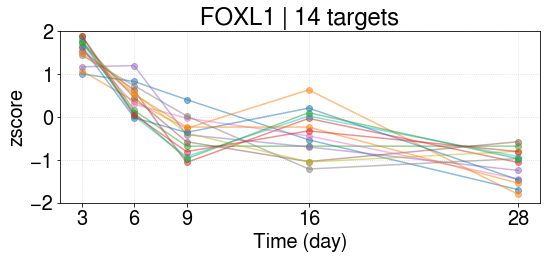

FOXL1 | 1 [ 1.5528239   0.41795551 -0.44886941 -0.37926181 -1.14264819]
MYLK
INHBA
CLMN
SPON1
sub ['MYLK', 'INHBA', 'CLMN', 'SPON1'] 4


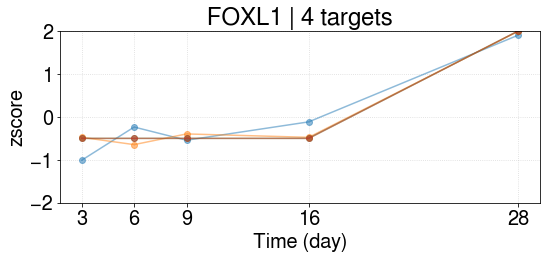

FOXL1 | 2 [-0.62091029 -0.47035584 -0.4848745  -0.39787228  1.9740129 ]
PPARG
NEBL
CFD
SLIT3
GGT5
CACNB2
MFAP4
ABHD4
SLC7A2
CFH
ARHGAP6
C1QTNF1
MGP
LAYN
FMOD
PLPP1
APOE
GALNT15
GDF15
MFGE8
NR1D2
MMP28
ANKRD28
BTBD3
GYG2
MYO1D
LMCD1
PRRX2
A2M
PTGIS
TNC
sub ['PPARG', 'NEBL', 'CFD', 'SLIT3', 'GGT5', 'CACNB2', 'MFAP4', 'ABHD4', 'SLC7A2', 'CFH', 'ARHGAP6', 'C1QTNF1', 'MGP', 'LAYN', 'FMOD', 'PLPP1', 'APOE', 'GALNT15', 'GDF15', 'MFGE8', 'NR1D2', 'MMP28', 'ANKRD28', 'BTBD3', 'GYG2', 'MYO1D', 'LMCD1', 'PRRX2', 'A2M', 'PTGIS', 'TNC'] 31


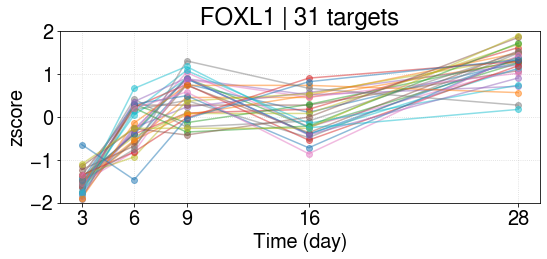

FOXL1 | 3 [-1.51733211 -0.22785709  0.46662633  0.04679076  1.23177211]
----------------------------------------------------------
regulon NR1H3 4
['ABCA1', 'KIAA1217', 'PPARG', 'APOE']


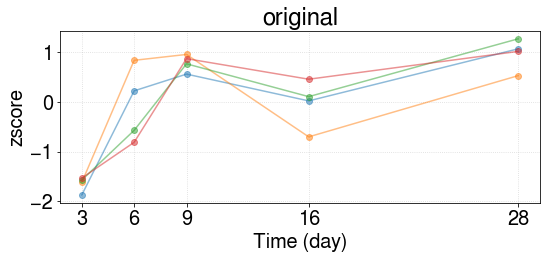

original data shape: (5, 4)
found subregulon: ['KIAA1217', 'PPARG', 'APOE'] 3 0.8597589791789465
################################## FINAL
original size: 4; new size 3; lost: 1
KIAA1217
PPARG
APOE
sub ['KIAA1217', 'PPARG', 'APOE'] 3


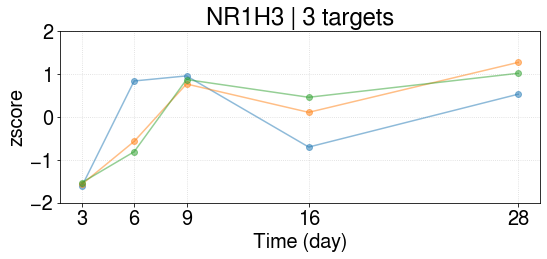

NR1H3 | 1 [-1.5730822  -0.18191228  0.86360528 -0.04626928  0.93765848]
----------------------------------------------------------
regulon NFIX 73
['DDIT4', 'ZCCHC24', 'PLEKHG5', 'DGKI', 'EPHX1', 'SUSD2', 'TNFRSF19', 'ANTXR1', 'CFD', 'ZNF503', 'DCN', 'DUSP4', 'LAMA4', 'CHI3L1', 'ID2', 'PALM', 'PDGFRL', 'CDKN1A', 'KIRREL3', 'FZD1', 'ANGPTL2', 'IFNGR1', 'FBLN2', 'LRP8', 'RUNX2', 'ELN', 'OLFML2A', 'BCL2L12', 'SPON1', 'CAP2', 'GPNMB', 'TMEM86A', 'FBLN1', 'PODN', 'ASPN', 'SCD5', 'WNK4', 'CTSO', 'SGCD', 'HMCN1', 'CLEC3B', 'FAM83G', 'GTSE1', 'FAM180A', 'CRISPLD2', 'CHAF1A', 'APCDD1L', 'MAN1C1', 'SLIT3', 'BST2', 'DNMT1', 'HTRA1', 'SLIT2', 'ATP6V0E2', 'NTM', 'FMOD', 'ARRB1', 'IGFBP5', 'LSP1', 'AHNAK2', 'DBP', 'IL18R1', 'MFAP4', 'MYLK', 'MFGE8', 'OLFML3', 'FBLN5', 'GPER1', 'PCDH18', 'GAS1', 'PLPP1', 'BOC', 'SSPN']


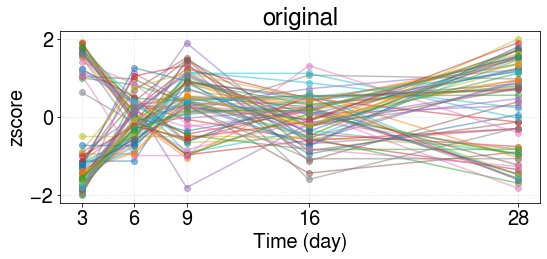

original data shape: (5, 73)
found subregulon: ['PLEKHG5', 'DGKI', 'KIRREL3', 'LRP8', 'BCL2L12', 'CAP2', 'WNK4', 'SGCD', 'FAM83G', 'GTSE1', 'FAM180A', 'CHAF1A', 'DNMT1', 'SLIT2', 'ATP6V0E2', 'ARRB1', 'AHNAK2', 'FBLN5', 'GPER1'] 19 0.8303553381407781
found subregulon: ['OLFML2A', 'DUSP4', 'DBP', 'MYLK', 'SPON1'] 5 0.8269669504277901
found subregulon: ['TMEM86A', 'DCN', 'FBLN1', 'MFAP4', 'CFD', 'PCDH18', 'DDIT4', 'MFGE8', 'GAS1', 'FMOD', 'IL18R1', 'ZCCHC24', 'ANGPTL2', 'MAN1C1', 'PDGFRL', 'ASPN', 'OLFML3', 'SSPN', 'CTSO', 'BOC', 'TNFRSF19', 'HMCN1', 'LAMA4', 'PLPP1', 'CHI3L1', 'EPHX1', 'ZNF503', 'PALM', 'BST2', 'GPNMB', 'SUSD2', 'RUNX2'] 32 0.839110906577282
################################## FINAL
original size: 73; new size 56; lost: 17
PLEKHG5
DGKI
KIRREL3
LRP8
BCL2L12
CAP2
WNK4
SGCD
FAM83G
GTSE1
FAM180A
CHAF1A
DNMT1
SLIT2
ATP6V0E2
ARRB1
AHNAK2
FBLN5
GPER1
sub ['PLEKHG5', 'DGKI', 'KIRREL3', 'LRP8', 'BCL2L12', 'CAP2', 'WNK4', 'SGCD', 'FAM83G', 'GTSE1', 'FAM180A', 'CHAF1A', 'DNMT1', 'SL

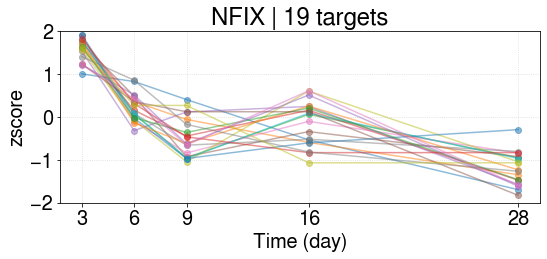

NFIX | 1 [ 1.58850295  0.2136772  -0.46613802 -0.13547217 -1.20056995]
OLFML2A
DUSP4
DBP
MYLK
SPON1
sub ['OLFML2A', 'DUSP4', 'DBP', 'MYLK', 'SPON1'] 5


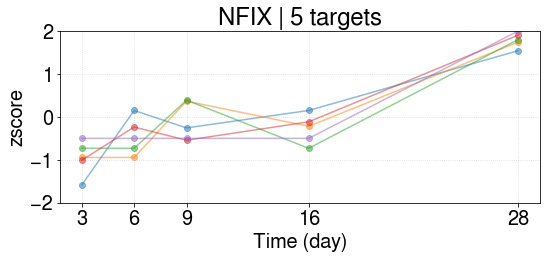

NFIX | 2 [-0.95360678 -0.45234724 -0.10848515 -0.2831357   1.79757486]
TMEM86A
DCN
FBLN1
MFAP4
CFD
PCDH18
DDIT4
MFGE8
GAS1
FMOD
IL18R1
ZCCHC24
ANGPTL2
MAN1C1
PDGFRL
ASPN
OLFML3
SSPN
CTSO
BOC
TNFRSF19
HMCN1
LAMA4
PLPP1
CHI3L1
EPHX1
ZNF503
PALM
BST2
GPNMB
SUSD2
RUNX2
sub ['TMEM86A', 'DCN', 'FBLN1', 'MFAP4', 'CFD', 'PCDH18', 'DDIT4', 'MFGE8', 'GAS1', 'FMOD', 'IL18R1', 'ZCCHC24', 'ANGPTL2', 'MAN1C1', 'PDGFRL', 'ASPN', 'OLFML3', 'SSPN', 'CTSO', 'BOC', 'TNFRSF19', 'HMCN1', 'LAMA4', 'PLPP1', 'CHI3L1', 'EPHX1', 'ZNF503', 'PALM', 'BST2', 'GPNMB', 'SUSD2', 'RUNX2'] 32


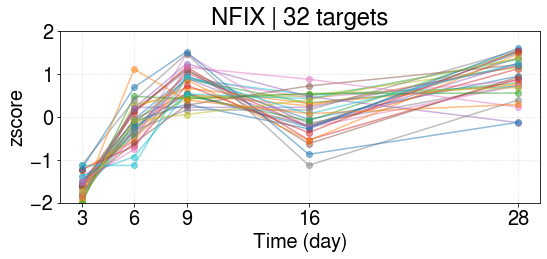

NFIX | 3 [-1.61505928 -0.141411    0.76082242  0.03262369  0.96302418]
----------------------------------------------------------
regulon YBX3 67
['ACKR1', 'INSR', 'ZCCHC24', 'MAP3K8', 'SLC7A2', 'GABARAPL1', 'PPRC1', 'NDRG1', 'RAB31', 'CHRDL2', 'CEBPD', 'NFKBIZ', 'SERPINA3', 'RANGAP1', 'IL1R1', 'CD55', 'IL6', 'INHBB', 'CDKN1A', 'TFPI', 'PNP', 'EFNA1', 'FOSL1', 'CXCL2', 'FJX1', 'PELI1', 'RHOQ', 'BTG1', 'C1QTNF1', 'SOCS3', 'STOM', 'GJA1', 'TNFRSF10D', 'MT2A', 'CCR7', 'GYPC', 'SAT1', 'ANGPTL4', 'CDC7', 'CEBPB', 'CNTNAP1', 'BCL6', 'PFKP', 'ADM', 'PNRC1', 'GBE1', 'IL1R2', 'CRISPLD2', 'IL1RL1', 'IFITM1', 'MT1X', 'CCDC86', 'ATP6V0E2', 'TEAD4', 'GBP2', 'TUBB6', 'IFRD2', 'MEDAG', 'PIM1', 'FAM20C', 'IFITM3', 'SPRY1', 'MAP4K2', 'PLSCR1', 'SOD2', 'LATS2', 'LDLRAD3']


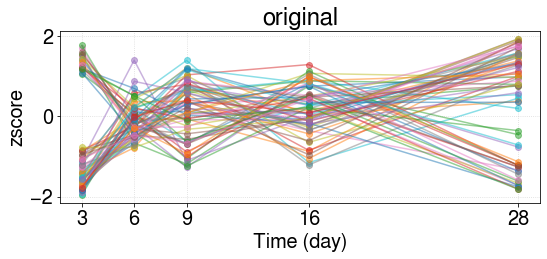

original data shape: (5, 67)
found subregulon: ['SOCS3', 'PNP', 'TUBB6', 'IFRD2', 'CDC7', 'RANGAP1', 'TEAD4'] 7 0.8275190177603318
found subregulon: ['GABARAPL1', 'CEBPB', 'CEBPD', 'BTG1', 'RAB31', 'PNRC1', 'ADM', 'CRISPLD2', 'SOD2', 'SLC7A2', 'IL1R1', 'NDRG1', 'GJA1', 'BCL6', 'STOM', 'SAT1', 'C1QTNF1', 'MEDAG', 'ZCCHC24', 'RHOQ', 'GYPC', 'ACKR1', 'LATS2', 'IL1R2', 'MAP3K8', 'EFNA1', 'SPRY1', 'PIM1', 'CD55', 'IFITM1', 'TFPI', 'PELI1', 'SERPINA3', 'GBP2', 'INSR', 'CDKN1A', 'NFKBIZ', 'CHRDL2', 'IFITM3'] 39 0.8274763886249992
################################## FINAL
original size: 67; new size 46; lost: 21
SOCS3
PNP
TUBB6
IFRD2
CDC7
RANGAP1
TEAD4
sub ['SOCS3', 'PNP', 'TUBB6', 'IFRD2', 'CDC7', 'RANGAP1', 'TEAD4'] 7


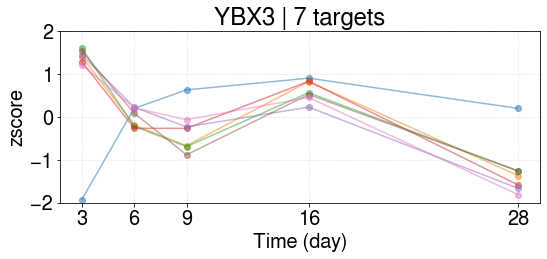

YBX3 | 1 [ 0.93654406  0.0075152  -0.311116    0.61665645 -1.24959972]
GABARAPL1
CEBPB
CEBPD
BTG1
RAB31
PNRC1
ADM
CRISPLD2
SOD2
SLC7A2
IL1R1
NDRG1
GJA1
BCL6
STOM
SAT1
C1QTNF1
MEDAG
ZCCHC24
RHOQ
GYPC
ACKR1
LATS2
IL1R2
MAP3K8
EFNA1
SPRY1
PIM1
CD55
IFITM1
TFPI
PELI1
SERPINA3
GBP2
INSR
CDKN1A
NFKBIZ
CHRDL2
IFITM3
sub ['GABARAPL1', 'CEBPB', 'CEBPD', 'BTG1', 'RAB31', 'PNRC1', 'ADM', 'CRISPLD2', 'SOD2', 'SLC7A2', 'IL1R1', 'NDRG1', 'GJA1', 'BCL6', 'STOM', 'SAT1', 'C1QTNF1', 'MEDAG', 'ZCCHC24', 'RHOQ', 'GYPC', 'ACKR1', 'LATS2', 'IL1R2', 'MAP3K8', 'EFNA1', 'SPRY1', 'PIM1', 'CD55', 'IFITM1', 'TFPI', 'PELI1', 'SERPINA3', 'GBP2', 'INSR', 'CDKN1A', 'NFKBIZ', 'CHRDL2', 'IFITM3'] 39


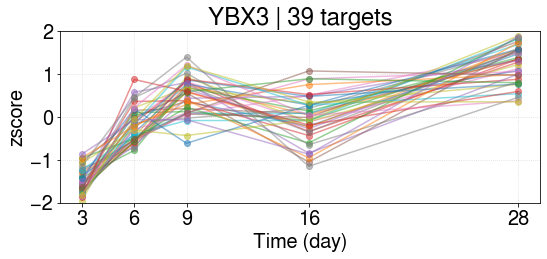

YBX3 | 2 [-1.51361292 -0.18699509  0.49133896 -0.0255465   1.23481555]
----------------------------------------------------------
regulon AR 17
['PNRC1', 'C1orf21', 'PTPRM', 'CCNG2', 'CYCS', 'NDRG1', 'EYA2', 'KIAA1217', 'IL1R1', 'AKR1C3', 'MT2A', 'MMP13', 'LIFR', 'CDKN1A', 'CDH2', 'ZBTB16', 'CDC6']


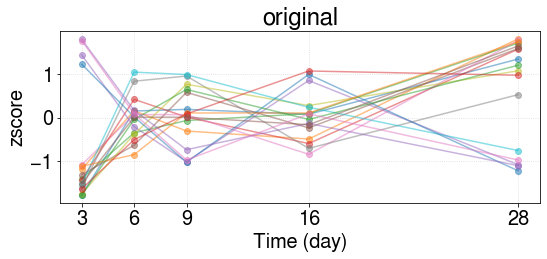

original data shape: (5, 17)
found subregulon: ['NDRG1', 'IL1R1', 'CCNG2', 'PTPRM', 'EYA2', 'MMP13', 'C1orf21'] 7 0.8566573372720323
################################## FINAL
original size: 17; new size 7; lost: 10
NDRG1
IL1R1
CCNG2
PTPRM
EYA2
MMP13
C1orf21
sub ['NDRG1', 'IL1R1', 'CCNG2', 'PTPRM', 'EYA2', 'MMP13', 'C1orf21'] 7


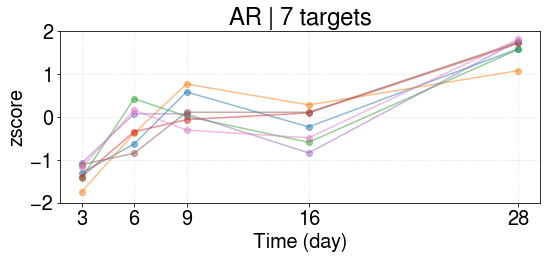

AR | 1 [-1.3161825  -0.22121974  0.16740966 -0.23863662  1.60862921]
----------------------------------------------------------
regulon ZNF469 54
['UHRF1', 'GLI2', 'GABARAPL1', 'C1R', 'CILP2', 'UCHL1', 'TUBA1B', 'SHANK1', 'PTGER2', 'SLC35E4', 'RAC2', 'SH3BP1', 'FJX1', 'SHCBP1', 'LOXL2', 'ANGPTL2', 'PAQR4', 'TUBA1C', 'TUBA1A', 'SPON1', 'PTGIS', 'FNDC1', 'TUBB3', 'TGFBI', 'TNFRSF1B', 'THBS2', 'SAMSN1', 'TNC', 'SCG2', 'GTSE1', 'CTXN1', 'FNDC10', 'HTRA1', 'MELTF', 'GLIPR1', 'EPHB2', 'CD14', 'DNMT1', 'SLC2A6', 'PBK', 'TUBB6', 'PLTP', 'IL11', 'KIF26B', 'SELPLG', 'FAM20C', 'ROR2', 'RASL11B', 'MAFB', 'NF2', 'PFAS', 'OLFML3', 'SLC17A9', 'SEC14L2']


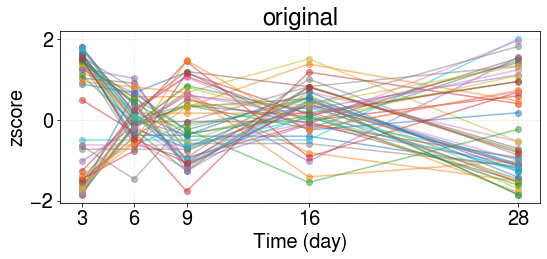

original data shape: (5, 54)
found subregulon: ['UHRF1', 'GLI2', 'UCHL1', 'TUBA1B', 'SHANK1', 'SLC35E4', 'RAC2', 'SH3BP1', 'FJX1', 'SHCBP1', 'LOXL2', 'PAQR4', 'TUBA1C', 'TUBA1A', 'TUBB3', 'GTSE1', 'CTXN1', 'FNDC10', 'GLIPR1', 'EPHB2', 'DNMT1', 'SLC2A6', 'PBK', 'TUBB6', 'SELPLG', 'NF2', 'PFAS', 'SLC17A9', 'SEC14L2'] 29 0.8305789799150143
found subregulon: ['SCG2', 'TNFRSF1B', 'C1R', 'ROR2', 'CD14', 'KIF26B', 'MAFB', 'OLFML3', 'THBS2', 'PTGIS', 'PLTP', 'FAM20C'] 12 0.8500711096947584
################################## FINAL
original size: 54; new size 41; lost: 13
UHRF1
GLI2
UCHL1
TUBA1B
SHANK1
SLC35E4
RAC2
SH3BP1
FJX1
SHCBP1
LOXL2
PAQR4
TUBA1C
TUBA1A
TUBB3
GTSE1
CTXN1
FNDC10
GLIPR1
EPHB2
DNMT1
SLC2A6
PBK
TUBB6
SELPLG
NF2
PFAS
SLC17A9
SEC14L2
sub ['UHRF1', 'GLI2', 'UCHL1', 'TUBA1B', 'SHANK1', 'SLC35E4', 'RAC2', 'SH3BP1', 'FJX1', 'SHCBP1', 'LOXL2', 'PAQR4', 'TUBA1C', 'TUBA1A', 'TUBB3', 'GTSE1', 'CTXN1', 'FNDC10', 'GLIPR1', 'EPHB2', 'DNMT1', 'SLC2A6', 'PBK', 'TUBB6', 'SELPLG', 'NF2', 'PFAS

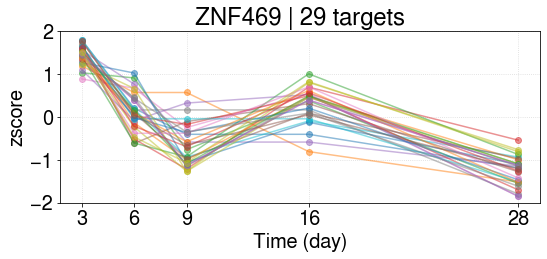

ZNF469 | 1 [ 1.46320245  0.13397047 -0.6377632   0.29739558 -1.2568053 ]
SCG2
TNFRSF1B
C1R
ROR2
CD14
KIF26B
MAFB
OLFML3
THBS2
PTGIS
PLTP
FAM20C
sub ['SCG2', 'TNFRSF1B', 'C1R', 'ROR2', 'CD14', 'KIF26B', 'MAFB', 'OLFML3', 'THBS2', 'PTGIS', 'PLTP', 'FAM20C'] 12


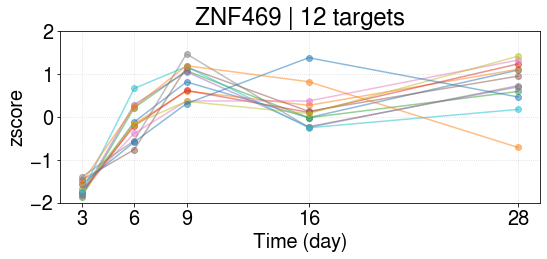

ZNF469 | 2 [-1.67340091 -0.13080259  0.84950904  0.19861944  0.75607501]
----------------------------------------------------------
regulon OSR1 62
['PDE1A', 'C1S', 'GLI2', 'FGF7', 'SVEP1', 'C1R', 'B4GALNT1', 'EFEMP1', 'CFD', 'CHRDL1', 'FOXC2', 'ZNF503', 'CHRDL2', 'UCHL1', 'DCN', 'PDGFRL', 'OSR2', 'LAMA4', 'RCN1', 'IGF2', 'CADM3', 'SNCG', 'DDR2', 'C1QTNF1', 'FBLN2', 'PRRX2', 'ELN', 'MGP', 'ADAMTSL4', 'GYPC', 'PTGIS', 'FBLN1', 'PODN', 'SERPING1', 'LMCD1', 'MMP16', 'C3', 'CYP1B1', 'DPT', 'KCNK15', 'HTRA1', 'PRG4', 'GLIPR1', 'MELTF', 'SLIT2', 'EPHB2', 'CXCL12', 'FMOD', 'MEDAG', 'SRPX', 'CNN1', 'PTGFR', 'MFAP4', 'FAM20C', 'OLFML3', 'LIMS2', 'CSF1', 'LUM', 'GAS1', 'PMP22', 'BOC', 'SERPINF1']


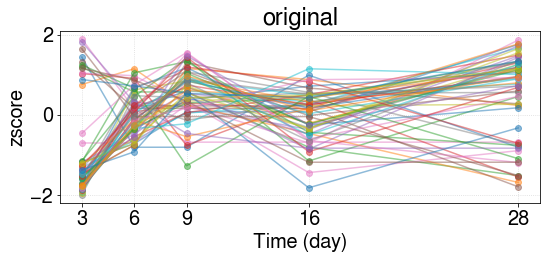

original data shape: (5, 62)
found subregulon: ['GLI2', 'SNCG', 'ELN', 'MMP16', 'SLIT2', 'EPHB2', 'LIMS2'] 7 0.8254407717532591
found subregulon: ['HTRA1', 'DCN', 'SERPINF1', 'KCNK15', 'FBLN1', 'PTGFR', 'IGF2', 'C1S', 'GYPC', 'GAS1', 'CFD', 'RCN1', 'MFAP4', 'FGF7', 'FMOD', 'EFEMP1', 'DDR2', 'C1R', 'PDGFRL', 'PMP22', 'CADM3', 'LUM', 'LAMA4', 'OLFML3', 'CSF1', 'BOC', 'ADAMTSL4', 'SVEP1', 'MEDAG', 'C3', 'C1QTNF1', 'PRRX2', 'PTGIS', 'MGP', 'DPT', 'ZNF503', 'MELTF', 'SRPX', 'CYP1B1', 'CHRDL1', 'FBLN2', 'CNN1'] 42 0.8287633547178044
################################## FINAL
original size: 62; new size 49; lost: 13
GLI2
SNCG
ELN
MMP16
SLIT2
EPHB2
LIMS2
sub ['GLI2', 'SNCG', 'ELN', 'MMP16', 'SLIT2', 'EPHB2', 'LIMS2'] 7


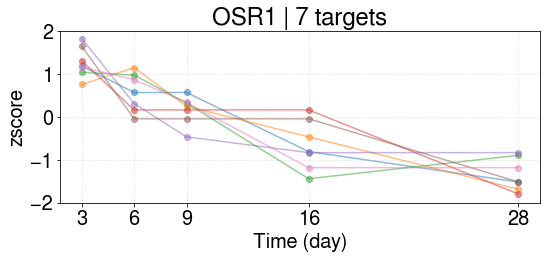

OSR1 | 1 [ 1.27253055  0.56880998  0.16141253 -0.65820733 -1.34454572]
HTRA1
DCN
SERPINF1
KCNK15
FBLN1
PTGFR
IGF2
C1S
GYPC
GAS1
CFD
RCN1
MFAP4
FGF7
FMOD
EFEMP1
DDR2
C1R
PDGFRL
PMP22
CADM3
LUM
LAMA4
OLFML3
CSF1
BOC
ADAMTSL4
SVEP1
MEDAG
C3
C1QTNF1
PRRX2
PTGIS
MGP
DPT
ZNF503
MELTF
SRPX
CYP1B1
CHRDL1
FBLN2
CNN1
sub ['HTRA1', 'DCN', 'SERPINF1', 'KCNK15', 'FBLN1', 'PTGFR', 'IGF2', 'C1S', 'GYPC', 'GAS1', 'CFD', 'RCN1', 'MFAP4', 'FGF7', 'FMOD', 'EFEMP1', 'DDR2', 'C1R', 'PDGFRL', 'PMP22', 'CADM3', 'LUM', 'LAMA4', 'OLFML3', 'CSF1', 'BOC', 'ADAMTSL4', 'SVEP1', 'MEDAG', 'C3', 'C1QTNF1', 'PRRX2', 'PTGIS', 'MGP', 'DPT', 'ZNF503', 'MELTF', 'SRPX', 'CYP1B1', 'CHRDL1', 'FBLN2', 'CNN1'] 42


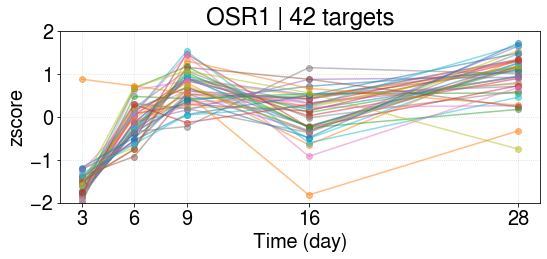

OSR1 | 2 [-1.58781398 -0.12637379  0.67734354  0.09171052  0.94513371]
----------------------------------------------------------
regulon FOXF2 52
['SVEP1', 'C1S', 'SLC7A2', 'GLI2', 'CFAP69', 'NDRG1', 'C21orf58', 'ADAMTS10', 'MMP13', 'CFH', 'PELI1', 'CPED1', 'PAK3', 'PTH1R', 'FZD1', 'NR1D2', 'PRRX2', 'OLFML2A', 'PTGIS', 'EPAS1', 'FBLN1', 'ASPN', 'TGFBI', 'KCNJ8', 'BRINP1', 'C7', 'CYGB', 'AXL', 'ADAMTS6', 'SYT1', 'SLIT2', 'DPF3', 'CXCL12', 'RBP4', 'ABHD4', 'ARRB1', 'RSPO1', 'CENPI', 'RGS4', 'FMO3', 'FANCI', 'ADHFE1', 'IL18R1', 'MFAP4', 'ROR2', 'LIMS2', 'OLFML3', 'APOD', 'PSD4', 'BOC', 'PDCD1LG2', 'MT1E']


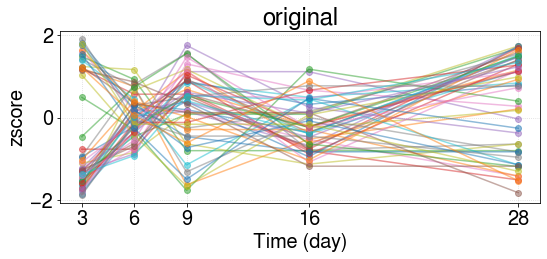

original data shape: (5, 52)
found subregulon: ['GLI2', 'C21orf58', 'PAK3', 'AXL', 'SYT1', 'SLIT2', 'DPF3', 'ARRB1', 'CENPI', 'FANCI', 'LIMS2', 'PSD4'] 12 0.8348340697068319
found subregulon: ['MFAP4', 'IL18R1', 'CFH', 'C1S', 'C7', 'FMO3', 'NDRG1', 'FBLN1', 'ASPN', 'CYGB', 'ABHD4', 'EPAS1', 'KCNJ8', 'OLFML3', 'NR1D2', 'BOC', 'SVEP1', 'SLC7A2', 'RSPO1', 'PRRX2', 'APOD', 'CFAP69', 'PTGIS'] 23 0.862164398698223
################################## FINAL
original size: 52; new size 35; lost: 17
GLI2
C21orf58
PAK3
AXL
SYT1
SLIT2
DPF3
ARRB1
CENPI
FANCI
LIMS2
PSD4
sub ['GLI2', 'C21orf58', 'PAK3', 'AXL', 'SYT1', 'SLIT2', 'DPF3', 'ARRB1', 'CENPI', 'FANCI', 'LIMS2', 'PSD4'] 12


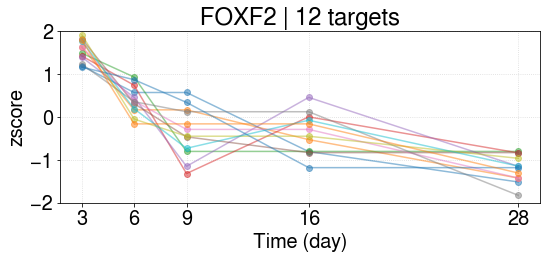

FOXF2 | 1 [ 1.53501215  0.39397024 -0.34843966 -0.37994535 -1.20059737]
MFAP4
IL18R1
CFH
C1S
C7
FMO3
NDRG1
FBLN1
ASPN
CYGB
ABHD4
EPAS1
KCNJ8
OLFML3
NR1D2
BOC
SVEP1
SLC7A2
RSPO1
PRRX2
APOD
CFAP69
PTGIS
sub ['MFAP4', 'IL18R1', 'CFH', 'C1S', 'C7', 'FMO3', 'NDRG1', 'FBLN1', 'ASPN', 'CYGB', 'ABHD4', 'EPAS1', 'KCNJ8', 'OLFML3', 'NR1D2', 'BOC', 'SVEP1', 'SLC7A2', 'RSPO1', 'PRRX2', 'APOD', 'CFAP69', 'PTGIS'] 23


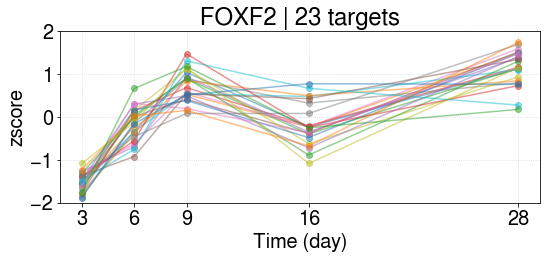

FOXF2 | 2 [-1.53107652 -0.17198248  0.72968029 -0.18062439  1.1540031 ]
----------------------------------------------------------
regulon ZNF423 122
['PDE1A', 'CPT1C', 'C1S', 'GLI2', 'NT5E', 'DHRS3', 'RARRES2', 'ANGPTL2', 'ELN', 'PTGIS', 'FBLN1', 'CTSO', 'STX3', 'DPT', 'CALM1', 'APCDD1L', 'MAN1C1', 'SLIT3', 'NRGN', 'SMOC1', 'HMGA2', 'PLTP', 'SRPX', 'CNN1', 'GFRA1', 'APOD', 'PLPP1', 'SUSD2', 'SLC2A5', 'CARD10', 'EHD3', 'EFEMP1', 'CHRDL1', 'FOXC2', 'PNMA2', 'CLDN11', 'PALM', 'IGF2', 'RGMB', 'NMNAT2', 'CPED1', 'SNCG', 'CCNG2', 'FBLN2', 'PAMR1', 'FBLN7', 'KIAA1755', 'PODN', 'AK5', 'SERPING1', 'ABI3BP', 'MMP16', 'CNTNAP1', 'SGCD', 'ADAMTS12', 'TNC', 'SLC9A9', 'PRR15', 'SLIT2', 'IGFBP5', 'MFAP4', 'ECM2', 'SPRY1', 'CAMK2N1', 'GAS1', 'BOC', 'SERPINF1', 'ZCCHC24', 'B4GALNT1', 'CFD', 'NDNF', 'PLXDC2', 'SAMD11', 'PDGFRL', 'NES', 'OLFML2A', 'TUBA1A', 'MGP', 'SCD5', 'LYPD6', 'EBF1', 'LRRC32', 'EPHB2', 'DPF3', 'NTM', 'FBLN5', 'LUM', 'SMAD6', 'BRCA1', 'CDC25C', 'C1R', 'EPHX1', 'ANTXR1', 'TLE2', 'DCN

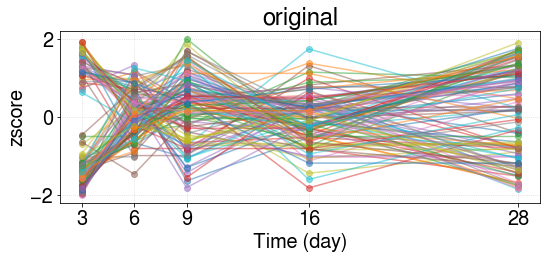

original data shape: (5, 122)
found subregulon: ['CPT1C', 'GLI2', 'NT5E', 'CALM1', 'NRGN', 'CARD10', 'EHD3', 'CLDN11', 'RGMB', 'SNCG', 'PAMR1', 'KIAA1755', 'AK5', 'ABI3BP', 'MMP16', 'CNTNAP1', 'SGCD', 'ADAMTS12', 'PRR15', 'SLIT2', 'B4GALNT1', 'NES', 'TUBA1A', 'LYPD6', 'EPHB2', 'DPF3', 'FBLN5', 'BRCA1', 'CDC25C', 'MGAT5', 'SLC8A1', 'S100A16', 'ARRB1'] 33 0.8258587629199032
found subregulon: ['SAMD11', 'PODN', 'SLC2A5', 'ADAMTS10', 'CXCL12'] 5 0.8253268774025223
found subregulon: ['GPC6', 'SERPING1', 'HTRA1', 'SMOC1', 'C1S', 'SERPINF1', 'CYGB', 'GAS1', 'EBF1', 'CFD', 'IGF2', 'DDR2', 'ECM2', 'ANGPTL2', 'NDNF', 'EFEMP1', 'FBLN1', 'TLE2', 'PLXDC2', 'MFAP4', 'PDGFRL', 'SSPN', 'ZCCHC24', 'CADM3', 'ANGPT1', 'SLIT3', 'FBLN7', 'SLC9A9', 'LUM', 'APOD', 'C7', 'C1R', 'EPHX1', 'SCD5', 'CTSO', 'MAN1C1', 'BOC', 'PLPP1', 'MGP', 'ASPN', 'SPRY1', 'DPT', 'LAMA4', 'HMCN1', 'OLFML2A', 'OLFML3', 'CHRDL1', 'ADAMTSL4', 'STX3', 'FBLN2', 'PNMA2', 'PDE1A', 'GFRA1', 'SRPX', 'C3', 'PLTP', 'ANTXR1', 'PTGIS', 'TNC', 

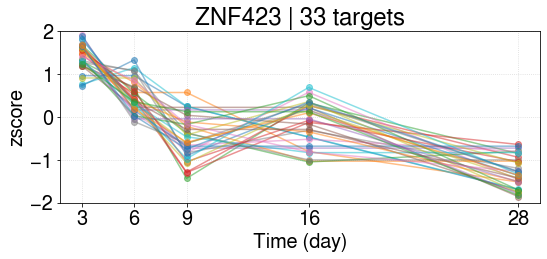

ZNF423 | 1 [ 1.42273356  0.4844364  -0.46594477 -0.15728167 -1.28394353]
SAMD11
PODN
SLC2A5
ADAMTS10
CXCL12
sub ['SAMD11', 'PODN', 'SLC2A5', 'ADAMTS10', 'CXCL12'] 5


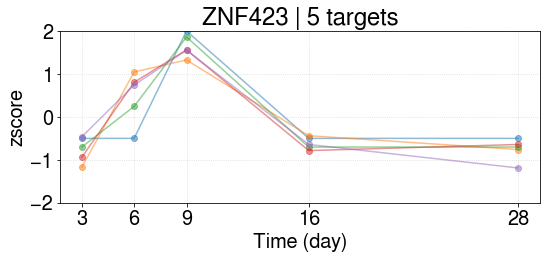

ZNF423 | 2 [-0.75623465  0.46757982  1.66011073 -0.61301479 -0.75844111]
GPC6
SERPING1
HTRA1
SMOC1
C1S
SERPINF1
CYGB
GAS1
EBF1
CFD
IGF2
DDR2
ECM2
ANGPTL2
NDNF
EFEMP1
FBLN1
TLE2
PLXDC2
MFAP4
PDGFRL
SSPN
ZCCHC24
CADM3
ANGPT1
SLIT3
FBLN7
SLC9A9
LUM
APOD
C7
C1R
EPHX1
SCD5
CTSO
MAN1C1
BOC
PLPP1
MGP
ASPN
SPRY1
DPT
LAMA4
HMCN1
OLFML2A
OLFML3
CHRDL1
ADAMTSL4
STX3
FBLN2
PNMA2
PDE1A
GFRA1
SRPX
C3
PLTP
ANTXR1
PTGIS
TNC
CCNG2
NMNAT2
OLFML2B
RARRES2
sub ['GPC6', 'SERPING1', 'HTRA1', 'SMOC1', 'C1S', 'SERPINF1', 'CYGB', 'GAS1', 'EBF1', 'CFD', 'IGF2', 'DDR2', 'ECM2', 'ANGPTL2', 'NDNF', 'EFEMP1', 'FBLN1', 'TLE2', 'PLXDC2', 'MFAP4', 'PDGFRL', 'SSPN', 'ZCCHC24', 'CADM3', 'ANGPT1', 'SLIT3', 'FBLN7', 'SLC9A9', 'LUM', 'APOD', 'C7', 'C1R', 'EPHX1', 'SCD5', 'CTSO', 'MAN1C1', 'BOC', 'PLPP1', 'MGP', 'ASPN', 'SPRY1', 'DPT', 'LAMA4', 'HMCN1', 'OLFML2A', 'OLFML3', 'CHRDL1', 'ADAMTSL4', 'STX3', 'FBLN2', 'PNMA2', 'PDE1A', 'GFRA1', 'SRPX', 'C3', 'PLTP', 'ANTXR1', 'PTGIS', 'TNC', 'CCNG2', 'NMNAT2', 'OLFML2B', 'RARRES2

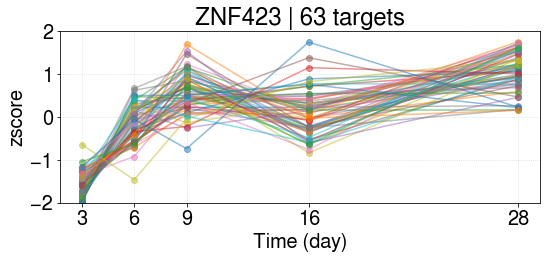

ZNF423 | 3 [-1.59440913 -0.16495521  0.57443358  0.09634971  1.08858106]
----------------------------------------------------------
regulon ZBTB47 60
['ANGPTL1', 'NFYB', 'ZCCHC24', 'C1S', 'PTPRM', 'C1R', 'B4GALNT1', 'ANTXR1', 'RAB31', 'LATS2', 'UCHL1', 'LAMA4', 'ARMC9', 'PALM', 'RHOQ', 'ANGPTL2', 'DDR2', 'C1QTNF1', 'KCNMA1', 'TUBA1A', 'LAMA2', 'JDP2', 'ADAMTSL4', 'PTGIS', 'GYPC', 'PODN', 'SERPING1', 'ANTXR2', 'KCNJ8', 'PFKP', 'CORO6', 'AXL', 'LRRC32', 'SLIT3', 'OSGIN2', 'HTRA1', 'FMOD', 'PKIG', 'TUBB6', 'C11orf95', 'MEDAG', 'ZNF469', 'CSPG4', 'CBX7', 'TPM1', 'DTNA', 'CCDC69', 'MYLK', 'KIAA1217', 'MFGE8', 'FAM20C', 'LIMS2', 'IFITM3', 'FBLN5', 'STAT5A', 'PLPP1', 'PMP22', 'BOC', 'SERPINF1', 'STIM1']


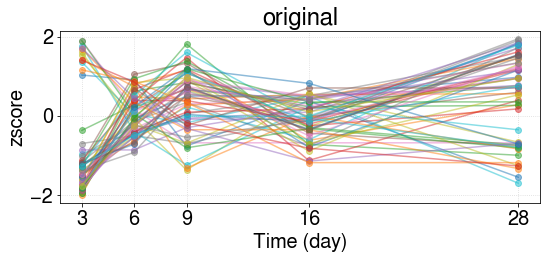

original data shape: (5, 60)
found subregulon: ['B4GALNT1', 'UCHL1', 'KCNMA1', 'TUBA1A', 'PFKP', 'AXL', 'TUBB6', 'ZNF469', 'CSPG4', 'FBLN5'] 10 0.8206614990844966
found subregulon: ['RHOQ', 'LATS2', 'OSGIN2', 'MYLK', 'ANTXR2'] 5 0.8517105001835751
found subregulon: ['SERPING1', 'CCDC69', 'SERPINF1', 'C1S', 'STAT5A', 'ANGPTL1', 'PKIG', 'DDR2', 'ANGPTL2', 'ZCCHC24', 'GYPC', 'CBX7', 'MFGE8', 'PMP22', 'FMOD', 'RAB31', 'C1R', 'SLIT3', 'JDP2', 'PLPP1', 'IFITM3', 'LAMA4', 'MEDAG', 'C1QTNF1', 'KCNJ8', 'ADAMTSL4', 'PTPRM', 'CORO6', 'BOC', 'PTGIS', 'DTNA', 'STIM1', 'KIAA1217', 'LAMA2', 'FAM20C', 'NFYB'] 36 0.8329500155544374
################################## FINAL
original size: 60; new size 51; lost: 9
B4GALNT1
UCHL1
KCNMA1
TUBA1A
PFKP
AXL
TUBB6
ZNF469
CSPG4
FBLN5
sub ['B4GALNT1', 'UCHL1', 'KCNMA1', 'TUBA1A', 'PFKP', 'AXL', 'TUBB6', 'ZNF469', 'CSPG4', 'FBLN5'] 10


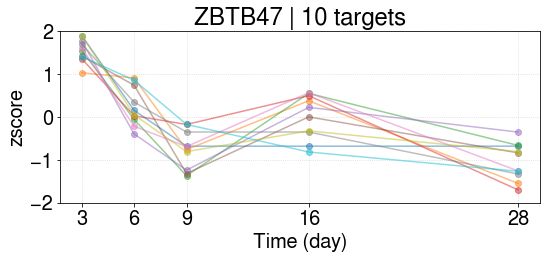

ZBTB47 | 1 [ 1.56028265  0.23919992 -0.75729898  0.00270592 -1.04488951]
RHOQ
LATS2
OSGIN2
MYLK
ANTXR2
sub ['RHOQ', 'LATS2', 'OSGIN2', 'MYLK', 'ANTXR2'] 5


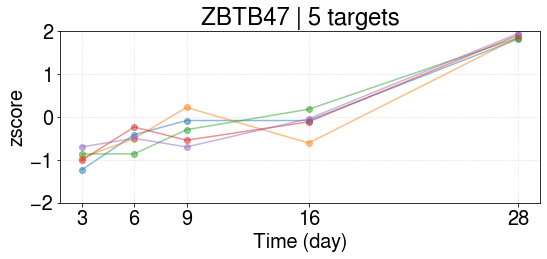

ZBTB47 | 2 [-0.9512947  -0.50315125 -0.28087474 -0.13473017  1.87005086]
SERPING1
CCDC69
SERPINF1
C1S
STAT5A
ANGPTL1
PKIG
DDR2
ANGPTL2
ZCCHC24
GYPC
CBX7
MFGE8
PMP22
FMOD
RAB31
C1R
SLIT3
JDP2
PLPP1
IFITM3
LAMA4
MEDAG
C1QTNF1
KCNJ8
ADAMTSL4
PTPRM
CORO6
BOC
PTGIS
DTNA
STIM1
KIAA1217
LAMA2
FAM20C
NFYB
sub ['SERPING1', 'CCDC69', 'SERPINF1', 'C1S', 'STAT5A', 'ANGPTL1', 'PKIG', 'DDR2', 'ANGPTL2', 'ZCCHC24', 'GYPC', 'CBX7', 'MFGE8', 'PMP22', 'FMOD', 'RAB31', 'C1R', 'SLIT3', 'JDP2', 'PLPP1', 'IFITM3', 'LAMA4', 'MEDAG', 'C1QTNF1', 'KCNJ8', 'ADAMTSL4', 'PTPRM', 'CORO6', 'BOC', 'PTGIS', 'DTNA', 'STIM1', 'KIAA1217', 'LAMA2', 'FAM20C', 'NFYB'] 36


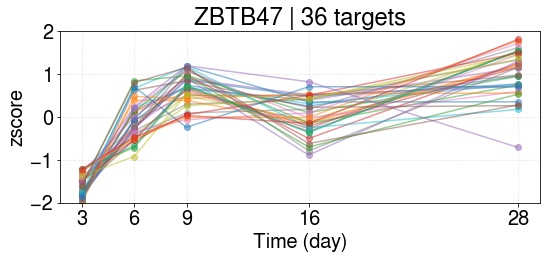

ZBTB47 | 3 [-1.61931394 -0.09017682  0.64575879  0.03364793  1.03008404]
----------------------------------------------------------
regulon MEIS3 124
['PDE1A', 'CPT1C', 'C1S', 'GLI2', 'RAB31', 'ARMC9', 'PTGER2', 'ATP10A', 'ANGPTL2', 'CD302', 'ELN', 'LAMA2', 'SPON1', 'PTGIS', 'GYPC', 'FBLN1', 'ANTXR2', 'THBS2', 'CRISPLD2', 'SLIT3', 'STON1', 'GLIPR1', 'PKIG', 'PLTP', 'ACSS1', 'SRPX', 'CCDC69', 'DTNA', 'PEAR1', 'MFGE8', 'BTBD3', 'IFITM3', 'PLPP1', 'EPS8', 'ARHGAP6', 'FOS', 'CARD10', 'ZNF503', 'PNMA2', 'CLDN11', 'SHANK1', 'PALM', 'LMNB1', 'PCMTD1', 'FBLN2', 'GPX3', 'TRIM46', 'PRRX2', 'PODN', 'SERPING1', 'AXL', 'PRG4', 'PXN', 'NBL1', 'PDGFRA', 'SPRY1', 'CAMK2N1', 'C6', 'CSF1', 'CSMD2', 'LDLRAD3', 'BOC', 'SERPINF1', 'ZCCHC24', 'B4GALNT1', 'SAMD11', 'COMP', 'A2M', 'GGT5', 'NES', 'LAYN', 'MGP', 'NETO2', 'SNED1', 'CTXN1', 'TLR4', 'LRRC32', 'APOL3', 'DNMT1', 'PROS1', 'PLAU', 'TMEM59L', 'FBLN5', 'PMP22', 'PODNL1', 'SVEP1', 'C1R', 'ADA', 'TOP2A', 'TLE2', 'IL1R1', 'DCN', 'RTN4RL2', 'OSR2', 'ADAMTS1

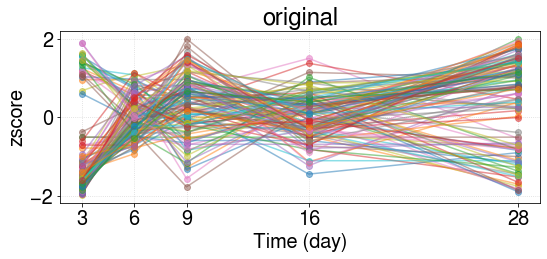

original data shape: (5, 124)
found subregulon: ['GLIPR1', 'AXL', 'CAMK2N1', 'B4GALNT1', 'NETO2', 'CTXN1', 'TOP2A', 'CSPG4'] 8 0.8401908571201964
found subregulon: ['C11orf95', 'SAMD11', 'LRRC32', 'ADAMTS10', 'PODN', 'ARMC9'] 6 0.8257627958679148
found subregulon: ['NES', 'ATP10A', 'LMNB1', 'SHANK1', 'TRIM46', 'FBLN5', 'DNMT1', 'CPT1C'] 8 0.8475548087483677
found subregulon: ['THBS2', 'DCN', 'PDGFRA', 'PROS1', 'CCDC69', 'IL1R1', 'ANGPTL2', 'CD302', 'SERPING1', 'TLE2', 'CYGB', 'PKIG', 'C1S', 'STAT5A', 'NBL1', 'GGT5', 'SERPINF1', 'ANGPT1', 'CRISPLD2', 'PLAU', 'SLIT3', 'CFH', 'GPX3', 'RAB31', 'FBLN1', 'ARHGAP6', 'CADM3', 'RTN4RL2', 'SVEP1', 'C1QTNF1', 'ZCCHC24', 'PMP22', 'MGP', 'GYPC', 'LAYN', 'STON1', 'BOC', 'PLPP1', 'FMOD', 'PRCD', 'LAMA2', 'MFGE8', 'PAPPA', 'MEDAG', 'FBLN2', 'CSF1', 'GALNT15', 'C1R', 'FOS', 'SPRY1', 'PDE1A', 'PODNL1', 'PCMTD1', 'KCNJ8', 'ACSS3', 'IFITM3', 'TLR4', 'VGLL4', 'PCSK1', 'OLFML3', 'SULF2', 'A2M', 'ADAMTSL4', 'BTBD3', 'EPS8', 'ADA', 'TFPI', 'PNMA2', 'PRG4', 'C

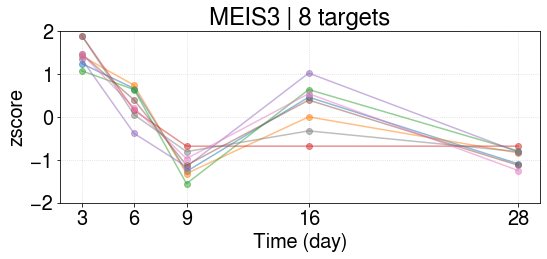

MEIS3 | 1 [ 1.47510755  0.30637259 -1.11127169  0.25528374 -0.9254922 ]
C11orf95
SAMD11
LRRC32
ADAMTS10
PODN
ARMC9
sub ['C11orf95', 'SAMD11', 'LRRC32', 'ADAMTS10', 'PODN', 'ARMC9'] 6


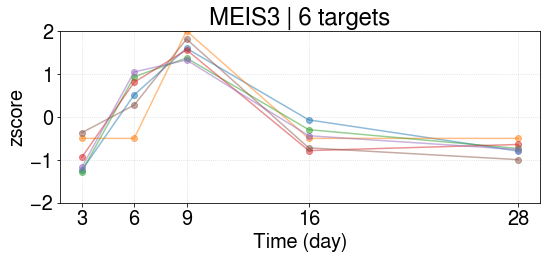

MEIS3 | 2 [-0.9166415   0.51177265  1.61124006 -0.46822994 -0.73814128]
NES
ATP10A
LMNB1
SHANK1
TRIM46
FBLN5
DNMT1
CPT1C
sub ['NES', 'ATP10A', 'LMNB1', 'SHANK1', 'TRIM46', 'FBLN5', 'DNMT1', 'CPT1C'] 8


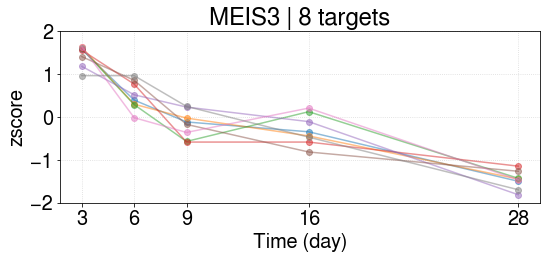

MEIS3 | 3 [ 1.43989238  0.50606295 -0.17058732 -0.30602946 -1.46933856]
THBS2
DCN
PDGFRA
PROS1
CCDC69
IL1R1
ANGPTL2
CD302
SERPING1
TLE2
CYGB
PKIG
C1S
STAT5A
NBL1
GGT5
SERPINF1
ANGPT1
CRISPLD2
PLAU
SLIT3
CFH
GPX3
RAB31
FBLN1
ARHGAP6
CADM3
RTN4RL2
SVEP1
C1QTNF1
ZCCHC24
PMP22
MGP
GYPC
LAYN
STON1
BOC
PLPP1
FMOD
PRCD
LAMA2
MFGE8
PAPPA
MEDAG
FBLN2
CSF1
GALNT15
C1R
FOS
SPRY1
PDE1A
PODNL1
PCMTD1
KCNJ8
ACSS3
IFITM3
TLR4
VGLL4
PCSK1
OLFML3
SULF2
A2M
ADAMTSL4
BTBD3
EPS8
ADA
TFPI
PNMA2
PRG4
C3
SRPX
C6
OSR2
PTGIS
LDLRAD3
PRRX2
TMEM59L
sub ['THBS2', 'DCN', 'PDGFRA', 'PROS1', 'CCDC69', 'IL1R1', 'ANGPTL2', 'CD302', 'SERPING1', 'TLE2', 'CYGB', 'PKIG', 'C1S', 'STAT5A', 'NBL1', 'GGT5', 'SERPINF1', 'ANGPT1', 'CRISPLD2', 'PLAU', 'SLIT3', 'CFH', 'GPX3', 'RAB31', 'FBLN1', 'ARHGAP6', 'CADM3', 'RTN4RL2', 'SVEP1', 'C1QTNF1', 'ZCCHC24', 'PMP22', 'MGP', 'GYPC', 'LAYN', 'STON1', 'BOC', 'PLPP1', 'FMOD', 'PRCD', 'LAMA2', 'MFGE8', 'PAPPA', 'MEDAG', 'FBLN2', 'CSF1', 'GALNT15', 'C1R', 'FOS', 'SPRY1', 'PDE1A', 'PODNL1',

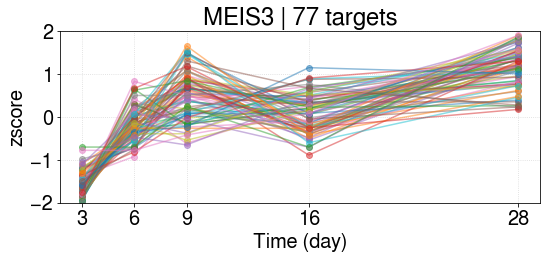

MEIS3 | 4 [-1.55943324 -0.17942322  0.47478333  0.08159992  1.18247321]
----------------------------------------------------------
regulon BATF3 115
['MAP3K8', 'NOP2', 'PPRC1', 'NFKBIZ', 'FJX1', 'ANGPTL2', 'STOM', 'CYP19A1', 'CD302', 'GYPC', 'THBS2', 'PFKP', 'PNRC1', 'ADAMTS14', 'KCNK15', 'IFITM1', 'GBP2', 'APOL6', 'SRPX', 'DNAJC6', 'PIM1', 'KIF26B', 'CDKN3', 'FAM89A', 'IFITM3', 'NR1D1', 'PLSCR1', 'ACKR1', 'SECTM1', 'ATP8B4', 'CILP2', 'ADAM19', 'PNP', 'LMNB1', 'NPR3', 'CH25H', 'IL3RA', 'SOCS3', 'PRRX2', 'GCH1', 'FAM20A', 'FBXO5', 'POSTN', 'CCR7', 'HLA-F', 'TGFBI', 'LMCD1', 'CNTNAP1', 'TNFRSF1B', 'ADAMTS12', 'SAMSN1', 'TNC', 'KLHL24', 'SLC25A19', 'TEAD4', 'TUBB6', 'APOL4', 'APOL1', 'SPRY1', 'SPRED3', 'CSF1', 'LDLRAD3', 'STIM1', 'CHRDL2', 'UBE2S', 'VCAM1', 'UBASH3B', 'FOSL1', 'NETO2', 'ANGPTL4', 'BCL6', 'APOL3', 'LRRC32', 'TUBB2A', 'BST2', 'CCDC86', 'METTL7A', 'NDC80', 'CDH2', 'SLC2A6', 'PLAU', 'CHI3L2', 'ATAD3B', 'TMEM59L', 'SLC17A9', 'FGF7', 'ADA', 'QSOX2', 'IL1R1', 'CHI3L1', 'IL6', 'R

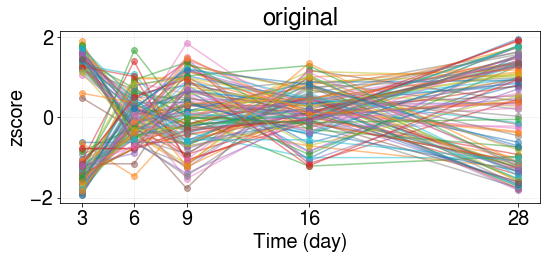

original data shape: (5, 115)
found subregulon: ['NOP2', 'PPRC1', 'FJX1', 'PFKP', 'ADAMTS14', 'CDKN3', 'ADAM19', 'PNP', 'LMNB1', 'FBXO5', 'CNTNAP1', 'SLC25A19', 'TEAD4', 'TUBB6', 'SPRED3', 'UBE2S', 'UBASH3B', 'FOSL1', 'NETO2', 'ANGPTL4', 'TUBB2A', 'CCDC86', 'NDC80', 'CDH2', 'SLC2A6', 'ATAD3B', 'SLC17A9', 'QSOX2', 'IL6', 'LOXL2', 'TNFRSF10D', 'KCNN4', 'NOP56', 'CDC7', 'SERPINE2', 'PRC1', 'STMN1', 'DIAPH3'] 38 0.8243394619125232
found subregulon: ['IL1RL1', 'LDLRAD3', 'TMEM59L', 'SAMSN1', 'CYP19A1', 'TNC'] 6 0.8548317400696759
found subregulon: ['ATP8B4', 'KCNK15', 'IL1R1', 'PLSCR1', 'PLAU', 'THBS2', 'FGF7', 'RCN1', 'GYPC', 'PNRC1', 'ANGPTL2', 'APOL1', 'IFITM1', 'CD302', 'METTL7A', 'KIF26B', 'BCL6', 'FAM89A', 'NFKBIZ', 'GJA1', 'IFITM3', 'BST2', 'ACKR1', 'PIM1', 'STOM', 'SULF2', 'LMCD1', 'CSF1', 'MEDAG', 'GBP2', 'ADA', 'NR1D1', 'APOL4', 'MAP3K8', 'SPRY1', 'TENM2', 'GEM', 'SOCS3', 'KIAA1217', 'VCAM1', 'CHI3L1', 'DNAJC6', 'PRRX2', 'GCH1', 'KLHL24', 'CH25H'] 46 0.8291502654031597
###########

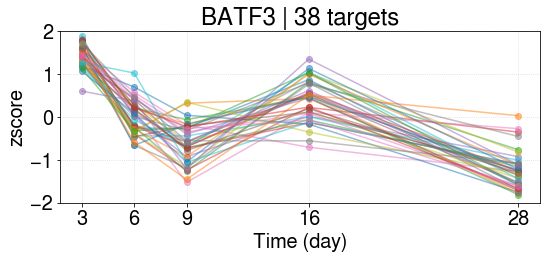

BATF3 | 1 [ 1.44547443  0.01963864 -0.6031327   0.38240024 -1.2443806 ]
IL1RL1
LDLRAD3
TMEM59L
SAMSN1
CYP19A1
TNC
sub ['IL1RL1', 'LDLRAD3', 'TMEM59L', 'SAMSN1', 'CYP19A1', 'TNC'] 6


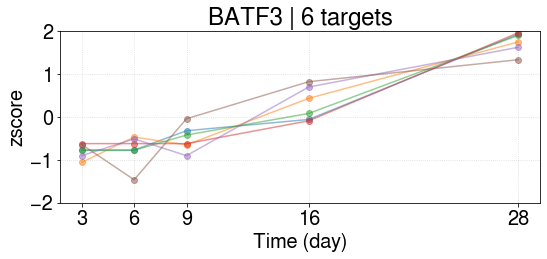

BATF3 | 2 [-0.79573214 -0.76958187 -0.4938554   0.31284798  1.74632142]
ATP8B4
KCNK15
IL1R1
PLSCR1
PLAU
THBS2
FGF7
RCN1
GYPC
PNRC1
ANGPTL2
APOL1
IFITM1
CD302
METTL7A
KIF26B
BCL6
FAM89A
NFKBIZ
GJA1
IFITM3
BST2
ACKR1
PIM1
STOM
SULF2
LMCD1
CSF1
MEDAG
GBP2
ADA
NR1D1
APOL4
MAP3K8
SPRY1
TENM2
GEM
SOCS3
KIAA1217
VCAM1
CHI3L1
DNAJC6
PRRX2
GCH1
KLHL24
CH25H
sub ['ATP8B4', 'KCNK15', 'IL1R1', 'PLSCR1', 'PLAU', 'THBS2', 'FGF7', 'RCN1', 'GYPC', 'PNRC1', 'ANGPTL2', 'APOL1', 'IFITM1', 'CD302', 'METTL7A', 'KIF26B', 'BCL6', 'FAM89A', 'NFKBIZ', 'GJA1', 'IFITM3', 'BST2', 'ACKR1', 'PIM1', 'STOM', 'SULF2', 'LMCD1', 'CSF1', 'MEDAG', 'GBP2', 'ADA', 'NR1D1', 'APOL4', 'MAP3K8', 'SPRY1', 'TENM2', 'GEM', 'SOCS3', 'KIAA1217', 'VCAM1', 'CHI3L1', 'DNAJC6', 'PRRX2', 'GCH1', 'KLHL24', 'CH25H'] 46


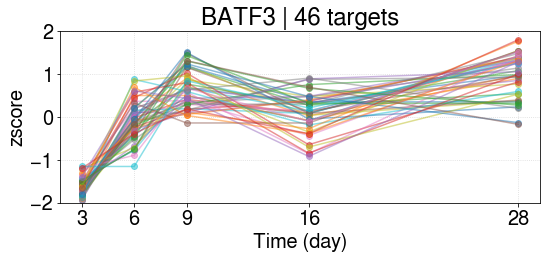

BATF3 | 3 [-1.64160004 -0.09122757  0.64115418  0.09834209  0.99333134]
----------------------------------------------------------
regulon EGR3 41
['GRASP', 'ST3GAL5', 'BTG2', 'DUSP5', 'NDRG1', 'CHAF1B', 'MMP28', 'IL1R1', 'YPEL2', 'IL6', 'CLMN', 'RNF144A', 'KDM7A', 'PTGER2', 'IGF2', 'THOP1', 'FOSL1', 'CXCL2', 'CH25H', 'PAK3', 'TSC22D1', 'IFNGR1', 'SOCS3', 'TUBA1C', 'TNFRSF10D', 'JDP2', 'PFKP', 'DPF1', 'INCENP', 'MAN1C1', 'CEP72', 'HBEGF', 'LSP1', 'MEST', 'AUNIP', 'ZNF436', 'SPRY1', 'TMEM59L', 'MKI67', 'SFXN2', 'GEM']


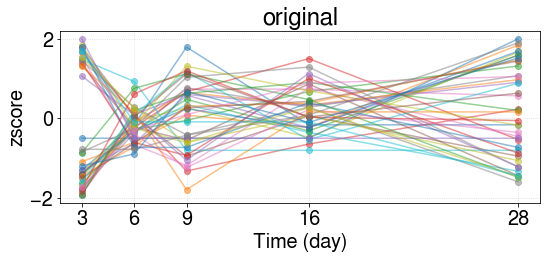

original data shape: (5, 41)
found subregulon: ['CHAF1B', 'IL6', 'THOP1', 'FOSL1', 'TUBA1C', 'TNFRSF10D', 'PFKP', 'DPF1', 'INCENP', 'CEP72', 'AUNIP', 'MKI67', 'SFXN2'] 13 0.8289264664921728
found subregulon: ['IGF2', 'MMP28', 'IL1R1', 'ZNF436', 'SPRY1', 'SOCS3', 'JDP2', 'MAN1C1', 'CH25H', 'IFNGR1', 'MEST'] 11 0.8615105254565739
################################## FINAL
original size: 41; new size 24; lost: 17
CHAF1B
IL6
THOP1
FOSL1
TUBA1C
TNFRSF10D
PFKP
DPF1
INCENP
CEP72
AUNIP
MKI67
SFXN2
sub ['CHAF1B', 'IL6', 'THOP1', 'FOSL1', 'TUBA1C', 'TNFRSF10D', 'PFKP', 'DPF1', 'INCENP', 'CEP72', 'AUNIP', 'MKI67', 'SFXN2'] 13


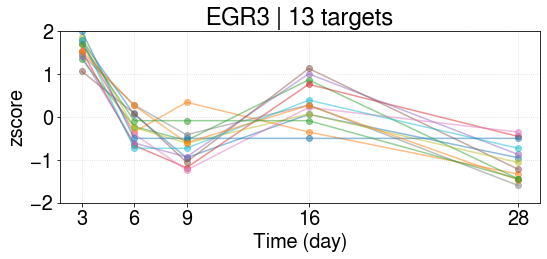

EGR3 | 1 [ 1.61237936 -0.24023582 -0.65450954  0.31481462 -1.03244862]
IGF2
MMP28
IL1R1
ZNF436
SPRY1
SOCS3
JDP2
MAN1C1
CH25H
IFNGR1
MEST
sub ['IGF2', 'MMP28', 'IL1R1', 'ZNF436', 'SPRY1', 'SOCS3', 'JDP2', 'MAN1C1', 'CH25H', 'IFNGR1', 'MEST'] 11


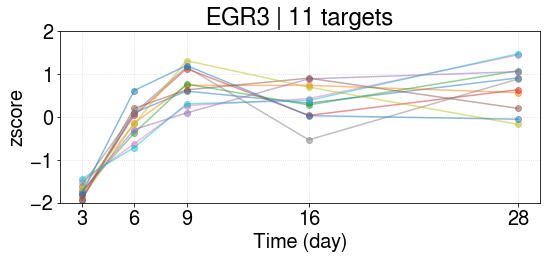

EGR3 | 2 [-1.73145957 -0.11757694  0.74388117  0.37756917  0.72758617]
----------------------------------------------------------
regulon HIF1A 18
['DDIT4', 'PFKP', 'ADM', 'GBE1', 'NT5E', 'ABCA1', 'GPX3', 'AURKA', 'LEP', 'FOXM1', 'TLR4', 'CYGB', 'BIRC5', 'CXCL12', 'ID2', 'ERCC6', 'CDKN1A', 'TUBB3']


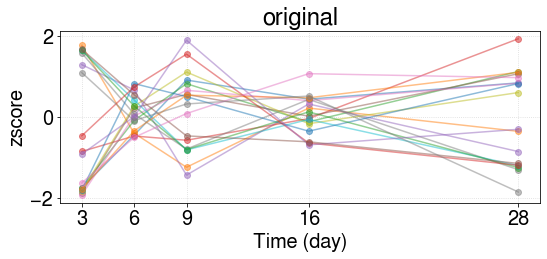

original data shape: (5, 18)
found subregulon: ['PFKP', 'NT5E', 'AURKA', 'FOXM1', 'BIRC5', 'ERCC6'] 6 0.8553806899437624
found subregulon: ['ADM', 'GPX3', 'CYGB', 'DDIT4', 'TLR4', 'TUBB3', 'GBE1'] 7 0.8363911062584387
################################## FINAL
original size: 18; new size 13; lost: 5
PFKP
NT5E
AURKA
FOXM1
BIRC5
ERCC6
sub ['PFKP', 'NT5E', 'AURKA', 'FOXM1', 'BIRC5', 'ERCC6'] 6


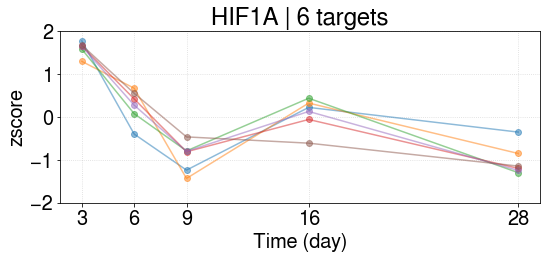

HIF1A | 1 [ 1.60215462  0.26454001 -0.92368818  0.07236252 -1.01536897]
ADM
GPX3
CYGB
DDIT4
TLR4
TUBB3
GBE1
sub ['ADM', 'GPX3', 'CYGB', 'DDIT4', 'TLR4', 'TUBB3', 'GBE1'] 7


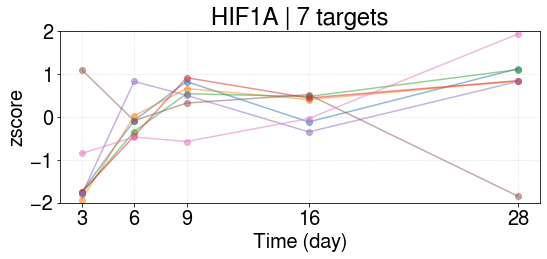

HIF1A | 2 [-1.250271   -0.08281775  0.45507377  0.1904669   0.68754808]
----------------------------------------------------------
regulon ARNTL2 94
['UHRF1', 'PPRC1', 'PELI1', 'EHD4', 'TRIP13', 'GNPNAT1', 'THBS2', 'PFKP', 'FAM83G', 'MCM3', 'ADAMTS14', 'KNL1', 'APOL6', 'PIM1', 'CDKN3', 'FAM89A', 'IFITM3', 'KYNU', 'PLSCR1', 'ACKR1', 'SEC14L2', 'EREG', 'ADAM19', 'TUBA1B', 'PNP', 'LMNB1', 'HYOU1', 'ESPL1', 'SYNJ2', 'CSTA', 'GCH1', 'LRP8', 'TGFBI', 'CDC6', 'TNFRSF1B', 'TNC', 'CDCP1', 'HSPA5', 'RAB27B', 'LBP', 'TEAD4', 'TUBB6', 'TPM3', 'APOL1', 'HMGA1', 'SPRY1', 'SPRED3', 'CSF1', 'WDR4', 'LDLRAD3', 'ESCO2', 'LRRC59', 'CKS2', 'FOSL1', 'UBASH3B', 'PAQR4', 'PTTG1', 'NETO2', 'TUBB2A', 'VWA5A', 'EZH2', 'PLAU', 'ADHFE1', 'CD24', 'SOD2', 'NRCAM', 'CDCA7', 'TOP2A', 'MYO1B', 'RANGAP1', 'SHB', 'MGAT5', 'CHI3L1', 'RCN1', 'SH3BP1', 'LOXL2', 'TUBA1C', 'GJA1', 'CDC7', 'SERPINE2', 'KIF14', 'S100A16', 'ECT2', 'CLSPN', 'RAP1B', 'TIAM1', 'KPNA2', 'CBX7', 'PPL', 'PCSK1', 'NABP1', 'HELLS', 'MKI67', 'FABP5']


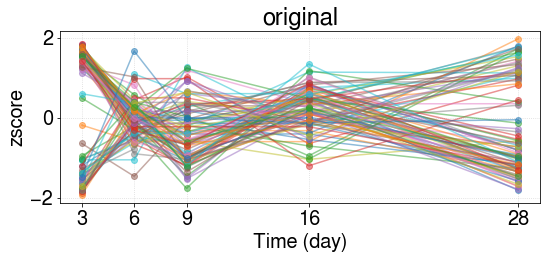

original data shape: (5, 94)
found subregulon: ['UHRF1', 'PPRC1', 'EHD4', 'TRIP13', 'GNPNAT1', 'PFKP', 'FAM83G', 'MCM3', 'ADAMTS14', 'KNL1', 'CDKN3', 'SEC14L2', 'ADAM19', 'TUBA1B', 'PNP', 'LMNB1', 'HYOU1', 'ESPL1', 'SYNJ2', 'LRP8', 'TGFBI', 'CDC6', 'CDCP1', 'HSPA5', 'TEAD4', 'TUBB6', 'TPM3', 'HMGA1', 'SPRED3', 'WDR4', 'ESCO2', 'LRRC59', 'CKS2', 'FOSL1', 'UBASH3B', 'PAQR4', 'PTTG1', 'NETO2', 'TUBB2A', 'VWA5A', 'EZH2', 'CDCA7', 'TOP2A', 'MYO1B', 'RANGAP1', 'SHB', 'MGAT5', 'SH3BP1', 'LOXL2', 'TUBA1C', 'CDC7', 'SERPINE2', 'KIF14', 'S100A16', 'ECT2', 'CLSPN', 'TIAM1', 'KPNA2', 'HELLS', 'MKI67', 'FABP5'] 61 0.8265961918897203
found subregulon: ['PLSCR1', 'FAM89A', 'TNFRSF1B', 'RCN1', 'NRCAM', 'CBX7', 'GJA1', 'SOD2', 'ACKR1', 'RAB27B', 'PLAU', 'GCH1', 'APOL1', 'APOL6', 'PPL', 'SPRY1', 'RAP1B', 'PCSK1', 'CSF1', 'PELI1', 'KYNU', 'PIM1', 'CSTA', 'ADHFE1'] 24 0.8494667824050467
################################## FINAL
original size: 94; new size 85; lost: 9
UHRF1
PPRC1
EHD4
TRIP13
GNPNAT1
PFKP
FA

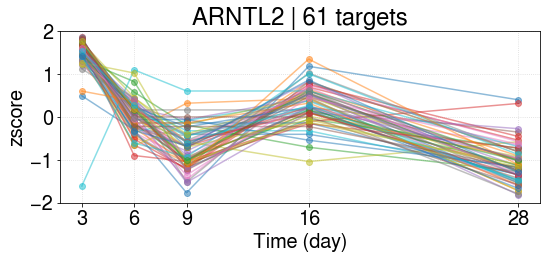

ARNTL2 | 1 [ 1.47450644  0.02398912 -0.72576303  0.31975057 -1.09248309]
PLSCR1
FAM89A
TNFRSF1B
RCN1
NRCAM
CBX7
GJA1
SOD2
ACKR1
RAB27B
PLAU
GCH1
APOL1
APOL6
PPL
SPRY1
RAP1B
PCSK1
CSF1
PELI1
KYNU
PIM1
CSTA
ADHFE1
sub ['PLSCR1', 'FAM89A', 'TNFRSF1B', 'RCN1', 'NRCAM', 'CBX7', 'GJA1', 'SOD2', 'ACKR1', 'RAB27B', 'PLAU', 'GCH1', 'APOL1', 'APOL6', 'PPL', 'SPRY1', 'RAP1B', 'PCSK1', 'CSF1', 'PELI1', 'KYNU', 'PIM1', 'CSTA', 'ADHFE1'] 24


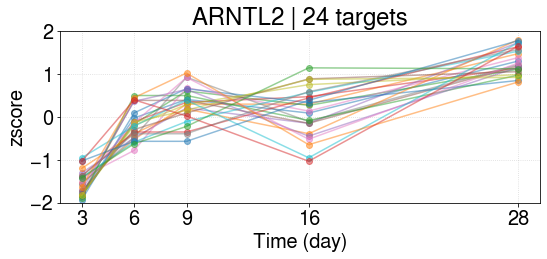

ARNTL2 | 2 [-1.53715094 -0.17804839  0.29434635  0.11482721  1.30602577]
----------------------------------------------------------
regulon HEYL 57
['C1S', 'GRASP', 'SLC7A2', 'SUSD2', 'ANTXR1', 'LATS2', 'S1PR3', 'FOXC2', 'LAMA4', 'ITGA3', 'A2M', 'ATP10A', 'ANGPTL2', 'SNCG', 'C1QTNF1', 'GGT5', 'FBLN2', 'CRLF1', 'GPX3', 'TIMP4', 'NES', 'PAMR1', 'ELN', 'LAMA2', 'SPON1', 'MGP', 'RASD1', 'EPAS1', 'FBLN1', 'TGFBI', 'LMCD1', 'HSD11B1', 'EBF1', 'CRISPLD2', 'AXL', 'KLF9', 'LRRC32', 'SLIT3', 'NRGN', 'FMOD', 'TEAD4', 'IGFBP5', 'MEDAG', 'SRPX', 'CSPG4', 'CNN1', 'TPM1', 'ENPP4', 'PEAR1', 'MFGE8', 'LIMS2', 'FBLN5', 'SMAD6', 'PLPP1', 'PMP22', 'AMIGO2', 'SERPINF1']


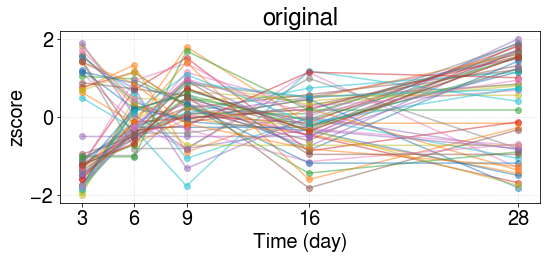

original data shape: (5, 57)
found subregulon: ['ITGA3', 'ATP10A', 'SNCG', 'NES', 'ELN', 'NRGN', 'CSPG4', 'TPM1', 'PEAR1', 'LIMS2', 'FBLN5'] 11 0.8266588496756906
found subregulon: ['SLIT3', 'CRISPLD2', 'SLC7A2', 'EBF1', 'GGT5', 'C1S', 'KLF9', 'C1QTNF1', 'SERPINF1', 'LAMA2', 'GPX3', 'PLPP1', 'TIMP4', 'FBLN2', 'MGP', 'PMP22', 'HSD11B1', 'FBLN1', 'MEDAG', 'EPAS1', 'A2M', 'FMOD', 'ANTXR1', 'ENPP4', 'MFGE8', 'SRPX', 'LMCD1', 'LAMA4', 'CNN1'] 29 0.8392979769520387
################################## FINAL
original size: 57; new size 40; lost: 17
ITGA3
ATP10A
SNCG
NES
ELN
NRGN
CSPG4
TPM1
PEAR1
LIMS2
FBLN5
sub ['ITGA3', 'ATP10A', 'SNCG', 'NES', 'ELN', 'NRGN', 'CSPG4', 'TPM1', 'PEAR1', 'LIMS2', 'FBLN5'] 11


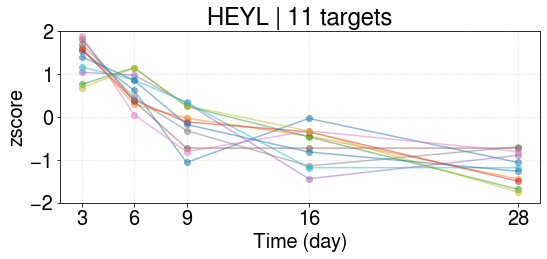

HEYL | 1 [ 1.37937815  0.65028752 -0.18764094 -0.65918225 -1.18284248]
SLIT3
CRISPLD2
SLC7A2
EBF1
GGT5
C1S
KLF9
C1QTNF1
SERPINF1
LAMA2
GPX3
PLPP1
TIMP4
FBLN2
MGP
PMP22
HSD11B1
FBLN1
MEDAG
EPAS1
A2M
FMOD
ANTXR1
ENPP4
MFGE8
SRPX
LMCD1
LAMA4
CNN1
sub ['SLIT3', 'CRISPLD2', 'SLC7A2', 'EBF1', 'GGT5', 'C1S', 'KLF9', 'C1QTNF1', 'SERPINF1', 'LAMA2', 'GPX3', 'PLPP1', 'TIMP4', 'FBLN2', 'MGP', 'PMP22', 'HSD11B1', 'FBLN1', 'MEDAG', 'EPAS1', 'A2M', 'FMOD', 'ANTXR1', 'ENPP4', 'MFGE8', 'SRPX', 'LMCD1', 'LAMA4', 'CNN1'] 29


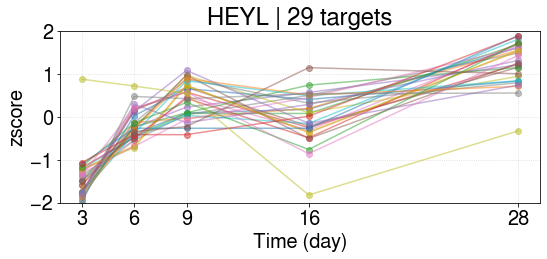

HEYL | 2 [-1.44747154 -0.20400049  0.38901244  0.00226268  1.26019691]
----------------------------------------------------------
regulon NR4A3 17
['CXCL8', 'PPARGC1A', 'GRASP', 'CRISPLD2', 'CYCS', 'DUSP5', 'PPARG', 'S1PR3', 'STARD4', 'DUSP4', 'IL6', 'CDKN1A', 'TIPARP', 'LATS2', 'HBEGF', 'GEM', 'FOSL1']


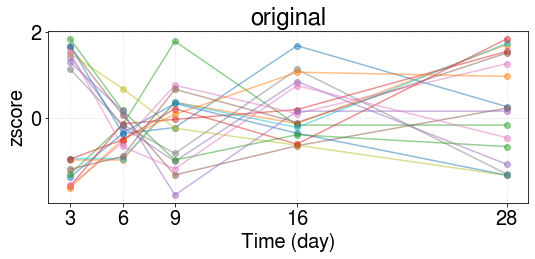

original data shape: (5, 17)
found subregulon: ['CYCS', 'S1PR3', 'TIPARP', 'FOSL1'] 4 0.8366220329500921
found subregulon: ['PPARG', 'GEM', 'CRISPLD2', 'PPARGC1A', 'DUSP4', 'LATS2'] 6 0.8916035644018822
################################## FINAL
original size: 17; new size 10; lost: 7
CYCS
S1PR3
TIPARP
FOSL1
sub ['CYCS', 'S1PR3', 'TIPARP', 'FOSL1'] 4


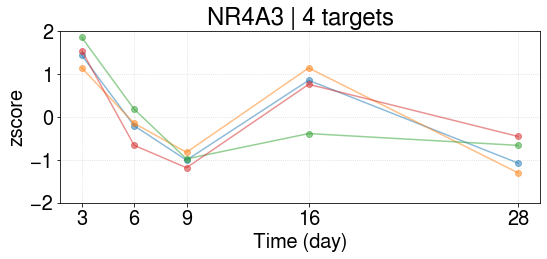

NR4A3 | 1 [ 1.49151869 -0.2093415  -0.99827723  0.59074401 -0.87464398]
PPARG
GEM
CRISPLD2
PPARGC1A
DUSP4
LATS2
sub ['PPARG', 'GEM', 'CRISPLD2', 'PPARGC1A', 'DUSP4', 'LATS2'] 6


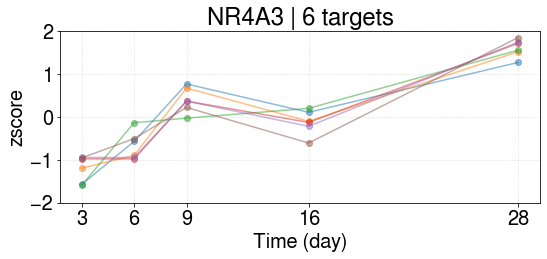

NR4A3 | 2 [-1.20530699 -0.67125131  0.39424798 -0.1253118   1.60762212]
----------------------------------------------------------
regulon ZFHX3 42
['USP53', 'ANGPTL1', 'PTPRM', 'KLF15', 'LATS2', 'SAMHD1', 'YPEL2', 'PTPRG', 'CLMN', 'CDKN1A', 'PAK3', 'FZD4', 'ATP10A', 'PIK3R1', 'CPED1', 'C1QTNF1', 'LAMA2', 'ANTXR2', 'BCL6', 'CORO6', 'GLUL', 'CACNB2', 'AXL', 'DCBLD2', 'ZBTB16', 'MTSS1', 'FBXO32', 'PID1', 'SRPX', 'TGFBR3', 'CSPG4', 'ISM1', 'DTNA', 'ADAMTS5', 'MFGE8', 'FOXO1', 'VIT', 'CNR1', 'PLPP1', 'EPS8', 'ARHGAP6', 'SERPINF1']


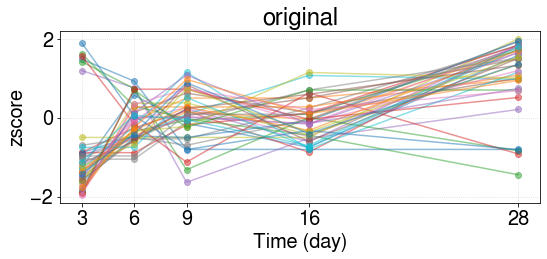

original data shape: (5, 42)
found subregulon: ['USP53', 'KLF15', 'LATS2', 'PTPRG', 'CLMN', 'PIK3R1', 'ANTXR2', 'CORO6', 'GLUL', 'MTSS1', 'PID1', 'TGFBR3', 'CNR1', 'EPS8'] 14 0.8358211879859998
found subregulon: ['FZD4', 'ISM1', 'ZBTB16', 'PTPRM', 'YPEL2', 'LAMA2', 'C1QTNF1', 'ARHGAP6', 'FOXO1', 'PLPP1', 'SAMHD1', 'BCL6', 'ANGPTL1', 'SERPINF1', 'ATP10A', 'CSPG4', 'DCBLD2', 'AXL', 'PAK3', 'CPED1', 'ADAMTS5', 'DTNA', 'VIT', 'MFGE8', 'SRPX', 'CDKN1A', 'CACNB2'] 27 0.8321505370645399
################################## FINAL
original size: 42; new size 41; lost: 1
USP53
KLF15
LATS2
PTPRG
CLMN
PIK3R1
ANTXR2
CORO6
GLUL
MTSS1
PID1
TGFBR3
CNR1
EPS8
sub ['USP53', 'KLF15', 'LATS2', 'PTPRG', 'CLMN', 'PIK3R1', 'ANTXR2', 'CORO6', 'GLUL', 'MTSS1', 'PID1', 'TGFBR3', 'CNR1', 'EPS8'] 14


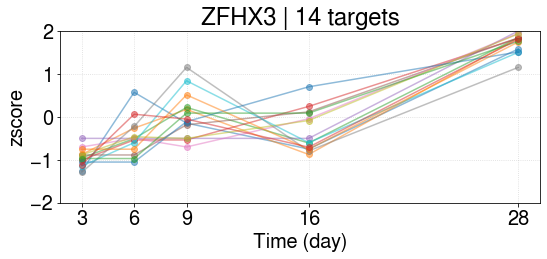

ZFHX3 | 1 [-0.9563149  -0.47203103  0.01879582 -0.32561111  1.73516123]
FZD4
ISM1
ZBTB16
PTPRM
YPEL2
LAMA2
C1QTNF1
ARHGAP6
FOXO1
PLPP1
SAMHD1
BCL6
ANGPTL1
SERPINF1
ATP10A
CSPG4
DCBLD2
AXL
PAK3
CPED1
ADAMTS5
DTNA
VIT
MFGE8
SRPX
CDKN1A
CACNB2
sub ['FZD4', 'ISM1', 'ZBTB16', 'PTPRM', 'YPEL2', 'LAMA2', 'C1QTNF1', 'ARHGAP6', 'FOXO1', 'PLPP1', 'SAMHD1', 'BCL6', 'ANGPTL1', 'SERPINF1', 'ATP10A', 'CSPG4', 'DCBLD2', 'AXL', 'PAK3', 'CPED1', 'ADAMTS5', 'DTNA', 'VIT', 'MFGE8', 'SRPX', 'CDKN1A', 'CACNB2'] 27


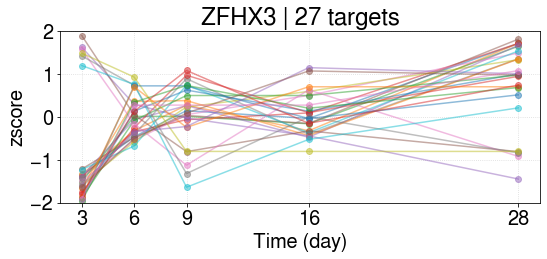

ZFHX3 | 2 [-0.91069988  0.00819727  0.06494883  0.04845481  0.78909897]
----------------------------------------------------------
regulon ATOH8 61
['ZCCHC24', 'SVEP1', 'PTPRM', 'CCDC68', 'EPHB6', 'KLF15', 'MMP28', 'PPARG', 'TLE2', 'FOXC2', 'PDK4', 'SAMHD1', 'SMAD6', 'TFPI', 'PTH1R', 'GALNT15', 'FZD4', 'C1QTNF1', 'GGT5', 'GPX3', 'TIMP4', 'ADH1B', 'ELN', 'LAMA2', 'EPAS1', 'SERPING1', 'ANTXR2', 'CEBPB', 'LMCD1', 'TXNIP', 'CORO6', 'RGCC', 'AXL', 'APOL3', 'TSC22D3', 'CDKN1C', 'CALCOCO2', 'ABCA9', 'ZBTB16', 'CNR1', 'MEDAG', 'SRPX', 'CSPG4', 'CBX7', 'RASL11A', 'DTNA', 'ADAMTS5', 'UGP2', 'PEAR1', 'MFGE8', 'FOXO1', 'ID1', 'RASL11B', 'LIMS2', 'FBLN5', 'VIT', 'TOX2', 'INHBB', 'GINS1', 'PLPP1', 'SERPINF1']


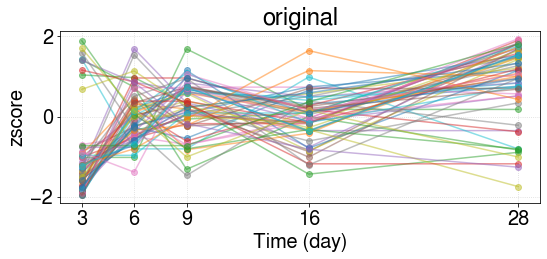

original data shape: (5, 61)
found subregulon: ['AXL', 'CSPG4', 'FBLN5', 'GINS1'] 4 0.835886726453738
found subregulon: ['ADH1B', 'SAMHD1', 'ZBTB16', 'CBX7', 'PPARG', 'SERPING1', 'SVEP1', 'GGT5', 'FZD4', 'CEBPB', 'PTPRM', 'SERPINF1', 'GPX3', 'GALNT15', 'C1QTNF1', 'FOXO1', 'ZCCHC24', 'LAMA2', 'LMCD1', 'TXNIP', 'PLPP1', 'TIMP4', 'VIT', 'TSC22D3', 'MFGE8', 'MEDAG', 'TFPI', 'EPAS1', 'CDKN1C', 'ADAMTS5', 'CCDC68', 'RASL11A', 'PDK4', 'CORO6', 'CALCOCO2', 'MMP28', 'KLF15', 'DTNA', 'INHBB', 'CNR1'] 40 0.8259531754075772
################################## FINAL
original size: 61; new size 44; lost: 17
AXL
CSPG4
FBLN5
GINS1
sub ['AXL', 'CSPG4', 'FBLN5', 'GINS1'] 4


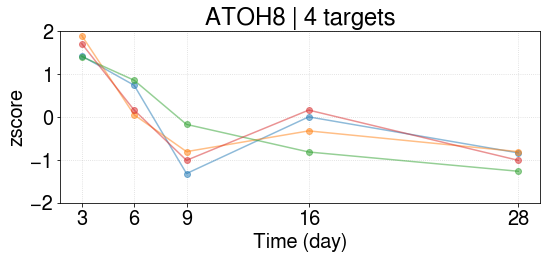

ATOH8 | 1 [ 1.60543703  0.44939218 -0.82825106 -0.24584299 -0.98073517]
ADH1B
SAMHD1
ZBTB16
CBX7
PPARG
SERPING1
SVEP1
GGT5
FZD4
CEBPB
PTPRM
SERPINF1
GPX3
GALNT15
C1QTNF1
FOXO1
ZCCHC24
LAMA2
LMCD1
TXNIP
PLPP1
TIMP4
VIT
TSC22D3
MFGE8
MEDAG
TFPI
EPAS1
CDKN1C
ADAMTS5
CCDC68
RASL11A
PDK4
CORO6
CALCOCO2
MMP28
KLF15
DTNA
INHBB
CNR1
sub ['ADH1B', 'SAMHD1', 'ZBTB16', 'CBX7', 'PPARG', 'SERPING1', 'SVEP1', 'GGT5', 'FZD4', 'CEBPB', 'PTPRM', 'SERPINF1', 'GPX3', 'GALNT15', 'C1QTNF1', 'FOXO1', 'ZCCHC24', 'LAMA2', 'LMCD1', 'TXNIP', 'PLPP1', 'TIMP4', 'VIT', 'TSC22D3', 'MFGE8', 'MEDAG', 'TFPI', 'EPAS1', 'CDKN1C', 'ADAMTS5', 'CCDC68', 'RASL11A', 'PDK4', 'CORO6', 'CALCOCO2', 'MMP28', 'KLF15', 'DTNA', 'INHBB', 'CNR1'] 40


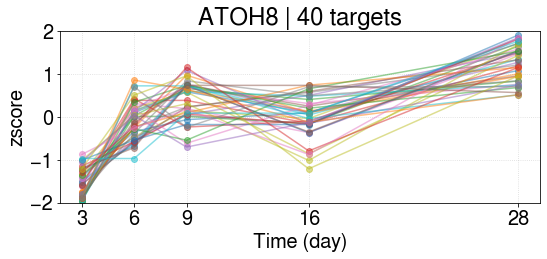

ATOH8 | 2 [-1.53988451 -0.09328032  0.36726041  0.00904069  1.25686372]
----------------------------------------------------------
regulon TRPS1 26
['IL7', 'RAB31', 'EFEMP1', 'ANTXR1', 'OLFML2B', 'PLXDC2', 'ARMC9', 'SLC12A8', 'RUNX2', 'GJA1', 'ARSJ', 'ABI3BP', 'MMP16', 'CNTNAP1', 'VWA5A', 'GLIPR1', 'SLC9A9', 'EPHB2', 'DUSP10', 'LRRK2', 'GBP2', 'F2RL2', 'ROR2', 'KYNU', 'SESN3', 'LDLRAD3']


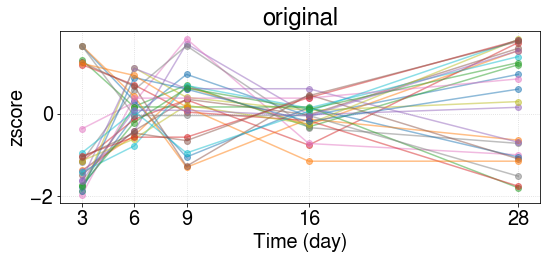

original data shape: (5, 26)
found subregulon: ['ARSJ', 'MMP16', 'CNTNAP1', 'GLIPR1', 'EPHB2'] 5 0.8540914091871797
found subregulon: ['PLXDC2', 'IL7', 'SESN3', 'EFEMP1', 'GJA1', 'RAB31', 'SLC9A9', 'DUSP10', 'GBP2', 'KYNU', 'OLFML2B', 'LDLRAD3'] 12 0.8235688226550085
################################## FINAL
original size: 26; new size 17; lost: 9
ARSJ
MMP16
CNTNAP1
GLIPR1
EPHB2
sub ['ARSJ', 'MMP16', 'CNTNAP1', 'GLIPR1', 'EPHB2'] 5


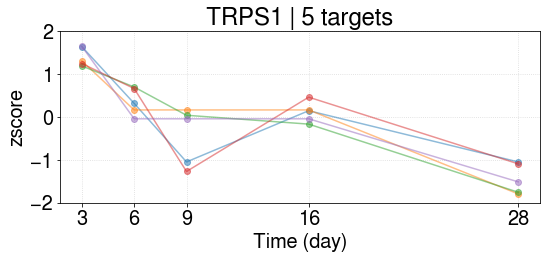

TRPS1 | 1 [ 1.40376862  0.35812061 -0.43252826  0.11072106 -1.44008203]
PLXDC2
IL7
SESN3
EFEMP1
GJA1
RAB31
SLC9A9
DUSP10
GBP2
KYNU
OLFML2B
LDLRAD3
sub ['PLXDC2', 'IL7', 'SESN3', 'EFEMP1', 'GJA1', 'RAB31', 'SLC9A9', 'DUSP10', 'GBP2', 'KYNU', 'OLFML2B', 'LDLRAD3'] 12


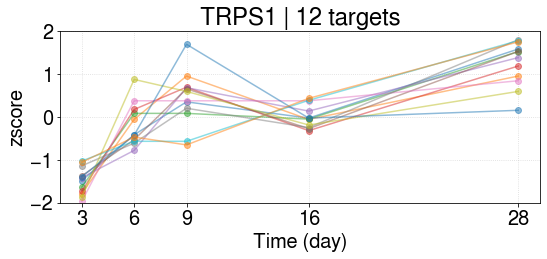

TRPS1 | 2 [-1.48963362 -0.19626454  0.42071007  0.01115883  1.25402925]
----------------------------------------------------------
regulon ARID5A 72
['FGF7', 'C1S', 'SECTM1', 'MAP3K8', 'GRASP', 'DUSP5', 'C21orf58', 'CHRDL1', 'CEBPD', 'ADAM19', 'IL6', 'SMTN', 'VCAM1', 'KDM7A', 'CDKN1A', 'FOSL1', 'CXCL2', 'SYNJ2', 'PELI1', 'RARRES2', 'CH25H', 'BTG1', 'RHOQ', 'PCMTD1', 'FMO2', 'IL3RA', 'SOCS3', 'TRIM46', 'PRRX2', 'GCH1', 'ARHGAP11B', 'AKR1C3', 'POSTN', 'TNFRSF10D', 'GYPC', 'HLA-F', 'SAT1', 'CEBPB', 'ABI3BP', 'LMCD1', 'HCFC1R1', 'NEDD9', 'TNFRSF1B', 'CXCL8', 'ADM', 'PNRC1', 'GGT1', 'KLHL24', 'IL1R2', 'LRRC32', 'VGLL4', 'GDF15', 'PXN', 'ABCA9', 'RAP1B', 'GBP2', 'PKIG', 'CENPW', 'GPR89A', 'DNAJC6', 'PIM1', 'OXTR', 'MTFR2', 'RHBDF2', 'CFI', 'IFITM3', 'SPRY1', 'CSF1', 'PLSCR1', 'ACKR1', 'EPS8', 'GEM']


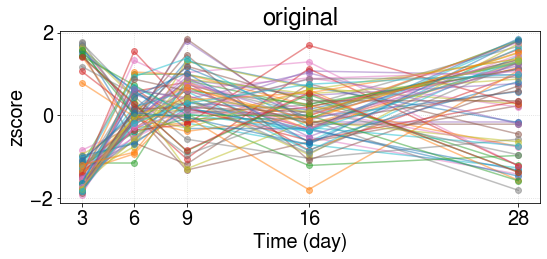

original data shape: (5, 72)
found subregulon: ['C21orf58', 'ADAM19', 'IL6', 'SMTN', 'SYNJ2', 'TRIM46', 'ARHGAP11B', 'ABI3BP', 'PXN', 'CENPW', 'MTFR2', 'RHBDF2'] 12 0.8387741350361522
found subregulon: ['EPS8', 'NEDD9', 'PELI1', 'VGLL4'] 4 0.8798688714370307
found subregulon: ['ADM', 'PLSCR1', 'C1S', 'FGF7', 'BTG1', 'PNRC1', 'GYPC', 'PKIG', 'CEBPB', 'ACKR1', 'CEBPD', 'HCFC1R1', 'IL1R2', 'RAP1B', 'FMO2', 'KDM7A', 'IFITM3', 'CSF1', 'SPRY1', 'PIM1', 'GBP2', 'GDF15', 'PCMTD1', 'GEM', 'SOCS3', 'LMCD1', 'PRRX2', 'MAP3K8', 'CDKN1A', 'DNAJC6', 'VCAM1'] 31 0.8462125676887423
################################## FINAL
original size: 72; new size 47; lost: 25
C21orf58
ADAM19
IL6
SMTN
SYNJ2
TRIM46
ARHGAP11B
ABI3BP
PXN
CENPW
MTFR2
RHBDF2
sub ['C21orf58', 'ADAM19', 'IL6', 'SMTN', 'SYNJ2', 'TRIM46', 'ARHGAP11B', 'ABI3BP', 'PXN', 'CENPW', 'MTFR2', 'RHBDF2'] 12


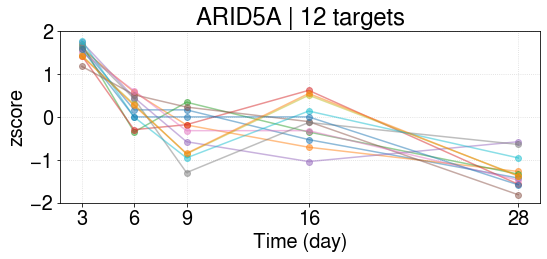

ARID5A | 1 [ 1.55129472  0.21972886 -0.37460097 -0.11529946 -1.28112316]
EPS8
NEDD9
PELI1
VGLL4
sub ['EPS8', 'NEDD9', 'PELI1', 'VGLL4'] 4


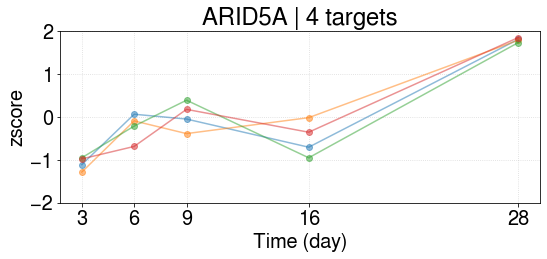

ARID5A | 2 [-1.08199375 -0.23319623  0.03127046 -0.50785665  1.79177617]
ADM
PLSCR1
C1S
FGF7
BTG1
PNRC1
GYPC
PKIG
CEBPB
ACKR1
CEBPD
HCFC1R1
IL1R2
RAP1B
FMO2
KDM7A
IFITM3
CSF1
SPRY1
PIM1
GBP2
GDF15
PCMTD1
GEM
SOCS3
LMCD1
PRRX2
MAP3K8
CDKN1A
DNAJC6
VCAM1
sub ['ADM', 'PLSCR1', 'C1S', 'FGF7', 'BTG1', 'PNRC1', 'GYPC', 'PKIG', 'CEBPB', 'ACKR1', 'CEBPD', 'HCFC1R1', 'IL1R2', 'RAP1B', 'FMO2', 'KDM7A', 'IFITM3', 'CSF1', 'SPRY1', 'PIM1', 'GBP2', 'GDF15', 'PCMTD1', 'GEM', 'SOCS3', 'LMCD1', 'PRRX2', 'MAP3K8', 'CDKN1A', 'DNAJC6', 'VCAM1'] 31


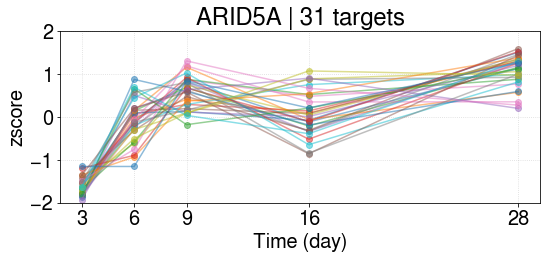

ARID5A | 3 [-1.64601033 -0.08250739  0.56663152  0.0905031   1.0713831 ]
----------------------------------------------------------
regulon ETV7 38
['FGF7', 'SECTM1', 'DOCK10', 'PAFAH1B3', 'IL7', 'KLF15', 'VCAM1', 'SH3BP1', 'LMNB1', 'CXCL2', 'CH25H', 'TSPAN15', 'GCH1', 'GJA1', 'FAM20A', 'HLA-F', 'CDC7', 'PTGES', 'STIL', 'CXCL8', 'ADAMTS14', 'BST2', 'IFITM1', 'VWA5A', 'NRGN', 'GDF15', 'CXCL12', 'GBP2', 'EZH2', 'APOL6', 'PLAU', 'PIM1', 'APOL1', 'CCDC69', 'CDKN3', 'MAOA', 'HELLS', 'PLSCR1']


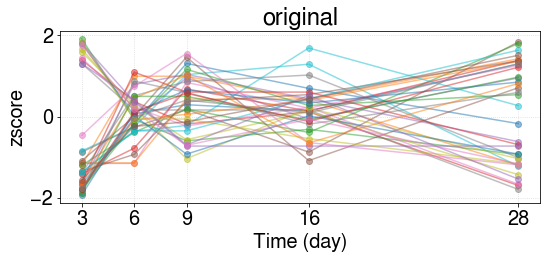

original data shape: (5, 38)
found subregulon: ['DOCK10', 'PAFAH1B3', 'SH3BP1', 'LMNB1', 'CDC7', 'STIL', 'ADAMTS14', 'NRGN', 'EZH2', 'CDKN3', 'HELLS'] 11 0.8363350019902265
found subregulon: ['GCH1', 'VCAM1', 'APOL6', 'TSPAN15'] 4 0.8702814494317643
found subregulon: ['IL7', 'CCDC69', 'APOL1', 'PLSCR1', 'IFITM1', 'FGF7', 'GBP2', 'BST2', 'CH25H', 'PIM1'] 10 0.895349934692991
################################## FINAL
original size: 38; new size 25; lost: 13
DOCK10
PAFAH1B3
SH3BP1
LMNB1
CDC7
STIL
ADAMTS14
NRGN
EZH2
CDKN3
HELLS
sub ['DOCK10', 'PAFAH1B3', 'SH3BP1', 'LMNB1', 'CDC7', 'STIL', 'ADAMTS14', 'NRGN', 'EZH2', 'CDKN3', 'HELLS'] 11


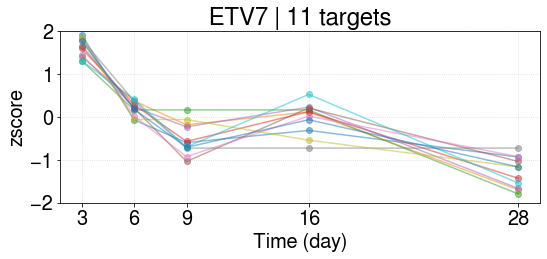

ETV7 | 1 [ 1.62092812  0.19047598 -0.50744644 -0.02491183 -1.27904583]
GCH1
VCAM1
APOL6
TSPAN15
sub ['GCH1', 'VCAM1', 'APOL6', 'TSPAN15'] 4


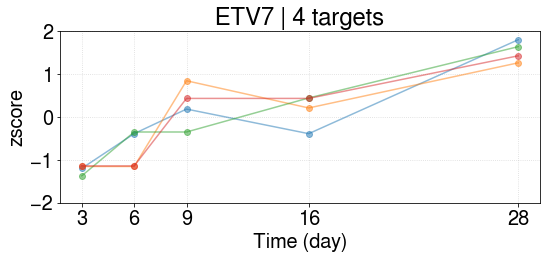

ETV7 | 2 [-1.21656935 -0.75944779  0.27565294  0.1721783   1.52818591]
IL7
CCDC69
APOL1
PLSCR1
IFITM1
FGF7
GBP2
BST2
CH25H
PIM1
sub ['IL7', 'CCDC69', 'APOL1', 'PLSCR1', 'IFITM1', 'FGF7', 'GBP2', 'BST2', 'CH25H', 'PIM1'] 10


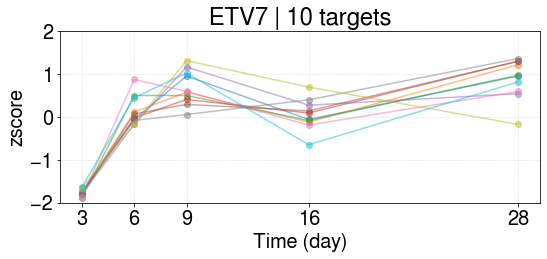

ETV7 | 3 [-1.77079054  0.14837012  0.68649184  0.04959555  0.88633303]
----------------------------------------------------------
regulon GLI1 14
['TSC22D1', 'GLI2', 'HHIP', 'IL1R2', 'PDGFRA', 'H19', 'SLC19A1', 'SFRP1', 'SLIT2', 'MMP13', 'MTSS1', 'PLTP', 'ALCAM', 'CCND2']


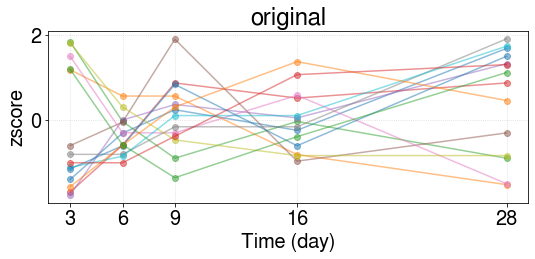

original data shape: (5, 14)
found subregulon: ['PDGFRA', 'TSC22D1', 'IL1R2', 'MMP13', 'MTSS1', 'SFRP1'] 6 0.850822400444099
################################## FINAL
original size: 14; new size 6; lost: 8
PDGFRA
TSC22D1
IL1R2
MMP13
MTSS1
SFRP1
sub ['PDGFRA', 'TSC22D1', 'IL1R2', 'MMP13', 'MTSS1', 'SFRP1'] 6


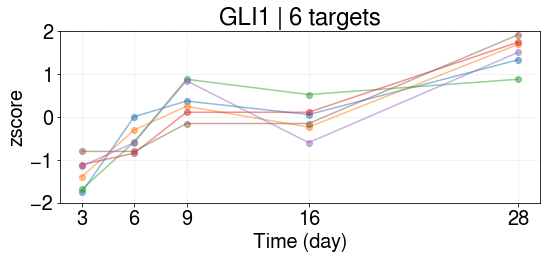

GLI1 | 1 [-1.31637882 -0.52235022  0.38130575 -0.05125549  1.50867879]
----------------------------------------------------------
regulon CXXC4 41
['BCL2L11', 'GCHFR', 'NRCAM', 'CILP2', 'ZNF503', 'NFKBIZ', 'SAMD11', 'SMAD6', 'ID2', 'PTPRG', 'RCN1', 'RGMB', 'TSC22D1', 'PIK3R1', 'SESN1', 'CCNG2', 'TUBA1C', 'ADAMTSL4', 'ANTXR2', 'PNRC1', 'IGF2BP3', 'CALM1', 'TSC22D3', 'VGLL4', 'SLIT2', 'GAS5', 'TIAM1', 'TIPARP', 'STMN1', 'HMGA2', 'DNAJC6', 'KIF26B', 'TYMS', 'KIAA1217', 'PKMYT1', 'ROR2', 'SPRY1', 'SESN3', 'GAS1', 'SOD2', 'WRAP53']


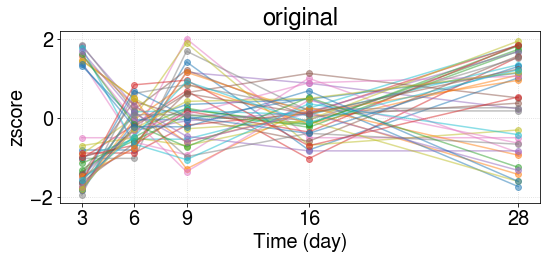

original data shape: (5, 41)
found subregulon: ['RGMB', 'TUBA1C', 'IGF2BP3', 'CALM1', 'TIAM1', 'TIPARP', 'STMN1', 'HMGA2', 'TYMS', 'PKMYT1', 'WRAP53'] 11 0.8573881738829451
found subregulon: ['TSC22D1', 'GAS1', 'SESN3', 'PNRC1', 'SOD2', 'NRCAM', 'RCN1', 'SESN1', 'GCHFR', 'TSC22D3', 'KIF26B', 'SPRY1', 'VGLL4', 'CCNG2', 'NFKBIZ', 'PIK3R1', 'DNAJC6', 'GAS5', 'CILP2', 'ZNF503', 'PTPRG'] 21 0.8249983736800803
################################## FINAL
original size: 41; new size 32; lost: 9
RGMB
TUBA1C
IGF2BP3
CALM1
TIAM1
TIPARP
STMN1
HMGA2
TYMS
PKMYT1
WRAP53
sub ['RGMB', 'TUBA1C', 'IGF2BP3', 'CALM1', 'TIAM1', 'TIPARP', 'STMN1', 'HMGA2', 'TYMS', 'PKMYT1', 'WRAP53'] 11


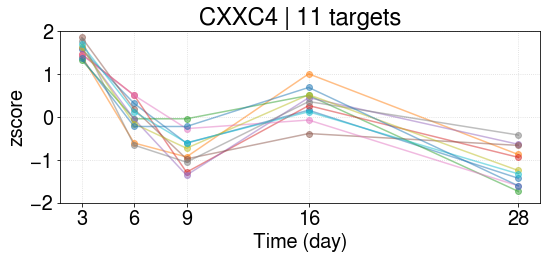

CXXC4 | 1 [ 1.55476015 -0.01093133 -0.73576391  0.32629223 -1.13435713]
TSC22D1
GAS1
SESN3
PNRC1
SOD2
NRCAM
RCN1
SESN1
GCHFR
TSC22D3
KIF26B
SPRY1
VGLL4
CCNG2
NFKBIZ
PIK3R1
DNAJC6
GAS5
CILP2
ZNF503
PTPRG
sub ['TSC22D1', 'GAS1', 'SESN3', 'PNRC1', 'SOD2', 'NRCAM', 'RCN1', 'SESN1', 'GCHFR', 'TSC22D3', 'KIF26B', 'SPRY1', 'VGLL4', 'CCNG2', 'NFKBIZ', 'PIK3R1', 'DNAJC6', 'GAS5', 'CILP2', 'ZNF503', 'PTPRG'] 21


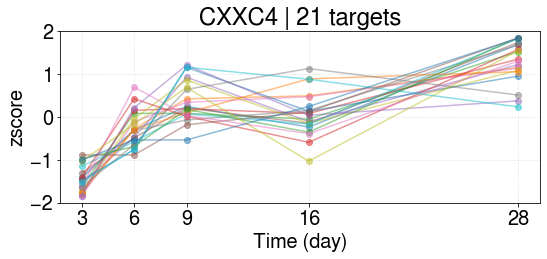

CXXC4 | 2 [-1.46325564 -0.27498628  0.3670359   0.06534649  1.30585953]
----------------------------------------------------------
regulon PRDM16 44
['LPCAT4', 'PDE1A', 'SUSD2', 'EYA2', 'B4GALNT1', 'FOXC2', 'ADAMTS10', 'SMTN', 'ITGA3', 'CADM3', 'PAK3', 'ATP10A', 'COL4A3', 'SNCG', 'DDR2', 'KCNMA1', 'NES', 'ACSS3', 'NUDT4', 'ELN', 'AK5', 'ABI3BP', 'CLEC3B', 'GPC6', 'EBF1', 'NRGN', 'NTM', 'TOX', 'PCDH10', 'HMGA2', 'MLPH', 'ALCAM', 'B4GALNT4', 'ACSS1', 'PLD5', 'CSPG4', 'CNN1', 'PEAR1', 'MYLK', 'INSC', 'LIMS2', 'COL21A1', 'PMP22', 'AMIGO2']


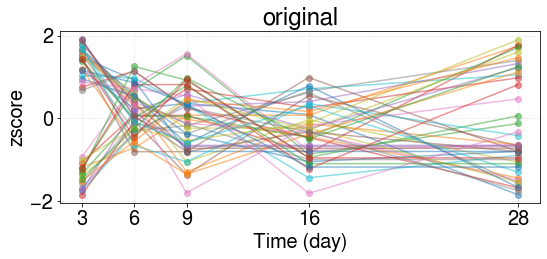

original data shape: (5, 44)
found subregulon: ['LPCAT4', 'B4GALNT1', 'ITGA3', 'PAK3', 'ATP10A', 'NES', 'ELN', 'AK5', 'ABI3BP', 'NRGN', 'TOX', 'PCDH10', 'B4GALNT4', 'PLD5', 'CSPG4', 'INSC', 'LIMS2'] 17 0.8290670473203008
found subregulon: ['FOXC2', 'HMGA2', 'KCNMA1', 'SMTN'] 4 0.8498529671224982
found subregulon: ['DDR2', 'NUDT4', 'EBF1', 'PDE1A', 'GPC6', 'COL4A3', 'CADM3', 'PEAR1', 'ACSS3', 'PMP22'] 10 0.8801101654300442
################################## FINAL
original size: 44; new size 31; lost: 13
LPCAT4
B4GALNT1
ITGA3
PAK3
ATP10A
NES
ELN
AK5
ABI3BP
NRGN
TOX
PCDH10
B4GALNT4
PLD5
CSPG4
INSC
LIMS2
sub ['LPCAT4', 'B4GALNT1', 'ITGA3', 'PAK3', 'ATP10A', 'NES', 'ELN', 'AK5', 'ABI3BP', 'NRGN', 'TOX', 'PCDH10', 'B4GALNT4', 'PLD5', 'CSPG4', 'INSC', 'LIMS2'] 17


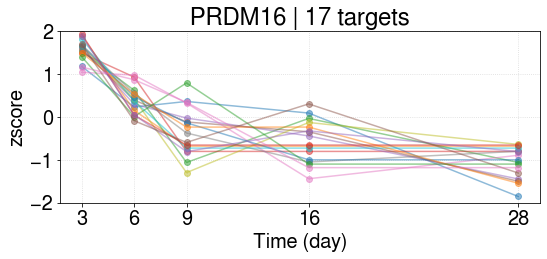

PRDM16 | 1 [ 1.56903049  0.3997652  -0.33597806 -0.57417239 -1.05864525]
FOXC2
HMGA2
KCNMA1
SMTN
sub ['FOXC2', 'HMGA2', 'KCNMA1', 'SMTN'] 4


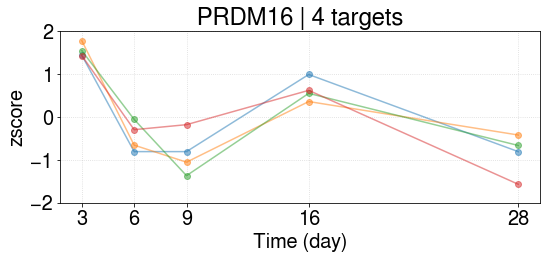

PRDM16 | 2 [ 1.54587666 -0.45532172 -0.85286209  0.62790395 -0.86559679]
DDR2
NUDT4
EBF1
PDE1A
GPC6
COL4A3
CADM3
PEAR1
ACSS3
PMP22
sub ['DDR2', 'NUDT4', 'EBF1', 'PDE1A', 'GPC6', 'COL4A3', 'CADM3', 'PEAR1', 'ACSS3', 'PMP22'] 10


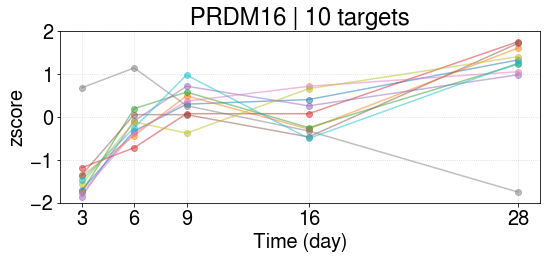

PRDM16 | 3 [-1.33372041 -0.09384911  0.34283822  0.02742798  1.05730331]
----------------------------------------------------------
regulon RFX8 19
['TRAPPC6A', 'CHAF1B', 'LAMA4', 'PAK3', 'PRRX2', 'LRRC17', 'KIAA1755', 'PTGES', 'THBS2', 'ADAMTS14', 'CYGB', 'HMGA2', 'LSP1', 'EME1', 'ZNF469', 'PARPBP', 'SLC17A9', 'LUM', 'SEC14L2']


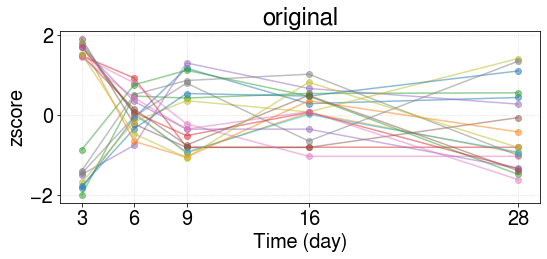

original data shape: (5, 19)
found subregulon: ['CHAF1B', 'PAK3', 'LRRC17', 'ADAMTS14', 'HMGA2', 'EME1', 'ZNF469', 'PARPBP', 'SLC17A9', 'SEC14L2'] 10 0.8401091137846401
################################## FINAL
original size: 19; new size 10; lost: 9
CHAF1B
PAK3
LRRC17
ADAMTS14
HMGA2
EME1
ZNF469
PARPBP
SLC17A9
SEC14L2
sub ['CHAF1B', 'PAK3', 'LRRC17', 'ADAMTS14', 'HMGA2', 'EME1', 'ZNF469', 'PARPBP', 'SLC17A9', 'SEC14L2'] 10


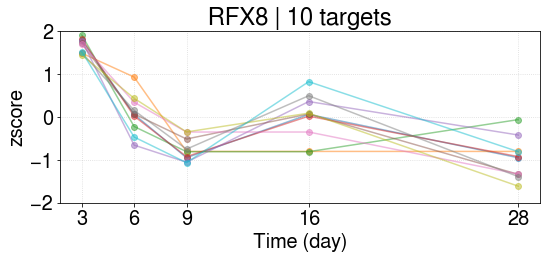

RFX8 | 1 [ 1.66328577  0.06483404 -0.75765853 -0.00618723 -0.96427405]
----------------------------------------------------------
regulon MYCN 6
['MCM8', 'MCM3', 'NDRG1', 'NES', 'MCM5', 'MCM2']


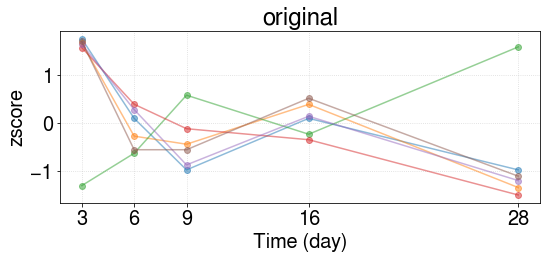

original data shape: (5, 6)
found subregulon: ['MCM8', 'MCM3', 'NES', 'MCM5', 'MCM2'] 5 0.9240963034545889
################################## FINAL
original size: 6; new size 5; lost: 1
MCM8
MCM3
NES
MCM5
MCM2
sub ['MCM8', 'MCM3', 'NES', 'MCM5', 'MCM2'] 5


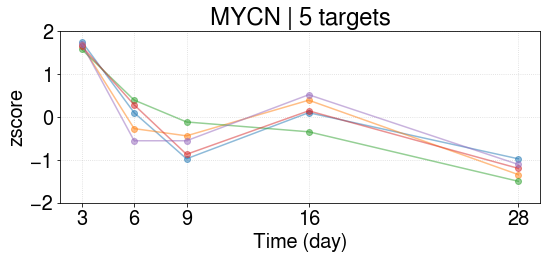

MYCN | 1 [ 1.66782056 -0.01144807 -0.59204635  0.15952028 -1.22384642]
----------------------------------------------------------
regulon E2F4 65
['BRCA1', 'CDC25C', 'TK1', 'RBL1', 'CDCA7', 'RFC3', 'TOP2A', 'PPARG', 'MCM5', 'E2F1', 'MCM10', 'E2F8', 'CREG1', 'THOP1', 'CDC25A', 'CKS2', 'HMMR', 'PLK4', 'RRM1', 'MAD2L1', 'CENPO', 'MYBL2', 'FBXO5', 'EPAS1', 'SMC2', 'NUSAP1', 'CDC6', 'CDT1', 'TTK', 'DBF4', 'PLK1', 'CDK1', 'MCM3', 'CALM1', 'AURKB', 'PRIM2', 'FOXM1', 'TMPO', 'PRC1', 'NDC80', 'WDR76', 'STMN1', 'ANLN', 'RAD54L', 'CENPE', 'MCM8', 'RAD51', 'CDC45', 'TYMS', 'CCNB1', 'FST', 'NEK2', 'POLA2', 'SUV39H1', 'ASF1B', 'MAP3K5', 'BIRC5', 'PRR11', 'ORC1', 'UBE2C', 'MKI67', 'PLSCR1', 'GINS1', 'XRCC2', 'FEN1']


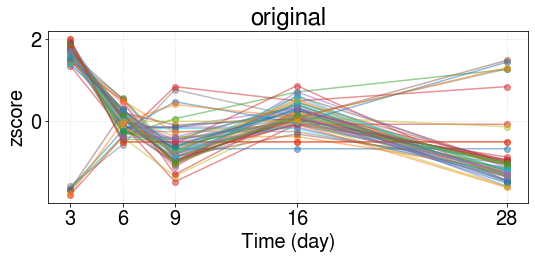

original data shape: (5, 65)
found subregulon: ['BRCA1', 'CDC25C', 'TK1', 'RBL1', 'CDCA7', 'RFC3', 'TOP2A', 'PPARG', 'MCM5', 'E2F1', 'MCM10', 'E2F8', 'CREG1', 'THOP1', 'CDC25A', 'CKS2', 'HMMR', 'PLK4', 'RRM1', 'MAD2L1', 'CENPO', 'MYBL2', 'FBXO5', 'EPAS1', 'SMC2', 'NUSAP1', 'CDC6', 'CDT1', 'TTK', 'DBF4', 'PLK1', 'CDK1', 'MCM3', 'CALM1', 'AURKB', 'PRIM2', 'FOXM1', 'TMPO', 'PRC1', 'NDC80', 'WDR76', 'STMN1', 'ANLN', 'RAD54L', 'CENPE', 'MCM8', 'RAD51', 'CDC45', 'TYMS', 'CCNB1', 'FST', 'NEK2', 'POLA2', 'SUV39H1', 'ASF1B', 'MAP3K5', 'BIRC5', 'PRR11', 'ORC1', 'UBE2C', 'MKI67', 'GINS1', 'XRCC2', 'FEN1'] 64 0.9276179223089775
################################## FINAL
original size: 65; new size 64; lost: 1
BRCA1
CDC25C
TK1
RBL1
CDCA7
RFC3
TOP2A
PPARG
MCM5
E2F1
MCM10
E2F8
CREG1
THOP1
CDC25A
CKS2
HMMR
PLK4
RRM1
MAD2L1
CENPO
MYBL2
FBXO5
EPAS1
SMC2
NUSAP1
CDC6
CDT1
TTK
DBF4
PLK1
CDK1
MCM3
CALM1
AURKB
PRIM2
FOXM1
TMPO
PRC1
NDC80
WDR76
STMN1
ANLN
RAD54L
CENPE
MCM8
RAD51
CDC45
TYMS
CCNB1
FST
NEK2
POLA2


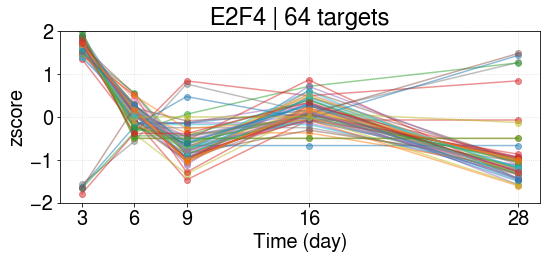

E2F4 | 1 [ 1.41551845  0.02567822 -0.63380542  0.14427529 -0.95166652]
----------------------------------------------------------
regulon STAT3 14
['FOS', 'PIM1', 'SOCS3', 'CYP19A1', 'CHI3L1', 'IL6', 'BIRC5', 'BCL6', 'SAA1', 'LBP', 'CDKN1A', 'KLF11', 'A2M', 'CCND2']


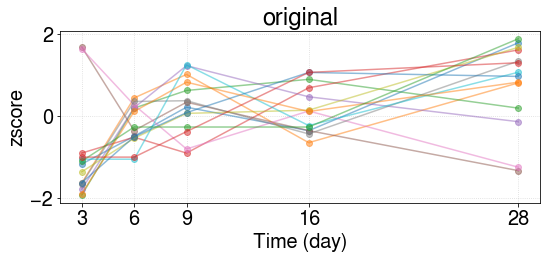

original data shape: (5, 14)
found subregulon: ['KLF11', 'FOS', 'BCL6', 'CDKN1A', 'LBP'] 5 0.8273666483449302
################################## FINAL
original size: 14; new size 5; lost: 9
KLF11
FOS
BCL6
CDKN1A
LBP
sub ['KLF11', 'FOS', 'BCL6', 'CDKN1A', 'LBP'] 5


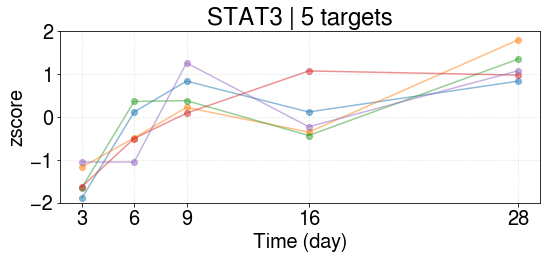

STAT3 | 1 [-1.47893634 -0.31391431  0.55517595  0.03380683  1.20386786]
----------------------------------------------------------
regulon CSRNP1 25
['FOS', 'GRASP', 'MAP3K8', 'BTG2', 'DUSP5', 'CEBPD', 'NFKBIZ', 'IL6', 'CDKN1A', 'FOSL1', 'PELI1', 'SOCS3', 'TNFRSF10D', 'RASD1', 'SAT1', 'CEBPB', 'NEDD9', 'PNRC1', 'KLF9', 'TIPARP', 'HBEGF', 'PIM1', 'KLF11', 'LATS2', 'GEM']


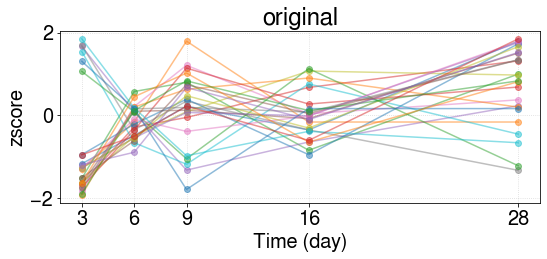

original data shape: (5, 25)
found subregulon: ['CEBPB', 'PNRC1', 'KLF9', 'KLF11', 'FOS', 'GEM', 'RASD1', 'SAT1', 'PIM1', 'BTG2', 'MAP3K8', 'NEDD9', 'NFKBIZ', 'LATS2', 'CDKN1A', 'PELI1'] 16 0.8276760903747171
################################## FINAL
original size: 25; new size 16; lost: 9
CEBPB
PNRC1
KLF9
KLF11
FOS
GEM
RASD1
SAT1
PIM1
BTG2
MAP3K8
NEDD9
NFKBIZ
LATS2
CDKN1A
PELI1
sub ['CEBPB', 'PNRC1', 'KLF9', 'KLF11', 'FOS', 'GEM', 'RASD1', 'SAT1', 'PIM1', 'BTG2', 'MAP3K8', 'NEDD9', 'NFKBIZ', 'LATS2', 'CDKN1A', 'PELI1'] 16


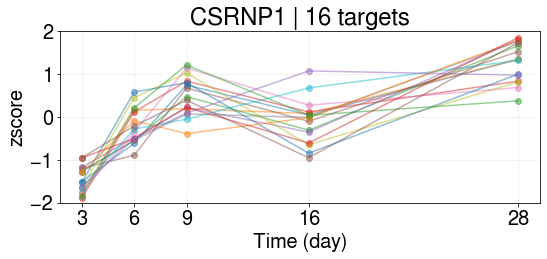

CSRNP1 | 1 [-1.45519762 -0.22192509  0.47655783 -0.09726791  1.2978328 ]
----------------------------------------------------------
regulon SOX13 8
['PIK3R1', 'PIM1', 'CARD10', 'KIAA1217', 'SMOC1', 'CLMN', 'MTSS1', 'EPS8']


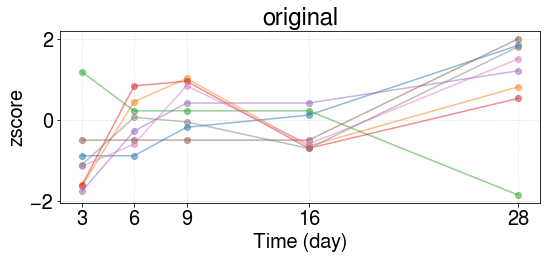

original data shape: (5, 8)
found subregulon: ['PIK3R1', 'CLMN', 'MTSS1', 'EPS8'] 4 0.8477781994265567
################################## FINAL
original size: 8; new size 4; lost: 4
PIK3R1
CLMN
MTSS1
EPS8
sub ['PIK3R1', 'CLMN', 'MTSS1', 'EPS8'] 4


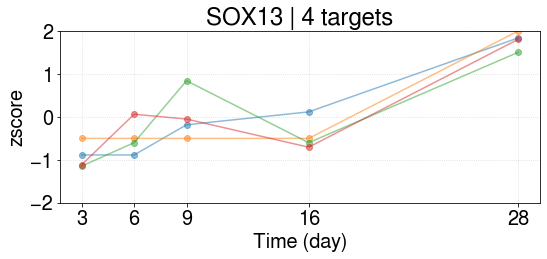

SOX13 | 1 [-0.91088777 -0.48098544  0.02701079 -0.42208365  1.78694607]
----------------------------------------------------------
regulon CEBPA 26
['INSR', 'UHRF1', 'APBB1IP', 'TK1', 'TOP2A', 'LEP', 'PPARG', 'IL6', 'APOB', 'CDKN1A', 'IGF2', 'MME', 'SOCS3', 'KCNMA1', 'VLDLR', 'ADH1B', 'ELN', 'SAA1', 'CXCL8', 'MYBL1', 'HP', 'TSC22D3', 'LBP', 'CCNB1', 'ID1', 'CSF1']


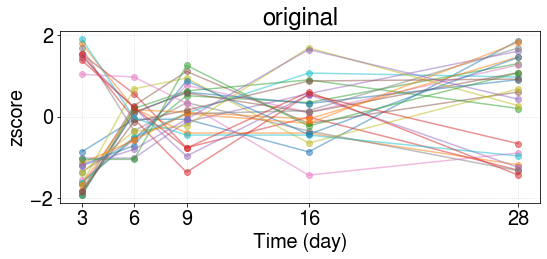

original data shape: (5, 26)
found subregulon: ['UHRF1', 'TK1', 'TOP2A', 'KCNMA1', 'MYBL1', 'CCNB1'] 6 0.8794242919601097
found subregulon: ['PPARG', 'CSF1', 'ADH1B', 'SAA1', 'IGF2', 'CDKN1A', 'MME', 'VLDLR', 'HP', 'SOCS3', 'TSC22D3'] 11 0.8589133738567564
################################## FINAL
original size: 26; new size 17; lost: 9
UHRF1
TK1
TOP2A
KCNMA1
MYBL1
CCNB1
sub ['UHRF1', 'TK1', 'TOP2A', 'KCNMA1', 'MYBL1', 'CCNB1'] 6


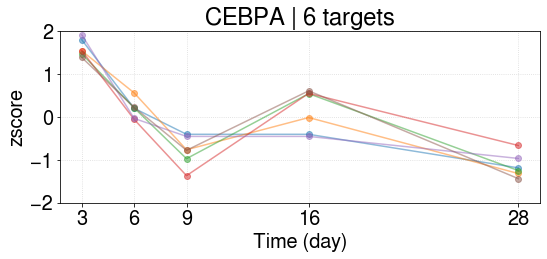

CEBPA | 1 [ 1.60682671  0.18313484 -0.79044087  0.13711993 -1.13664061]
PPARG
CSF1
ADH1B
SAA1
IGF2
CDKN1A
MME
VLDLR
HP
SOCS3
TSC22D3
sub ['PPARG', 'CSF1', 'ADH1B', 'SAA1', 'IGF2', 'CDKN1A', 'MME', 'VLDLR', 'HP', 'SOCS3', 'TSC22D3'] 11


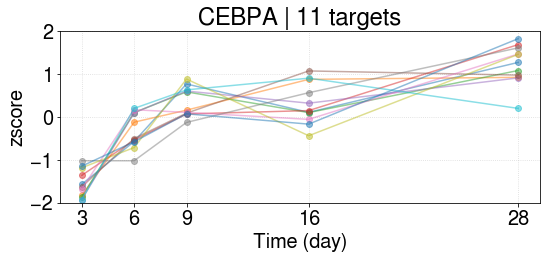

CEBPA | 2 [-1.55733123 -0.31723094  0.34738829  0.31076487  1.21640901]
----------------------------------------------------------
regulon FOXO1 15
['BCL2L11', 'TXNIP', 'CCNG2', 'CCNB1', 'CCNB2', 'PPARG', 'PDK4', 'MCM5', 'TNFSF10', 'DUSP4', 'CDKN1C', 'CNR1', 'CDKN1A', 'DAPK1', 'CCND2']


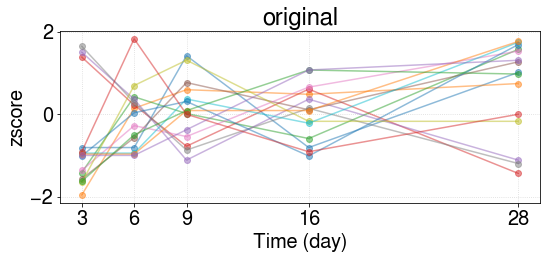

original data shape: (5, 15)
found subregulon: ['DUSP4', 'CNR1', 'CDKN1A', 'PDK4', 'CCND2'] 5 0.8316680292361018
################################## FINAL
original size: 15; new size 5; lost: 10
DUSP4
CNR1
CDKN1A
PDK4
CCND2
sub ['DUSP4', 'CNR1', 'CDKN1A', 'PDK4', 'CCND2'] 5


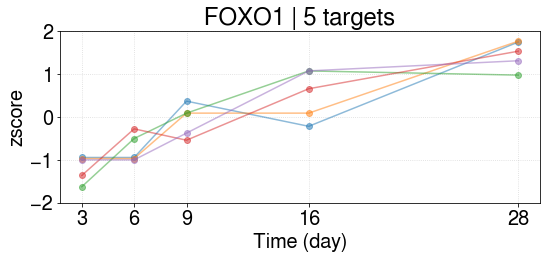

FOXO1 | 1 [-1.18101038 -0.73919909 -0.07554717  0.53314043  1.46261622]
----------------------------------------------------------
regulon NFYB 13
['RHOQ', 'CREBRF', 'UHRF1', 'DPF1', 'TXNIP', 'NCEH1', 'CDK1', 'CCNB1', 'PASK', 'SOD2', 'CKS2', 'COQ8A', 'CCNB2']


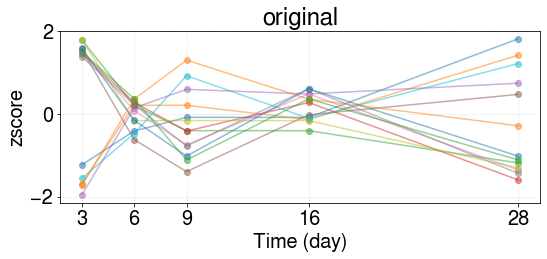

original data shape: (5, 13)
found subregulon: ['RHOQ', 'CREBRF', 'UHRF1', 'DPF1', 'TXNIP', 'NCEH1', 'CDK1', 'CCNB1', 'PASK', 'CKS2', 'COQ8A', 'CCNB2'] 12 0.8338475246181726
################################## FINAL
original size: 13; new size 12; lost: 1
RHOQ
CREBRF
UHRF1
DPF1
TXNIP
NCEH1
CDK1
CCNB1
PASK
CKS2
COQ8A
CCNB2
sub ['RHOQ', 'CREBRF', 'UHRF1', 'DPF1', 'TXNIP', 'NCEH1', 'CDK1', 'CCNB1', 'PASK', 'CKS2', 'COQ8A', 'CCNB2'] 12


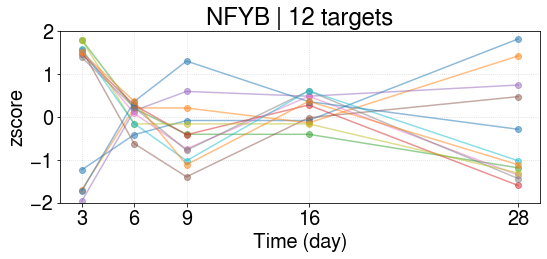

NFYB | 1 [ 0.5007533   0.04167241 -0.33494782  0.19701697 -0.40449487]
----------------------------------------------------------
regulon TP53 40
['BRCA1', 'DDIT4', 'CDC25C', 'UHRF1', 'FOS', 'RRM2B', 'BTG2', 'DUSP5', 'NDRG1', 'ADA', 'ANTXR1', 'E2F1', 'CDKN1A', 'FRMD5', 'RRM1', 'SESN1', 'TP53INP1', 'BTG1', 'CCNG2', 'FBLN2', 'PTTG1', 'TNFRSF10D', 'GPNMB', 'FBLN1', 'BCL6', 'NINJ1', 'PLK1', 'CDK1', 'FDXR', 'DNMT1', 'GDF15', 'SESN2', 'EZH2', 'RAD51', 'TYMS', 'CCNB1', 'CD82', 'BIRC5', 'MKI67', 'LIG1']


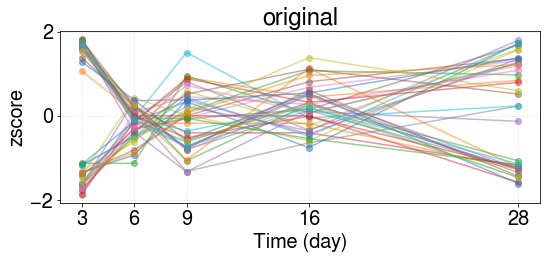

original data shape: (5, 40)
found subregulon: ['BRCA1', 'DDIT4', 'CDC25C', 'UHRF1', 'FOS', 'RRM2B', 'BTG2', 'DUSP5', 'NDRG1', 'ADA', 'ANTXR1', 'E2F1', 'CDKN1A', 'FRMD5', 'RRM1', 'SESN1', 'TP53INP1', 'BTG1', 'CCNG2', 'FBLN2', 'PTTG1', 'TNFRSF10D', 'GPNMB', 'FBLN1', 'BCL6', 'NINJ1', 'PLK1', 'CDK1', 'FDXR', 'DNMT1', 'GDF15', 'SESN2', 'EZH2', 'RAD51', 'TYMS', 'CCNB1', 'BIRC5', 'MKI67', 'LIG1'] 39 0.8417649224147601
################################## FINAL
original size: 40; new size 39; lost: 1
BRCA1
DDIT4
CDC25C
UHRF1
FOS
RRM2B
BTG2
DUSP5
NDRG1
ADA
ANTXR1
E2F1
CDKN1A
FRMD5
RRM1
SESN1
TP53INP1
BTG1
CCNG2
FBLN2
PTTG1
TNFRSF10D
GPNMB
FBLN1
BCL6
NINJ1
PLK1
CDK1
FDXR
DNMT1
GDF15
SESN2
EZH2
RAD51
TYMS
CCNB1
BIRC5
MKI67
LIG1
sub ['BRCA1', 'DDIT4', 'CDC25C', 'UHRF1', 'FOS', 'RRM2B', 'BTG2', 'DUSP5', 'NDRG1', 'ADA', 'ANTXR1', 'E2F1', 'CDKN1A', 'FRMD5', 'RRM1', 'SESN1', 'TP53INP1', 'BTG1', 'CCNG2', 'FBLN2', 'PTTG1', 'TNFRSF10D', 'GPNMB', 'FBLN1', 'BCL6', 'NINJ1', 'PLK1', 'CDK1', 'FDXR', 'DNMT1', '

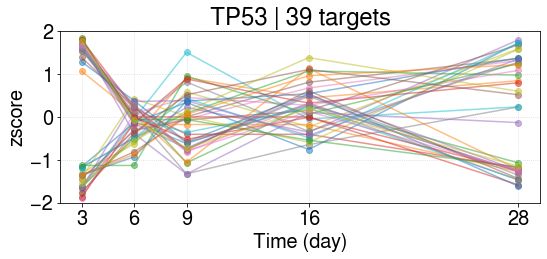

TP53 | 1 [ 0.01934187 -0.16537089 -0.10719243  0.20014707  0.05307438]
----------------------------------------------------------
regulon YBX1 9
['TYMS', 'CCNB1', 'CDKN3', 'TOP2A', 'E2F1', 'MMP13', 'KPNA2', 'CKS2', 'CDC20']


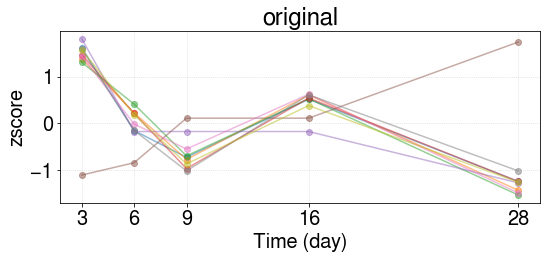

original data shape: (5, 9)
found subregulon: ['TYMS', 'CCNB1', 'CDKN3', 'TOP2A', 'E2F1', 'KPNA2', 'CKS2', 'CDC20'] 8 0.9310374345776317
################################## FINAL
original size: 9; new size 8; lost: 1
TYMS
CCNB1
CDKN3
TOP2A
E2F1
KPNA2
CKS2
CDC20
sub ['TYMS', 'CCNB1', 'CDKN3', 'TOP2A', 'E2F1', 'KPNA2', 'CKS2', 'CDC20'] 8


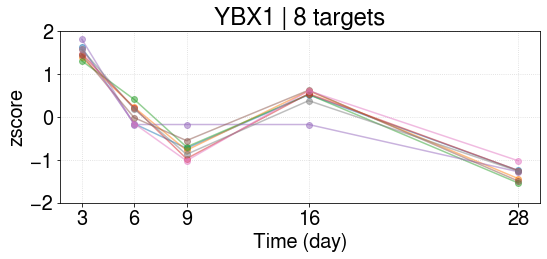

YBX1 | 1 [ 1.52324835  0.06502776 -0.72535959  0.4526042  -1.31552071]
----------------------------------------------------------
regulon FOXM1 15
['CDC25C', 'FOS', 'CDC25A', 'PLK1', 'CDK1', 'CCNB1', 'AURKB', 'CENPA', 'LAMA4', 'LAMA2', 'BIRC5', 'CDKN1A', 'CENPF', 'CDC6', 'CCND2']


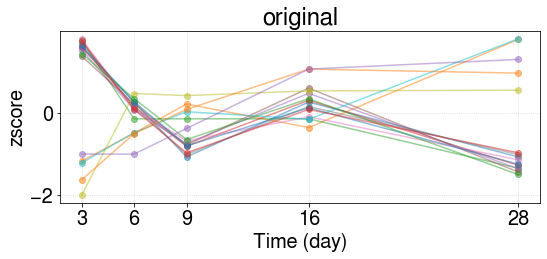

original data shape: (5, 15)
found subregulon: ['CDC25C', 'CDC25A', 'PLK1', 'CDK1', 'CCNB1', 'AURKB', 'CENPA', 'LAMA4', 'LAMA2', 'BIRC5', 'CDKN1A', 'CENPF', 'CDC6', 'CCND2'] 14 0.8702701718184203
################################## FINAL
original size: 15; new size 14; lost: 1
CDC25C
CDC25A
PLK1
CDK1
CCNB1
AURKB
CENPA
LAMA4
LAMA2
BIRC5
CDKN1A
CENPF
CDC6
CCND2
sub ['CDC25C', 'CDC25A', 'PLK1', 'CDK1', 'CCNB1', 'AURKB', 'CENPA', 'LAMA4', 'LAMA2', 'BIRC5', 'CDKN1A', 'CENPF', 'CDC6', 'CCND2'] 14


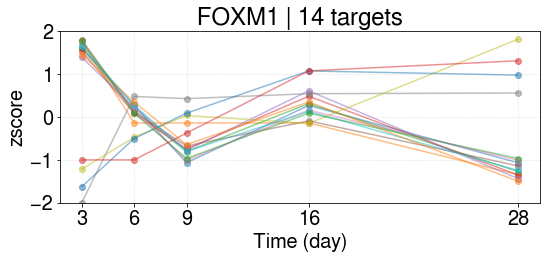

FOXM1 | 1 [ 0.74453208  0.00493978 -0.5342505   0.33470312 -0.54992449]
----------------------------------------------------------
regulon MYBL2 6
['CDKN3', 'TOP2A', 'DEPDC1B', 'CENPF', 'LMNB1', 'SYNJ2']


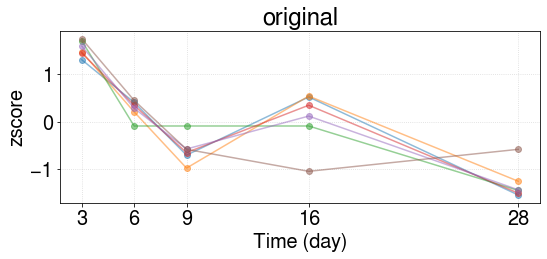

original data shape: (5, 6)
found subregulon: ['CDKN3', 'TOP2A', 'DEPDC1B', 'CENPF', 'LMNB1'] 5 0.8986802710690619
################################## FINAL
original size: 6; new size 5; lost: 1
CDKN3
TOP2A
DEPDC1B
CENPF
LMNB1
sub ['CDKN3', 'TOP2A', 'DEPDC1B', 'CENPF', 'LMNB1'] 5


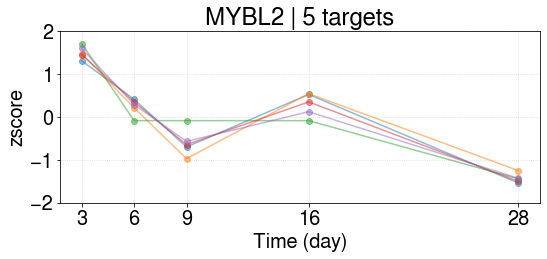

MYBL2 | 1 [ 1.50346519  0.23322041 -0.59543741  0.28959963 -1.43084782]
----------------------------------------------------------
regulon ARNTL 4
['DBP', 'NR1D2', 'NR1D1', 'PER3']


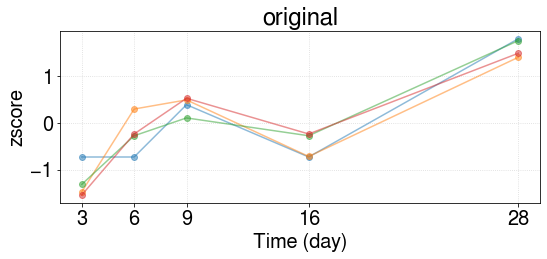

original data shape: (5, 4)
found subregulon: ['NR1D2', 'NR1D1', 'PER3'] 3 0.9310839593856473
################################## FINAL
original size: 4; new size 3; lost: 1
NR1D2
NR1D1
PER3
sub ['NR1D2', 'NR1D1', 'PER3'] 3


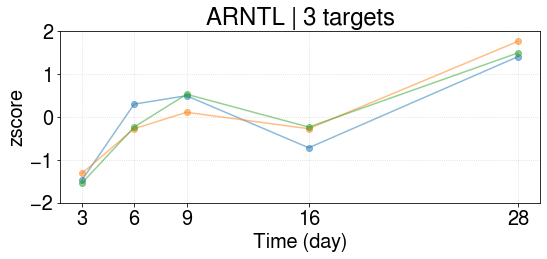

ARNTL | 1 [-1.44582548 -0.07179721  0.37584749 -0.41060889  1.55238409]
----------------------------------------------------------
regulon PPARG 8
['MMP1', 'VLDLR', 'ANGPTL4', 'NR1D1', 'APOB', 'SAT1', 'CDKN1A', 'CYP27A1']


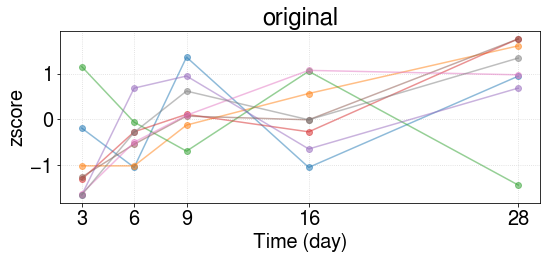

original data shape: (5, 8)
found subregulon: ['VLDLR', 'NR1D1', 'APOB', 'SAT1', 'CDKN1A'] 5 0.820543324833743
################################## FINAL
original size: 8; new size 5; lost: 3
VLDLR
NR1D1
APOB
SAT1
CDKN1A
sub ['VLDLR', 'NR1D1', 'APOB', 'SAT1', 'CDKN1A'] 5


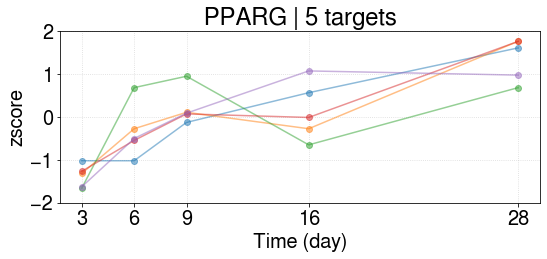

PPARG | 1 [-1.37802729 -0.33322555  0.21623798  0.13890935  1.3561055 ]
----------------------------------------------------------
regulon ZNF93 21
['ESCO2', 'RBL1', 'MCM10', 'ARHGAP11A', 'POLQ', 'MAD2L1', 'ARHGAP11B', 'FBXO5', 'KIF15', 'ECT2', 'CDK1', 'FOXM1', 'CENPK', 'DTL', 'CLSPN', 'KNL1', 'PARPBP', 'CDC45', 'FANCI', 'HELLS', 'GINS1']


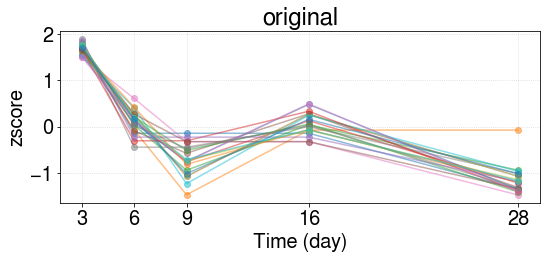

original data shape: (5, 21)
found subregulon: ['ESCO2', 'MCM10', 'ARHGAP11A', 'POLQ', 'MAD2L1', 'ARHGAP11B', 'FBXO5', 'KIF15', 'ECT2', 'CDK1', 'FOXM1', 'CENPK', 'DTL', 'CLSPN', 'KNL1', 'PARPBP', 'CDC45', 'FANCI', 'HELLS', 'GINS1'] 20 0.9365184740336809
################################## FINAL
original size: 21; new size 20; lost: 1
ESCO2
MCM10
ARHGAP11A
POLQ
MAD2L1
ARHGAP11B
FBXO5
KIF15
ECT2
CDK1
FOXM1
CENPK
DTL
CLSPN
KNL1
PARPBP
CDC45
FANCI
HELLS
GINS1
sub ['ESCO2', 'MCM10', 'ARHGAP11A', 'POLQ', 'MAD2L1', 'ARHGAP11B', 'FBXO5', 'KIF15', 'ECT2', 'CDK1', 'FOXM1', 'CENPK', 'DTL', 'CLSPN', 'KNL1', 'PARPBP', 'CDC45', 'FANCI', 'HELLS', 'GINS1'] 20


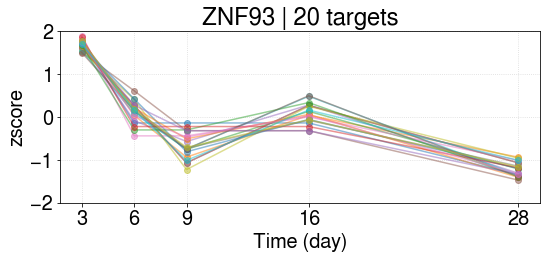

ZNF93 | 1 [ 1.68217055  0.11047756 -0.65623338  0.07845786 -1.2148726 ]
----------------------------------------------------------
regulon FOXF1 30
['C1S', 'GRASP', 'BTG2', 'DUSP5', 'NDRG1', 'ANTXR1', 'LAMA4', 'ID2', 'CCND2', 'CH25H', 'LOXL2', 'MGP', 'SPON1', 'KIAA1755', 'FBLN1', 'AK5', 'CNTNAP1', 'KCNJ8', 'CLEC3B', 'AXL', 'LRRC32', 'NTM', 'PKIG', 'HBEGF', 'ROR2', 'LIMS2', 'SMAD6', 'PMP22', 'AMIGO2', 'GEM']


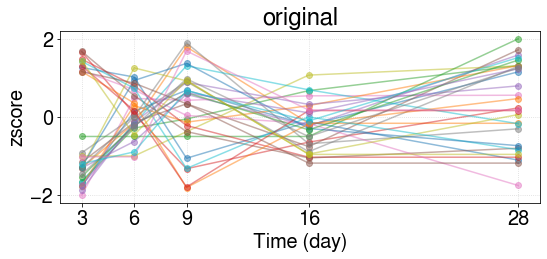

original data shape: (5, 30)
found subregulon: ['LOXL2', 'KIAA1755', 'AK5', 'CNTNAP1', 'LIMS2'] 5 0.8525388886676473
found subregulon: ['C1S', 'FBLN1', 'PMP22', 'PKIG', 'NDRG1', 'CH25H', 'KCNJ8', 'LAMA4'] 8 0.8656592341694316
################################## FINAL
original size: 30; new size 13; lost: 17
LOXL2
KIAA1755
AK5
CNTNAP1
LIMS2
sub ['LOXL2', 'KIAA1755', 'AK5', 'CNTNAP1', 'LIMS2'] 5


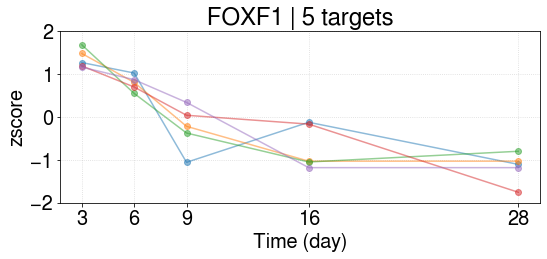

FOXF1 | 1 [ 1.35359836  0.78684403 -0.25517101 -0.71101887 -1.1742525 ]
C1S
FBLN1
PMP22
PKIG
NDRG1
CH25H
KCNJ8
LAMA4
sub ['C1S', 'FBLN1', 'PMP22', 'PKIG', 'NDRG1', 'CH25H', 'KCNJ8', 'LAMA4'] 8


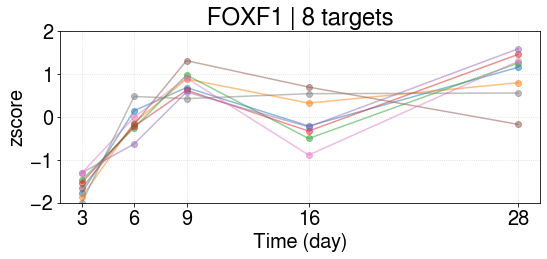

FOXF1 | 2 [-1.61186605 -0.10053695  0.79824903 -0.07624456  0.99039853]
----------------------------------------------------------
regulon PLAGL1 42
['LPCAT4', 'FGF7', 'PLEKHG5', 'ATP8B4', 'NT5E', 'EFEMP1', 'PPARG', 'CCND2', 'PAK3', 'COL4A3', 'CCNG2', 'LRRC17', 'MGP', 'GPNMB', 'HLA-F', 'ENPP1', 'SLC29A1', 'ASPN', 'ABI3BP', 'MMP16', 'DPT', 'SLIT3', 'VWA5A', 'COL4A4', 'HTRA1', 'CXCL12', 'LRRK2', 'NBL1', 'LSP1', 'NREP', 'MGLL', 'PTGFR', 'MFAP4', 'PEAR1', 'ASAP3', 'ECM2', 'CHTF18', 'COL21A1', 'LUM', 'BOC', 'PLEKHH2', 'LIG1']


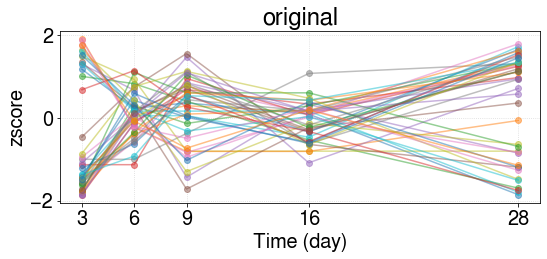

original data shape: (5, 42)
found subregulon: ['LPCAT4', 'NT5E', 'PAK3', 'SLC29A1', 'ABI3BP', 'MMP16', 'NREP', 'MGLL', 'CHTF18', 'LIG1'] 10 0.830741791104303
found subregulon: ['NBL1', 'FGF7', 'COL21A1', 'ECM2', 'MFAP4', 'PTGFR', 'EFEMP1', 'HTRA1', 'SLIT3', 'COL4A4', 'ATP8B4', 'DPT', 'LUM', 'BOC', 'MGP', 'ASAP3', 'PLEKHG5', 'ASPN', 'LSP1'] 19 0.8519630358630599
################################## FINAL
original size: 42; new size 29; lost: 13
LPCAT4
NT5E
PAK3
SLC29A1
ABI3BP
MMP16
NREP
MGLL
CHTF18
LIG1
sub ['LPCAT4', 'NT5E', 'PAK3', 'SLC29A1', 'ABI3BP', 'MMP16', 'NREP', 'MGLL', 'CHTF18', 'LIG1'] 10


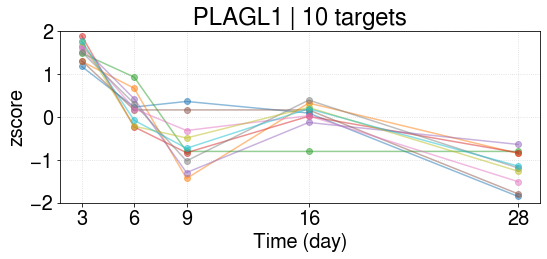

PLAGL1 | 1 [ 1.54256834  0.23830881 -0.64097427  0.04831453 -1.18821741]
NBL1
FGF7
COL21A1
ECM2
MFAP4
PTGFR
EFEMP1
HTRA1
SLIT3
COL4A4
ATP8B4
DPT
LUM
BOC
MGP
ASAP3
PLEKHG5
ASPN
LSP1
sub ['NBL1', 'FGF7', 'COL21A1', 'ECM2', 'MFAP4', 'PTGFR', 'EFEMP1', 'HTRA1', 'SLIT3', 'COL4A4', 'ATP8B4', 'DPT', 'LUM', 'BOC', 'MGP', 'ASAP3', 'PLEKHG5', 'ASPN', 'LSP1'] 19


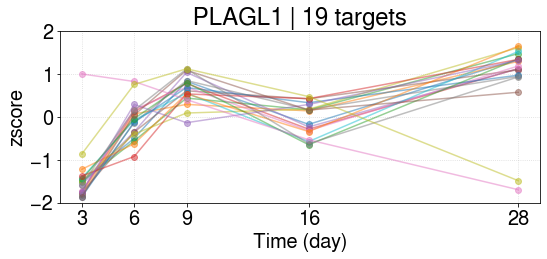

PLAGL1 | 2 [-1.43870632 -0.08642648  0.64776265 -0.05181888  0.92918903]
----------------------------------------------------------
regulon GLI2 4
['FST', 'EFEMP1', 'LUM', 'IFNGR1']


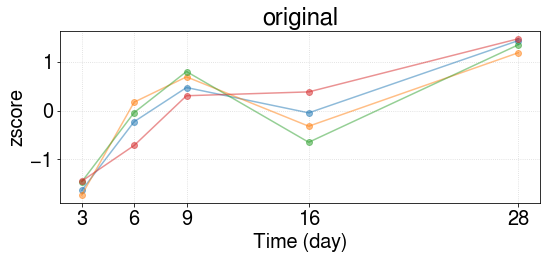

original data shape: (5, 4)
found subregulon: ['EFEMP1', 'LUM', 'IFNGR1'] 3 0.9377748496431573
################################## FINAL
original size: 4; new size 3; lost: 1
EFEMP1
LUM
IFNGR1
sub ['EFEMP1', 'LUM', 'IFNGR1'] 3


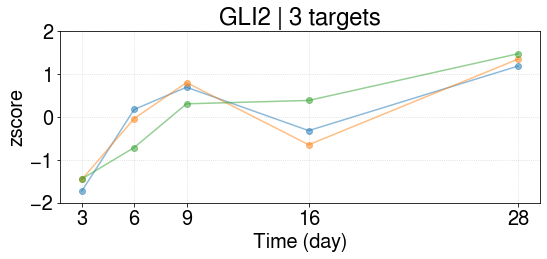

GLI2 | 1 [-1.54364565 -0.19386353  0.59862698 -0.19492249  1.33380469]
----------------------------------------------------------
regulon LHX6 44
['PTPRM', 'CARD10', 'EFEMP1', 'PPARG', 'NDNF', 'INHBB', 'PALM', 'DAPK1', 'A2M', 'FMO2', 'FZD4', 'ANGPTL2', 'SNCG', 'C1QTNF1', 'GGT5', 'EHD4', 'POSTN', 'CDC7', 'EPAS1', 'TNFRSF1B', 'KCNT2', 'CLEC3B', 'PCDH19', 'EBF1', 'KIF20B', 'PRCD', 'CYGB', 'APOL3', 'LRRC32', 'SEMA3F', 'NTM', 'CNR1', 'ARRB1', 'SRPX', 'RASL11A', 'CCDC69', 'UGP2', 'PEAR1', 'CFI', 'LIMS2', 'PCDH18', 'GAS1', 'ACKR1', 'EPS8']


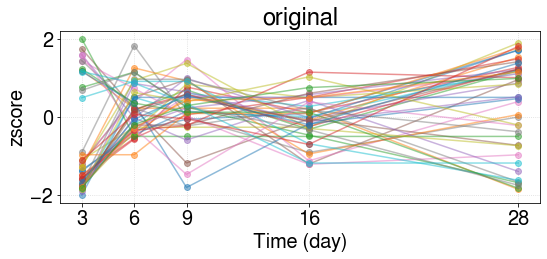

original data shape: (5, 44)
found subregulon: ['PCDH18', 'GAS1', 'ANGPTL2', 'CYGB', 'CCDC69', 'GGT5', 'EBF1', 'PPARG', 'C1QTNF1', 'FZD4', 'EFEMP1', 'ACKR1', 'PTPRM', 'FMO2', 'PRCD', 'NDNF', 'EPAS1', 'A2M', 'KCNT2', 'CNR1', 'EPS8', 'RASL11A', 'SRPX', 'INHBB', 'CFI', 'CDC7', 'ARRB1'] 27 0.8436136192813461
################################## FINAL
original size: 44; new size 27; lost: 17
PCDH18
GAS1
ANGPTL2
CYGB
CCDC69
GGT5
EBF1
PPARG
C1QTNF1
FZD4
EFEMP1
ACKR1
PTPRM
FMO2
PRCD
NDNF
EPAS1
A2M
KCNT2
CNR1
EPS8
RASL11A
SRPX
INHBB
CFI
CDC7
ARRB1
sub ['PCDH18', 'GAS1', 'ANGPTL2', 'CYGB', 'CCDC69', 'GGT5', 'EBF1', 'PPARG', 'C1QTNF1', 'FZD4', 'EFEMP1', 'ACKR1', 'PTPRM', 'FMO2', 'PRCD', 'NDNF', 'EPAS1', 'A2M', 'KCNT2', 'CNR1', 'EPS8', 'RASL11A', 'SRPX', 'INHBB', 'CFI', 'CDC7', 'ARRB1'] 27


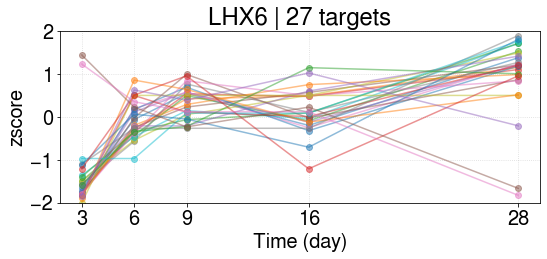

LHX6 | 1 [-1.38574662 -0.05802964  0.33009879  0.14295035  0.97072712]
----------------------------------------------------------
regulon HLX 41
['FGF7', 'CPT1C', 'GRASP', 'ST3GAL5', 'GABARAPL1', 'CARD10', 'ADA', 'CEBPD', 'ZNF503', 'LAMA4', 'CLDN11', 'ADAMTS10', 'PALM', 'SMTN', 'FAM110B', 'RARRES2', 'BTG1', 'IL3RA', 'CTSF', 'NUPR1', 'GYPC', 'HLA-F', 'MYO15B', 'TNFRSF1B', 'KCNJ8', 'CYGB', 'APOL3', 'LRRC32', 'BST2', 'IFITM1', 'HTRA1', 'NRGN', 'GDF15', 'PXN', 'HBEGF', 'NBL1', 'PEAR1', 'ROR2', 'SPRY1', 'CSF1', 'PCDH18']


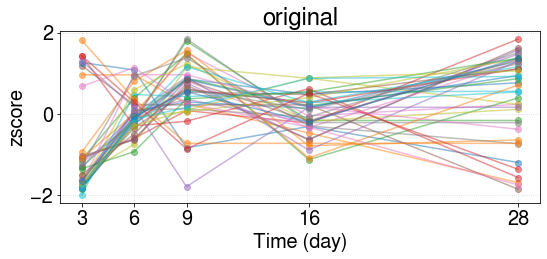

original data shape: (5, 41)
found subregulon: ['HTRA1', 'TNFRSF1B', 'MYO15B', 'NUPR1', 'BTG1', 'PCDH18', 'NBL1', 'GYPC', 'CYGB', 'FGF7', 'IFITM1', 'GABARAPL1', 'KCNJ8', 'CEBPD', 'ADA', 'BST2', 'FAM110B', 'LAMA4', 'RARRES2', 'CTSF', 'GDF15', 'ZNF503', 'HLA-F', 'CSF1', 'GRASP', 'SPRY1', 'PALM', 'ST3GAL5'] 28 0.8209710903909826
################################## FINAL
original size: 41; new size 28; lost: 13
HTRA1
TNFRSF1B
MYO15B
NUPR1
BTG1
PCDH18
NBL1
GYPC
CYGB
FGF7
IFITM1
GABARAPL1
KCNJ8
CEBPD
ADA
BST2
FAM110B
LAMA4
RARRES2
CTSF
GDF15
ZNF503
HLA-F
CSF1
GRASP
SPRY1
PALM
ST3GAL5
sub ['HTRA1', 'TNFRSF1B', 'MYO15B', 'NUPR1', 'BTG1', 'PCDH18', 'NBL1', 'GYPC', 'CYGB', 'FGF7', 'IFITM1', 'GABARAPL1', 'KCNJ8', 'CEBPD', 'ADA', 'BST2', 'FAM110B', 'LAMA4', 'RARRES2', 'CTSF', 'GDF15', 'ZNF503', 'HLA-F', 'CSF1', 'GRASP', 'SPRY1', 'PALM', 'ST3GAL5'] 28


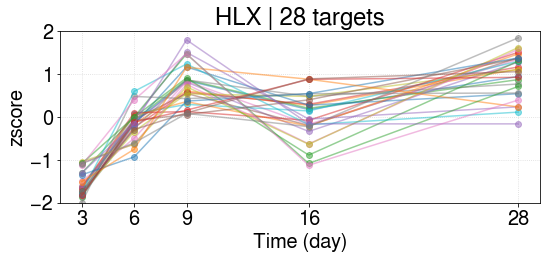

HLX | 1 [-1.57553928 -0.16889666  0.7346779   0.01508033  0.99467771]
----------------------------------------------------------
regulon CEBPB 12
['CXCL8', 'INSR', 'FOS', 'ADM', 'HP', 'CYP19A1', 'SLC19A1', 'SAA2', 'IL6', 'SAA1', 'CDKN1A', 'IGF2']


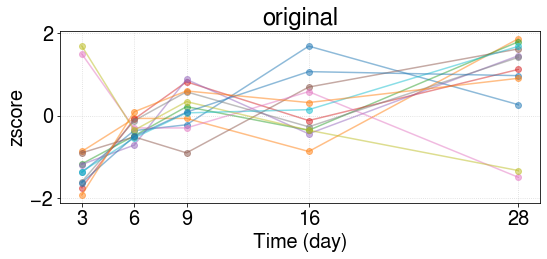

original data shape: (5, 12)
found subregulon: ['SAA1', 'FOS', 'IGF2', 'ADM', 'IL6', 'SLC19A1', 'CXCL8'] 7 0.8262439443324239
################################## FINAL
original size: 12; new size 7; lost: 5
SAA1
FOS
IGF2
ADM
IL6
SLC19A1
CXCL8
sub ['SAA1', 'FOS', 'IGF2', 'ADM', 'IL6', 'SLC19A1', 'CXCL8'] 7


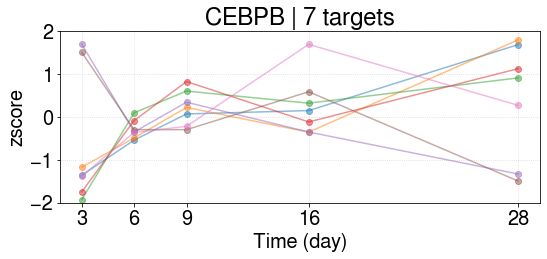

CEBPB | 1 [-0.62587524 -0.28991747  0.21994351  0.27390332  0.42194588]
----------------------------------------------------------
regulon CTCF 14
['HMCN1', 'GALNT6', 'TRAPPC6A', 'LRRC59', 'C1R', 'PPRC1', 'HSPA5', 'B4GALNT1', 'NES', 'H19', 'MCM10', 'PTPRG', 'IGF2', 'BCL6']


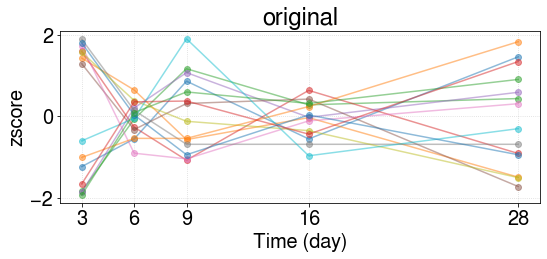

original data shape: (5, 14)
found subregulon: ['GALNT6', 'LRRC59', 'B4GALNT1', 'NES', 'MCM10'] 5 0.8564070585328045
################################## FINAL
original size: 14; new size 5; lost: 9
GALNT6
LRRC59
B4GALNT1
NES
MCM10
sub ['GALNT6', 'LRRC59', 'B4GALNT1', 'NES', 'MCM10'] 5


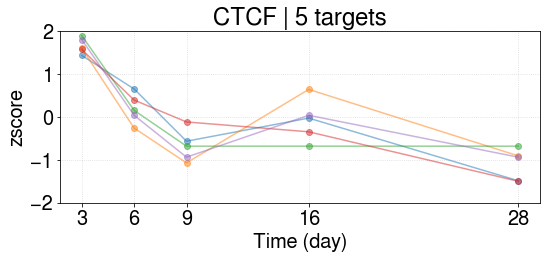

CTCF | 1 [ 1.65847266  0.19402471 -0.6747288  -0.07573367 -1.10203489]
----------------------------------------------------------
regulon NR2F1 9
['ZNF469', 'PRKAR1B', 'RHBDF2', 'CYP19A1', 'ROR2', 'SULF2', 'PALM', 'FBLN1', 'SYNJ2']


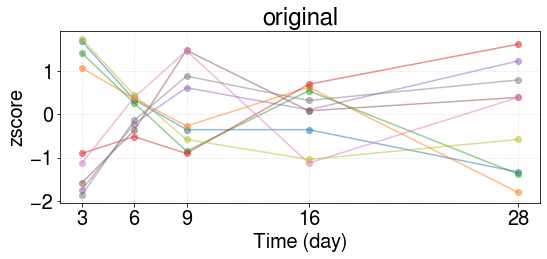

original data shape: (5, 9)
################################## FINAL
original size: 9; new size 0; lost: 9
----------------------------------------------------------
regulon MLXIPL 41
['DGAT2', 'CIDEC', 'ST3GAL5', 'APBB1IP', 'LEP', 'CFD', 'PPARG', 'SPX', 'DUSP4', 'WDR62', 'ELOVL3', 'COQ8A', 'GYG2', 'G0S2', 'PTH1R', 'FZD4', 'C1QTNF1', 'GPX3', 'TIMP4', 'SAA1', 'ACSL1', 'TXNIP', 'CORO6', 'C3', 'CHAF1A', 'FOXM1', 'MELTF', 'PNPLA3', 'ABCA9', 'RBP4', 'MLPH', 'EME1', 'SGO1', 'CCDC69', 'SLC25A10', 'ADHFE1', 'RASL10B', 'STAT5A', 'SPRED3', 'MARC1', 'LATS2']


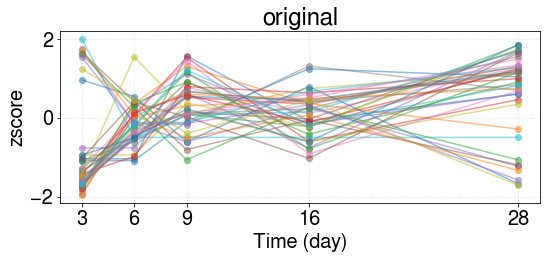

original data shape: (5, 41)
found subregulon: ['WDR62', 'CHAF1A', 'FOXM1', 'MLPH', 'EME1', 'SGO1', 'SLC25A10', 'SPRED3'] 8 0.8373309672865332
found subregulon: ['APBB1IP', 'STAT5A', 'CFD', 'ACSL1', 'CCDC69', 'PNPLA3', 'CIDEC', 'GPX3', 'FZD4', 'MARC1', 'SAA1', 'RASL10B', 'GYG2', 'C1QTNF1', 'CORO6', 'TXNIP', 'G0S2', 'ST3GAL5', 'LEP', 'TIMP4', 'DUSP4', 'C3', 'RBP4', 'LATS2', 'MELTF', 'ELOVL3', 'SPX', 'ADHFE1'] 28 0.8227486872555188
################################## FINAL
original size: 41; new size 36; lost: 5
WDR62
CHAF1A
FOXM1
MLPH
EME1
SGO1
SLC25A10
SPRED3
sub ['WDR62', 'CHAF1A', 'FOXM1', 'MLPH', 'EME1', 'SGO1', 'SLC25A10', 'SPRED3'] 8


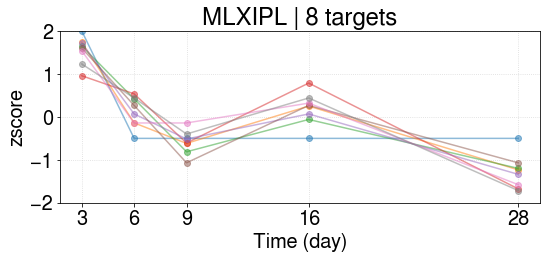

MLXIPL | 1 [ 1.55418892  0.11899541 -0.58236256  0.19718744 -1.28800922]
APBB1IP
STAT5A
CFD
ACSL1
CCDC69
PNPLA3
CIDEC
GPX3
FZD4
MARC1
SAA1
RASL10B
GYG2
C1QTNF1
CORO6
TXNIP
G0S2
ST3GAL5
LEP
TIMP4
DUSP4
C3
RBP4
LATS2
MELTF
ELOVL3
SPX
ADHFE1
sub ['APBB1IP', 'STAT5A', 'CFD', 'ACSL1', 'CCDC69', 'PNPLA3', 'CIDEC', 'GPX3', 'FZD4', 'MARC1', 'SAA1', 'RASL10B', 'GYG2', 'C1QTNF1', 'CORO6', 'TXNIP', 'G0S2', 'ST3GAL5', 'LEP', 'TIMP4', 'DUSP4', 'C3', 'RBP4', 'LATS2', 'MELTF', 'ELOVL3', 'SPX', 'ADHFE1'] 28


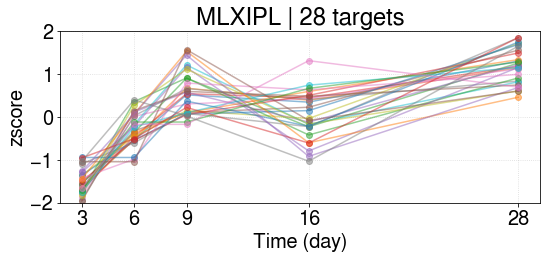

MLXIPL | 2 [-1.51295374 -0.2746595   0.55025741  0.05987364  1.1774822 ]
----------------------------------------------------------
regulon ZNF714 20
['POLQ', 'PLK4', 'BUB1B', 'RAD51AP1', 'ARHGAP11B', 'GINS4', 'STIL', 'NCAPG2', 'KIF20B', 'KNL1', 'KIF11', 'EME1', 'CENPE', 'SLC25A36', 'PRR11', 'HELLS', 'SKA1', 'RFC3', 'XRCC2', 'MCM2']


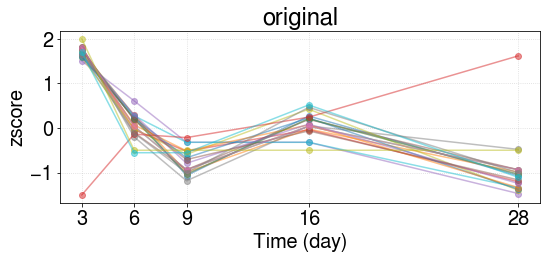

original data shape: (5, 20)
found subregulon: ['POLQ', 'PLK4', 'BUB1B', 'RAD51AP1', 'ARHGAP11B', 'GINS4', 'STIL', 'NCAPG2', 'KIF20B', 'KNL1', 'KIF11', 'EME1', 'CENPE', 'PRR11', 'HELLS', 'SKA1', 'RFC3', 'XRCC2', 'MCM2'] 19 0.9331187890200342
################################## FINAL
original size: 20; new size 19; lost: 1
POLQ
PLK4
BUB1B
RAD51AP1
ARHGAP11B
GINS4
STIL
NCAPG2
KIF20B
KNL1
KIF11
EME1
CENPE
PRR11
HELLS
SKA1
RFC3
XRCC2
MCM2
sub ['POLQ', 'PLK4', 'BUB1B', 'RAD51AP1', 'ARHGAP11B', 'GINS4', 'STIL', 'NCAPG2', 'KIF20B', 'KNL1', 'KIF11', 'EME1', 'CENPE', 'PRR11', 'HELLS', 'SKA1', 'RFC3', 'XRCC2', 'MCM2'] 19


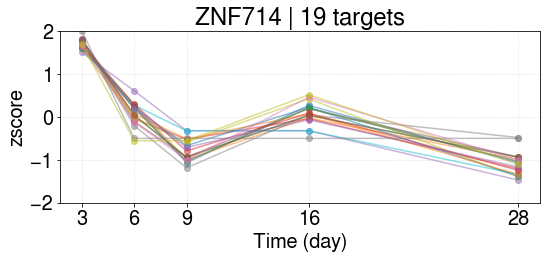

ZNF714 | 1 [ 1.71354348  0.06034798 -0.77013147  0.07884317 -1.08260316]
----------------------------------------------------------
regulon E2F2 10
['PLK4', 'PLK1', 'CDCA7', 'MCM5', 'ASF1B', 'E2F1', 'MAP3K5', 'MCM10', 'CDC6', 'CDT1']


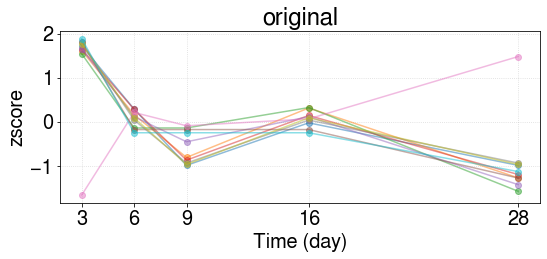

original data shape: (5, 10)
found subregulon: ['PLK4', 'PLK1', 'CDCA7', 'MCM5', 'ASF1B', 'E2F1', 'MCM10', 'CDC6', 'CDT1'] 9 0.9455715090782569
################################## FINAL
original size: 10; new size 9; lost: 1
PLK4
PLK1
CDCA7
MCM5
ASF1B
E2F1
MCM10
CDC6
CDT1
sub ['PLK4', 'PLK1', 'CDCA7', 'MCM5', 'ASF1B', 'E2F1', 'MCM10', 'CDC6', 'CDT1'] 9


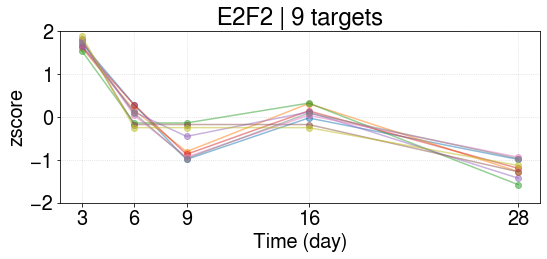

E2F2 | 1 [ 1.71367123  0.04392603 -0.62231333  0.0622546  -1.19753852]
----------------------------------------------------------
regulon E2F3 7
['PLK1', 'MCM5', 'E2F1', 'MAP3K5', 'AURKA', 'CDKN1A', 'CDC6']


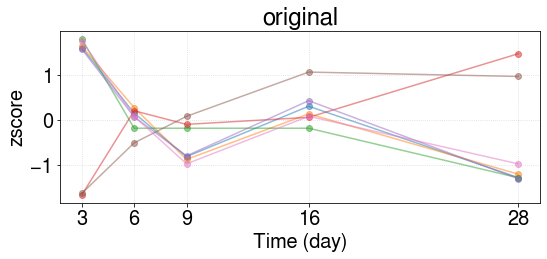

original data shape: (5, 7)
found subregulon: ['PLK1', 'MCM5', 'E2F1', 'AURKA', 'CDKN1A', 'CDC6'] 6 0.90895460363776
################################## FINAL
original size: 7; new size 6; lost: 1
PLK1
MCM5
E2F1
AURKA
CDKN1A
CDC6
sub ['PLK1', 'MCM5', 'E2F1', 'AURKA', 'CDKN1A', 'CDC6'] 6


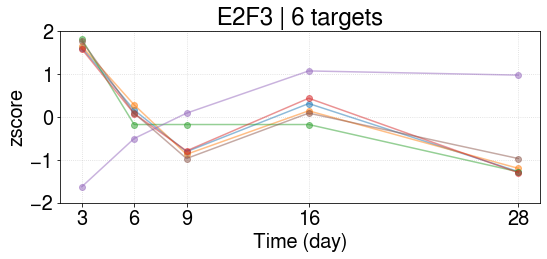

E2F3 | 1 [ 1.13062623 -0.01312407 -0.58858423  0.31127594 -0.84019386]
----------------------------------------------------------
regulon TSC22D1 33
['DGAT2', 'UHRF1', 'SLC7A2', 'GABARAPL1', 'BTG2', 'PDK4', 'CEBPD', 'DCN', 'DEPTOR', 'SESN1', 'BTG1', 'KCNMA1', 'NUDT4', 'ANTXR2', 'ASPN', 'NEDD9', 'PNRC1', 'WASL', 'RGCC', 'KLF9', 'TSC22D3', 'OSGIN2', 'CDKN1C', 'TIPARP', 'PKIG', 'CBX7', 'TPM1', 'ENPP4', 'UGP2', 'APOD', 'EPS8', 'ARHGAP6', 'SSBP2']


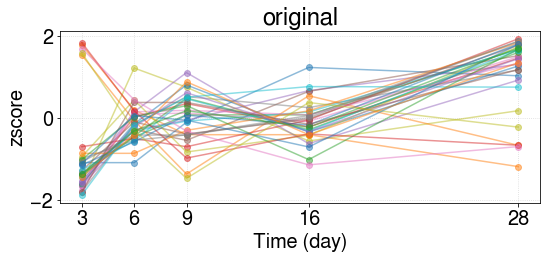

original data shape: (5, 33)
found subregulon: ['UHRF1', 'KCNMA1', 'TIPARP', 'UGP2'] 4 0.848093005241582
found subregulon: ['GABARAPL1', 'CEBPD', 'SSBP2', 'SLC7A2', 'SESN1', 'PKIG', 'PNRC1', 'NUDT4', 'DCN', 'KLF9', 'TSC22D3', 'BTG1', 'BTG2', 'CBX7', 'NEDD9', 'ARHGAP6', 'ENPP4', 'APOD', 'EPS8', 'PDK4', 'ASPN', 'WASL', 'CDKN1C', 'OSGIN2', 'DGAT2', 'DEPTOR', 'ANTXR2', 'RGCC'] 28 0.822839685155274
################################## FINAL
original size: 33; new size 32; lost: 1
UHRF1
KCNMA1
TIPARP
UGP2
sub ['UHRF1', 'KCNMA1', 'TIPARP', 'UGP2'] 4


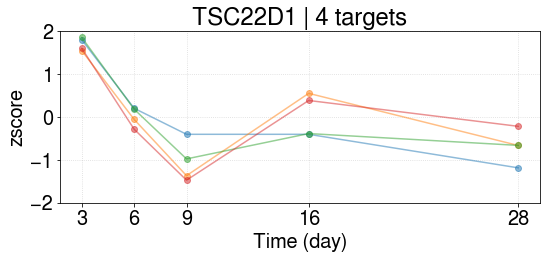

TSC22D1 | 1 [ 1.69652043  0.00866527 -1.05626423  0.03445571 -0.68337718]
GABARAPL1
CEBPD
SSBP2
SLC7A2
SESN1
PKIG
PNRC1
NUDT4
DCN
KLF9
TSC22D3
BTG1
BTG2
CBX7
NEDD9
ARHGAP6
ENPP4
APOD
EPS8
PDK4
ASPN
WASL
CDKN1C
OSGIN2
DGAT2
DEPTOR
ANTXR2
RGCC
sub ['GABARAPL1', 'CEBPD', 'SSBP2', 'SLC7A2', 'SESN1', 'PKIG', 'PNRC1', 'NUDT4', 'DCN', 'KLF9', 'TSC22D3', 'BTG1', 'BTG2', 'CBX7', 'NEDD9', 'ARHGAP6', 'ENPP4', 'APOD', 'EPS8', 'PDK4', 'ASPN', 'WASL', 'CDKN1C', 'OSGIN2', 'DGAT2', 'DEPTOR', 'ANTXR2', 'RGCC'] 28


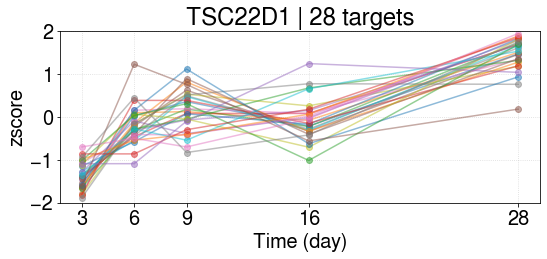

TSC22D1 | 2 [-1.36981042 -0.18661927  0.14426552 -0.06142191  1.47358608]
----------------------------------------------------------
regulon IRX6 20
['CIDEC', 'LEP', 'CFD', 'PPARG', 'SPX', 'OSR2', 'PALM', 'GYG2', 'SNCG', 'FBLN2', 'ADH1B', 'SLC29A1', 'CLEC3B', 'DPT', 'PRCD', 'NRGN', 'MLPH', 'ADAMTS5', 'VIT', 'APOD']


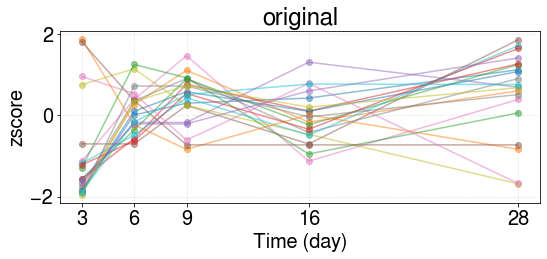

original data shape: (5, 20)
found subregulon: ['CFD', 'CIDEC', 'GYG2', 'PPARG', 'VIT', 'LEP', 'DPT', 'APOD', 'FBLN2', 'ADAMTS5', 'PRCD'] 11 0.8755265930775094
################################## FINAL
original size: 20; new size 11; lost: 9
CFD
CIDEC
GYG2
PPARG
VIT
LEP
DPT
APOD
FBLN2
ADAMTS5
PRCD
sub ['CFD', 'CIDEC', 'GYG2', 'PPARG', 'VIT', 'LEP', 'DPT', 'APOD', 'FBLN2', 'ADAMTS5', 'PRCD'] 11


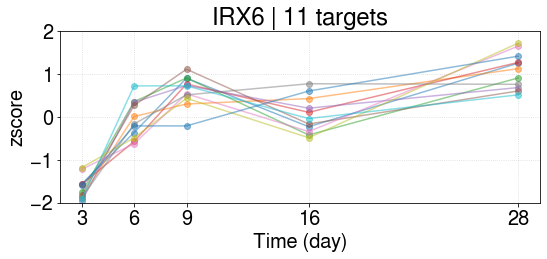

IRX6 | 1 [-1.66510239 -0.06534444  0.61036884  0.03924569  1.08083228]
----------------------------------------------------------
regulon FOS 15
['CSTA', 'CXCL8', 'BCL2L11', 'EZR', 'PLAU', 'MMP1', 'LOXL4', 'MMP7', 'DDIT3', 'RUNX2', 'MELTF', 'IL6', 'CDKN1A', 'FOSL1', 'STIM1']


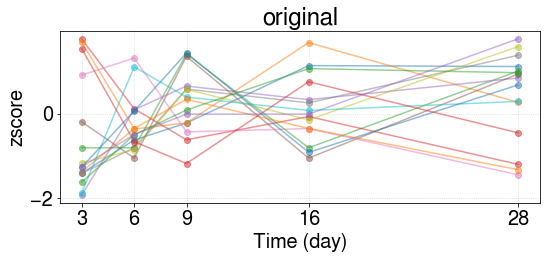

original data shape: (5, 15)
################################## FINAL
original size: 15; new size 0; lost: 15
----------------------------------------------------------
regulon ATF4 6
['CXCL8', 'DDIT4', 'DDR2', 'DDIT3', 'NUPR1', 'CEBPB']


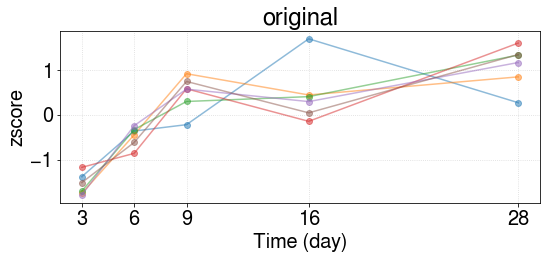

original data shape: (5, 6)
found subregulon: ['CXCL8', 'DDIT4', 'DDR2', 'DDIT3', 'CEBPB'] 5 0.8596726229717815
################################## FINAL
original size: 6; new size 5; lost: 1
CXCL8
DDIT4
DDR2
DDIT3
CEBPB
sub ['CXCL8', 'DDIT4', 'DDR2', 'DDIT3', 'CEBPB'] 5


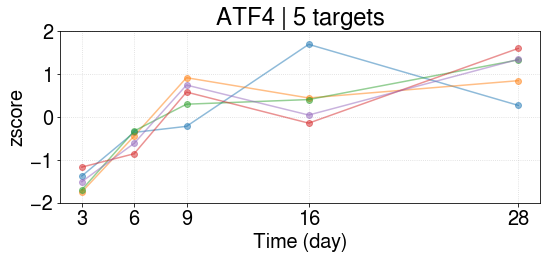

ATF4 | 1 [-1.50034456 -0.5221656   0.46166292  0.48630667  1.07454057]
----------------------------------------------------------
regulon E2F7 8
['UHRF1', 'FOS', 'PDGFRA', 'E2F1', 'VGLL4', 'DNMT1', 'E2F8', 'ZNF367']


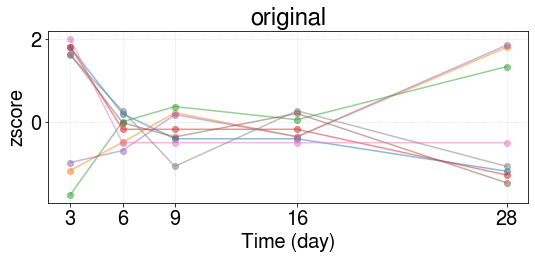

original data shape: (5, 8)
found subregulon: ['UHRF1', 'FOS', 'E2F1', 'VGLL4', 'DNMT1', 'E2F8', 'ZNF367'] 7 0.8897981371341767
################################## FINAL
original size: 8; new size 7; lost: 1
UHRF1
FOS
E2F1
VGLL4
DNMT1
E2F8
ZNF367
sub ['UHRF1', 'FOS', 'E2F1', 'VGLL4', 'DNMT1', 'E2F8', 'ZNF367'] 7


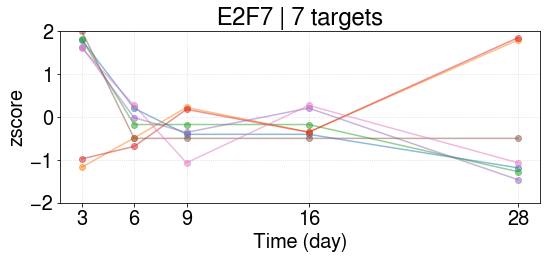

E2F7 | 1 [ 0.95698571 -0.20076787 -0.30249999 -0.18873941 -0.26497844]
----------------------------------------------------------
regulon BATF 10
['SAMSN1', 'APBB1IP', 'KCNMA1', 'IL1R2', 'NRCAM', 'IL1R1', 'NABP1', 'MAP3K5', 'CCR7', 'ST6GAL1']


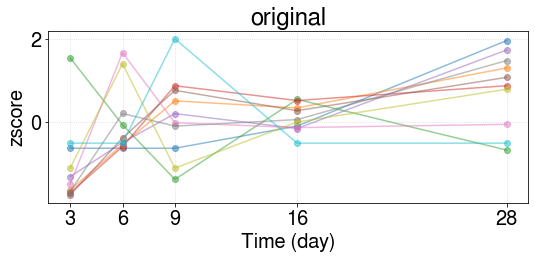

original data shape: (5, 10)
################################## FINAL
original size: 10; new size 0; lost: 10
----------------------------------------------------------
regulon FOXO3 13
['PLAU', 'BCL2L11', 'TXNIP', 'CCNG2', 'DUSP5', 'TNFSF10', 'FOXO1', 'ID1', 'BCL6', 'CDKN1A', 'SOD2', 'FBXO32', 'CCND2']


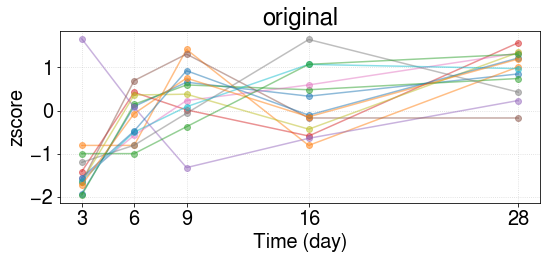

original data shape: (5, 13)
################################## FINAL
original size: 13; new size 0; lost: 13
----------------------------------------------------------
regulon FOXO4 6
['PPARGC1A', 'BCL2L11', 'TNFSF10', 'CDKN1A', 'SOD2', 'BCL6']


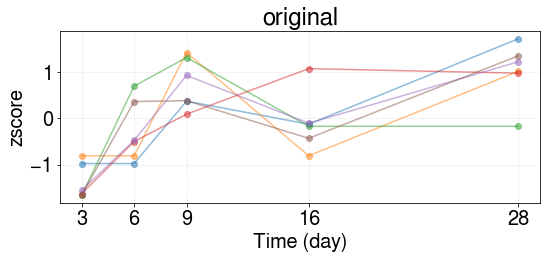

original data shape: (5, 6)
################################## FINAL
original size: 6; new size 0; lost: 6
----------------------------------------------------------
regulon FOXL2 7
['PPARGC1A', 'FOS', 'IL11', 'CYP19A1', 'SOD2', 'CXCL2', 'CH25H']


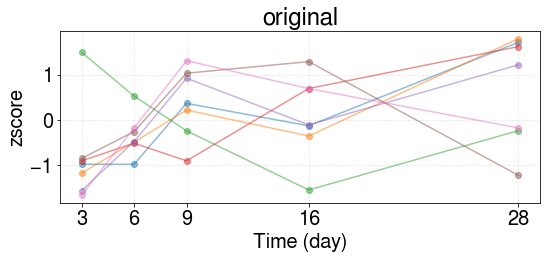

original data shape: (5, 7)
################################## FINAL
original size: 7; new size 0; lost: 7
----------------------------------------------------------
regulon HOXA10 4
['CDKN1C', 'IL11', 'KLF9', 'ID2']


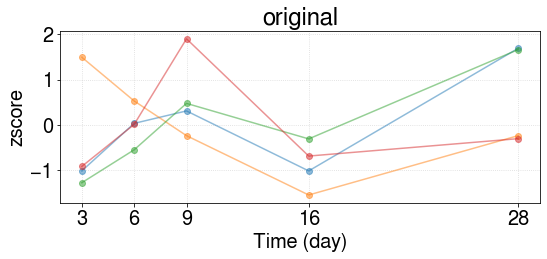

original data shape: (5, 4)
################################## FINAL
original size: 4; new size 0; lost: 4
----------------------------------------------------------
regulon GATA2 7
['PPARG', 'IL1RL1', 'VWA5A', 'PLSCR2', 'ACKR1', 'ARRDC4', 'PSD4']


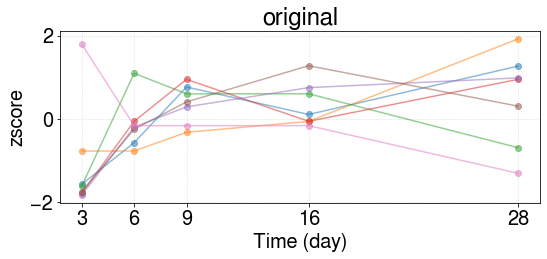

original data shape: (5, 7)
################################## FINAL
original size: 7; new size 0; lost: 7
----------------------------------------------------------
regulon TWIST1 4
['CDKN1A', 'SRPX', 'FOS', 'CD24']


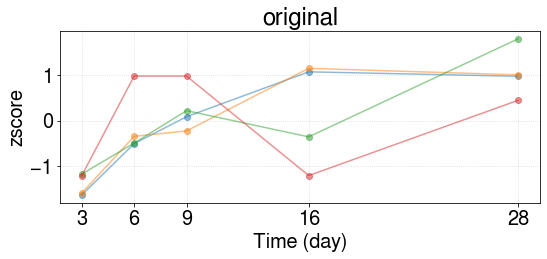

original data shape: (5, 4)
################################## FINAL
original size: 4; new size 0; lost: 4
----------------------------------------------------------
regulon TWIST2 6
['SRPX', 'FOS', 'RUNX2', 'POSTN', 'GDF15', 'CDH2']


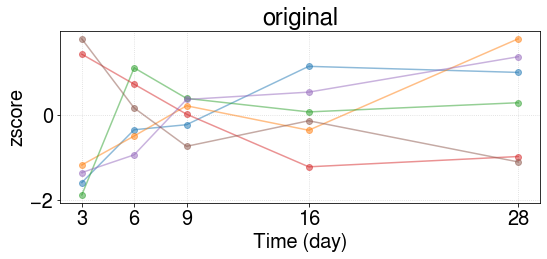

original data shape: (5, 6)
################################## FINAL
original size: 6; new size 0; lost: 6
----------------------------------------------------------
regulon TFDP1 5
['RRM1', 'TYMS', 'CDK1', 'MYBL2', 'CKAP2L']


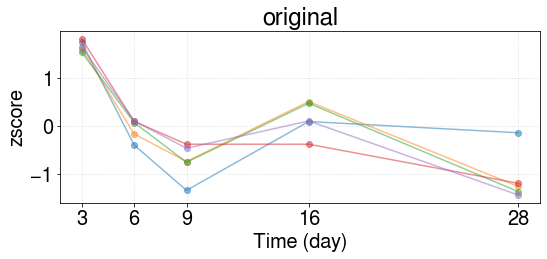

original data shape: (5, 5)
found subregulon: ['TYMS', 'CDK1', 'MYBL2', 'CKAP2L'] 4 0.9041976545701802
################################## FINAL
original size: 5; new size 4; lost: 1
TYMS
CDK1
MYBL2
CKAP2L
sub ['TYMS', 'CDK1', 'MYBL2', 'CKAP2L'] 4


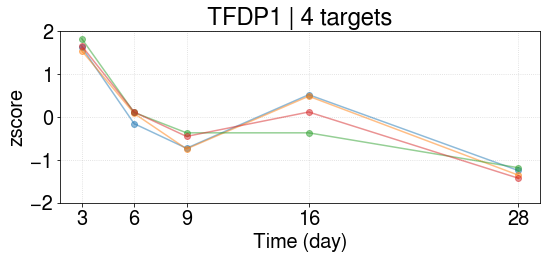

TFDP1 | 1 [ 1.65785346  0.03516186 -0.5754404   0.18530204 -1.30287696]
----------------------------------------------------------
regulon KLF2 4
['CDKN1A', 'FABP5', 'PPARG', 'CCR7']


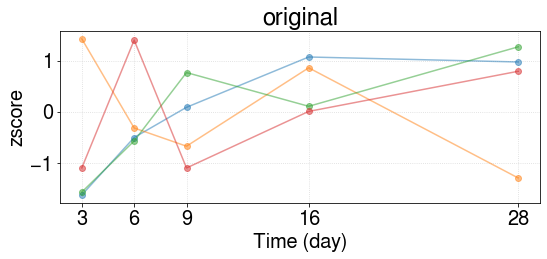

original data shape: (5, 4)
################################## FINAL
original size: 4; new size 0; lost: 4
----------------------------------------------------------
regulon PIN1 5
['DEPDC1', 'NCAPH', 'CENPA', 'CDKN1A', 'BUB1']


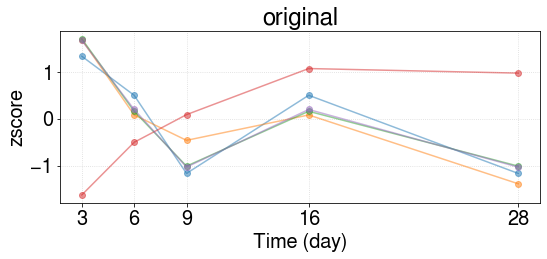

original data shape: (5, 5)
found subregulon: ['DEPDC1', 'NCAPH', 'CENPA', 'BUB1'] 4 0.8966570417348747
################################## FINAL
original size: 5; new size 4; lost: 1
DEPDC1
NCAPH
CENPA
BUB1
sub ['DEPDC1', 'NCAPH', 'CENPA', 'BUB1'] 4


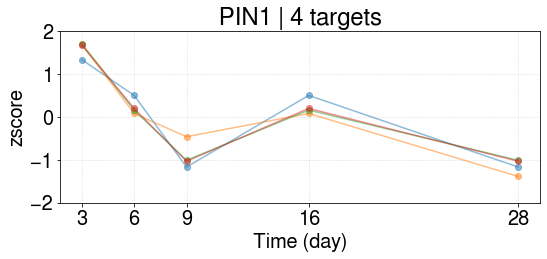

PIN1 | 1 [ 1.59922061  0.23392311 -0.91781099  0.23392311 -1.14925584]
----------------------------------------------------------
regulon SNAI1 5
['CXCL8', 'FOS', 'CDH2', 'HBEGF', 'FOSL1']


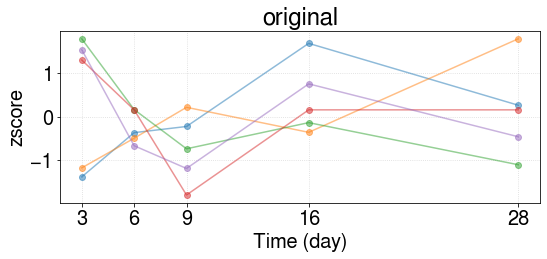

original data shape: (5, 5)
################################## FINAL
original size: 5; new size 0; lost: 5
----------------------------------------------------------
regulon FOSL2 4
['BRCA1', 'MMP13', 'FOSL1', 'BCL6']


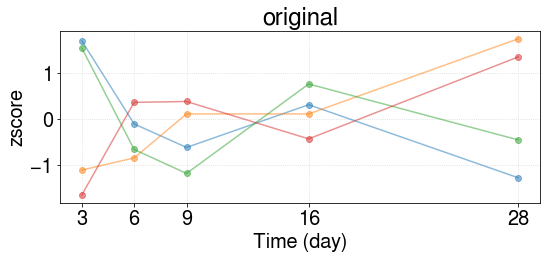

original data shape: (5, 4)
found subregulon: ['BRCA1', 'MMP13', 'FOSL1'] 3 0.8377649375971771
################################## FINAL
original size: 4; new size 3; lost: 1
BRCA1
MMP13
FOSL1
sub ['BRCA1', 'MMP13', 'FOSL1'] 3


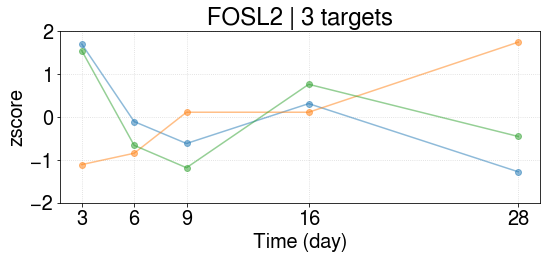

FOSL2 | 1 [ 0.70921617 -0.5389635  -0.56474245  0.39211672  0.00237305]


In [23]:
quality = []
heatmap = {}

for TF, row in df.iterrows():
    
    number_of_targets = int(row['TF targets DEGs / all TF targets'].split('/')[0])
    print('----------------------------------------------------------')
    print('regulon', TF, number_of_targets)

    # plot raw expression of all genes
    targets = row['Observed TF target DEGs'].split(', ')
    print(targets)

    regulon_expression = []
    for target in targets:
        regulon_expression.append(expression_trajectories[target])
    #print(regulon_expression)

    log2_regulon_expression = numpy.log2(regulon_expression)
    #print('log2 reg expression')
    #print(log2_regulon_expression)

    # zscores
    #print('zscores')
    zscores_regulon = scipy.stats.zscore(log2_regulon_expression, axis=1)
    #print(zscores_regulon)
    for gene_trajectory in zscores_regulon: 
        matplotlib.pyplot.plot(time_trajectory, gene_trajectory, 'o-', alpha=0.5)
    matplotlib.pyplot.xlabel('Time (day)')
    matplotlib.pyplot.ylabel('zscore')
    matplotlib.pyplot.xticks(time_trajectory)
    matplotlib.pyplot.title('original')
    matplotlib.pyplot.grid(alpha=0.5, ls=':')
    matplotlib.pyplot.tight_layout()
    matplotlib.pyplot.show()
       
    ###
    ### exhaustive PCA
    ### 
   
    working_data = numpy.transpose(zscores_regulon)
    working_targets = targets
    print('original data shape:', working_data.shape)
       
    subregulons = []
    consistency_threshold = 0.82
    exhausted = False
    next_round_data = []
    next_round_targets = []
    while exhausted == False:
        
        iteration = 0
        PC1_explained_variance = 0    
        
        
        
        # remove one by one until consistency threshold
        new_round = False
        while new_round == False:
            #print('iteration {}; shape: {}'.format(iteration, working_data.shape))
            # find lowest loading gene and remove it
            pca = sklearn.decomposition.PCA(n_components=3)
            projection = pca.fit_transform(working_data)
            PC1_explained_variance = pca.explained_variance_ratio_[0]
            #print('\t PC1 variance explained: {}'.format(PC1_explained_variance))
            PC1_loadings = pca.components_[0]
            lowest_loading_index = numpy.argmin(PC1_loadings)
            lowest_loading_gene = working_targets[lowest_loading_index]
            
            next_round_data.append(list(working_data[:, lowest_loading_index]))
            next_round_targets.append(lowest_loading_gene)            
            working_data = numpy.delete(working_data, lowest_loading_index, 1)
            working_targets.remove(lowest_loading_gene)
            
            #print(working_data.shape)
            #print(next_round_data.shape)
            
            '''
            for gene_trajectory in numpy.transpose(working_data): 
                matplotlib.pyplot.plot(time_trajectory, gene_trajectory, 'o-', alpha=0.5)
            matplotlib.pyplot.xlabel('Time (day)')
            matplotlib.pyplot.ylabel('zscore')
            matplotlib.pyplot.xticks(time_trajectory)
            matplotlib.pyplot.grid(alpha=0.5, ls=':')
            matplotlib.pyplot.ylim([-2, 2])
            matplotlib.pyplot.title(PC1_explained_variance)
            matplotlib.pyplot.tight_layout()
            matplotlib.pyplot.show()
            '''
            
            iteration = iteration + 1
            
            if (PC1_explained_variance >= consistency_threshold) | (len(working_targets) <= 4):
                new_round = True
                
                if PC1_explained_variance >= consistency_threshold:
                    subregulons.append(working_targets)
                    print('found subregulon: {} {} {}'.format(working_targets, len(working_targets), PC1_explained_variance))
                else:
                    print('WARNING: These genes are not tight, discarding.'.format(working_genes))
                
                working_data = numpy.transpose(numpy.array(next_round_data))
                working_targets = next_round_targets
                next_round_data = []
                next_round_targets = []
               
            

        # 
        if len(working_targets) <= 5:
            exhausted = True
        
    
    print('################################## FINAL')
    working_data = numpy.transpose(zscores_regulon)
    working_targets = targets = row['Observed TF target DEGs'].split(', ')
    original = len(working_targets)
    new = sum([len(sub) for sub in subregulons])
    lost = original - new
    print('original size: {}; new size {}; lost: {}'.format(original, new, lost))
    
    
    for i in range(len(subregulons)):
        
        sub=subregulons[i]
        
        for element in sub:
            print(element)
        print('sub', sub, len(sub))
        
        indices = [working_targets.index(element) for element in sub]
        plotting = working_data[:, indices]
        
        for gene_trajectory in numpy.transpose(plotting): 
                matplotlib.pyplot.plot(time_trajectory, gene_trajectory, 'o-', alpha=0.5)
        matplotlib.pyplot.xlabel('Time (day)')
        matplotlib.pyplot.ylabel('zscore')
        matplotlib.pyplot.xticks(time_trajectory)
        matplotlib.pyplot.grid(alpha=0.5, ls=':')
        matplotlib.pyplot.ylim([-2, 2])
        matplotlib.pyplot.title('{} | {} targets'.format(TF, len(sub)))
        matplotlib.pyplot.tight_layout()
        matplotlib.pyplot.show()
        
        label = '{} | {}'.format(TF, str(i+1))
        average = numpy.mean(plotting, axis=1)
        print(label, average)
        
        heatmap[label] = average
    # write results
    
              

In [24]:
heatmap

{'KLF16 | 1': array([ 1.4594654 , -0.03655097, -0.54965295,  0.41581508, -1.28907656]),
 'KLF16 | 2': array([-1.32565892, -0.34051797,  0.17868476, -0.04053981,  1.52803194]),
 'E2F8 | 1': array([ 1.430044  ,  0.06128648, -0.63816145,  0.16655604, -1.01972507]),
 'ZNF750 | 1': array([ 1.69248939,  0.06041434, -0.86998886, -0.06989769, -0.81301718]),
 'ZNF750 | 2': array([-1.57667957, -0.042443  ,  0.43089225, -0.00348598,  1.19171629]),
 'HIVEP3 | 1': array([ 0.99478675, -0.07258399, -0.29811668,  0.30944894, -0.93353502]),
 'GATA5 | 1': array([ 1.37973509,  0.55813284, -0.28096168, -0.27055621, -1.38635003]),
 'GATA5 | 2': array([-1.51182203, -0.16689854,  0.65394724, -0.1284105 ,  1.15318383]),
 'FOXS1 | 1': array([ 1.45710305,  0.50646273, -0.10762936, -0.74644037, -1.10949605]),
 'FOXS1 | 2': array([-1.48186214, -0.22937179,  0.6166652 , -0.09934821,  1.19391694]),
 'IRF5 | 1': array([ 0.5320472 ,  0.06624014, -0.1924586 ,  0.13650744, -0.54233619]),
 'TBX2 | 1': array([ 1.52049974

In [25]:
df = pandas.DataFrame.from_dict(heatmap, orient='index')

In [26]:
df.head()

,0,1,2,3,4
KLF16 | 1,1.459465,-0.036551,-0.549653,0.415815,-1.289077
KLF16 | 2,-1.325659,-0.340518,0.178685,-0.040540,1.528032
E2F8 | 1,1.430044,0.061286,-0.638161,0.166556,-1.019725
ZNF750 | 1,1.692489,0.060414,-0.869989,-0.069898,-0.813017
ZNF750 | 2,-1.576680,-0.042443,0.430892,-0.003486,1.191716


In [27]:
df.columns=['day 3', 'day 6', 'day 9', 'day 16', 'day 28']

In [28]:
df.head()

,day 3,day 6,day 9,day 16,day 28
KLF16 | 1,1.459465,-0.036551,-0.549653,0.415815,-1.289077
KLF16 | 2,-1.325659,-0.340518,0.178685,-0.040540,1.528032
E2F8 | 1,1.430044,0.061286,-0.638161,0.166556,-1.019725
ZNF750 | 1,1.692489,0.060414,-0.869989,-0.069898,-0.813017
ZNF750 | 2,-1.576680,-0.042443,0.430892,-0.003486,1.191716


In [29]:
a=df.index.to_list()
b=[element.split(' | ')[0] for element in a]
c=list(set(b))
c.sort()
print(c, len(c))

['AR', 'ARID5A', 'ARID5B', 'ARNTL', 'ARNTL2', 'ATF4', 'ATOH8', 'BATF3', 'BNC2', 'CEBPA', 'CEBPB', 'CSRNP1', 'CTCF', 'CXXC4', 'E2F1', 'E2F2', 'E2F3', 'E2F4', 'E2F7', 'E2F8', 'EBF2', 'EBF3', 'EGR1', 'EGR3', 'EMX2', 'ESR1', 'ETV7', 'FOSL2', 'FOXC1', 'FOXC2', 'FOXF1', 'FOXF2', 'FOXL1', 'FOXM1', 'FOXN3', 'FOXO1', 'FOXS1', 'GATA5', 'GLI1', 'GLI2', 'GLIS1', 'GLIS2', 'GLIS3', 'HAND2', 'HEYL', 'HIF1A', 'HIF3A', 'HIVEP3', 'HLX', 'IRF5', 'IRX6', 'JDP2', 'JUN', 'KLF15', 'KLF16', 'LHX6', 'MEIS3', 'MEOX2', 'MKX', 'MLXIPL', 'MSX1', 'MYBL2', 'MYCN', 'NFATC4', 'NFIB', 'NFIX', 'NFKB1', 'NFYB', 'NHLH1', 'NPAS3', 'NR1H3', 'NR4A3', 'OSR1', 'OSR2', 'PIN1', 'PKNOX2', 'PLAGL1', 'PPARG', 'PRDM16', 'PRDM6', 'PRDM8', 'PRRX1', 'PRRX2', 'RFX8', 'RUNX2', 'SMAD9', 'SOX13', 'SOX17', 'SOX5', 'SOX7', 'SP1', 'SP100', 'SP5', 'STAT1', 'STAT3', 'TBX15', 'TBX18', 'TBX2', 'TCF21', 'TCF7L1', 'TFCP2L1', 'TFDP1', 'TFEC', 'TGIF1', 'TP53', 'TRERF1', 'TRPS1', 'TSC22D1', 'TSHZ2', 'TSHZ3', 'YBX1', 'YBX3', 'ZBTB47', 'ZFHX3', 'ZFHX4',

[Text(1, 0.5, 'YBX3'),
 Text(1, 6.5, 'TP53'),
 Text(1, 12.5, 'PKNOX2'),
 Text(1, 18.5, 'TCF7L1'),
 Text(1, 24.5, 'MYBL2'),
 Text(1, 30.5, 'TGIF1'),
 Text(1, 36.5, 'EGR1'),
 Text(1, 42.5, 'ARNTL2'),
 Text(1, 48.5, 'CEBPA'),
 Text(1, 54.5, 'ZFHX4'),
 Text(1, 60.5, 'SOX5'),
 Text(1, 66.5, 'ZNF726'),
 Text(1, 72.5, 'TFDP1'),
 Text(1, 78.5, 'TBX18'),
 Text(1, 84.5, 'OSR1'),
 Text(1, 90.5, 'NPAS3'),
 Text(1, 96.5, 'EBF2'),
 Text(1, 102.5, 'GLIS2'),
 Text(1, 108.5, 'TSHZ2'),
 Text(1, 114.5, 'HIF3A'),
 Text(1, 120.5, 'KLF15'),
 Text(1, 126.5, 'GLIS3'),
 Text(1, 132.5, 'PRRX2'),
 Text(1, 138.5, 'ETV7'),
 Text(1, 144.5, 'TSC22D1'),
 Text(1, 150.5, 'OSR2'),
 Text(1, 156.5, 'CEBPA'),
 Text(1, 162.5, 'ZNF469'),
 Text(1, 168.5, 'EMX2'),
 Text(1, 174.5, 'ZHX3'),
 Text(1, 180.5, 'CXXC4'),
 Text(1, 186.5, 'CSRNP1'),
 Text(1, 192.5, 'FOXC2'),
 Text(1, 198.5, 'ZFPM2'),
 Text(1, 204.5, 'PRDM6'),
 Text(1, 210.5, 'MSX1'),
 Text(1, 216.5, 'GATA5'),
 Text(1, 222.5, 'PRRX1'),
 Text(1, 228.5, 'ZFHX4'),
 Text(1,

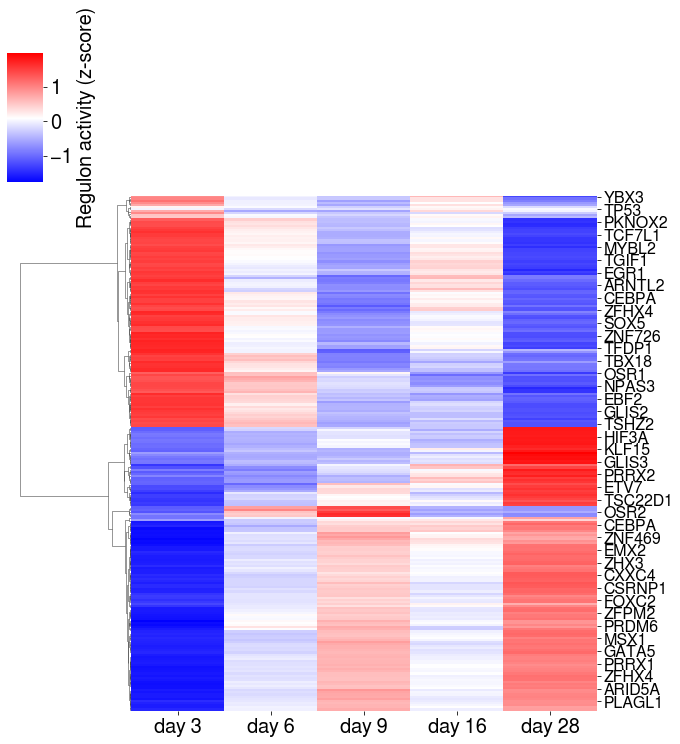

In [30]:
#g = seaborn.clustermap(df, col_cluster=False, cmap='viridis', yticklabels=4, method='average', metric='euclidean')
df.rename(index=lambda name: name.split(' | ')[0], inplace=True)
g = seaborn.clustermap(df,  cmap='bwr', col_cluster=False, yticklabels=6, method='ward', metric='euclidean', cbar_kws={'label':'Regulon activity (z-score)'})
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_ymajorticklabels(), fontsize=16)